<a href="https://colab.research.google.com/github/reza-chehreqani/Artificial-Intelligence/blob/main/Projects/Project%201/Notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Project 1
## Name: Reza Chehreghani
## Student ID: 810101401
## University of Tehran

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
project_dir = '/content/drive/MyDrive/Artificial Intelligence/Project 1/810101401_Reza_Chehreghani' + '/'

# Part I

## B. Explain the architecture of VGG16 and Resnet50.

### The VGG-16 model

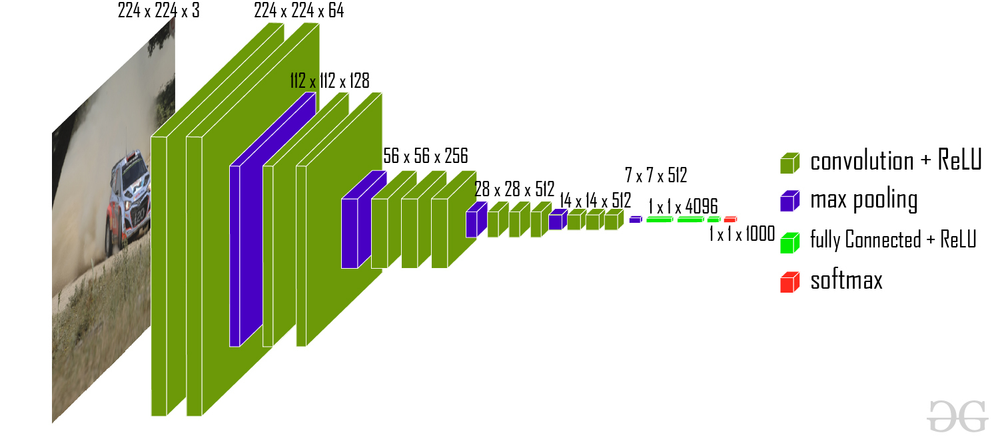

The VGG model stands for the Visual Geometry Group from Oxford. The model was very simple and had a greater depth than AlexNet. The paper had two models with 16 and 19 layers depth. It has a very simple and classical architecture, with 2 or 3 convolutional layers and a pooling layer, then again 2 or 3 convolutional layers and a pooling layer, and so on (reaching a total of just 16 convolutional layers), plus a final dense network with 2 hidden layers and the output layer. It used only 3 × 3 filters, but many filters. All the CNN layers were using 3 by 3 filters with stride and a pad of size 1 and a max pooling size of 2 with stride 2. This resulted in a decrease in the number of parameters. Though the size is decreasing because of max pooling, the number of filters is increasing with layers. The architecture of the 16-layer deep model is as follows:

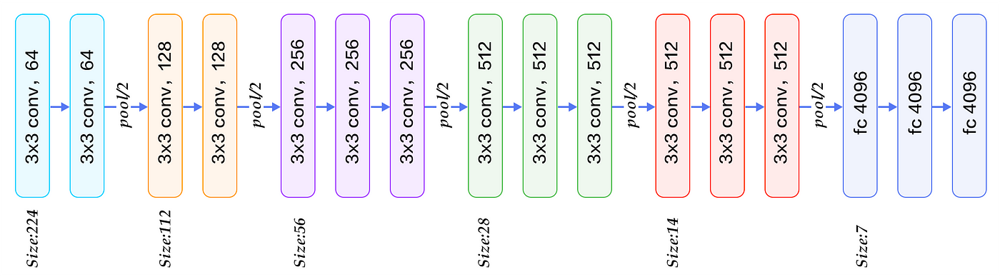

This model has 138 million parameters and is one of the largest models. But the uniformity of parameters is quite good. The characteristic is such that, as deep as the network gets, the smaller the image is with an increased number of filters.

source: Hands-on Machine Learning with Scikit-Learn, Keras & TensorFlow \\
source: Deep Learning  For Computer  Vision

### The ResNet-50 model

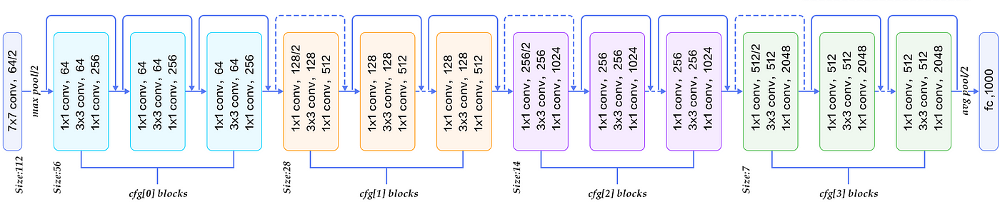

Models are getting deeper and
deeper, with fewer and fewer parameters. The key to being able to train such a deep
network is to use skip connections (also called shortcut connections): the signal feeding
into a layer is also added to the output of a layer located a bit higher up the stack. Let’s
see why this is useful.

When training a neural network, the goal is to make it model a target function $h(x)$.
If you add the input x to the output of the network (i.e., you add a skip connection),
then the network will be forced to model $f(x) = h(x) – x$ rather than $h(x)$. This is
called residual learning.

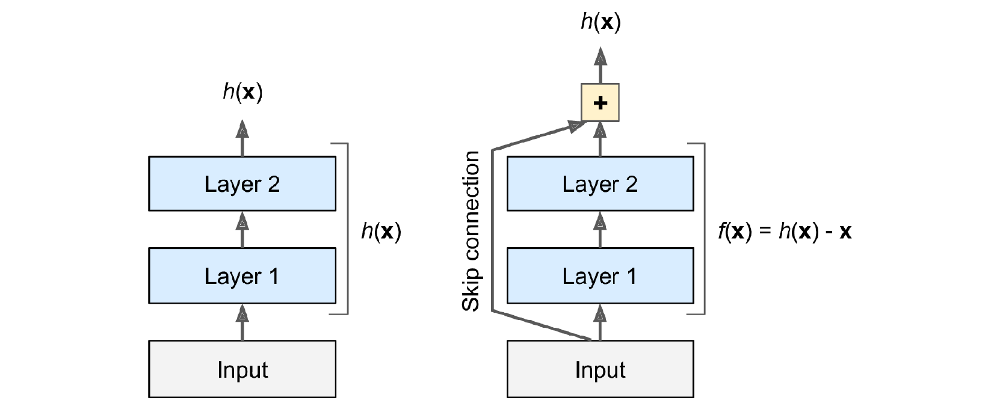

When you initialize a regular neural network, its weights are close to zero, so the network just outputs values close to zero. If you add a skip connection, the resulting network just outputs a copy of its inputs; in other words, it initially models the identity
function. If the target function is fairly close to the identity function (which is often
the case), this will speed up training considerably.

Moreover, if you add many skip connections, the network can start making progress
even if several layers have not started learning yet. Thanks to skip
connections, the signal can easily make its way across the whole network. The deep
residual network can be seen as a stack of residual units (RUs), where each residual
unit is a small neural network with a skip connection.

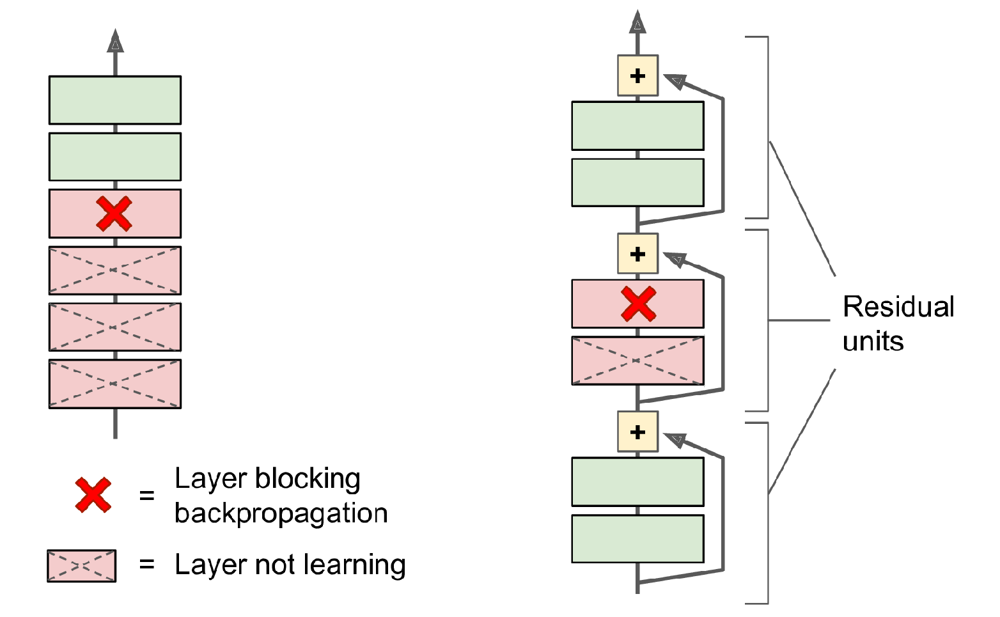

Now let’s look at ResNet’s architecture. It starts with two layers, divide the image’s height and width by 4 (so its area is divided
by 16), to reduce the computational load, and in
between is just a very deep stack of simple residual units. Each residual unit is composed of three convolutional layers, with Batch Normalization
(BN) and ReLU activation, using 1 × 1, 3 × 3, and 1 × 1 kernels respectively and preserving spatial dimensions
(stride 1, "same" padding for the middle layer). Next, the global average pooling layer outputs the mean of each feature map: this
drops any remaining spatial information, which is fine because there was not
much spatial information left at that point. The last layer is a fully connected layer with 1,000 units (since there are 1,000 classes) and a softmax activation function to output estimated class probabilities.

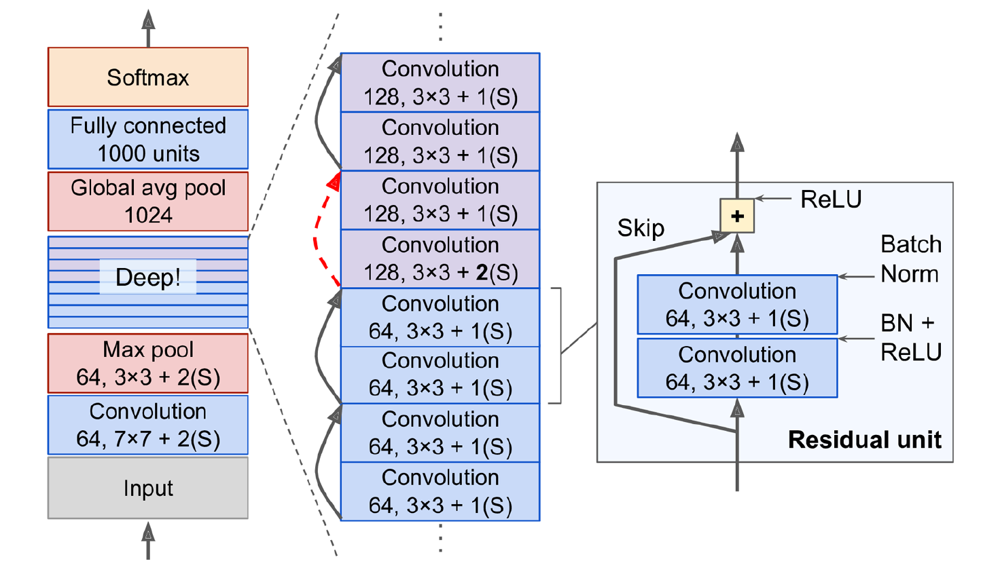

Note that the number of feature maps is doubled every few residual units, at the same
time as their height and width are halved (using a convolutional layer with stride 2).
When this happens, the inputs cannot be added directly to the outputs of the residual
unit because they don’t have the same shape. To solve this problem, the inputs are passed through a 1 × 1 convolutional layer with stride 2 and the
right number of output feature maps.

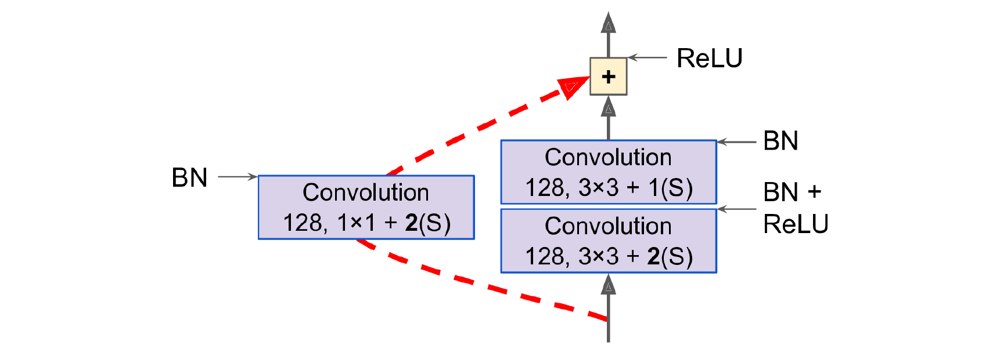

source: Hands-on Machine Learning with Scikit-Learn, Keras & TensorFlow

## C. Explain the codes for VGG16 and ResNet50 with data augmentation.

### Without data augmentation

Import necessary libraries

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.utils import image_dataset_from_directory
from tensorflow.keras.applications import VGG16, ResNet50
from tensorflow.keras.applications import vgg16, resnet50
from tensorflow.keras.layers import Dense, Flatten, Rescaling
import matplotlib.pyplot as plt
import numpy as np

Define some constants \\
Because we have only 173 images, we choose a small size of batch.

In [ ]:
dataset_dir = project_dir + 'Data-Dermoscopic _Images/'
num_of_images = 173
validation_split = 0.2
seed = 123
batch_size = 8

Load train dataset from google drive \\
Both VGG-16 and ResNet-50 have the input size of 224 × 224 × 3.

In [ ]:
train_data = image_dataset_from_directory(
    dataset_dir,
    validation_split = validation_split,
    subset = "training",
    seed = seed,
    label_mode = 'categorical',
    image_size = (224, 224),
    batch_size = batch_size
)

Found 173 files belonging to 3 classes.
Using 139 files for training.


Load validation dataset from google drive

In [ ]:
valid_data = image_dataset_from_directory(
    dataset_dir,
    validation_split = validation_split,
    subset = "validation",
    seed = seed,
    label_mode = 'categorical',
    image_size = (224, 224),
    batch_size = batch_size
)

Found 173 files belonging to 3 classes.
Using 34 files for validation.


Show an example of dataset with its class name

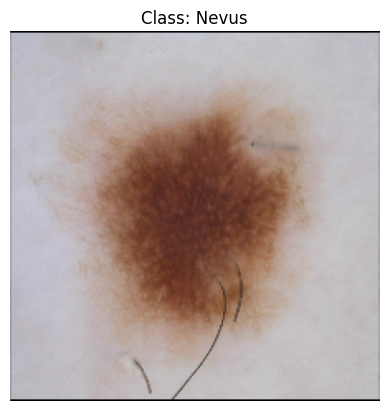

In [ ]:
for batch_images, batch_labels in train_data:
    plt.imshow(batch_images[0] / 255)
    plt.title('Class: ' + train_data.class_names[(np.argmax(batch_labels[0].numpy()))])
    plt.axis('off')
    plt.show()
    break

#### VGG-16

Load VGG-16 pre-trained model \\
We don't load its fully-connected layers, because we are going to train them.

In [ ]:
pretrain_vgg16 = VGG16(include_top=False, input_shape=(224,224,3), classes=3)
pretrain_vgg16.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

Freeze the convolutional layers

In [ ]:
pretrain_vgg16.trainable = False

Define a function to scale images to the appropriate range

In [ ]:
def preprocess_input(dataset, preprocess_function):
    return dataset.map(lambda image, label: (preprocess_function(image), label))

Call the *preprocess_input* function on the images to scale them to the appropriate range

In [ ]:
train_data_vgg16 = preprocess_input(train_data, vgg16.preprocess_input)
valid_data_vgg16 = preprocess_input(valid_data, vgg16.preprocess_input)

Define a fuction to make a sequentioal model with VGG-16 architecture, then compile it with Adam optimizer, fit it on dataset, and finally return the history of trainig

In [ ]:
def train_VGG16_model(train_data, validation_data, epochs=10):
    model = Sequential([
        pretrain_vgg16,

        Flatten(),
        Dense(units=4096,activation="relu"),
        Dense(units=4096,activation="relu"),
        Dense(units=3, activation="softmax")
    ])

    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    model.summary()

    history = model.fit(
        train_data,
        validation_data = validation_data,
        epochs = epochs
    )

    return history

Train the model with VGG-16 architecture without data augmentation

In [ ]:
history = train_VGG16_model(train_data_vgg16, valid_data_vgg16)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten (Flatten)           (None, 25088)             0         
                                                                 
 dense (Dense)               (None, 4096)              102764544 
                                                                 
 dense_1 (Dense)             (None, 4096)              16781312  
                                                                 
 dense_2 (Dense)             (None, 3)                 12291     
                                                                 
Total params: 134272835 (512.21 MB)
Trainable params: 119558147 (456.08 MB)
Non-trainable params: 14714688 (56.13 MB)
_________________________________________________________________
Epoc

Define a fuction to plot training history loss and accurracy

In [ ]:
def plot_loss_and_accuracy(history, title):
    plt.figure(figsize=[2 * plt.rcParams['figure.figsize'][0], plt.rcParams['figure.figsize'][1]])
    plt.suptitle(title, size='xx-large')

    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='train')
    plt.plot(history.history['val_loss'], label='test')
    plt.title('Model Loss')
    plt.xlabel('No of epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history.history['accuracy'], label='train')
    plt.plot(history.history['val_accuracy'], label='test')
    plt.title('Model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('No of epochs')
    plt.legend()
    plt.show()

Plot the history of model with VGG-16 architecture without data augmentation

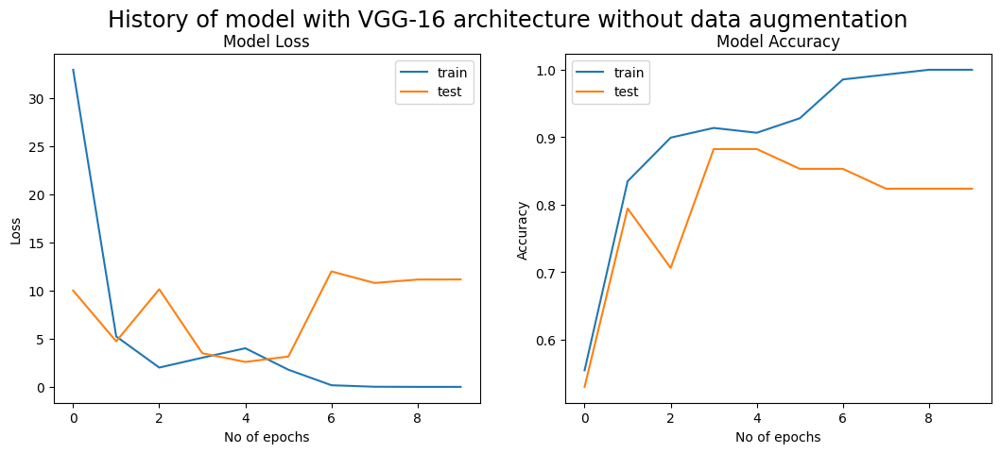

In [ ]:
plot_loss_and_accuracy(history, 'History of model with VGG-16 architecture without data augmentation')

#### ResNet-50

Load VGG-16 pre-trained model \\
We don't load its fully-connected layers, because we are going to train them.

In [ ]:
pretrain_resnet50 = ResNet50(include_top=False, input_shape=(224,224,3), classes=3)
pretrain_resnet50.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_4[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                       

Freeze the convolutional layers

In [ ]:
pretrain_resnet50.trainable = False

Call the *preprocess_input* function on the images to scale them to the appropriate range

In [ ]:
train_data_resnet50 = preprocess_input(train_data, resnet50.preprocess_input)
valid_data_resnet50 = preprocess_input(valid_data, resnet50.preprocess_input)

Define a fuction to make a sequentioal model with ResNet-50 architecture, then compile it with Adam optimizer, fit it on dataset, and finally return the history of trainig

In [ ]:
def train_ResNet50_model(train_data, validation_data, epochs=10):
    model = Sequential([
        pretrain_resnet50,

        Flatten(),
        Dense(units=3, activation="softmax")
    ])

    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    model.summary()

    history = model.fit(
        train_data,
        validation_data = validation_data,
        epochs = epochs
    )

    return history

Train the model with ResNet-50 architecture without data augmentation

In [ ]:
history = train_ResNet50_model(train_data_resnet50, valid_data_resnet50)

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 flatten_1 (Flatten)         (None, 100352)            0         
                                                                 
 dense_3 (Dense)             (None, 3)                 301059    
                                                                 
Total params: 23888771 (91.13 MB)
Trainable params: 301059 (1.15 MB)
Non-trainable params: 23587712 (89.98 MB)
_________________________________________________________________
Epoch 1/10
35/35 [==============================] - 17s 253ms/step - loss: 16.9775 - accuracy: 0.5396 - val_loss: 14.6226 - val_accuracy: 0.5588
Epoch 2/10
35/35 [==============================] - 6s 154ms/step - loss: 2.6443 - accuracy: 0.9065 - val_loss: 8.7012 - val_acc

Plot the history of model with ResNet-50 architecture without data augmentation

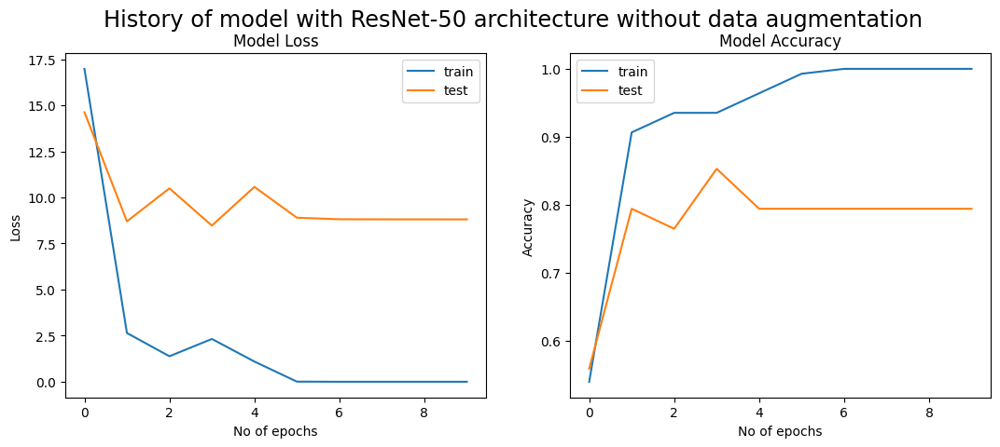

In [ ]:
plot_loss_and_accuracy(history, 'History of model with ResNet-50 architecture without data augmentation')

### With data augmentation

Define a function to create an ImageDataGenerator to augment the data and finally return augmented train and validation data

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

def augment_data(preprocessing_function):

    data_generator = ImageDataGenerator(
        validation_split = validation_split,
        width_shift_range = 0.1,
        height_shift_range = 0.1,
        horizontal_flip = True,
        vertical_flip = True,
        rotation_range = 40,
        zoom_range=0.2,
        preprocessing_function=preprocessing_function
    )

    train_generator = data_generator.flow_from_directory(
        dataset_dir,
        subset = "training",
        seed = seed,
        class_mode = 'categorical',
        target_size = (224, 224),
        batch_size = batch_size
    )

    valid_generator = data_generator.flow_from_directory(
        dataset_dir,
        subset = "validation",
        seed = seed,
        class_mode = 'categorical',
        target_size = (224, 224),
        batch_size = batch_size
    )

    return train_generator, valid_generator

#### VGG-16

Load data, Call the *preprocess_input* function on them ,and augment them

In [ ]:
train_generator_vgg16, valid_generator_vgg16 = augment_data(vgg16.preprocess_input)

Found 140 images belonging to 3 classes.
Found 33 images belonging to 3 classes.


Show an example of augmented image

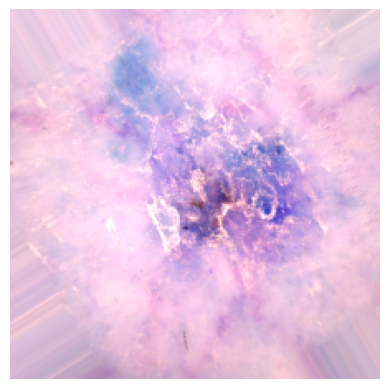

In [ ]:
plt.imshow(np.clip(next(train_generator_vgg16)[0][0] + 127.5, 0, 255).astype(np.uint8))
plt.axis('off')
plt.show()

Train the model with VGG-16 architecture with data augmentation

In [ ]:
history = train_VGG16_model(train_generator_vgg16, valid_generator_vgg16)

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten_8 (Flatten)         (None, 25088)             0         
                                                                 
 dense_18 (Dense)            (None, 4096)              102764544 
                                                                 
 dense_19 (Dense)            (None, 4096)              16781312  
                                                                 
 dense_20 (Dense)            (None, 3)                 12291     
                                                                 
Total params: 134272835 (512.21 MB)
Trainable params: 119558147 (456.08 MB)
Non-trainable params: 14714688 (56.13 MB)
_________________________________________________________________
Ep

Plot the history of model with VGG-16 architecture with data augmentation

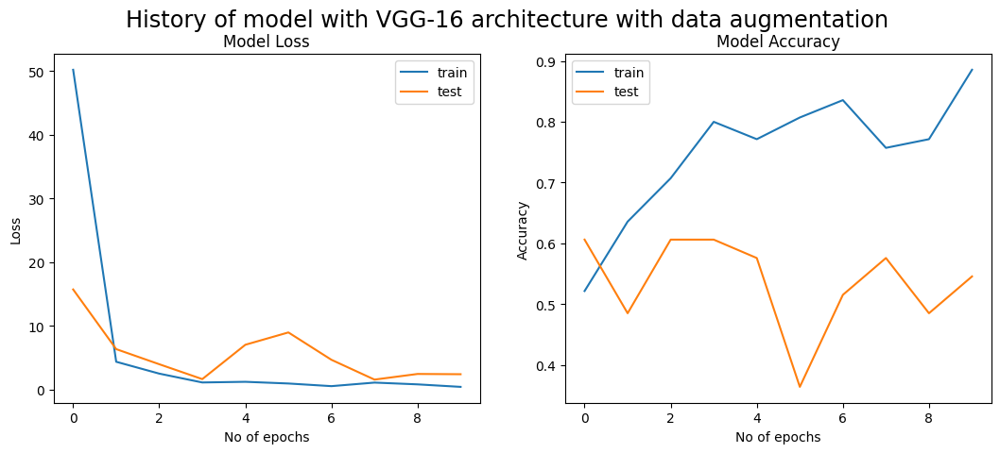

In [ ]:
plot_loss_and_accuracy(history, 'History of model with VGG-16 architecture with data augmentation')

#### ResNet-50

Load data, Call the *preprocess_input* function on them ,and augment them

In [ ]:
train_generator_resnet50, valid_generator_resnet50 = augment_data(resnet50.preprocess_input)

Train the model with ResNet-50 architecture with data augmentation

In [ ]:
history = train_ResNet50_model(train_generator_resnet50, valid_generator_resnet50)

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 flatten_9 (Flatten)         (None, 100352)            0         
                                                                 
 dense_21 (Dense)            (None, 3)                 301059    
                                                                 
Total params: 23888771 (91.13 MB)
Trainable params: 301059 (1.15 MB)
Non-trainable params: 23587712 (89.98 MB)
_________________________________________________________________
Epoch 1/10
35/35 [==============================] - 11s 234ms/step - loss: 12.8025 - accuracy: 0.5929 - val_loss: 19.3406 - val_accuracy: 0.4848
Epoch 2/10
35/35 [==============================] - 6s 174ms/step - loss: 9.7393 - accuracy: 0.7643 - val_loss: 32.9885 - val_ac

Plot the history of model with ResNet-50 architecture with data augmentation

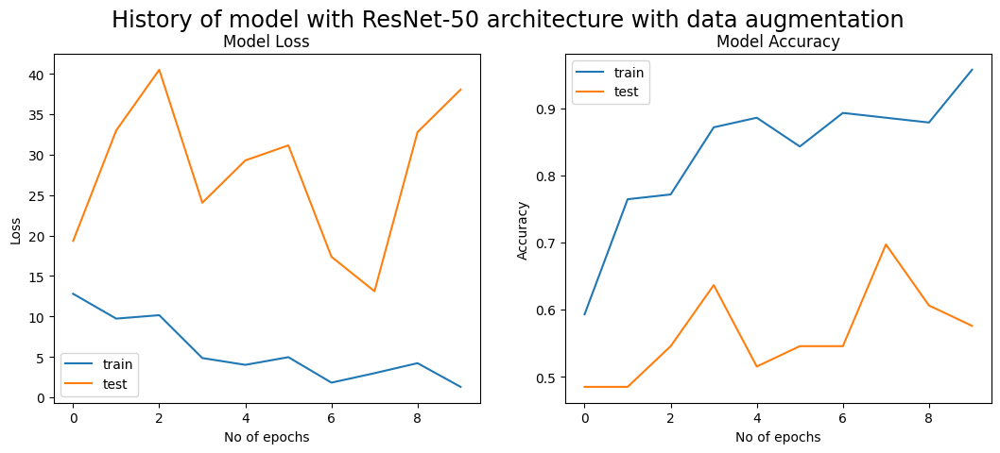

In [ ]:
plot_loss_and_accuracy(history, 'History of model with ResNet-50 architecture with data augmentation')

sources: \\
[1] https://builtin.com/machine-learning/vgg16 \\
[2] https://medium.com/@bravinwasike18/building-a-deep-learning-model-with-keras-and-resnet-50-9dd6f4eb3351

## D. What are the advantages and disadvantages of data augmentation in Convolutional Neural Networks?

Data augmentation artificially increases the size of the training set by generating
many realistic variants of each training instance. This reduces overfitting, making this
a regularization technique. The generated instances should be as realistic as possible:
ideally, given an image from the augmented training set, a human should not be able
to tell whether it was augmented or not. Simply adding white noise will not help; the
modifications should be learnable (white noise is not).


For example, you can slightly shift, rotate, and resize every picture in the training set
by various amounts and add the resulting pictures to the training set. This forces the model to be more tolerant to variations in the position,
orientation, and size of the objects in the pictures. For a model that’s more tolerant of
different lighting conditions, you can similarly generate many images with various
contrasts. In general, you can also flip the pictures horizontally (except for text, and
other asymmetrical objects). By combining these transformations, you can greatly
increase the size of your training set.

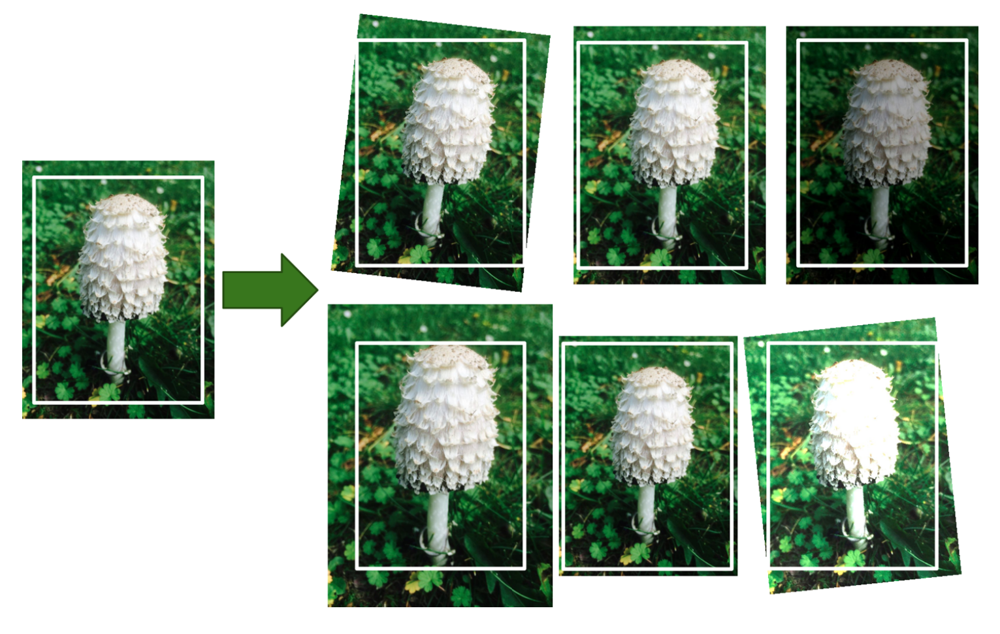

**Advantages of Data Augmentation:**

*   **Increased Robustness:** Data augmentation introduces
variations in the training data by applying transformations such as rotation, scaling, flipping, and cropping. This helps the model become more robust to different viewpoints, lighting conditions, and noise in real-world scenarios. \\
*   **Improved Generalization:** By increasing the diversity of training examples, data augmentation prevents overfitting. It encourages the model to learn features that are invariant to minor changes, leading to better generalization on unseen data. \\
*   **Larger Effective Training Set:** Augmenting the data artificially expands the training dataset. Even if you have a limited number of original images, data augmentation generates additional samples, effectively increasing the size of the training set. \\
*   **Reduced Risk of Memorization:** When the model sees the same examples repeatedly during training, it may memorize the training data rather than learning meaningful features. Data augmentation mitigates this risk by providing novel variations.

**Disadvantages of Data Augmentation:**

*   **Increased Computational Cost:** Applying data augmentation during training requires additional computation time. Each augmented sample involves transformations, which can slow down the training process. \\
*   **Risk of Overfitting:** Although data augmentation helps prevent overfitting, excessive augmentation can lead to a different problem: overfitting to the augmented data. If the transformations are too aggressive, the model may struggle to generalize to real-world data. \\
*   **Artificial Correlations:** Augmented samples are not independent; they share similarities with the original images. This can introduce artificial correlations between examples, affecting the model’s performance. \\
*   **Hyperparameter Tuning:** Choosing appropriate augmentation techniques and their parameters (e.g., rotation angles, scaling factors) requires experimentation. Finding the right balance can be challenging.

source: Hands-on Machine Learning with Scikit-Learn, Keras & TensorFlow

# Part II

## A. Create a Deep Convolutional Generative Adversarial Network for the CIFAR-10 dataset and explain your codes.

Import necessary libraries.

In [ ]:
from numpy import expand_dims, zeros, ones, concatenate
from numpy.random import randn, randint
from tensorflow import concat, constant
from tensorflow.data import Dataset
from tensorflow.random import normal
from tensorflow.keras.datasets import cifar10
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Reshape, Flatten, Conv2D, Conv2DTranspose, LeakyReLU, Dropout
import matplotlib.pyplot as plt

Define size of the noise space

In [ ]:
noise_dim = 100

Create the generator model

In [ ]:
generator = Sequential([
    Dense(256*4*4, input_dim=noise_dim),
    LeakyReLU(alpha=0.2),
    Reshape((4, 4, 256)),
    Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'),
    LeakyReLU(alpha=0.2),
    Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'),
    LeakyReLU(alpha=0.2),
    Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'),
    LeakyReLU(alpha=0.2),
    Conv2D(3, (3,3), activation='tanh', padding='same')
])

generator.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 4096)              413696    
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 4096)              0         
                                                                 
 reshape (Reshape)           (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose (Conv2DTr  (None, 8, 8, 128)         524416    
 anspose)                                                        
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 8, 8, 128)         0         
                                                                 
 conv2d_transpose_1 (Conv2D  (None, 16, 16, 128)       262272    
 Transpose)                                             

Create the discriminator model

In [ ]:
discriminator = Sequential([
    Conv2D(64, (3,3), padding='same', input_shape=(32,32,3)),
    LeakyReLU(alpha=0.2),
    Conv2D(128, (3,3), strides=(2,2), padding='same'),
    LeakyReLU(alpha=0.2),
    Conv2D(128, (3,3), strides=(2,2), padding='same'),
    LeakyReLU(alpha=0.2),
    Conv2D(256, (3,3), strides=(2,2), padding='same'),
    LeakyReLU(alpha=0.2),

    Flatten(),
    Dropout(0.4),
    Dense(1, activation='sigmoid')
])

discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 32, 32, 64)        1792      
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 32, 32, 64)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 16, 16, 128)       73856     
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 16, 16, 128)       0         
                                                                 
 conv2d_3 (Conv2D)           (None, 8, 8, 128)         147584    
                                                                 
 leaky_re_lu_6 (LeakyReLU)   (None, 8, 8, 128)         0         
                                                                 
 conv2d_4 (Conv2D)           (None, 4, 4, 256)        

Compile the discriminator model

In [ ]:
opt = Adam(learning_rate=0.0002, beta_1=0.5)
discriminator.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])

Create the GAN model

In [ ]:
gan = Sequential([generator, discriminator])

Compile the GAN model, but before that make weights in the discriminator not trainable

In [ ]:
discriminator.trainable = False
gan.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=0.0002, beta_1=0.5), metrics=['accuracy'])

gan.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential (Sequential)     (None, 32, 32, 3)         1466115   
                                                                 
 sequential_1 (Sequential)   (None, 1)                 522497    
                                                                 
Total params: 1988612 (7.59 MB)
Trainable params: 1466115 (5.59 MB)
Non-trainable params: 522497 (1.99 MB)
_________________________________________________________________


Load cifar10 dataset \\
We don't need their labels, because all of them are lables as real image.

In [ ]:
(X_train, _), (X_test, _) = cifar10.load_data()

Concatenate train and test datasets, because all of them are used as discriminator train data and we won't evaluate the discriminator.

In [ ]:
X_train = concatenate((X_train, X_test), axis=0)

Convert the type of pixels from unsigned ints to floats

In [ ]:
X_train = X_train.astype('float32')

Scale the range of pixels from [0,255] to [-1,1]

In [ ]:
X_train = (X_train - 127.5) / 127.5

Shuffle the dataset

In [ ]:
dataset = Dataset.from_tensor_slices(X_train).shuffle(1000)

Batch the dataset

In [ ]:
batch_size = 128
dataset = dataset.batch(batch_size, drop_remainder=True).prefetch(1)

Define a function to plot the history of generator and discriminator loss and accuracy

In [ ]:
def plot_loss_and_accuracy(history):
    plt.figure(figsize=[2 * plt.rcParams['figure.figsize'][0], plt.rcParams['figure.figsize'][1]])

    plt.subplot(1, 2, 1)
    plt.plot(history['generator_loss'], label='generator_loss')
    plt.plot(history['discriminator_loss'], label='discriminator_loss')
    plt.title('Generator and Discriminator Model Loss')
    plt.xlabel('No of epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history['generator_acc'], label='generator_acc')
    plt.plot(history['discriminator_acc'], label='discriminator_acc')
    plt.title('Generator and Discriminator Model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('No of epochs')
    plt.legend()
    plt.show()

Define a function to show the  generated images by generator \\
At first we need to scale the images from [-1,1] to [0,1]

In [ ]:
def show_generated_images(images):
	images = (images + 1) / 2.0

	plt.figure(figsize=[2 * plt.rcParams['figure.figsize'][0], plt.rcParams['figure.figsize'][1]])

	for i in range(8):
		plt.subplot(2, 4, 1 + i)
		plt.axis('off')
		plt.imshow(images[i])
	plt.show()

Train the GAN model

1.   Training the discriminator
    *   Create noise
    *   Generate fake images
    *   Train the discriminator by real and fake images
2.   Training the generator
    *   Create noise
    *   Train the generator via the discriminator's error
3.   Summarize loss and accuracy

Iteration: 10 - Generator loss: 0.6997 - Generator Accuracy: 30.47 % - Discrimnator loss: 0.5412 - Discrimnator Accuracy: 50.00 %
Iteration: 20 - Generator loss: 0.7208 - Generator Accuracy: 0.78 % - Discrimnator loss: 0.4645 - Discrimnator Accuracy: 45.70 %
Iteration: 30 - Generator loss: 0.7471 - Generator Accuracy: 0.00 % - Discrimnator loss: 0.4971 - Discrimnator Accuracy: 96.09 %
Iteration: 40 - Generator loss: 0.7586 - Generator Accuracy: 0.00 % - Discrimnator loss: 0.4018 - Discrimnator Accuracy: 55.47 %
Iteration: 50 - Generator loss: 1.0837 - Generator Accuracy: 0.00 % - Discrimnator loss: 0.3892 - Discrimnator Accuracy: 91.02 %
Iteration: 60 - Generator loss: 1.0224 - Generator Accuracy: 0.00 % - Discrimnator loss: 0.3752 - Discrimnator Accuracy: 94.14 %
Iteration: 70 - Generator loss: 0.8510 - Generator Accuracy: 0.00 % - Discrimnator loss: 0.3211 - Discrimnator Accuracy: 100.00 %
Iteration: 80 - Generator loss: 1.6079 - Generator Accuracy: 0.00 % - Discrimnator loss: 0.3858

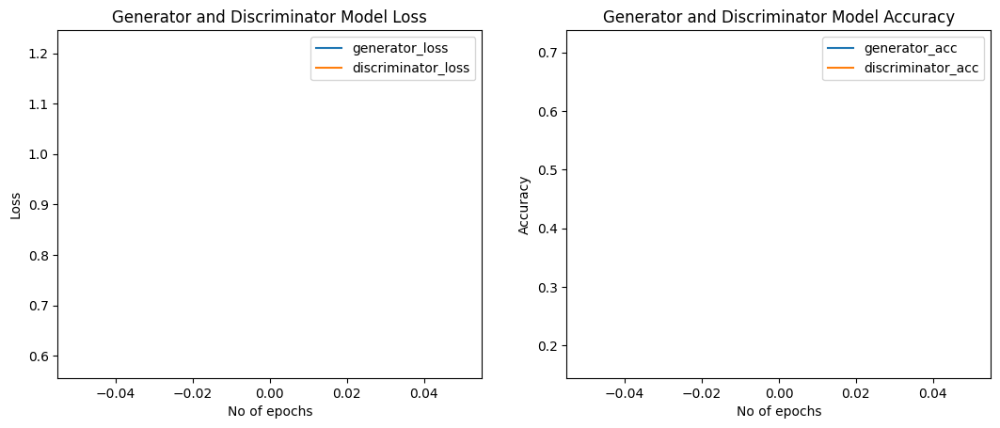

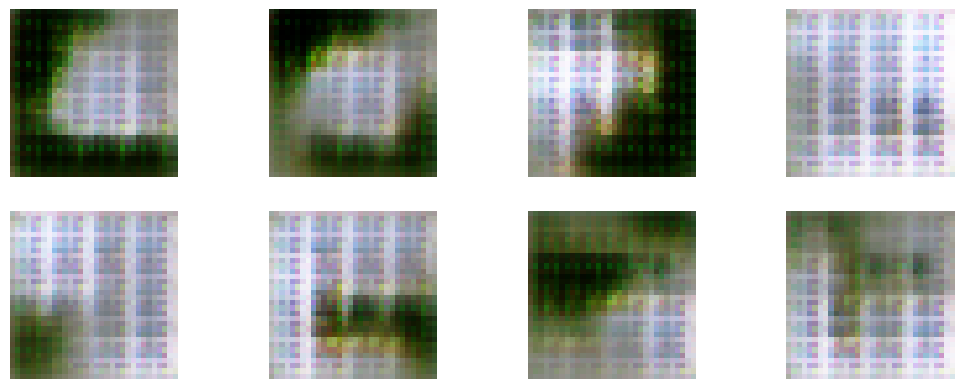

Iteration: 470 - Generator loss: 1.3586 - Generator Accuracy: 11.72 % - Discrimnator loss: 0.5654 - Discrimnator Accuracy: 70.70 %
Iteration: 480 - Generator loss: 1.7690 - Generator Accuracy: 0.00 % - Discrimnator loss: 0.3885 - Discrimnator Accuracy: 84.38 %
Iteration: 490 - Generator loss: 1.1080 - Generator Accuracy: 34.38 % - Discrimnator loss: 1.0150 - Discrimnator Accuracy: 48.83 %
Iteration: 500 - Generator loss: 1.2409 - Generator Accuracy: 4.69 % - Discrimnator loss: 0.7185 - Discrimnator Accuracy: 58.20 %
Iteration: 510 - Generator loss: 1.6262 - Generator Accuracy: 0.78 % - Discrimnator loss: 0.3827 - Discrimnator Accuracy: 93.36 %
Iteration: 520 - Generator loss: 1.4050 - Generator Accuracy: 2.34 % - Discrimnator loss: 0.5281 - Discrimnator Accuracy: 73.05 %
Iteration: 530 - Generator loss: 0.8610 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.7220 - Discrimnator Accuracy: 49.61 %
Iteration: 540 - Generator loss: 1.0097 - Generator Accuracy: 12.50 % - Discrimnator lo

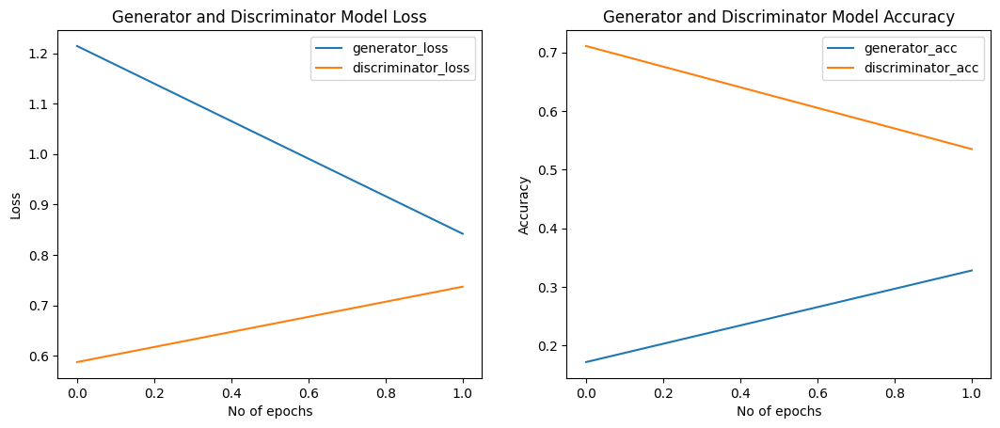

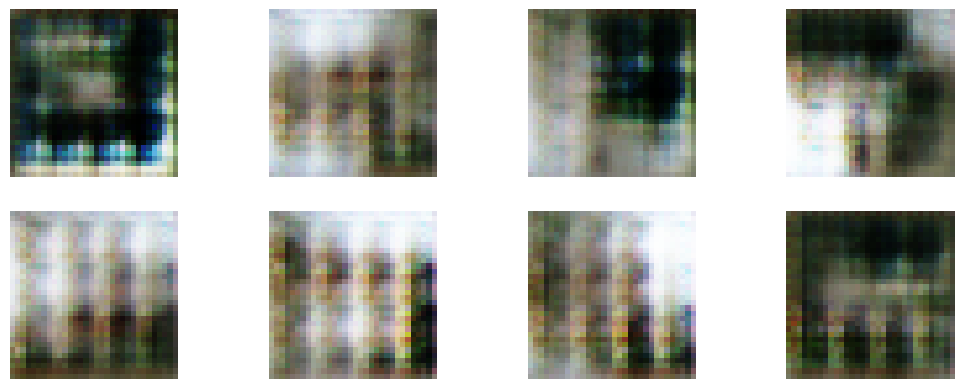

Iteration: 940 - Generator loss: 0.8799 - Generator Accuracy: 29.69 % - Discrimnator loss: 0.6533 - Discrimnator Accuracy: 61.72 %
Iteration: 950 - Generator loss: 1.0512 - Generator Accuracy: 9.38 % - Discrimnator loss: 0.5147 - Discrimnator Accuracy: 77.34 %
Iteration: 960 - Generator loss: 1.1487 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.5054 - Discrimnator Accuracy: 80.47 %
Iteration: 970 - Generator loss: 1.1536 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.6904 - Discrimnator Accuracy: 59.38 %
Iteration: 980 - Generator loss: 1.1833 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.6195 - Discrimnator Accuracy: 64.06 %
Iteration: 990 - Generator loss: 1.1665 - Generator Accuracy: 9.38 % - Discrimnator loss: 0.5771 - Discrimnator Accuracy: 69.92 %
Iteration: 1000 - Generator loss: 1.5120 - Generator Accuracy: 7.03 % - Discrimnator loss: 0.5163 - Discrimnator Accuracy: 75.78 %
Iteration: 1010 - Generator loss: 0.9955 - Generator Accuracy: 27.34 % - Discrimnator

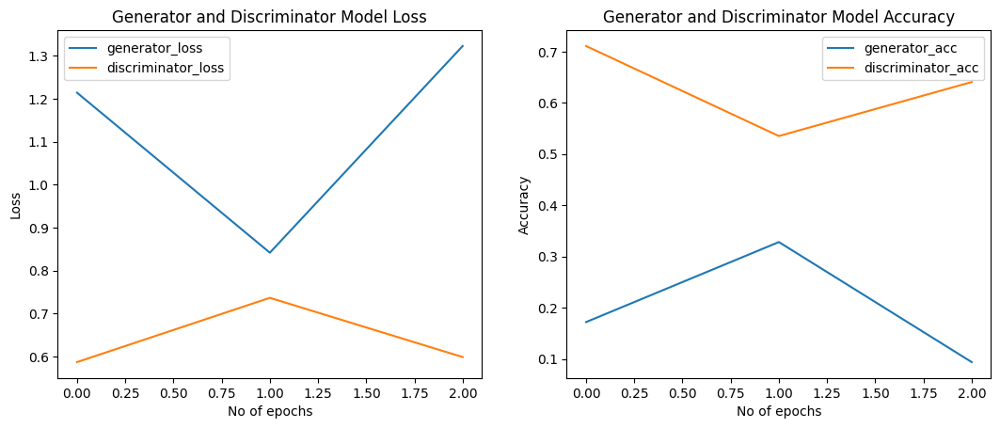

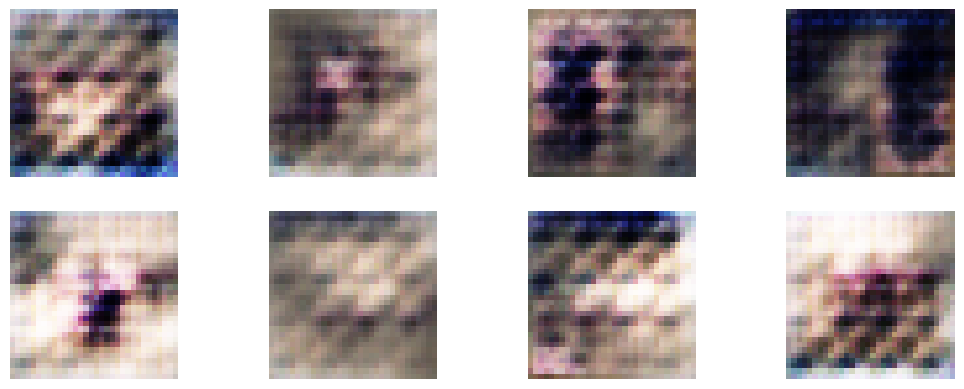

Iteration: 1410 - Generator loss: 1.1073 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.4467 - Discrimnator Accuracy: 80.86 %
Iteration: 1420 - Generator loss: 0.8932 - Generator Accuracy: 26.56 % - Discrimnator loss: 0.8239 - Discrimnator Accuracy: 48.05 %
Iteration: 1430 - Generator loss: 1.2369 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5226 - Discrimnator Accuracy: 74.61 %
Iteration: 1440 - Generator loss: 1.0679 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.5977 - Discrimnator Accuracy: 66.41 %
Iteration: 1450 - Generator loss: 1.1899 - Generator Accuracy: 5.47 % - Discrimnator loss: 0.5672 - Discrimnator Accuracy: 74.22 %
Iteration: 1460 - Generator loss: 1.2066 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.4923 - Discrimnator Accuracy: 79.69 %
Iteration: 1470 - Generator loss: 1.3690 - Generator Accuracy: 3.91 % - Discrimnator loss: 0.5558 - Discrimnator Accuracy: 73.83 %
Iteration: 1480 - Generator loss: 0.9211 - Generator Accuracy: 32.03 % - Discr

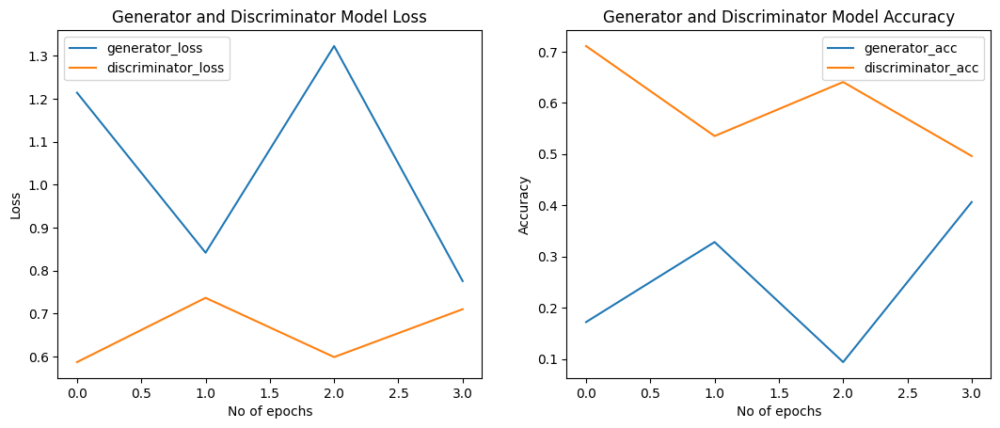

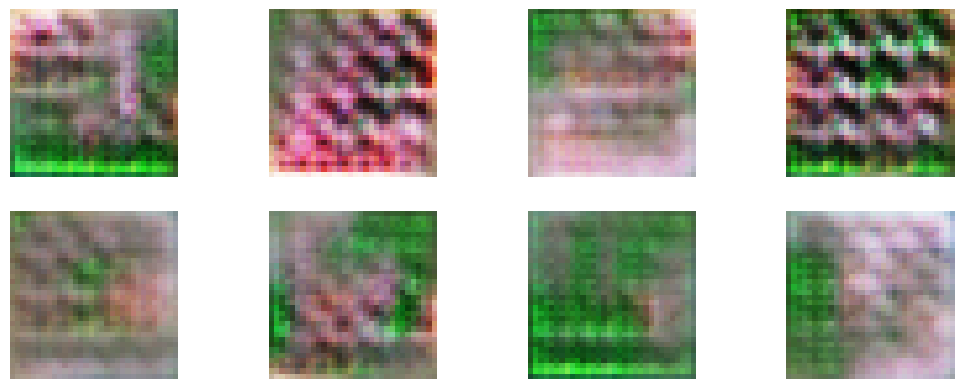

Iteration: 1880 - Generator loss: 1.1754 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5217 - Discrimnator Accuracy: 76.17 %
Iteration: 1890 - Generator loss: 1.1006 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.4604 - Discrimnator Accuracy: 78.12 %
Iteration: 1900 - Generator loss: 1.0485 - Generator Accuracy: 8.59 % - Discrimnator loss: 0.5952 - Discrimnator Accuracy: 69.53 %
Iteration: 1910 - Generator loss: 1.3159 - Generator Accuracy: 7.81 % - Discrimnator loss: 0.6230 - Discrimnator Accuracy: 64.06 %
Iteration: 1920 - Generator loss: 1.3259 - Generator Accuracy: 7.03 % - Discrimnator loss: 0.5624 - Discrimnator Accuracy: 71.09 %
Iteration: 1930 - Generator loss: 1.3838 - Generator Accuracy: 3.91 % - Discrimnator loss: 0.4508 - Discrimnator Accuracy: 80.86 %
Iteration: 1940 - Generator loss: 1.2680 - Generator Accuracy: 7.03 % - Discrimnator loss: 0.4318 - Discrimnator Accuracy: 83.98 %
Iteration: 1950 - Generator loss: 1.2482 - Generator Accuracy: 7.03 % - Discrimna

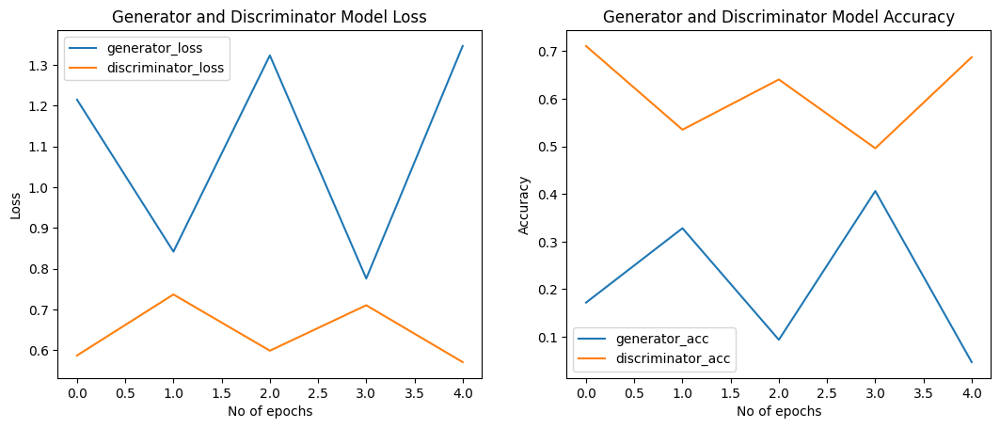

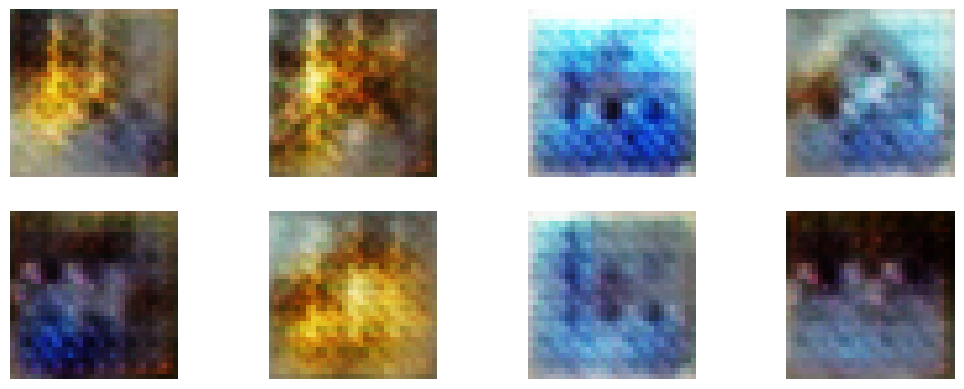

Iteration: 2350 - Generator loss: 1.1491 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.4999 - Discrimnator Accuracy: 78.52 %
Iteration: 2360 - Generator loss: 1.5349 - Generator Accuracy: 9.38 % - Discrimnator loss: 0.4712 - Discrimnator Accuracy: 80.08 %
Iteration: 2370 - Generator loss: 1.3951 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.5487 - Discrimnator Accuracy: 72.66 %
Iteration: 2380 - Generator loss: 1.4233 - Generator Accuracy: 7.03 % - Discrimnator loss: 0.4615 - Discrimnator Accuracy: 79.30 %
Iteration: 2390 - Generator loss: 1.5526 - Generator Accuracy: 0.78 % - Discrimnator loss: 0.4116 - Discrimnator Accuracy: 83.98 %
Iteration: 2400 - Generator loss: 1.2150 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.6115 - Discrimnator Accuracy: 74.22 %
Iteration: 2410 - Generator loss: 1.9250 - Generator Accuracy: 1.56 % - Discrimnator loss: 0.3712 - Discrimnator Accuracy: 84.77 %
Iteration: 2420 - Generator loss: 1.7381 - Generator Accuracy: 0.00 % - Discrimn

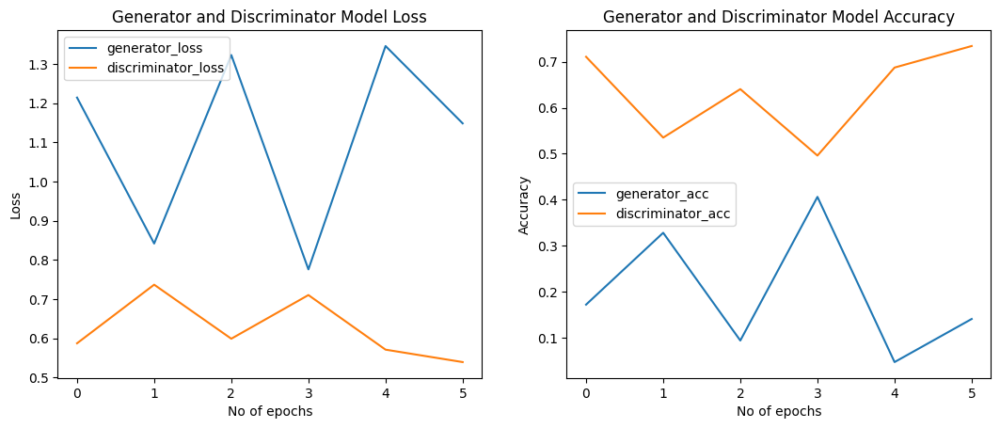

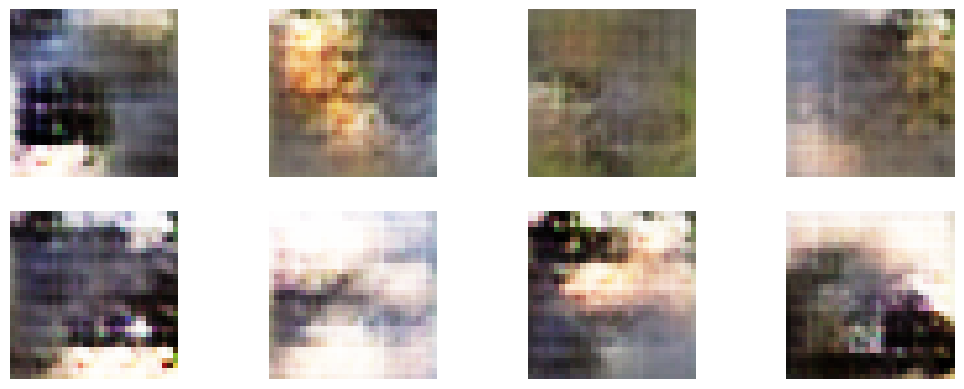

Iteration: 2810 - Generator loss: 1.2986 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.4949 - Discrimnator Accuracy: 74.22 %
Iteration: 2820 - Generator loss: 1.6539 - Generator Accuracy: 6.25 % - Discrimnator loss: 0.4456 - Discrimnator Accuracy: 82.03 %
Iteration: 2830 - Generator loss: 1.1468 - Generator Accuracy: 28.12 % - Discrimnator loss: 0.5188 - Discrimnator Accuracy: 76.17 %
Iteration: 2840 - Generator loss: 1.6861 - Generator Accuracy: 7.81 % - Discrimnator loss: 0.4857 - Discrimnator Accuracy: 76.95 %
Iteration: 2850 - Generator loss: 1.1601 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6355 - Discrimnator Accuracy: 65.62 %
Iteration: 2860 - Generator loss: 1.3567 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.5709 - Discrimnator Accuracy: 69.14 %
Iteration: 2870 - Generator loss: 1.3506 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.5330 - Discrimnator Accuracy: 75.39 %
Iteration: 2880 - Generator loss: 1.2475 - Generator Accuracy: 6.25 % - Discri

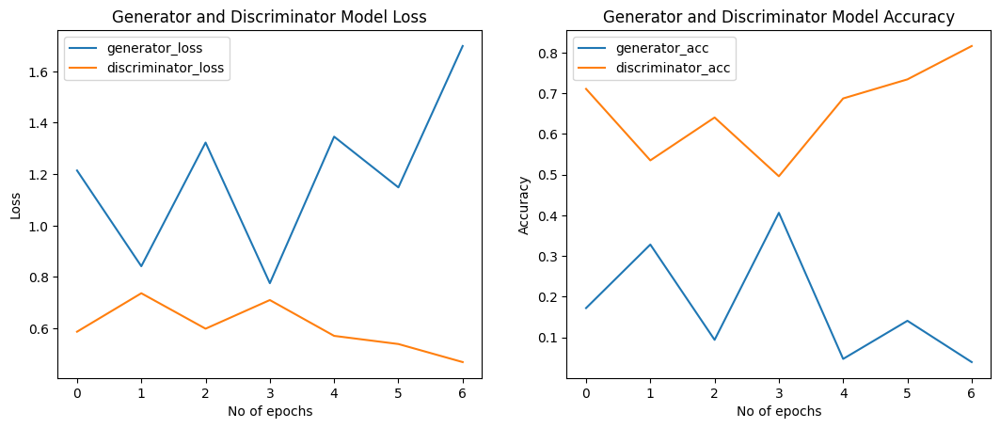

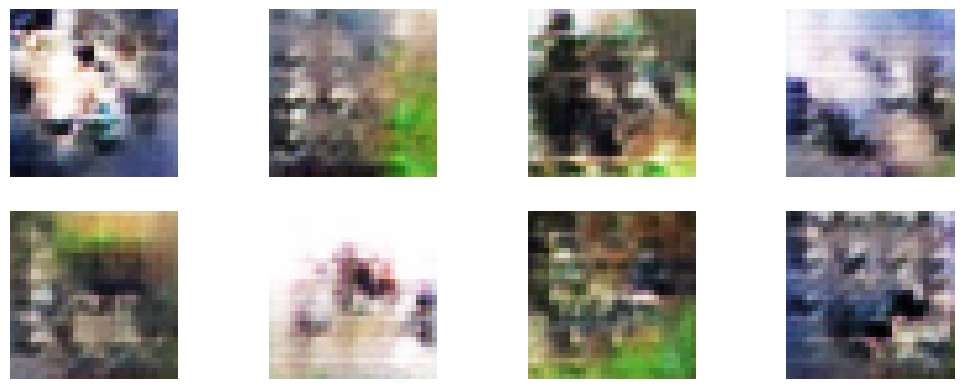

Iteration: 3280 - Generator loss: 1.3429 - Generator Accuracy: 11.72 % - Discrimnator loss: 0.5739 - Discrimnator Accuracy: 67.19 %
Iteration: 3290 - Generator loss: 1.2696 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.6614 - Discrimnator Accuracy: 62.50 %
Iteration: 3300 - Generator loss: 1.1571 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.5214 - Discrimnator Accuracy: 74.61 %
Iteration: 3310 - Generator loss: 1.2841 - Generator Accuracy: 6.25 % - Discrimnator loss: 0.4814 - Discrimnator Accuracy: 80.08 %
Iteration: 3320 - Generator loss: 1.2116 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.5275 - Discrimnator Accuracy: 70.31 %
Iteration: 3330 - Generator loss: 1.2800 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.4492 - Discrimnator Accuracy: 79.69 %
Iteration: 3340 - Generator loss: 1.1193 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.6304 - Discrimnator Accuracy: 67.58 %
Iteration: 3350 - Generator loss: 0.9647 - Generator Accuracy: 28.91 % - Disc

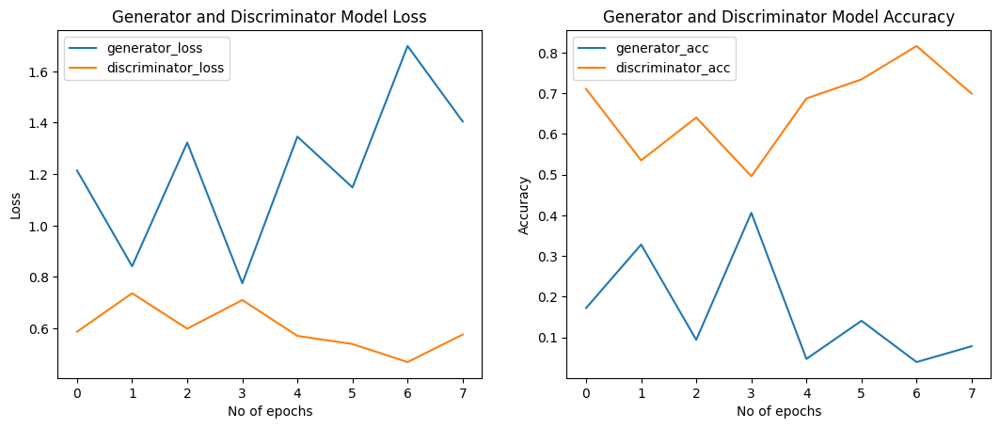

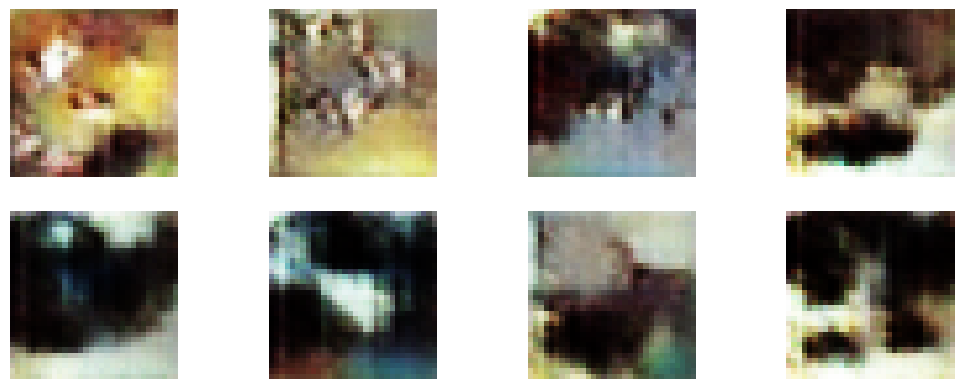

Iteration: 3750 - Generator loss: 1.4620 - Generator Accuracy: 3.91 % - Discrimnator loss: 0.6194 - Discrimnator Accuracy: 64.45 %
Iteration: 3760 - Generator loss: 1.3637 - Generator Accuracy: 5.47 % - Discrimnator loss: 0.4927 - Discrimnator Accuracy: 77.73 %
Iteration: 3770 - Generator loss: 1.4862 - Generator Accuracy: 3.91 % - Discrimnator loss: 0.5902 - Discrimnator Accuracy: 68.36 %
Iteration: 3780 - Generator loss: 1.3316 - Generator Accuracy: 7.81 % - Discrimnator loss: 0.5322 - Discrimnator Accuracy: 74.22 %
Iteration: 3790 - Generator loss: 1.0109 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6380 - Discrimnator Accuracy: 61.72 %
Iteration: 3800 - Generator loss: 1.1628 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.6480 - Discrimnator Accuracy: 65.23 %
Iteration: 3810 - Generator loss: 1.0524 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.6105 - Discrimnator Accuracy: 67.19 %
Iteration: 3820 - Generator loss: 1.1775 - Generator Accuracy: 6.25 % - Discrimn

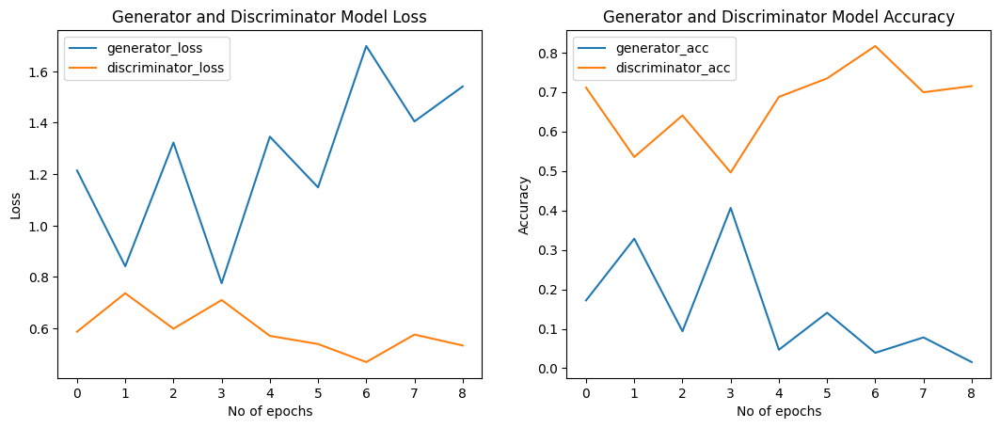

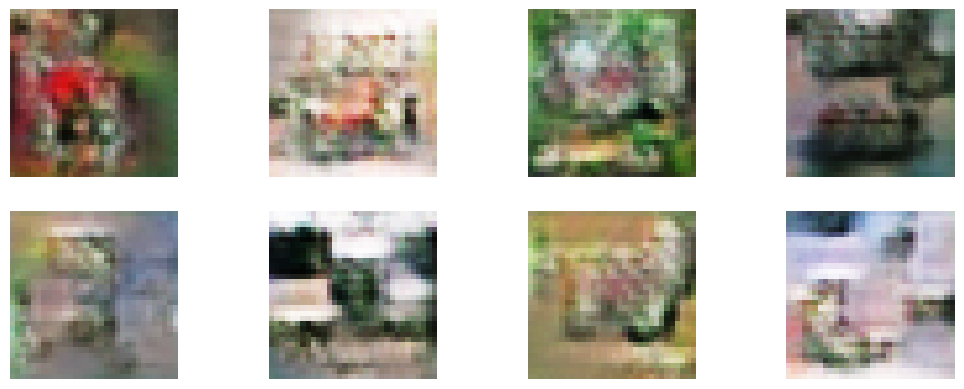

Iteration: 4220 - Generator loss: 1.4550 - Generator Accuracy: 8.59 % - Discrimnator loss: 0.4789 - Discrimnator Accuracy: 79.69 %
Iteration: 4230 - Generator loss: 1.2182 - Generator Accuracy: 7.03 % - Discrimnator loss: 0.5813 - Discrimnator Accuracy: 68.36 %
Iteration: 4240 - Generator loss: 1.2752 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.5239 - Discrimnator Accuracy: 74.22 %
Iteration: 4250 - Generator loss: 1.1297 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5713 - Discrimnator Accuracy: 67.58 %
Iteration: 4260 - Generator loss: 1.0584 - Generator Accuracy: 19.53 % - Discrimnator loss: 0.5215 - Discrimnator Accuracy: 69.53 %
Iteration: 4270 - Generator loss: 0.8759 - Generator Accuracy: 28.12 % - Discrimnator loss: 0.6355 - Discrimnator Accuracy: 62.89 %
Iteration: 4280 - Generator loss: 1.2443 - Generator Accuracy: 7.81 % - Discrimnator loss: 0.5957 - Discrimnator Accuracy: 65.23 %
Iteration: 4290 - Generator loss: 1.1438 - Generator Accuracy: 10.16 % - Discri

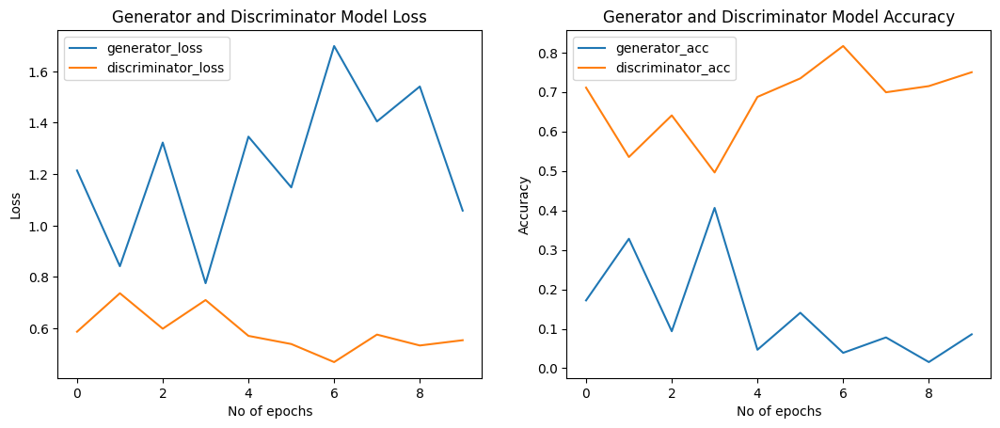

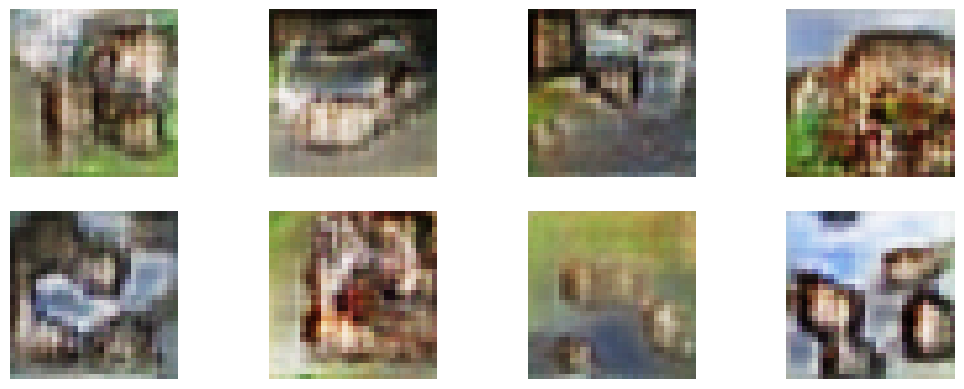

Iteration: 4690 - Generator loss: 0.9284 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.6354 - Discrimnator Accuracy: 61.33 %
Iteration: 4700 - Generator loss: 0.7878 - Generator Accuracy: 36.72 % - Discrimnator loss: 0.5826 - Discrimnator Accuracy: 69.14 %
Iteration: 4710 - Generator loss: 1.1710 - Generator Accuracy: 5.47 % - Discrimnator loss: 0.6042 - Discrimnator Accuracy: 67.19 %
Iteration: 4720 - Generator loss: 1.0178 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.5111 - Discrimnator Accuracy: 75.00 %
Iteration: 4730 - Generator loss: 0.8029 - Generator Accuracy: 34.38 % - Discrimnator loss: 0.6526 - Discrimnator Accuracy: 62.89 %
Iteration: 4740 - Generator loss: 0.9235 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.5644 - Discrimnator Accuracy: 73.05 %
Iteration: 4750 - Generator loss: 1.0567 - Generator Accuracy: 7.81 % - Discrimnator loss: 0.5496 - Discrimnator Accuracy: 72.66 %
Iteration: 4760 - Generator loss: 0.9823 - Generator Accuracy: 16.41 % - Discr

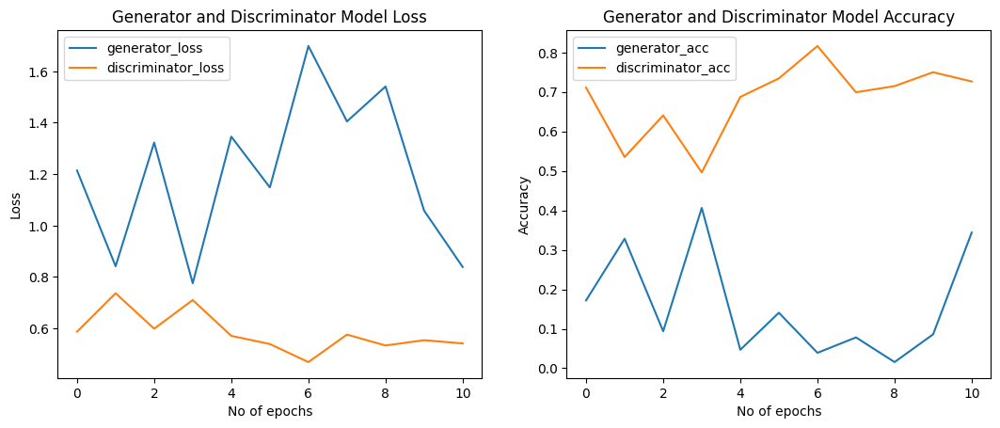

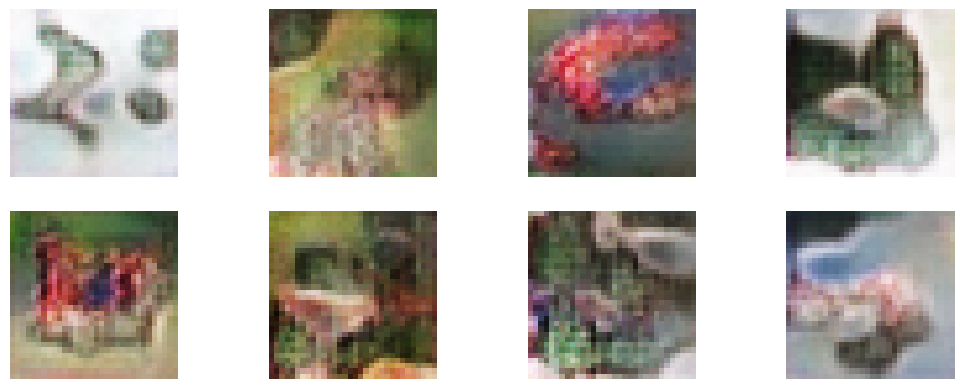

Iteration: 5150 - Generator loss: 1.1221 - Generator Accuracy: 5.47 % - Discrimnator loss: 0.6981 - Discrimnator Accuracy: 58.59 %
Iteration: 5160 - Generator loss: 0.8606 - Generator Accuracy: 27.34 % - Discrimnator loss: 0.6236 - Discrimnator Accuracy: 62.50 %
Iteration: 5170 - Generator loss: 0.9073 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.7119 - Discrimnator Accuracy: 58.59 %
Iteration: 5180 - Generator loss: 0.9031 - Generator Accuracy: 23.44 % - Discrimnator loss: 0.6336 - Discrimnator Accuracy: 60.94 %
Iteration: 5190 - Generator loss: 0.9489 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.6486 - Discrimnator Accuracy: 60.55 %
Iteration: 5200 - Generator loss: 0.9066 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.6056 - Discrimnator Accuracy: 65.62 %
Iteration: 5210 - Generator loss: 0.9085 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.5871 - Discrimnator Accuracy: 68.36 %
Iteration: 5220 - Generator loss: 1.0816 - Generator Accuracy: 8.59 % - Discr

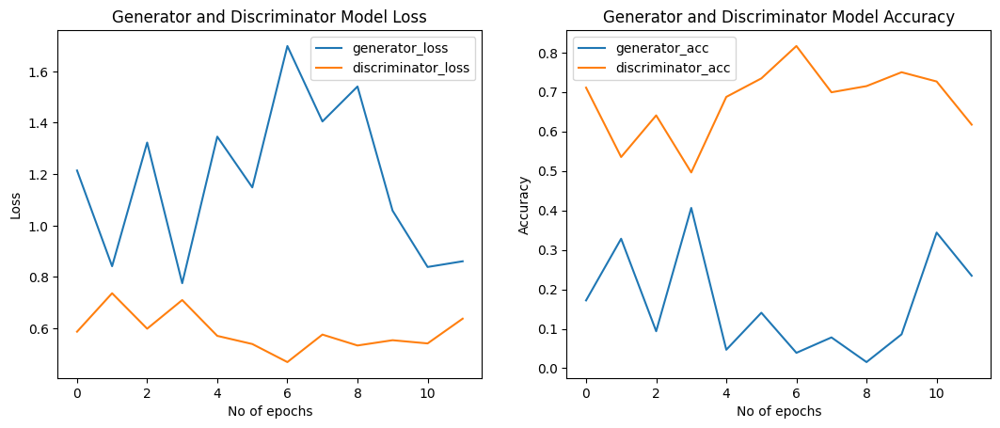

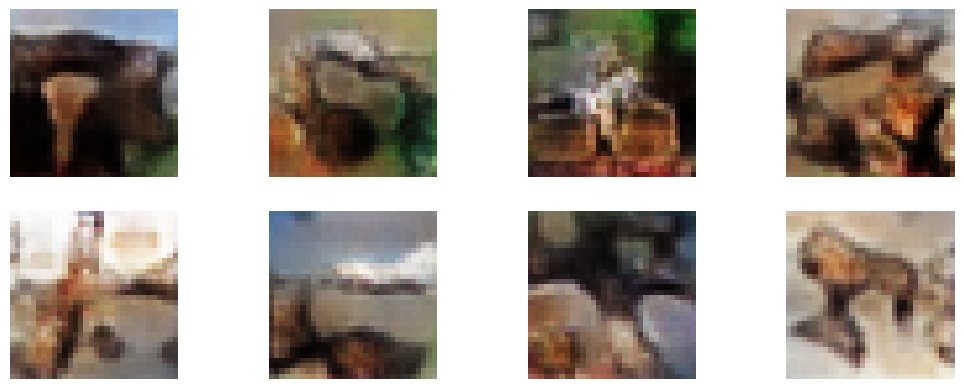

Iteration: 5620 - Generator loss: 0.9315 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.6251 - Discrimnator Accuracy: 64.84 %
Iteration: 5630 - Generator loss: 0.9237 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5868 - Discrimnator Accuracy: 66.80 %
Iteration: 5640 - Generator loss: 1.0379 - Generator Accuracy: 4.69 % - Discrimnator loss: 0.6532 - Discrimnator Accuracy: 61.72 %
Iteration: 5650 - Generator loss: 0.8896 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.6060 - Discrimnator Accuracy: 66.80 %
Iteration: 5660 - Generator loss: 0.9327 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6646 - Discrimnator Accuracy: 57.03 %
Iteration: 5670 - Generator loss: 1.0940 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.5857 - Discrimnator Accuracy: 68.36 %
Iteration: 5680 - Generator loss: 0.9918 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.5706 - Discrimnator Accuracy: 71.88 %
Iteration: 5690 - Generator loss: 0.9004 - Generator Accuracy: 17.19 % - Disc

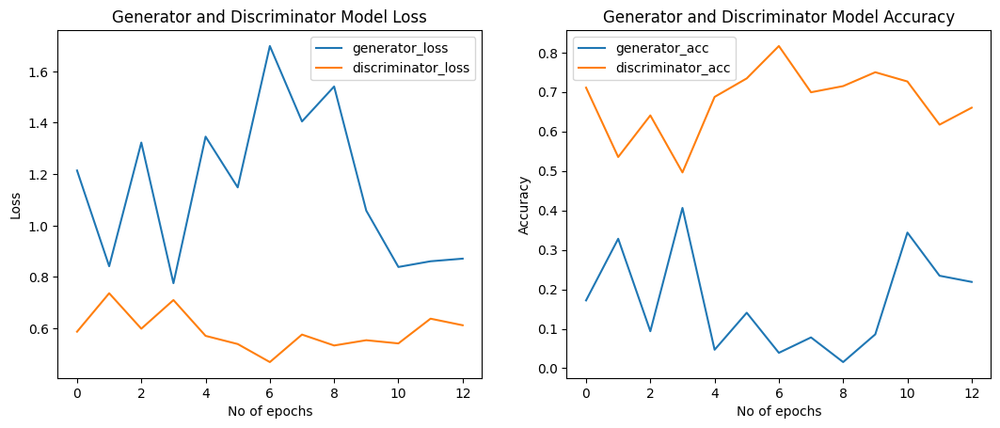

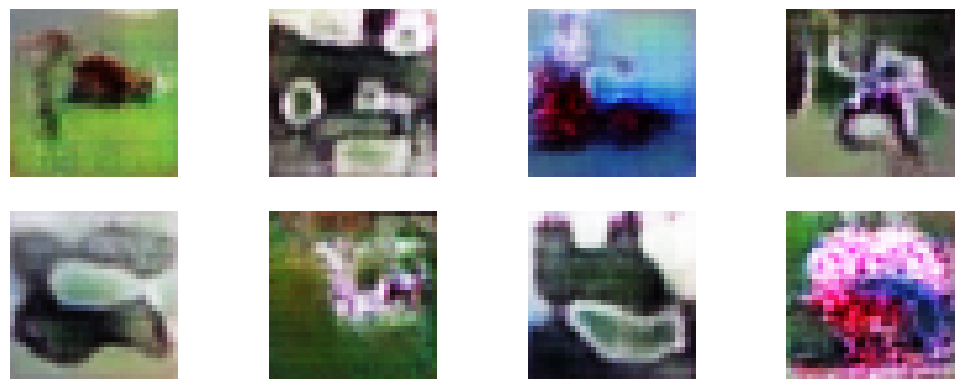

Iteration: 6090 - Generator loss: 0.9107 - Generator Accuracy: 27.34 % - Discrimnator loss: 0.6705 - Discrimnator Accuracy: 58.59 %
Iteration: 6100 - Generator loss: 1.0590 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.6318 - Discrimnator Accuracy: 63.67 %
Iteration: 6110 - Generator loss: 0.9120 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.6463 - Discrimnator Accuracy: 58.98 %
Iteration: 6120 - Generator loss: 0.8116 - Generator Accuracy: 32.81 % - Discrimnator loss: 0.6089 - Discrimnator Accuracy: 66.80 %
Iteration: 6130 - Generator loss: 0.7862 - Generator Accuracy: 35.94 % - Discrimnator loss: 0.6067 - Discrimnator Accuracy: 66.80 %
Iteration: 6140 - Generator loss: 0.9930 - Generator Accuracy: 9.38 % - Discrimnator loss: 0.6702 - Discrimnator Accuracy: 58.98 %
Iteration: 6150 - Generator loss: 0.7939 - Generator Accuracy: 32.81 % - Discrimnator loss: 0.5840 - Discrimnator Accuracy: 67.58 %
Iteration: 6160 - Generator loss: 1.0198 - Generator Accuracy: 7.81 % - Discr

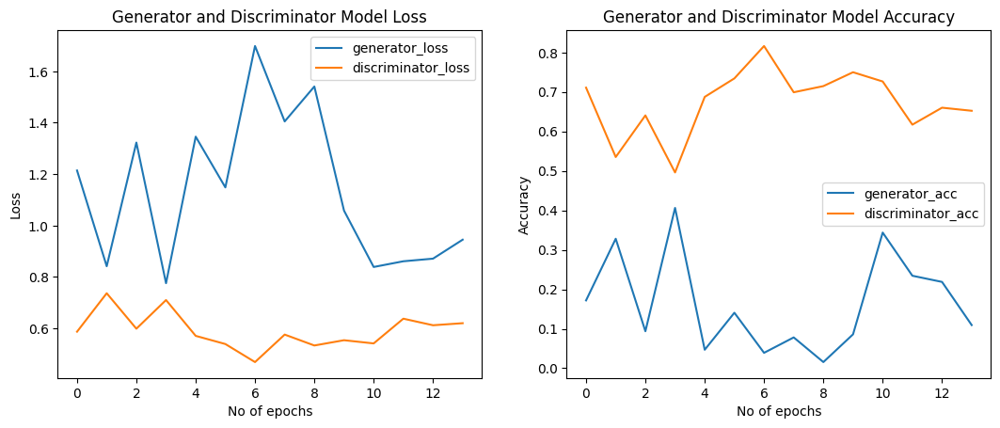

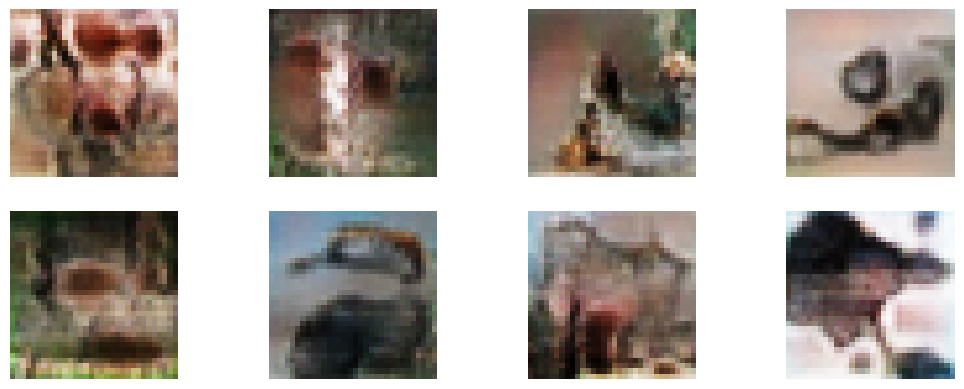

Iteration: 6560 - Generator loss: 0.8702 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.5899 - Discrimnator Accuracy: 66.41 %
Iteration: 6570 - Generator loss: 1.0629 - Generator Accuracy: 9.38 % - Discrimnator loss: 0.6267 - Discrimnator Accuracy: 63.28 %
Iteration: 6580 - Generator loss: 0.9483 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.6269 - Discrimnator Accuracy: 64.84 %
Iteration: 6590 - Generator loss: 0.9075 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.6108 - Discrimnator Accuracy: 66.02 %
Iteration: 6600 - Generator loss: 1.0085 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.6206 - Discrimnator Accuracy: 65.23 %
Iteration: 6610 - Generator loss: 0.9881 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.6178 - Discrimnator Accuracy: 66.41 %
Iteration: 6620 - Generator loss: 0.8417 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.5655 - Discrimnator Accuracy: 69.92 %
Iteration: 6630 - Generator loss: 0.9286 - Generator Accuracy: 18.75 % - Disc

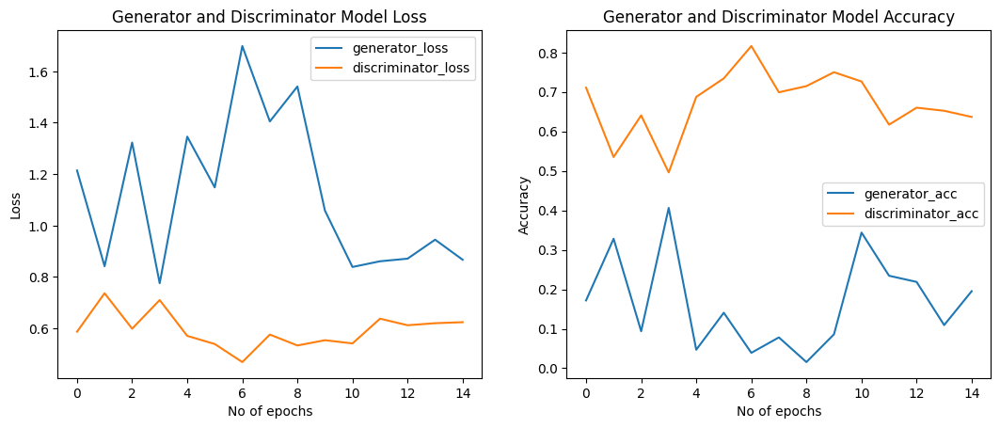

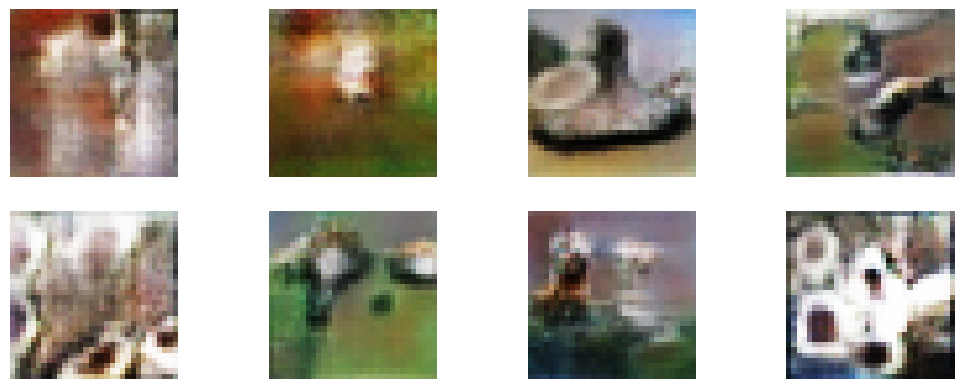

Iteration: 7030 - Generator loss: 1.0002 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.6201 - Discrimnator Accuracy: 66.80 %
Iteration: 7040 - Generator loss: 1.0843 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.5974 - Discrimnator Accuracy: 63.28 %
Iteration: 7050 - Generator loss: 0.8958 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.6635 - Discrimnator Accuracy: 57.81 %
Iteration: 7060 - Generator loss: 0.9213 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.6384 - Discrimnator Accuracy: 66.80 %
Iteration: 7070 - Generator loss: 0.8852 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.6269 - Discrimnator Accuracy: 65.62 %
Iteration: 7080 - Generator loss: 0.8291 - Generator Accuracy: 28.12 % - Discrimnator loss: 0.6337 - Discrimnator Accuracy: 63.28 %
Iteration: 7090 - Generator loss: 0.8905 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.6007 - Discrimnator Accuracy: 67.19 %
Iteration: 7100 - Generator loss: 0.9286 - Generator Accuracy: 21.09 % - Dis

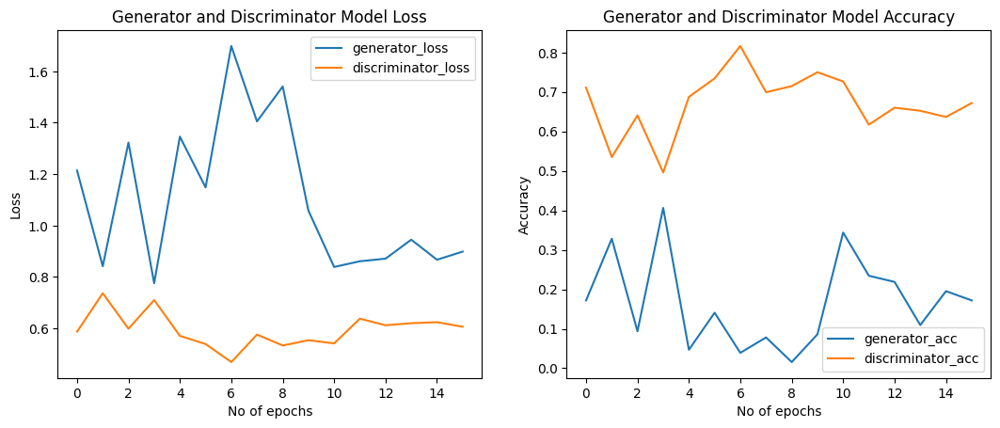

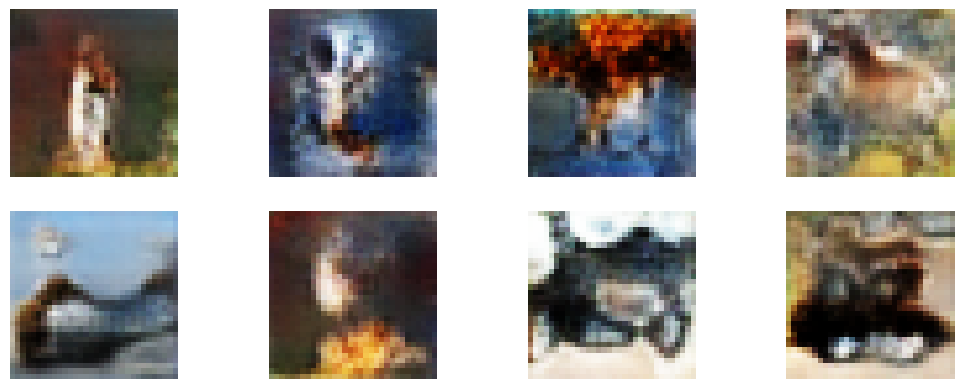

Iteration: 7490 - Generator loss: 1.0126 - Generator Accuracy: 7.03 % - Discrimnator loss: 0.6151 - Discrimnator Accuracy: 65.62 %
Iteration: 7500 - Generator loss: 0.8872 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.6227 - Discrimnator Accuracy: 64.45 %
Iteration: 7510 - Generator loss: 0.7884 - Generator Accuracy: 36.72 % - Discrimnator loss: 0.5898 - Discrimnator Accuracy: 69.53 %
Iteration: 7520 - Generator loss: 0.8775 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5927 - Discrimnator Accuracy: 68.36 %
Iteration: 7530 - Generator loss: 0.9175 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.6435 - Discrimnator Accuracy: 62.11 %
Iteration: 7540 - Generator loss: 0.8954 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.6136 - Discrimnator Accuracy: 64.84 %
Iteration: 7550 - Generator loss: 0.8388 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.5986 - Discrimnator Accuracy: 66.41 %
Iteration: 7560 - Generator loss: 0.9532 - Generator Accuracy: 11.72 % - Disc

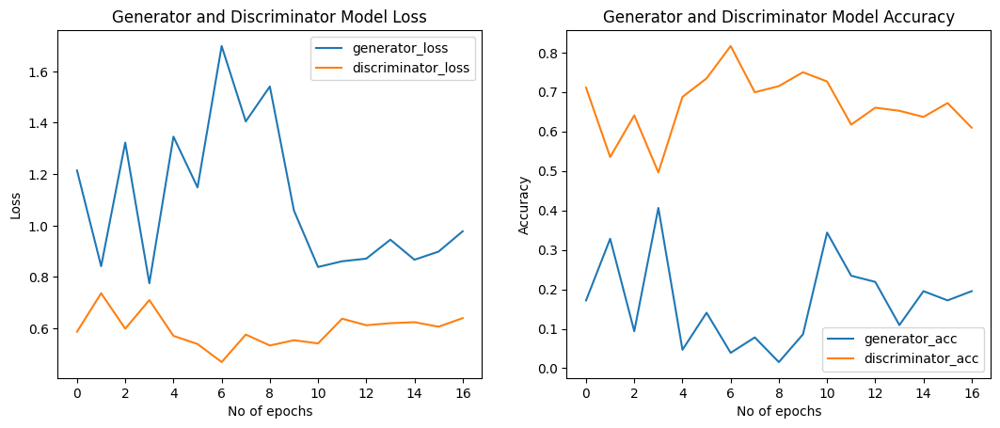

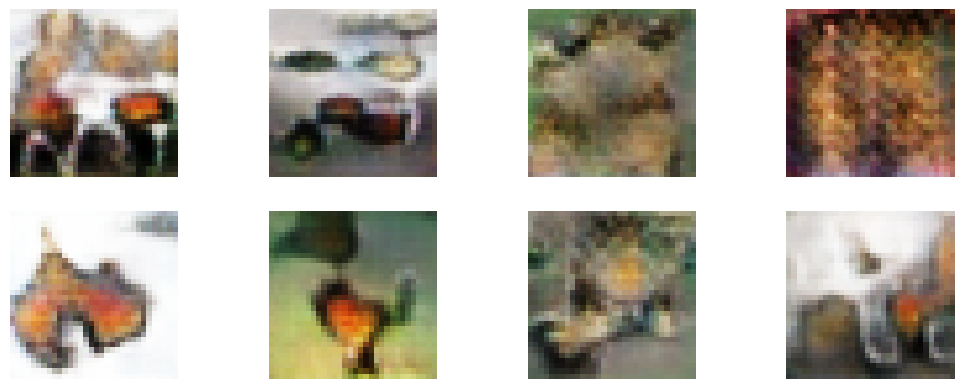

Iteration: 7960 - Generator loss: 0.9284 - Generator Accuracy: 7.81 % - Discrimnator loss: 0.6204 - Discrimnator Accuracy: 61.72 %
Iteration: 7970 - Generator loss: 1.0288 - Generator Accuracy: 9.38 % - Discrimnator loss: 0.6355 - Discrimnator Accuracy: 62.89 %
Iteration: 7980 - Generator loss: 0.8959 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.6405 - Discrimnator Accuracy: 60.94 %
Iteration: 7990 - Generator loss: 0.9542 - Generator Accuracy: 11.72 % - Discrimnator loss: 0.6151 - Discrimnator Accuracy: 63.28 %
Iteration: 8000 - Generator loss: 0.9015 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.6481 - Discrimnator Accuracy: 59.77 %
Iteration: 8010 - Generator loss: 0.8457 - Generator Accuracy: 28.12 % - Discrimnator loss: 0.6409 - Discrimnator Accuracy: 60.16 %
Iteration: 8020 - Generator loss: 1.0365 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.6129 - Discrimnator Accuracy: 65.62 %
Iteration: 8030 - Generator loss: 1.0230 - Generator Accuracy: 10.16 % - Discr

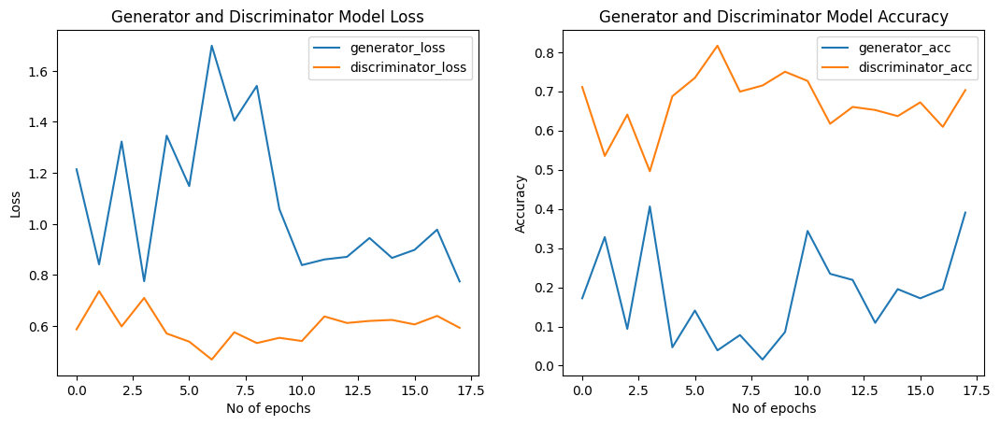

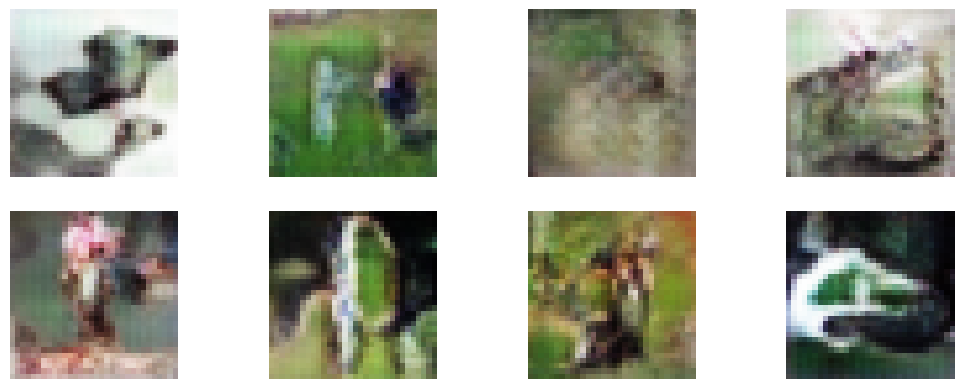

Iteration: 8430 - Generator loss: 0.9251 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.6730 - Discrimnator Accuracy: 58.98 %
Iteration: 8440 - Generator loss: 1.1257 - Generator Accuracy: 9.38 % - Discrimnator loss: 0.6064 - Discrimnator Accuracy: 67.58 %
Iteration: 8450 - Generator loss: 1.0225 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6244 - Discrimnator Accuracy: 62.50 %
Iteration: 8460 - Generator loss: 0.9597 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.6283 - Discrimnator Accuracy: 65.23 %
Iteration: 8470 - Generator loss: 1.0136 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.6195 - Discrimnator Accuracy: 65.62 %
Iteration: 8480 - Generator loss: 0.8793 - Generator Accuracy: 27.34 % - Discrimnator loss: 0.6037 - Discrimnator Accuracy: 68.36 %
Iteration: 8490 - Generator loss: 0.8982 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.7350 - Discrimnator Accuracy: 50.78 %
Iteration: 8500 - Generator loss: 0.8012 - Generator Accuracy: 29.69 % - Disc

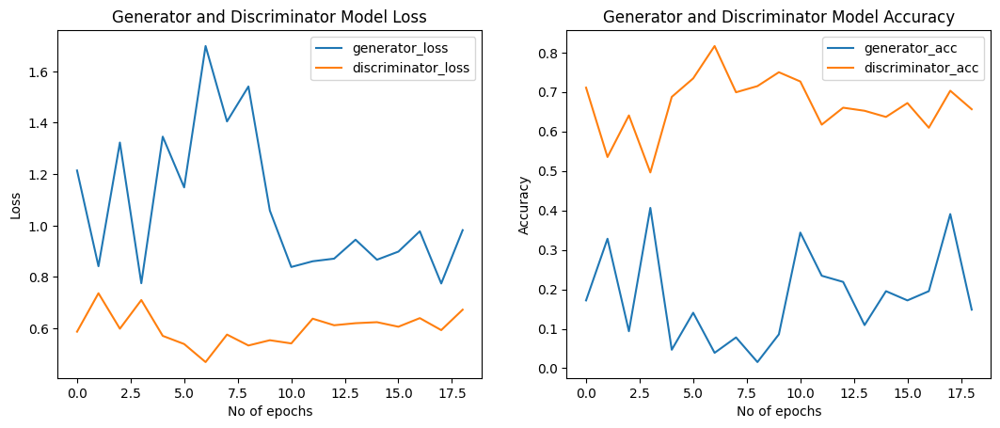

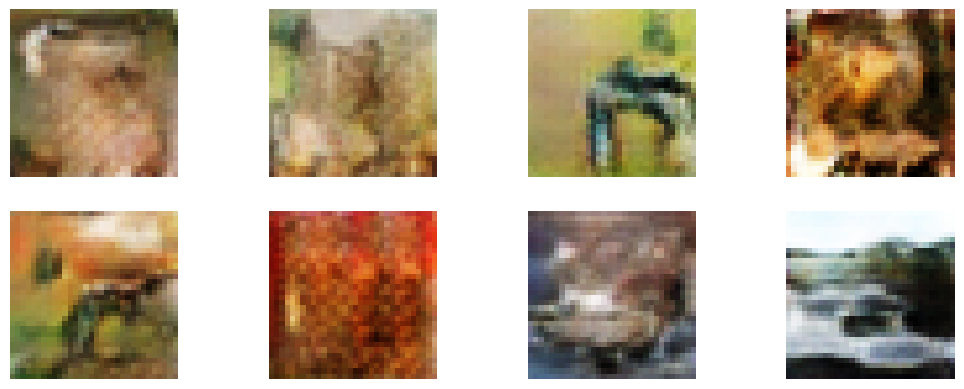

Iteration: 8900 - Generator loss: 1.0517 - Generator Accuracy: 5.47 % - Discrimnator loss: 0.6634 - Discrimnator Accuracy: 57.03 %
Iteration: 8910 - Generator loss: 1.0112 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.6114 - Discrimnator Accuracy: 65.62 %
Iteration: 8920 - Generator loss: 0.9606 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.6411 - Discrimnator Accuracy: 59.38 %
Iteration: 8930 - Generator loss: 0.8093 - Generator Accuracy: 36.72 % - Discrimnator loss: 0.5974 - Discrimnator Accuracy: 69.53 %
Iteration: 8940 - Generator loss: 0.9630 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5991 - Discrimnator Accuracy: 70.70 %
Iteration: 8950 - Generator loss: 0.8910 - Generator Accuracy: 19.53 % - Discrimnator loss: 0.6251 - Discrimnator Accuracy: 62.11 %
Iteration: 8960 - Generator loss: 0.8598 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.6111 - Discrimnator Accuracy: 66.41 %
Iteration: 8970 - Generator loss: 0.9375 - Generator Accuracy: 19.53 % - Disc

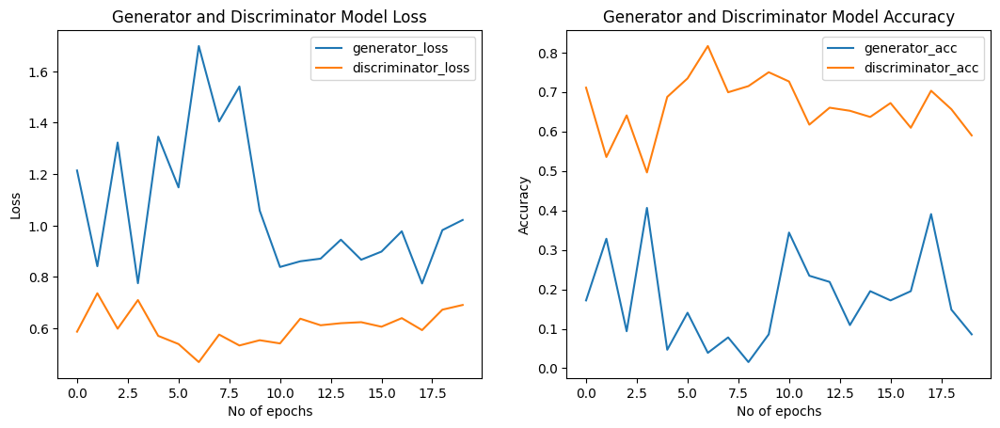

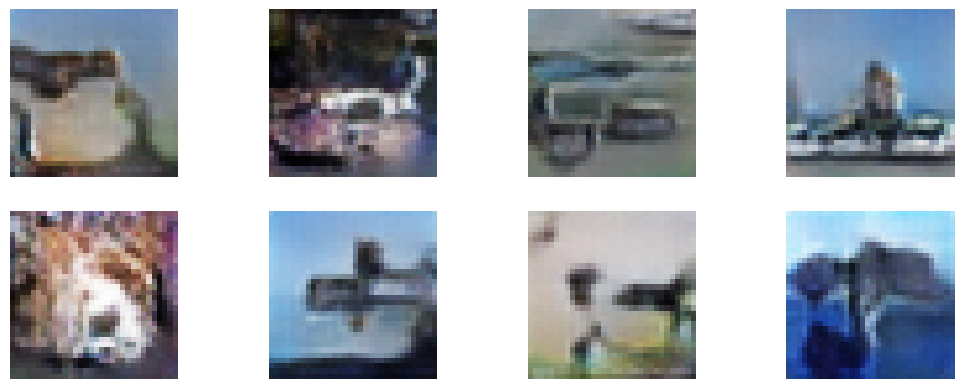

Iteration: 9370 - Generator loss: 0.8609 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.6564 - Discrimnator Accuracy: 58.98 %
Iteration: 9380 - Generator loss: 0.9321 - Generator Accuracy: 19.53 % - Discrimnator loss: 0.5785 - Discrimnator Accuracy: 70.31 %
Iteration: 9390 - Generator loss: 0.9444 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.6202 - Discrimnator Accuracy: 63.67 %
Iteration: 9400 - Generator loss: 0.7608 - Generator Accuracy: 45.31 % - Discrimnator loss: 0.6417 - Discrimnator Accuracy: 60.55 %
Iteration: 9410 - Generator loss: 0.9715 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.6047 - Discrimnator Accuracy: 67.19 %
Iteration: 9420 - Generator loss: 0.8057 - Generator Accuracy: 31.25 % - Discrimnator loss: 0.6143 - Discrimnator Accuracy: 67.97 %
Iteration: 9430 - Generator loss: 0.8981 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6067 - Discrimnator Accuracy: 68.75 %
Iteration: 9440 - Generator loss: 0.8850 - Generator Accuracy: 25.00 % - Dis

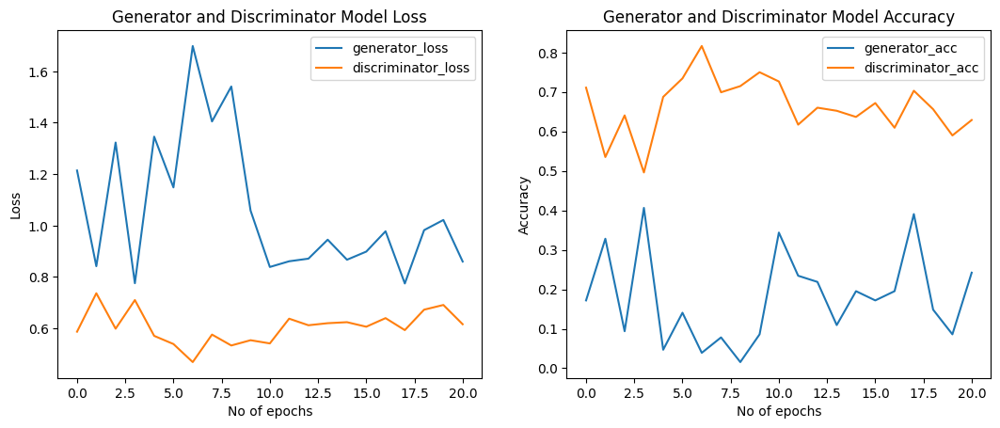

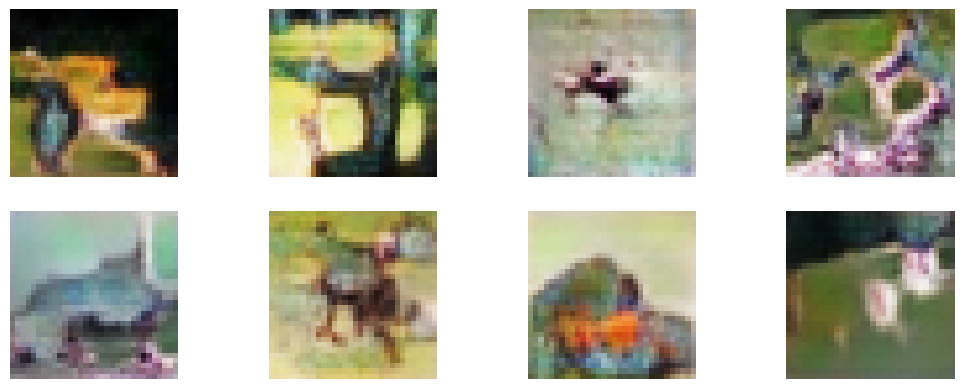

Iteration: 9830 - Generator loss: 0.9570 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.6558 - Discrimnator Accuracy: 60.94 %
Iteration: 9840 - Generator loss: 0.8281 - Generator Accuracy: 28.91 % - Discrimnator loss: 0.6357 - Discrimnator Accuracy: 63.67 %
Iteration: 9850 - Generator loss: 0.8955 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.6577 - Discrimnator Accuracy: 60.16 %
Iteration: 9860 - Generator loss: 0.9454 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.6378 - Discrimnator Accuracy: 62.11 %
Iteration: 9870 - Generator loss: 0.9829 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5941 - Discrimnator Accuracy: 66.02 %
Iteration: 9880 - Generator loss: 0.8325 - Generator Accuracy: 26.56 % - Discrimnator loss: 0.6275 - Discrimnator Accuracy: 66.41 %
Iteration: 9890 - Generator loss: 0.9863 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.6823 - Discrimnator Accuracy: 58.20 %
Iteration: 9900 - Generator loss: 0.9736 - Generator Accuracy: 16.41 % - Dis

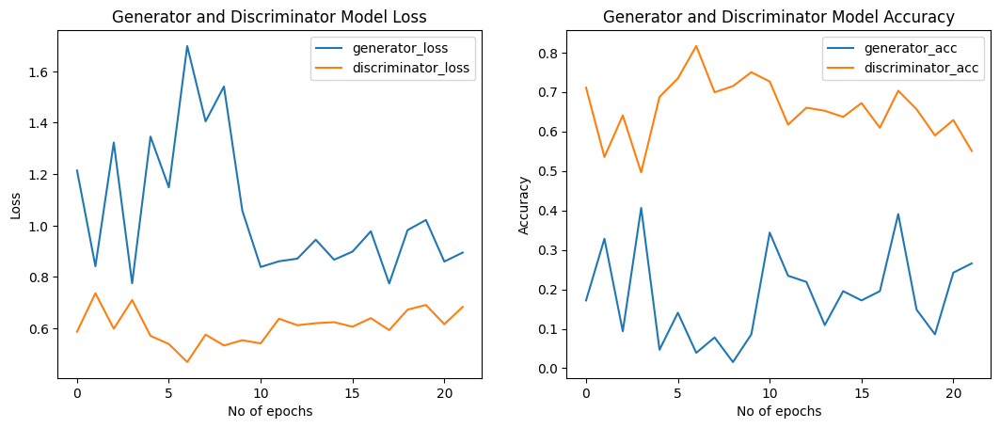

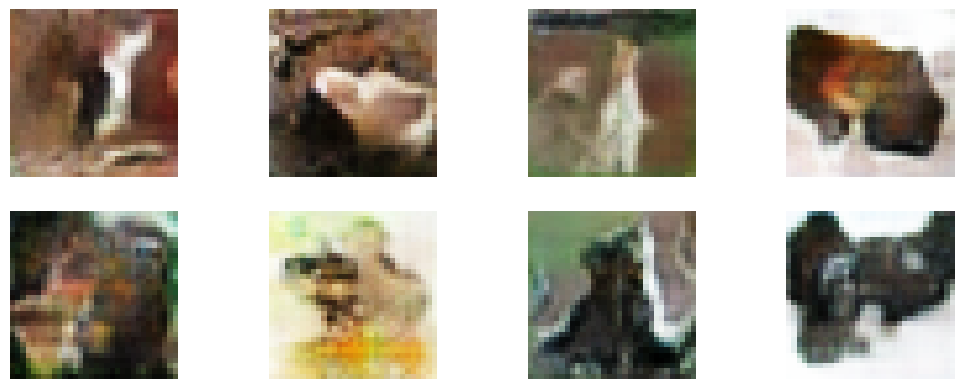

Iteration: 10300 - Generator loss: 0.7611 - Generator Accuracy: 38.28 % - Discrimnator loss: 0.6102 - Discrimnator Accuracy: 71.09 %
Iteration: 10310 - Generator loss: 0.9593 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6368 - Discrimnator Accuracy: 60.94 %
Iteration: 10320 - Generator loss: 0.8389 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.6319 - Discrimnator Accuracy: 64.84 %
Iteration: 10330 - Generator loss: 0.8803 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.6577 - Discrimnator Accuracy: 60.16 %
Iteration: 10340 - Generator loss: 0.8757 - Generator Accuracy: 23.44 % - Discrimnator loss: 0.6517 - Discrimnator Accuracy: 62.11 %
Iteration: 10350 - Generator loss: 0.8859 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.6040 - Discrimnator Accuracy: 67.19 %
Iteration: 10360 - Generator loss: 0.9755 - Generator Accuracy: 11.72 % - Discrimnator loss: 0.6093 - Discrimnator Accuracy: 66.02 %
Iteration: 10370 - Generator loss: 0.6792 - Generator Accuracy: 50.78

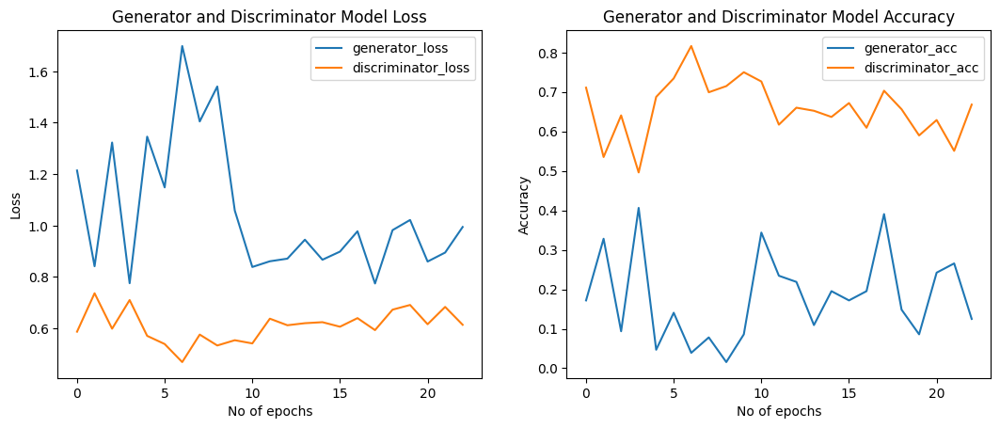

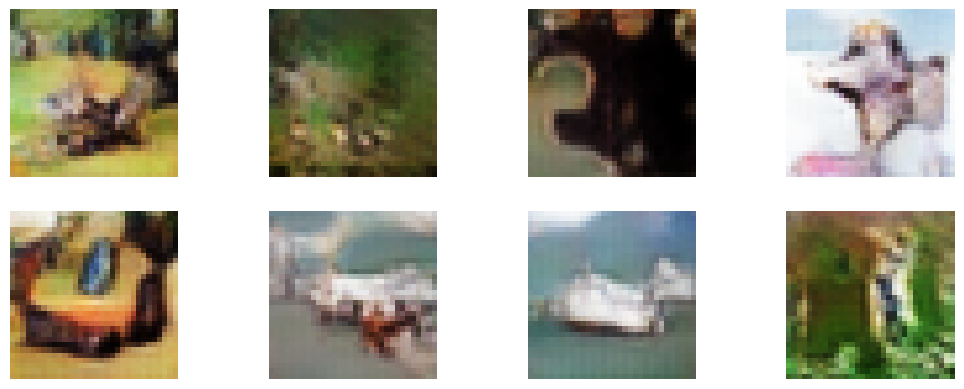

Iteration: 10770 - Generator loss: 0.9463 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.6215 - Discrimnator Accuracy: 66.80 %
Iteration: 10780 - Generator loss: 0.9996 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5596 - Discrimnator Accuracy: 68.75 %
Iteration: 10790 - Generator loss: 0.8842 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.6517 - Discrimnator Accuracy: 59.38 %
Iteration: 10800 - Generator loss: 1.1112 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.5876 - Discrimnator Accuracy: 65.62 %
Iteration: 10810 - Generator loss: 0.9511 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.6077 - Discrimnator Accuracy: 67.19 %
Iteration: 10820 - Generator loss: 0.9857 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.6278 - Discrimnator Accuracy: 58.59 %
Iteration: 10830 - Generator loss: 0.8728 - Generator Accuracy: 23.44 % - Discrimnator loss: 0.6176 - Discrimnator Accuracy: 64.84 %
Iteration: 10840 - Generator loss: 0.9074 - Generator Accuracy: 21.88

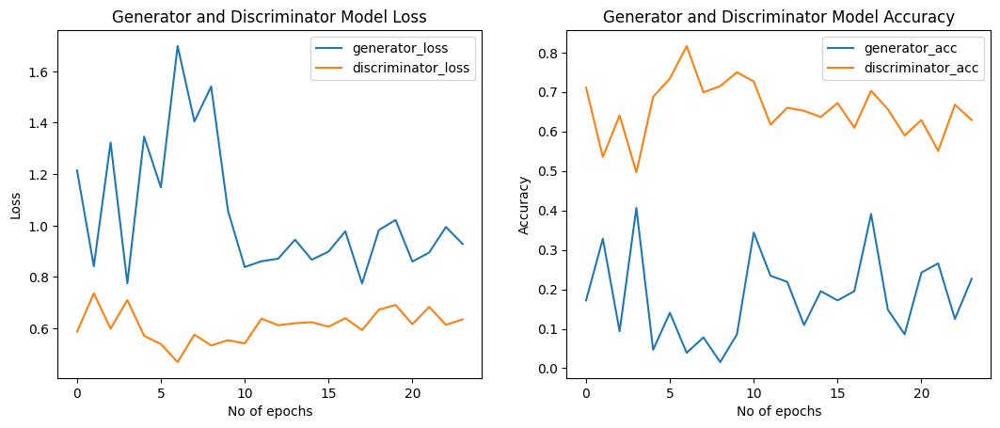

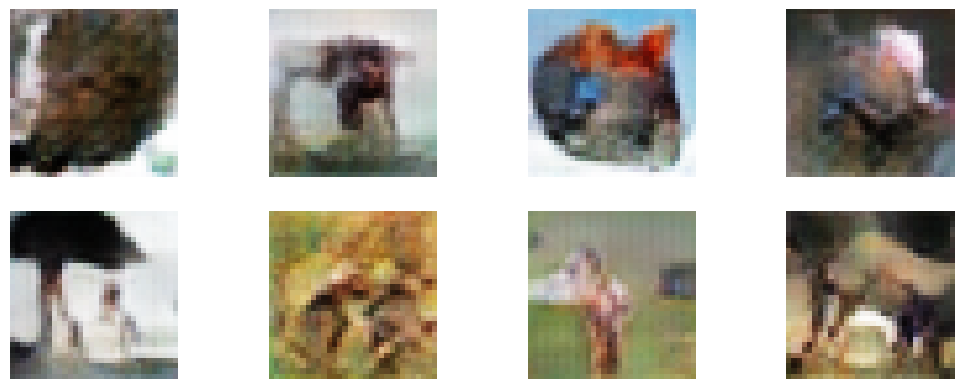

Iteration: 11240 - Generator loss: 0.7879 - Generator Accuracy: 35.16 % - Discrimnator loss: 0.6088 - Discrimnator Accuracy: 66.02 %
Iteration: 11250 - Generator loss: 0.9730 - Generator Accuracy: 19.53 % - Discrimnator loss: 0.5853 - Discrimnator Accuracy: 67.58 %
Iteration: 11260 - Generator loss: 0.9720 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.6221 - Discrimnator Accuracy: 65.23 %
Iteration: 11270 - Generator loss: 1.0221 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5626 - Discrimnator Accuracy: 71.88 %
Iteration: 11280 - Generator loss: 0.8756 - Generator Accuracy: 31.25 % - Discrimnator loss: 0.6241 - Discrimnator Accuracy: 60.94 %
Iteration: 11290 - Generator loss: 0.9148 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.6327 - Discrimnator Accuracy: 65.23 %
Iteration: 11300 - Generator loss: 0.9338 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6184 - Discrimnator Accuracy: 65.62 %
Iteration: 11310 - Generator loss: 1.1286 - Generator Accuracy: 9.38 

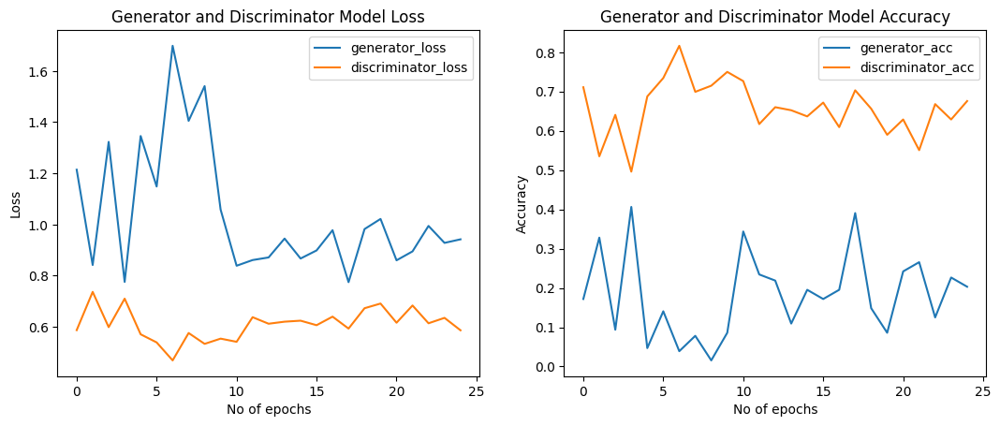

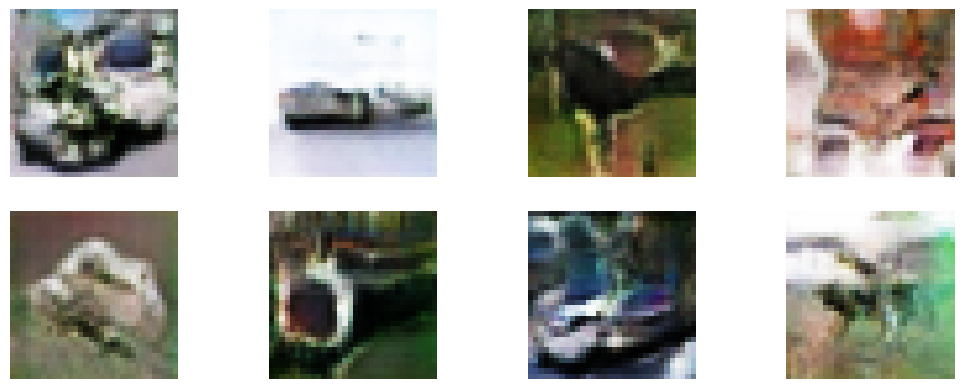

Iteration: 11710 - Generator loss: 1.0925 - Generator Accuracy: 7.81 % - Discrimnator loss: 0.6136 - Discrimnator Accuracy: 64.45 %
Iteration: 11720 - Generator loss: 0.8230 - Generator Accuracy: 40.62 % - Discrimnator loss: 0.5979 - Discrimnator Accuracy: 65.62 %
Iteration: 11730 - Generator loss: 0.9313 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.6089 - Discrimnator Accuracy: 65.23 %
Iteration: 11740 - Generator loss: 1.0317 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.6120 - Discrimnator Accuracy: 65.62 %
Iteration: 11750 - Generator loss: 0.8854 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6120 - Discrimnator Accuracy: 63.28 %
Iteration: 11760 - Generator loss: 0.9999 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.6833 - Discrimnator Accuracy: 58.98 %
Iteration: 11770 - Generator loss: 0.8773 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.6283 - Discrimnator Accuracy: 64.06 %
Iteration: 11780 - Generator loss: 0.9582 - Generator Accuracy: 17.97 

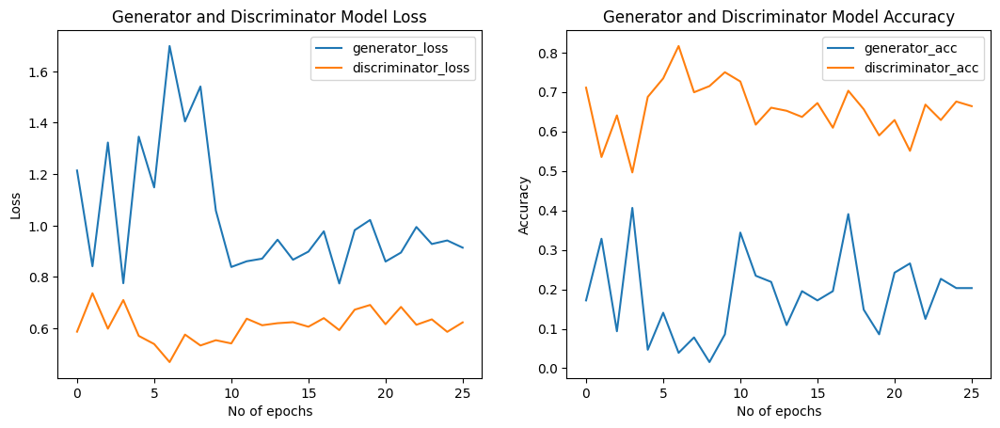

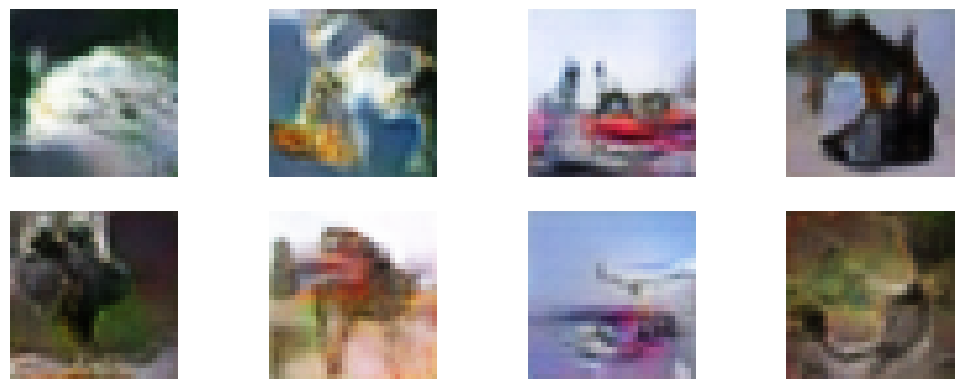

Iteration: 12170 - Generator loss: 0.9026 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.6499 - Discrimnator Accuracy: 60.94 %
Iteration: 12180 - Generator loss: 0.7563 - Generator Accuracy: 46.09 % - Discrimnator loss: 0.6223 - Discrimnator Accuracy: 62.50 %
Iteration: 12190 - Generator loss: 0.6872 - Generator Accuracy: 53.91 % - Discrimnator loss: 0.6295 - Discrimnator Accuracy: 61.33 %
Iteration: 12200 - Generator loss: 1.0086 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.6247 - Discrimnator Accuracy: 63.28 %
Iteration: 12210 - Generator loss: 0.8794 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5987 - Discrimnator Accuracy: 68.75 %
Iteration: 12220 - Generator loss: 0.8778 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.5655 - Discrimnator Accuracy: 71.48 %
Iteration: 12230 - Generator loss: 0.8465 - Generator Accuracy: 27.34 % - Discrimnator loss: 0.6355 - Discrimnator Accuracy: 63.67 %
Iteration: 12240 - Generator loss: 1.0132 - Generator Accuracy: 11.72

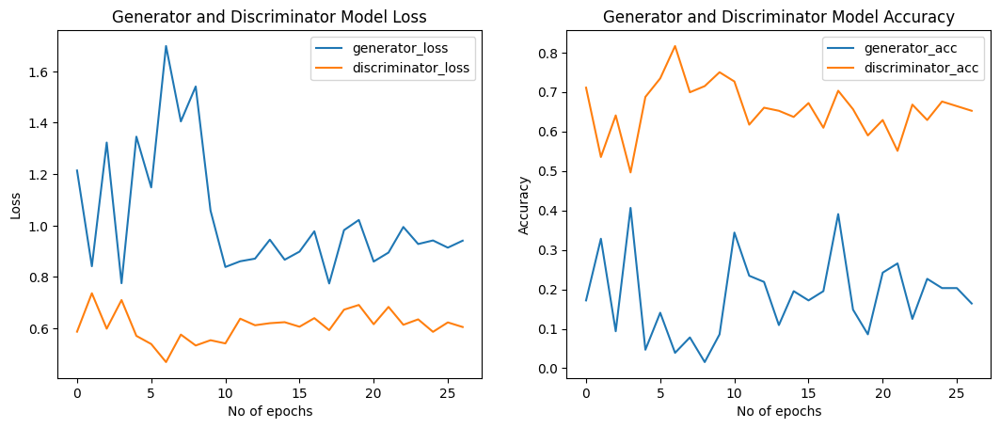

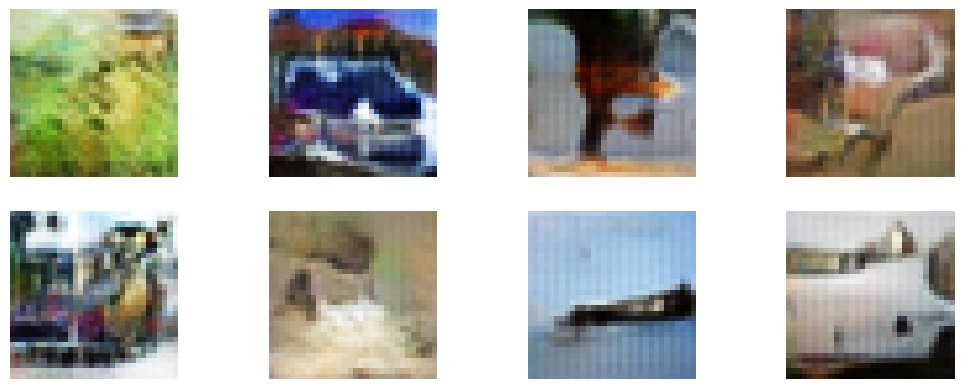

Iteration: 12640 - Generator loss: 0.9221 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.6287 - Discrimnator Accuracy: 63.28 %
Iteration: 12650 - Generator loss: 0.8707 - Generator Accuracy: 30.47 % - Discrimnator loss: 0.5523 - Discrimnator Accuracy: 69.53 %
Iteration: 12660 - Generator loss: 1.0209 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5915 - Discrimnator Accuracy: 69.14 %
Iteration: 12670 - Generator loss: 0.8457 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.6183 - Discrimnator Accuracy: 64.45 %
Iteration: 12680 - Generator loss: 0.9581 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.6290 - Discrimnator Accuracy: 62.50 %
Iteration: 12690 - Generator loss: 0.8688 - Generator Accuracy: 31.25 % - Discrimnator loss: 0.6065 - Discrimnator Accuracy: 67.97 %
Iteration: 12700 - Generator loss: 0.9727 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.5814 - Discrimnator Accuracy: 71.48 %
Iteration: 12710 - Generator loss: 0.9474 - Generator Accuracy: 16.41

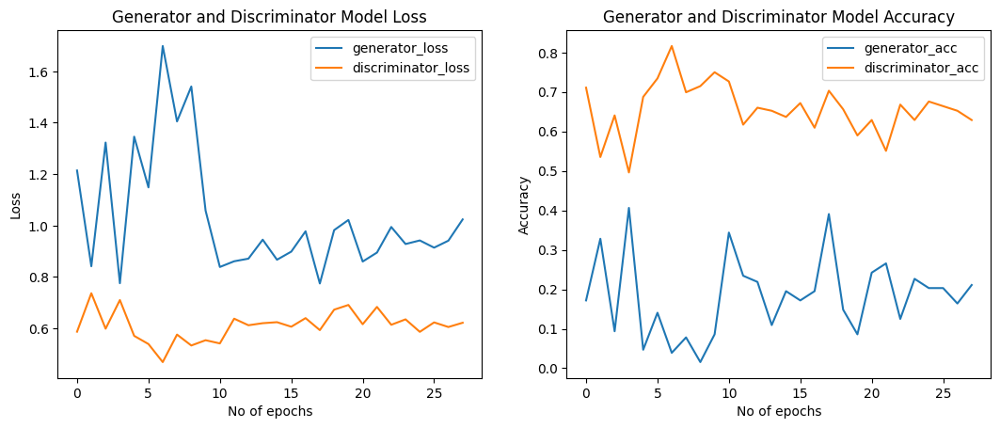

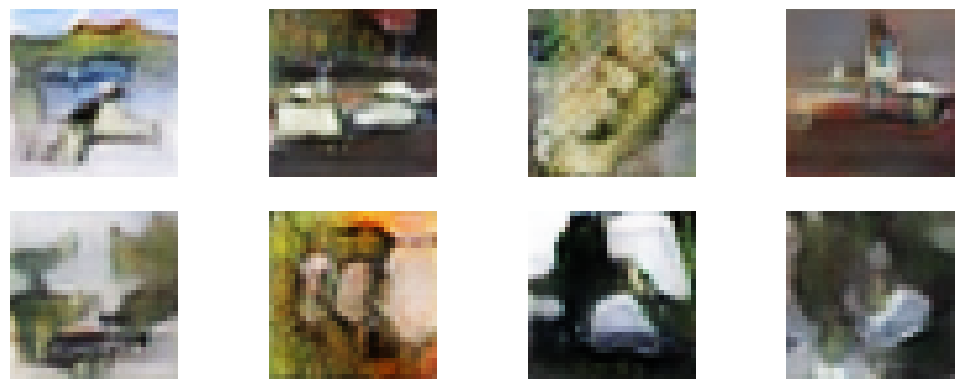

Iteration: 13110 - Generator loss: 0.8971 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.6350 - Discrimnator Accuracy: 62.50 %
Iteration: 13120 - Generator loss: 0.8362 - Generator Accuracy: 31.25 % - Discrimnator loss: 0.6170 - Discrimnator Accuracy: 63.28 %
Iteration: 13130 - Generator loss: 1.0039 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6022 - Discrimnator Accuracy: 64.06 %
Iteration: 13140 - Generator loss: 1.0451 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.6279 - Discrimnator Accuracy: 63.67 %
Iteration: 13150 - Generator loss: 0.9089 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.6151 - Discrimnator Accuracy: 66.41 %
Iteration: 13160 - Generator loss: 0.9563 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6142 - Discrimnator Accuracy: 67.58 %
Iteration: 13170 - Generator loss: 0.9811 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.6292 - Discrimnator Accuracy: 63.67 %
Iteration: 13180 - Generator loss: 1.0022 - Generator Accuracy: 13.28

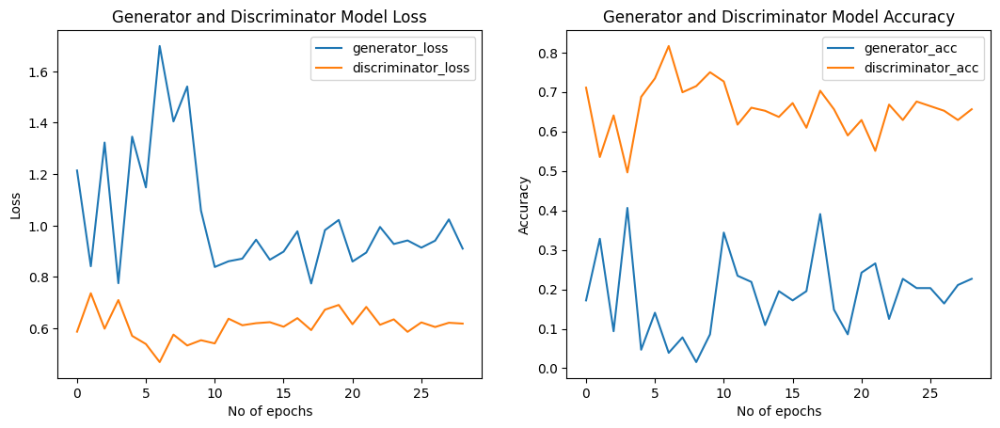

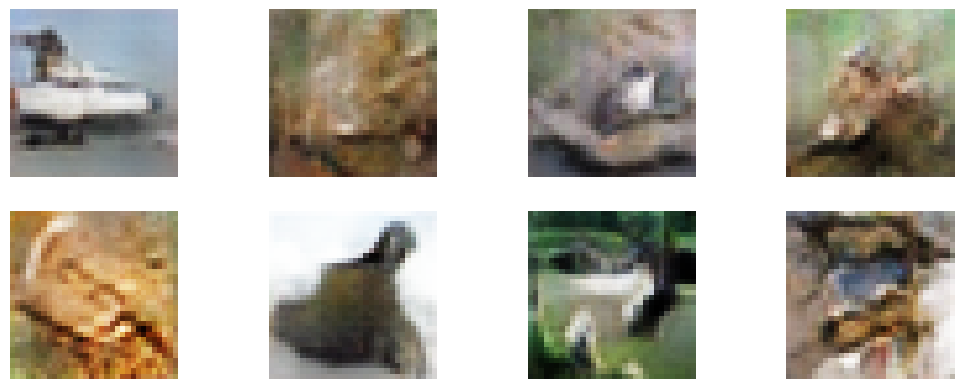

Iteration: 13580 - Generator loss: 0.8937 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5675 - Discrimnator Accuracy: 70.31 %
Iteration: 13590 - Generator loss: 0.9141 - Generator Accuracy: 30.47 % - Discrimnator loss: 0.6321 - Discrimnator Accuracy: 64.06 %
Iteration: 13600 - Generator loss: 1.0454 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.6265 - Discrimnator Accuracy: 64.06 %
Iteration: 13610 - Generator loss: 0.8805 - Generator Accuracy: 32.81 % - Discrimnator loss: 0.6244 - Discrimnator Accuracy: 62.50 %
Iteration: 13620 - Generator loss: 0.8832 - Generator Accuracy: 28.12 % - Discrimnator loss: 0.6459 - Discrimnator Accuracy: 59.38 %
Iteration: 13630 - Generator loss: 1.0462 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5571 - Discrimnator Accuracy: 67.97 %
Iteration: 13640 - Generator loss: 0.9957 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.6331 - Discrimnator Accuracy: 66.80 %
Iteration: 13650 - Generator loss: 0.9628 - Generator Accuracy: 17.19

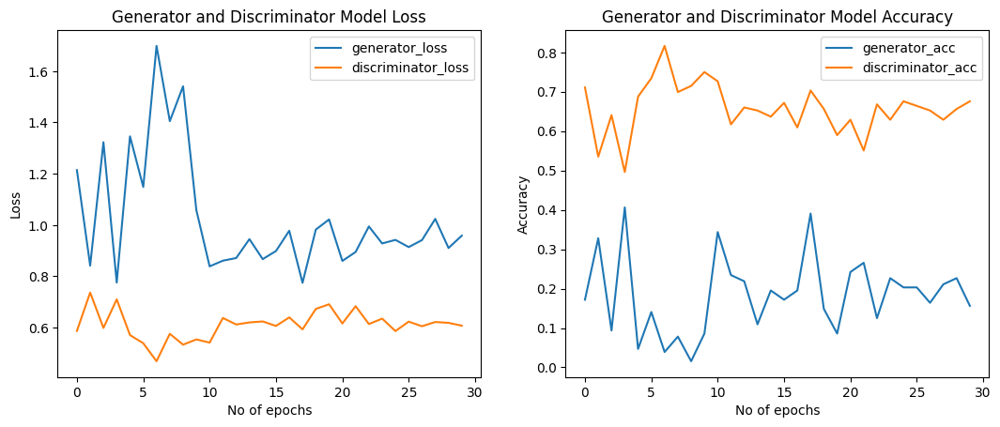

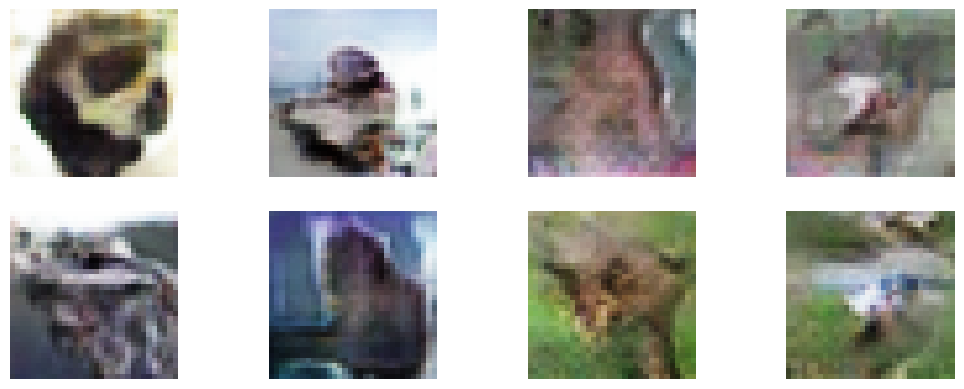

Iteration: 14050 - Generator loss: 0.9384 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.6129 - Discrimnator Accuracy: 64.84 %
Iteration: 14060 - Generator loss: 0.8118 - Generator Accuracy: 34.38 % - Discrimnator loss: 0.6256 - Discrimnator Accuracy: 63.67 %
Iteration: 14070 - Generator loss: 0.8684 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.6138 - Discrimnator Accuracy: 66.80 %
Iteration: 14080 - Generator loss: 0.8499 - Generator Accuracy: 29.69 % - Discrimnator loss: 0.6299 - Discrimnator Accuracy: 64.84 %
Iteration: 14090 - Generator loss: 1.0640 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.6217 - Discrimnator Accuracy: 66.41 %
Iteration: 14100 - Generator loss: 0.9093 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6131 - Discrimnator Accuracy: 64.06 %
Iteration: 14110 - Generator loss: 0.9404 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5800 - Discrimnator Accuracy: 71.88 %
Iteration: 14120 - Generator loss: 0.9655 - Generator Accuracy: 17.97

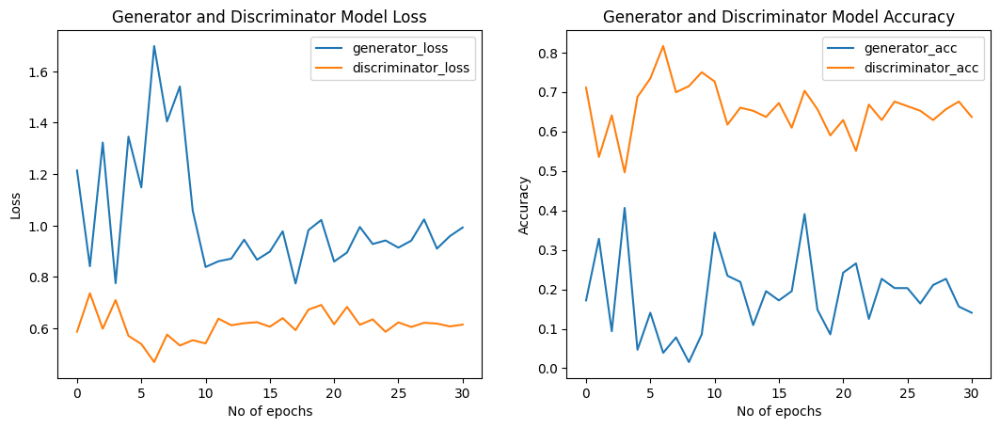

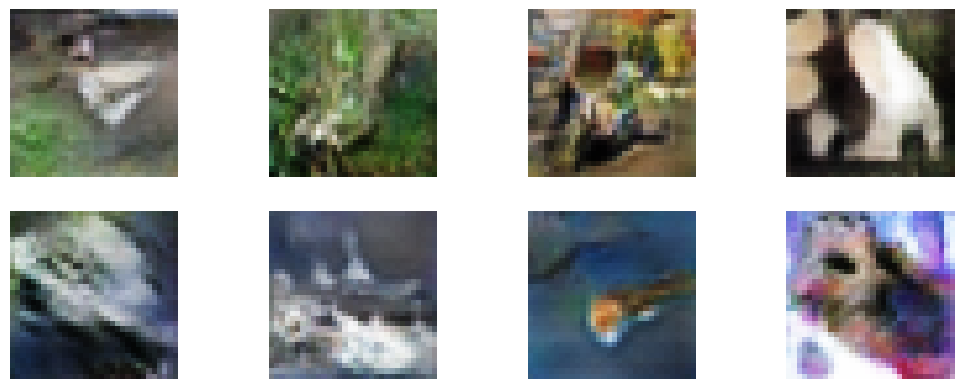

Iteration: 14510 - Generator loss: 0.9489 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.6190 - Discrimnator Accuracy: 63.28 %
Iteration: 14520 - Generator loss: 0.9311 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.5704 - Discrimnator Accuracy: 73.05 %
Iteration: 14530 - Generator loss: 0.9027 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.6482 - Discrimnator Accuracy: 62.11 %
Iteration: 14540 - Generator loss: 1.0739 - Generator Accuracy: 9.38 % - Discrimnator loss: 0.6401 - Discrimnator Accuracy: 59.77 %
Iteration: 14550 - Generator loss: 0.9948 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.5992 - Discrimnator Accuracy: 61.72 %
Iteration: 14560 - Generator loss: 0.8435 - Generator Accuracy: 31.25 % - Discrimnator loss: 0.6150 - Discrimnator Accuracy: 68.36 %
Iteration: 14570 - Generator loss: 0.9955 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6252 - Discrimnator Accuracy: 63.28 %
Iteration: 14580 - Generator loss: 0.9359 - Generator Accuracy: 23.44 

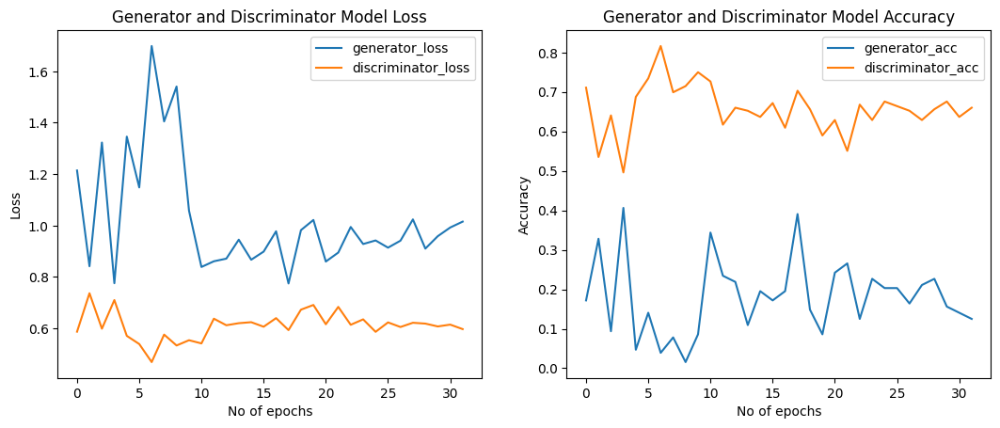

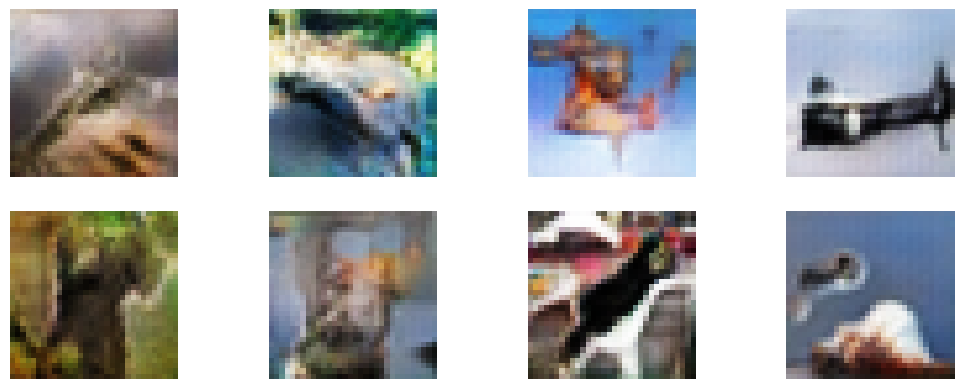

Iteration: 14980 - Generator loss: 1.1115 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.5799 - Discrimnator Accuracy: 68.36 %
Iteration: 14990 - Generator loss: 1.0409 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.5788 - Discrimnator Accuracy: 69.14 %
Iteration: 15000 - Generator loss: 0.8387 - Generator Accuracy: 36.72 % - Discrimnator loss: 0.6381 - Discrimnator Accuracy: 64.06 %
Iteration: 15010 - Generator loss: 0.8803 - Generator Accuracy: 32.03 % - Discrimnator loss: 0.6197 - Discrimnator Accuracy: 63.28 %
Iteration: 15020 - Generator loss: 0.9587 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5855 - Discrimnator Accuracy: 65.62 %
Iteration: 15030 - Generator loss: 1.0292 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.6582 - Discrimnator Accuracy: 59.38 %
Iteration: 15040 - Generator loss: 1.1538 - Generator Accuracy: 8.59 % - Discrimnator loss: 0.6442 - Discrimnator Accuracy: 59.77 %
Iteration: 15050 - Generator loss: 1.0783 - Generator Accuracy: 10.16 

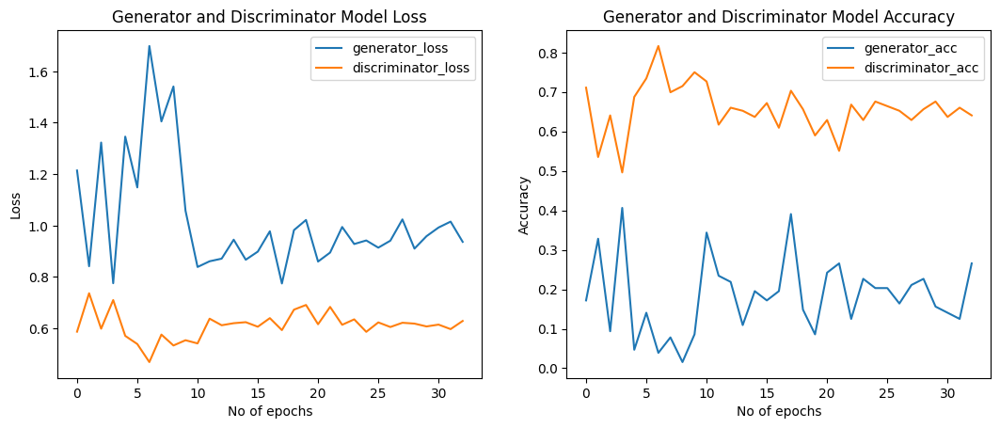

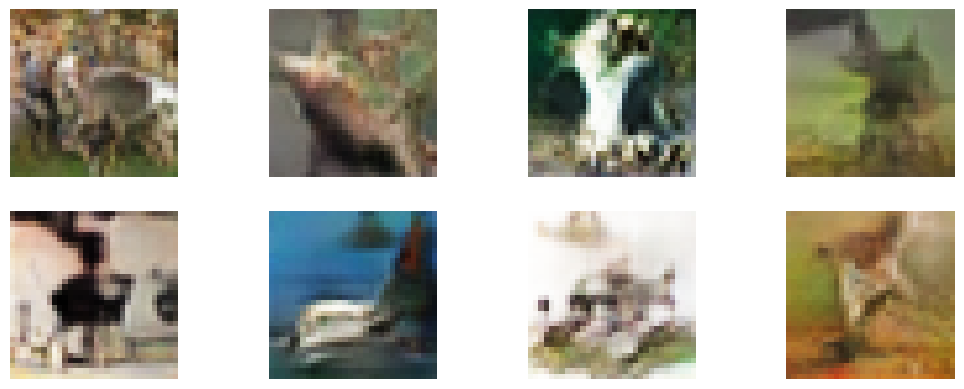

Iteration: 15450 - Generator loss: 1.2527 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.5385 - Discrimnator Accuracy: 72.27 %
Iteration: 15460 - Generator loss: 0.7529 - Generator Accuracy: 39.84 % - Discrimnator loss: 0.6777 - Discrimnator Accuracy: 56.25 %
Iteration: 15470 - Generator loss: 0.9760 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.6359 - Discrimnator Accuracy: 64.84 %
Iteration: 15480 - Generator loss: 1.1075 - Generator Accuracy: 7.81 % - Discrimnator loss: 0.6642 - Discrimnator Accuracy: 61.72 %
Iteration: 15490 - Generator loss: 0.9208 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.5763 - Discrimnator Accuracy: 68.75 %
Iteration: 15500 - Generator loss: 0.9525 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.6220 - Discrimnator Accuracy: 64.45 %
Iteration: 15510 - Generator loss: 1.0424 - Generator Accuracy: 11.72 % - Discrimnator loss: 0.6516 - Discrimnator Accuracy: 58.98 %
Iteration: 15520 - Generator loss: 0.9498 - Generator Accuracy: 25.78 

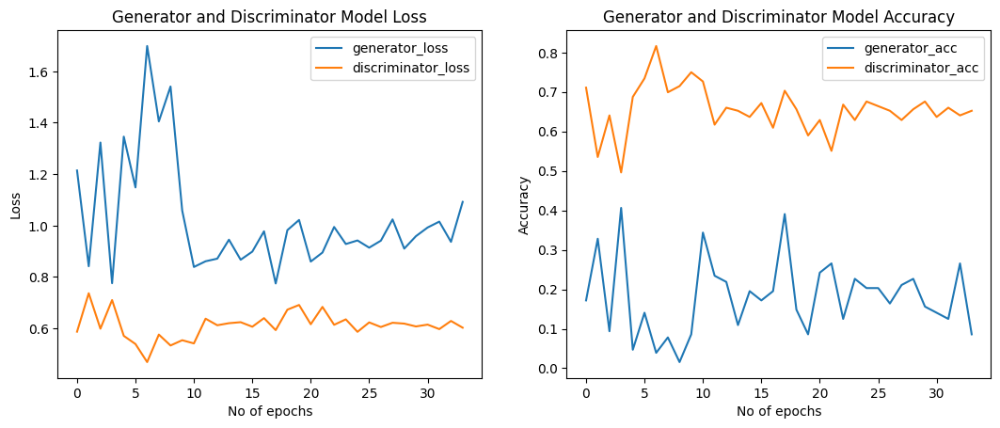

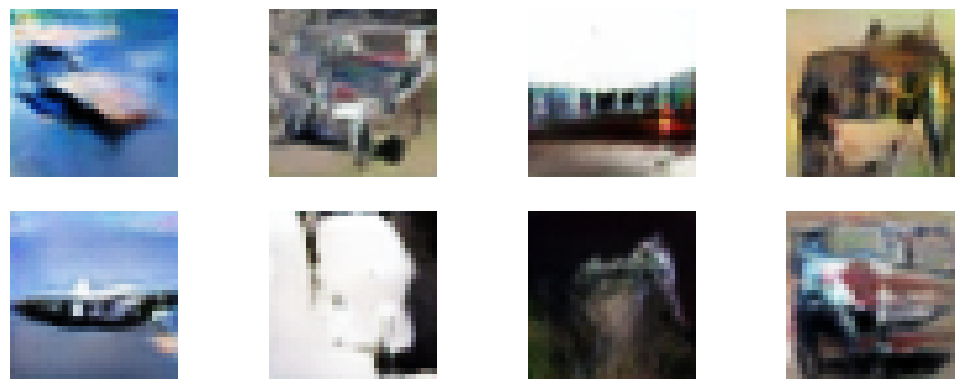

Iteration: 15920 - Generator loss: 0.8941 - Generator Accuracy: 31.25 % - Discrimnator loss: 0.6106 - Discrimnator Accuracy: 65.62 %
Iteration: 15930 - Generator loss: 0.8999 - Generator Accuracy: 28.12 % - Discrimnator loss: 0.5810 - Discrimnator Accuracy: 67.58 %
Iteration: 15940 - Generator loss: 1.0364 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.6243 - Discrimnator Accuracy: 62.89 %
Iteration: 15950 - Generator loss: 0.9981 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.6174 - Discrimnator Accuracy: 65.62 %
Iteration: 15960 - Generator loss: 1.0165 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.5768 - Discrimnator Accuracy: 66.80 %
Iteration: 15970 - Generator loss: 1.0525 - Generator Accuracy: 11.72 % - Discrimnator loss: 0.6534 - Discrimnator Accuracy: 58.59 %
Iteration: 15980 - Generator loss: 1.0842 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.6117 - Discrimnator Accuracy: 64.06 %
Iteration: 15990 - Generator loss: 1.0065 - Generator Accuracy: 19.53

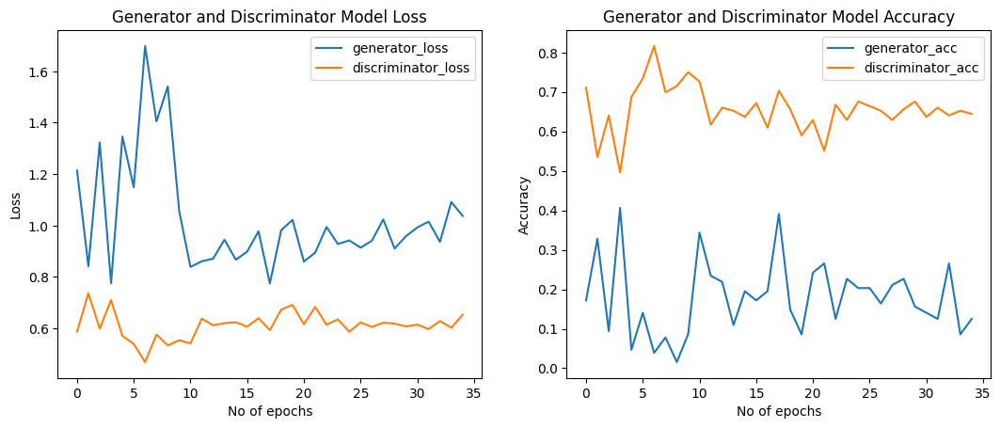

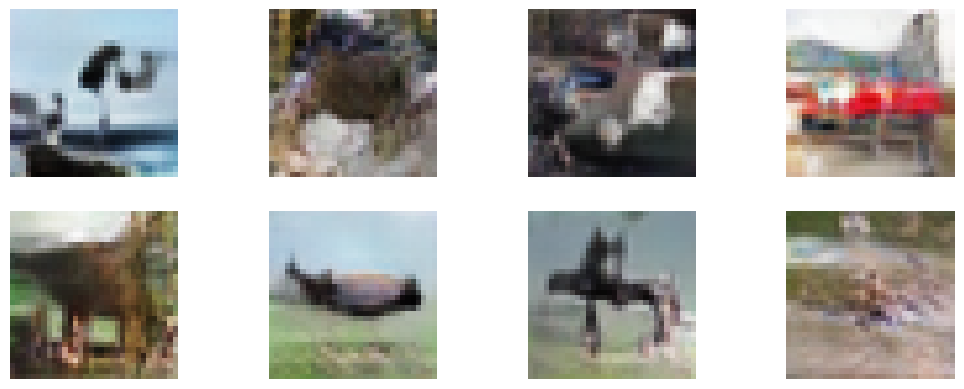

Iteration: 16390 - Generator loss: 1.0525 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.6236 - Discrimnator Accuracy: 63.28 %
Iteration: 16400 - Generator loss: 1.0988 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.6111 - Discrimnator Accuracy: 65.23 %
Iteration: 16410 - Generator loss: 0.9106 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.6335 - Discrimnator Accuracy: 65.23 %
Iteration: 16420 - Generator loss: 1.0216 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.6099 - Discrimnator Accuracy: 64.06 %
Iteration: 16430 - Generator loss: 0.9806 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.6024 - Discrimnator Accuracy: 66.02 %
Iteration: 16440 - Generator loss: 0.9757 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.6186 - Discrimnator Accuracy: 65.62 %
Iteration: 16450 - Generator loss: 0.8430 - Generator Accuracy: 32.81 % - Discrimnator loss: 0.6163 - Discrimnator Accuracy: 61.72 %
Iteration: 16460 - Generator loss: 0.8004 - Generator Accuracy: 32.03

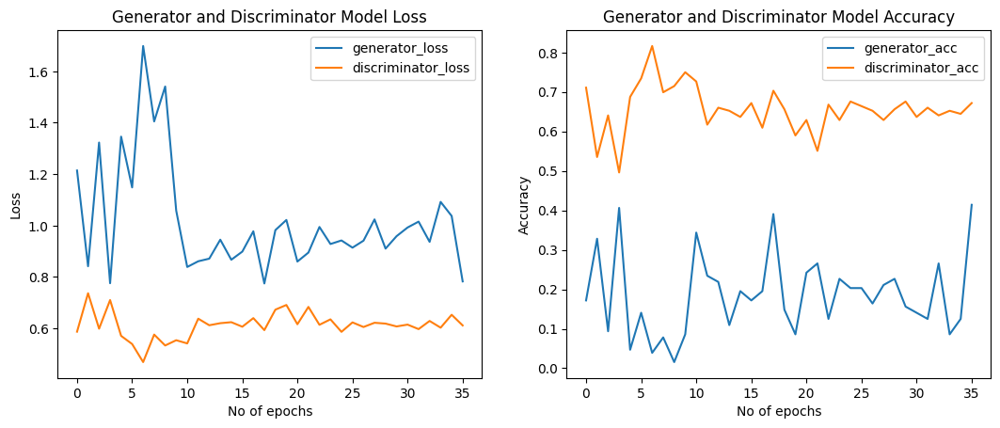

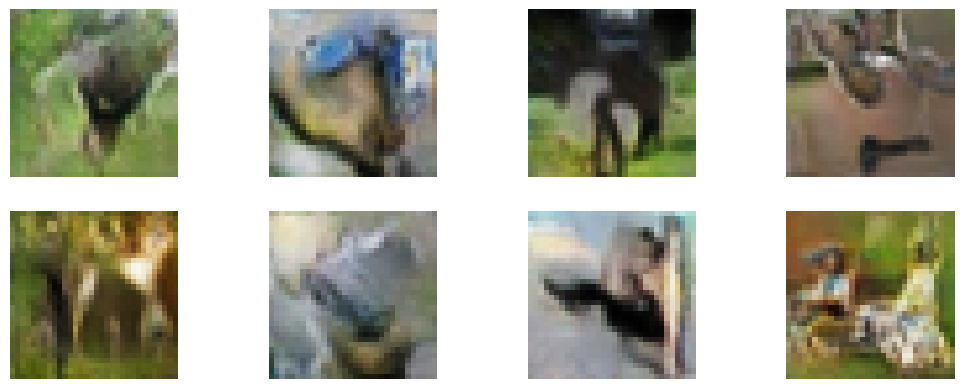

Iteration: 16850 - Generator loss: 1.0409 - Generator Accuracy: 11.72 % - Discrimnator loss: 0.6100 - Discrimnator Accuracy: 66.02 %
Iteration: 16860 - Generator loss: 1.0021 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.6361 - Discrimnator Accuracy: 60.55 %
Iteration: 16870 - Generator loss: 0.9732 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5711 - Discrimnator Accuracy: 69.53 %
Iteration: 16880 - Generator loss: 1.0527 - Generator Accuracy: 9.38 % - Discrimnator loss: 0.6465 - Discrimnator Accuracy: 65.23 %
Iteration: 16890 - Generator loss: 0.9094 - Generator Accuracy: 26.56 % - Discrimnator loss: 0.6118 - Discrimnator Accuracy: 66.02 %
Iteration: 16900 - Generator loss: 0.8983 - Generator Accuracy: 27.34 % - Discrimnator loss: 0.5754 - Discrimnator Accuracy: 70.70 %
Iteration: 16910 - Generator loss: 1.0332 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.6273 - Discrimnator Accuracy: 64.45 %
Iteration: 16920 - Generator loss: 0.8638 - Generator Accuracy: 28.12 

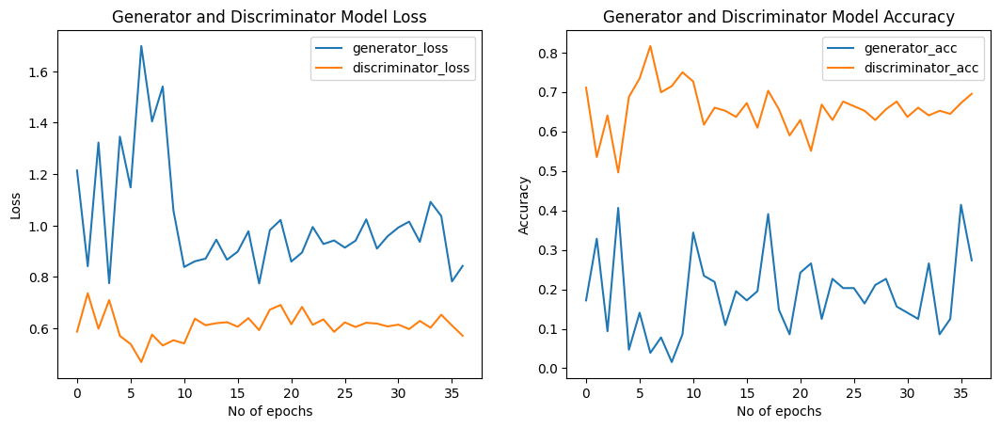

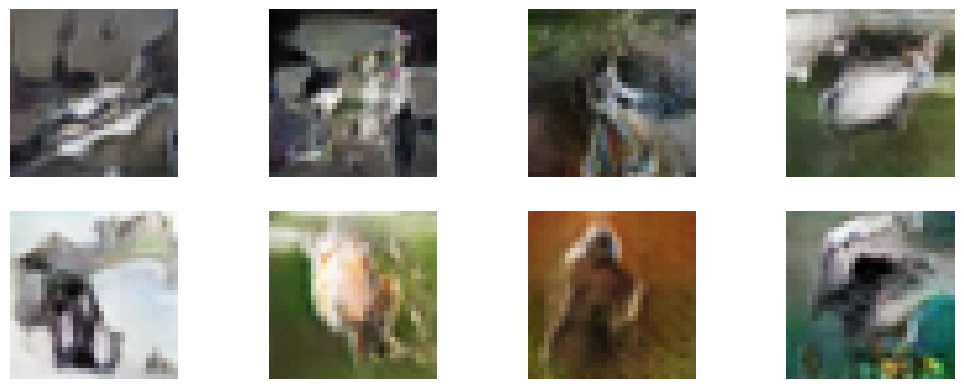

Iteration: 17320 - Generator loss: 1.0090 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6039 - Discrimnator Accuracy: 65.62 %
Iteration: 17330 - Generator loss: 0.9229 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6069 - Discrimnator Accuracy: 67.58 %
Iteration: 17340 - Generator loss: 0.8444 - Generator Accuracy: 30.47 % - Discrimnator loss: 0.6149 - Discrimnator Accuracy: 63.67 %
Iteration: 17350 - Generator loss: 0.8927 - Generator Accuracy: 26.56 % - Discrimnator loss: 0.6072 - Discrimnator Accuracy: 66.41 %
Iteration: 17360 - Generator loss: 0.9350 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.6213 - Discrimnator Accuracy: 64.84 %
Iteration: 17370 - Generator loss: 0.9089 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.5957 - Discrimnator Accuracy: 65.62 %
Iteration: 17380 - Generator loss: 0.8103 - Generator Accuracy: 32.81 % - Discrimnator loss: 0.6435 - Discrimnator Accuracy: 62.50 %
Iteration: 17390 - Generator loss: 1.0007 - Generator Accuracy: 14.84

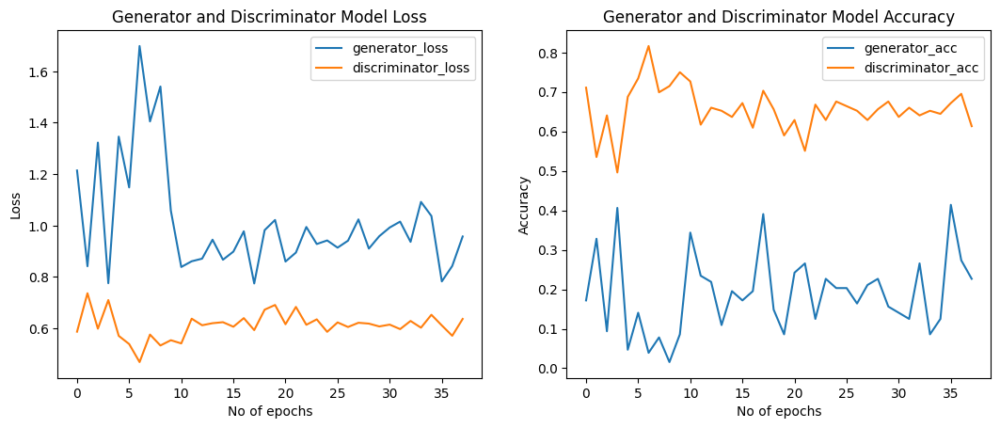

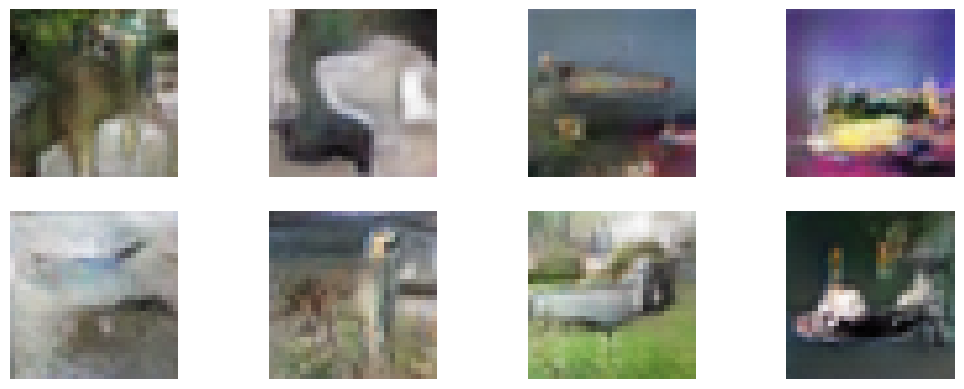

Iteration: 17790 - Generator loss: 0.8869 - Generator Accuracy: 28.12 % - Discrimnator loss: 0.6162 - Discrimnator Accuracy: 68.75 %
Iteration: 17800 - Generator loss: 0.9483 - Generator Accuracy: 23.44 % - Discrimnator loss: 0.5861 - Discrimnator Accuracy: 67.58 %
Iteration: 17810 - Generator loss: 0.8854 - Generator Accuracy: 28.91 % - Discrimnator loss: 0.6042 - Discrimnator Accuracy: 63.67 %
Iteration: 17820 - Generator loss: 1.1793 - Generator Accuracy: 7.81 % - Discrimnator loss: 0.6100 - Discrimnator Accuracy: 62.50 %
Iteration: 17830 - Generator loss: 0.9245 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.6177 - Discrimnator Accuracy: 65.62 %
Iteration: 17840 - Generator loss: 1.0913 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.6415 - Discrimnator Accuracy: 60.94 %
Iteration: 17850 - Generator loss: 1.0145 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5846 - Discrimnator Accuracy: 71.09 %
Iteration: 17860 - Generator loss: 0.8639 - Generator Accuracy: 33.59 

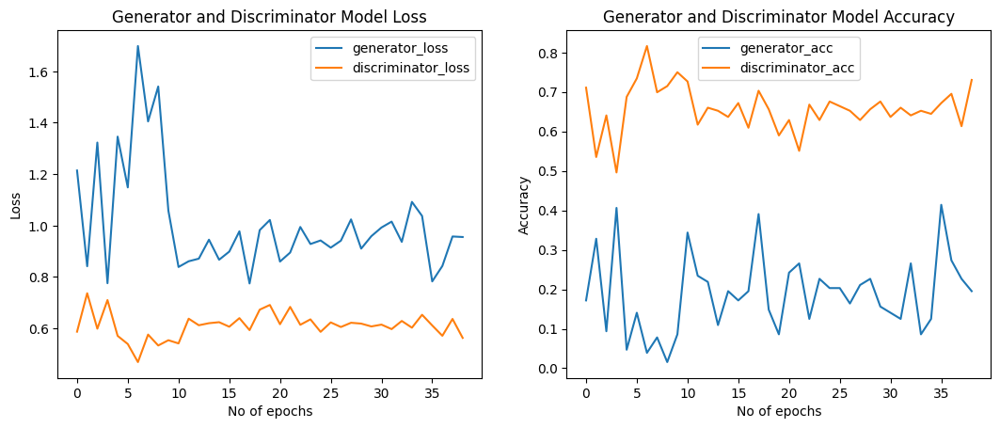

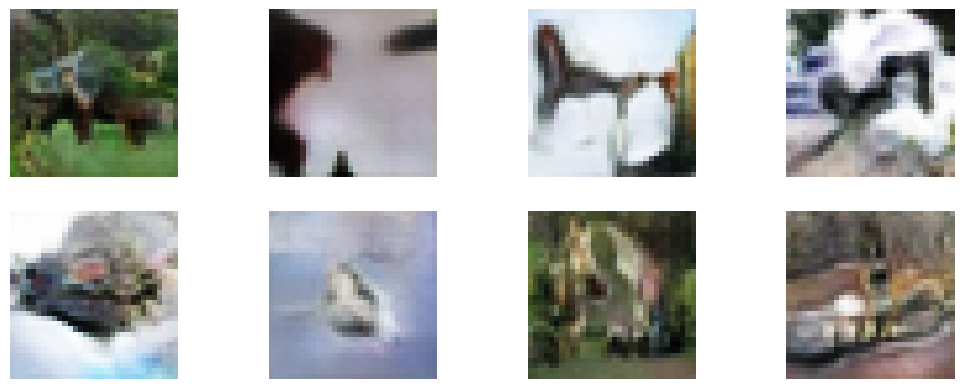

Iteration: 18260 - Generator loss: 0.9891 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6141 - Discrimnator Accuracy: 64.84 %
Iteration: 18270 - Generator loss: 0.9485 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.6593 - Discrimnator Accuracy: 60.94 %
Iteration: 18280 - Generator loss: 0.8169 - Generator Accuracy: 36.72 % - Discrimnator loss: 0.6022 - Discrimnator Accuracy: 65.23 %
Iteration: 18290 - Generator loss: 1.0350 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5936 - Discrimnator Accuracy: 67.19 %
Iteration: 18300 - Generator loss: 0.8093 - Generator Accuracy: 30.47 % - Discrimnator loss: 0.6203 - Discrimnator Accuracy: 65.23 %
Iteration: 18310 - Generator loss: 0.9399 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.5876 - Discrimnator Accuracy: 67.58 %
Iteration: 18320 - Generator loss: 0.8788 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.6091 - Discrimnator Accuracy: 66.02 %
Iteration: 18330 - Generator loss: 0.8271 - Generator Accuracy: 35.94

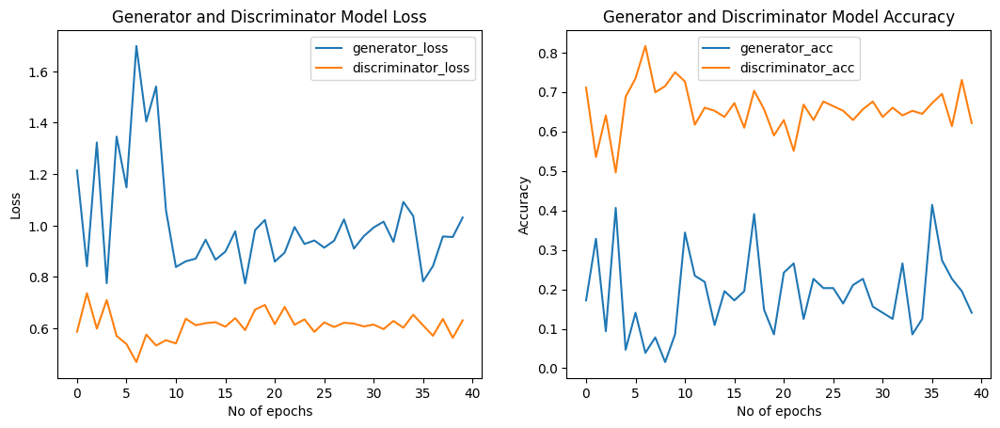

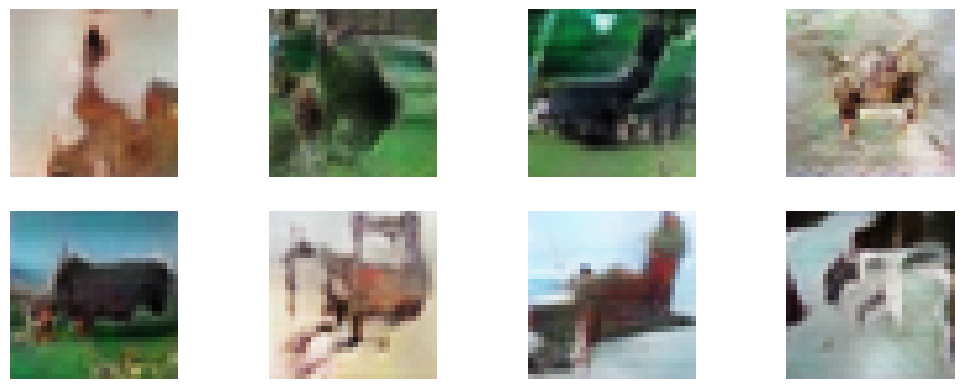

Iteration: 18730 - Generator loss: 0.9980 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.6813 - Discrimnator Accuracy: 58.59 %
Iteration: 18740 - Generator loss: 0.9805 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6423 - Discrimnator Accuracy: 59.77 %
Iteration: 18750 - Generator loss: 0.8564 - Generator Accuracy: 28.12 % - Discrimnator loss: 0.6112 - Discrimnator Accuracy: 66.02 %
Iteration: 18760 - Generator loss: 0.8362 - Generator Accuracy: 30.47 % - Discrimnator loss: 0.6055 - Discrimnator Accuracy: 66.41 %
Iteration: 18770 - Generator loss: 0.9311 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.5960 - Discrimnator Accuracy: 64.84 %
Iteration: 18780 - Generator loss: 0.8578 - Generator Accuracy: 35.94 % - Discrimnator loss: 0.5861 - Discrimnator Accuracy: 66.80 %
Iteration: 18790 - Generator loss: 1.1099 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5929 - Discrimnator Accuracy: 67.58 %
Iteration: 18800 - Generator loss: 0.9765 - Generator Accuracy: 21.88

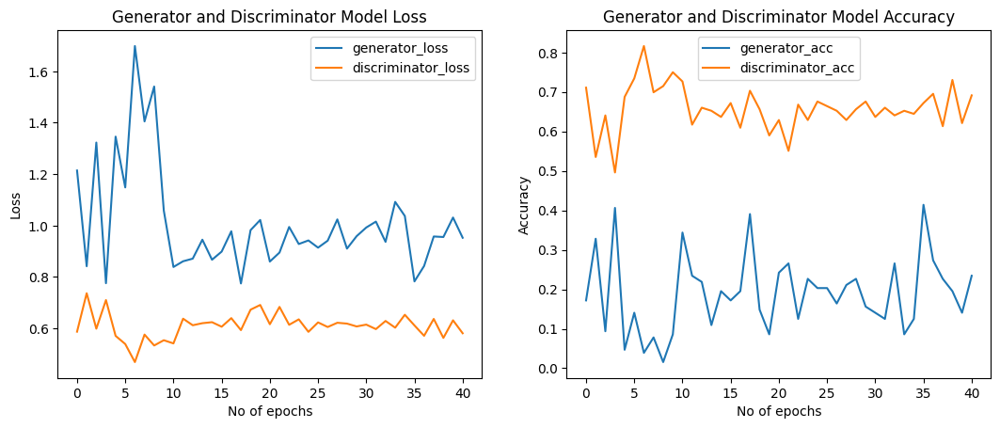

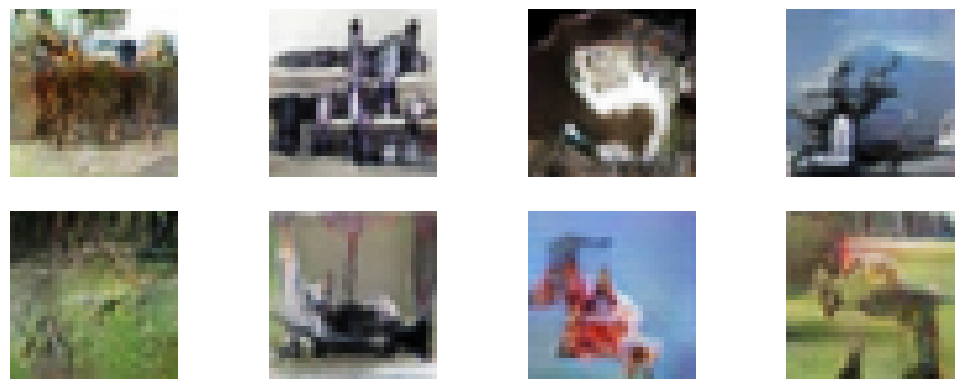

Iteration: 19190 - Generator loss: 0.9732 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.6171 - Discrimnator Accuracy: 64.84 %
Iteration: 19200 - Generator loss: 1.1124 - Generator Accuracy: 9.38 % - Discrimnator loss: 0.5994 - Discrimnator Accuracy: 63.28 %
Iteration: 19210 - Generator loss: 0.8509 - Generator Accuracy: 27.34 % - Discrimnator loss: 0.6150 - Discrimnator Accuracy: 63.67 %
Iteration: 19220 - Generator loss: 0.7824 - Generator Accuracy: 38.28 % - Discrimnator loss: 0.6500 - Discrimnator Accuracy: 61.72 %
Iteration: 19230 - Generator loss: 0.8605 - Generator Accuracy: 38.28 % - Discrimnator loss: 0.5929 - Discrimnator Accuracy: 66.41 %
Iteration: 19240 - Generator loss: 0.8870 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.6753 - Discrimnator Accuracy: 54.69 %
Iteration: 19250 - Generator loss: 0.9851 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.6316 - Discrimnator Accuracy: 62.50 %
Iteration: 19260 - Generator loss: 0.9204 - Generator Accuracy: 25.78 

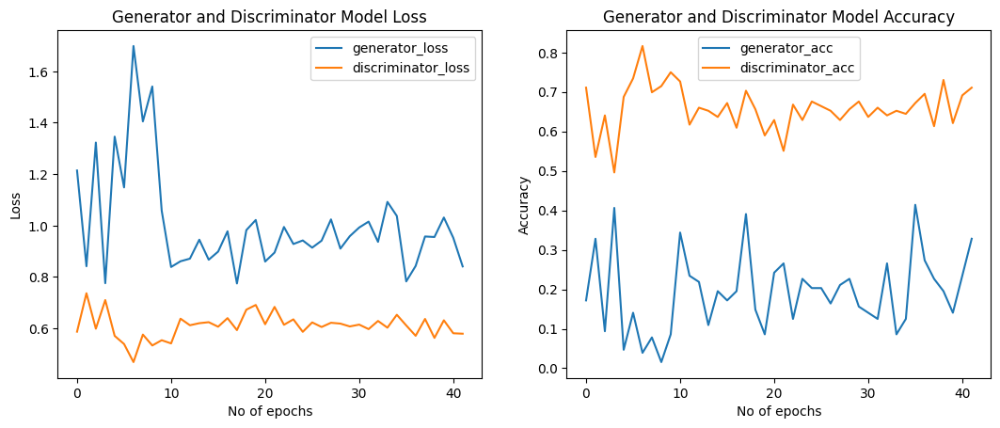

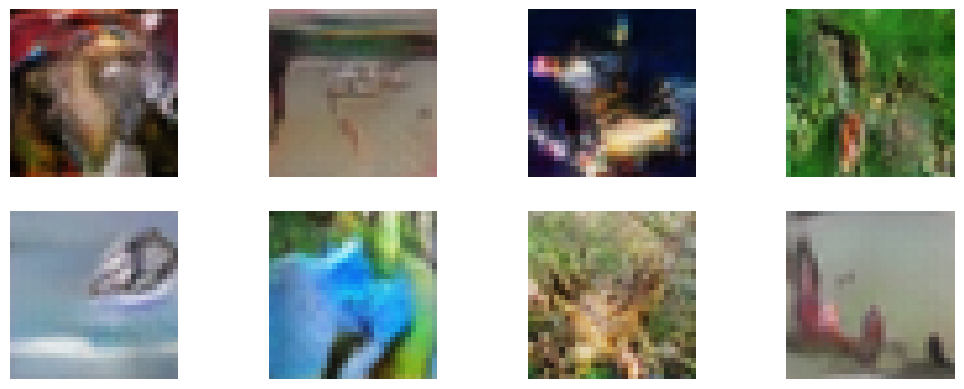

Iteration: 19660 - Generator loss: 0.9172 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.5982 - Discrimnator Accuracy: 65.23 %
Iteration: 19670 - Generator loss: 0.8990 - Generator Accuracy: 27.34 % - Discrimnator loss: 0.5878 - Discrimnator Accuracy: 69.92 %
Iteration: 19680 - Generator loss: 0.9815 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5774 - Discrimnator Accuracy: 67.97 %
Iteration: 19690 - Generator loss: 0.8988 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.6233 - Discrimnator Accuracy: 63.28 %
Iteration: 19700 - Generator loss: 0.7951 - Generator Accuracy: 39.06 % - Discrimnator loss: 0.6065 - Discrimnator Accuracy: 64.84 %
Iteration: 19710 - Generator loss: 0.9637 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.6217 - Discrimnator Accuracy: 63.28 %
Iteration: 19720 - Generator loss: 1.0044 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6086 - Discrimnator Accuracy: 66.80 %
Iteration: 19730 - Generator loss: 0.9607 - Generator Accuracy: 19.53

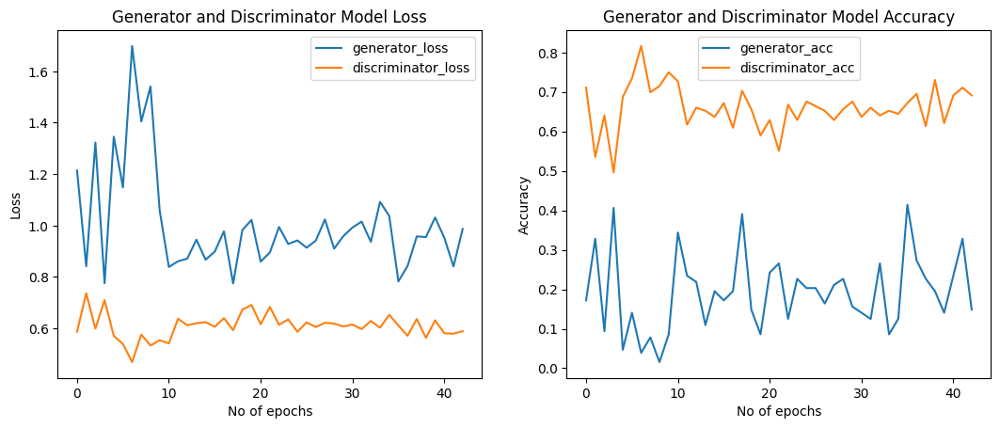

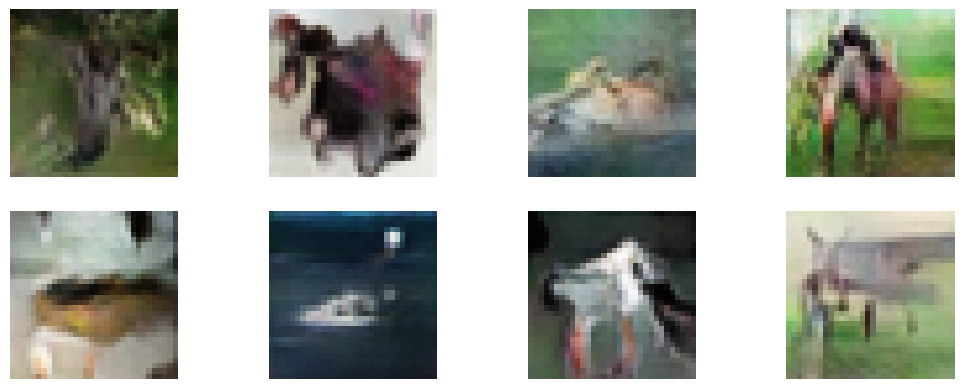

Iteration: 20130 - Generator loss: 1.0094 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.5757 - Discrimnator Accuracy: 69.53 %
Iteration: 20140 - Generator loss: 0.7840 - Generator Accuracy: 32.03 % - Discrimnator loss: 0.5953 - Discrimnator Accuracy: 66.02 %
Iteration: 20150 - Generator loss: 0.9970 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5851 - Discrimnator Accuracy: 70.70 %
Iteration: 20160 - Generator loss: 1.1741 - Generator Accuracy: 7.81 % - Discrimnator loss: 0.5558 - Discrimnator Accuracy: 69.53 %
Iteration: 20170 - Generator loss: 1.0272 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.5981 - Discrimnator Accuracy: 65.62 %
Iteration: 20180 - Generator loss: 0.9915 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.5904 - Discrimnator Accuracy: 64.45 %
Iteration: 20190 - Generator loss: 0.9384 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.5874 - Discrimnator Accuracy: 70.31 %
Iteration: 20200 - Generator loss: 0.9152 - Generator Accuracy: 22.66 

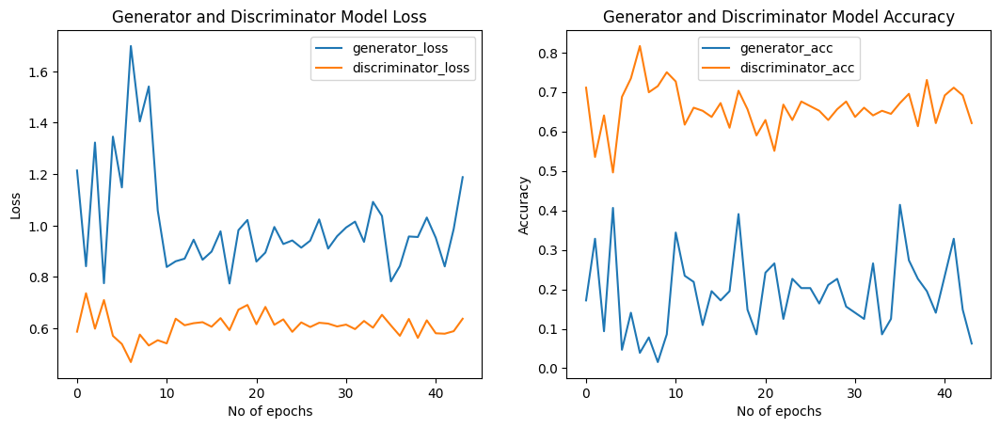

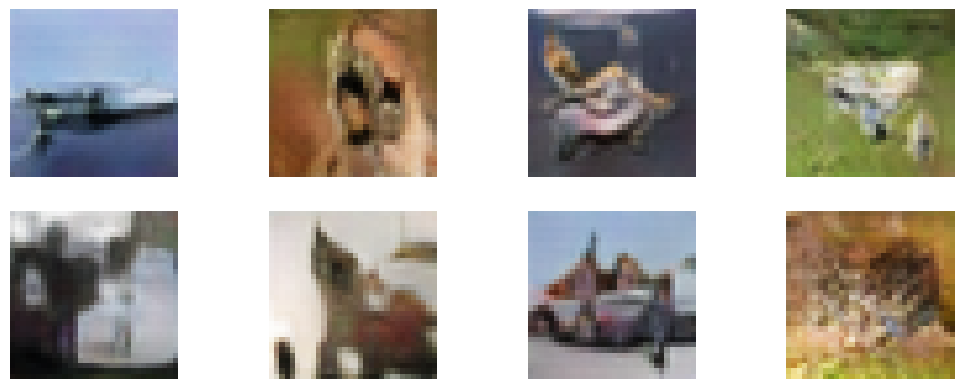

Iteration: 20600 - Generator loss: 1.1030 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.6069 - Discrimnator Accuracy: 67.58 %
Iteration: 20610 - Generator loss: 0.9092 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.6245 - Discrimnator Accuracy: 62.50 %
Iteration: 20620 - Generator loss: 0.8392 - Generator Accuracy: 33.59 % - Discrimnator loss: 0.6259 - Discrimnator Accuracy: 64.06 %
Iteration: 20630 - Generator loss: 1.0954 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5582 - Discrimnator Accuracy: 71.88 %
Iteration: 20640 - Generator loss: 0.9210 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6352 - Discrimnator Accuracy: 60.55 %
Iteration: 20650 - Generator loss: 0.9425 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.5944 - Discrimnator Accuracy: 64.06 %
Iteration: 20660 - Generator loss: 1.0151 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.6011 - Discrimnator Accuracy: 64.45 %
Iteration: 20670 - Generator loss: 1.0079 - Generator Accuracy: 14.84

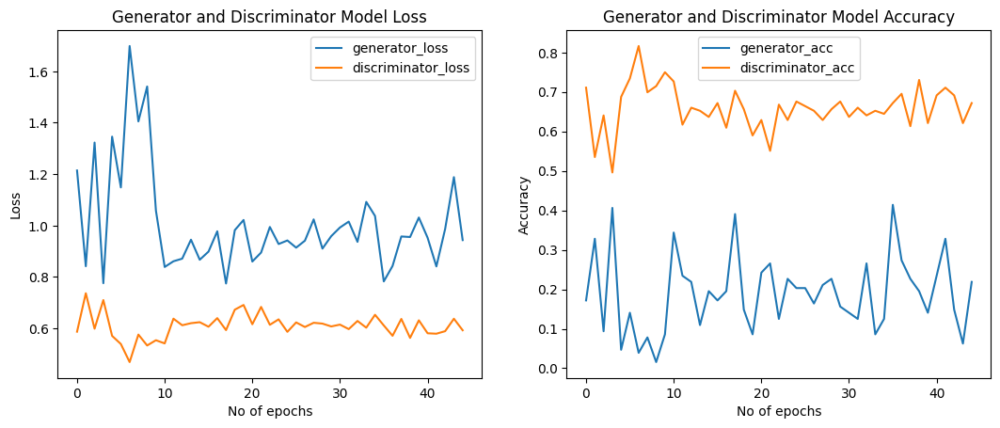

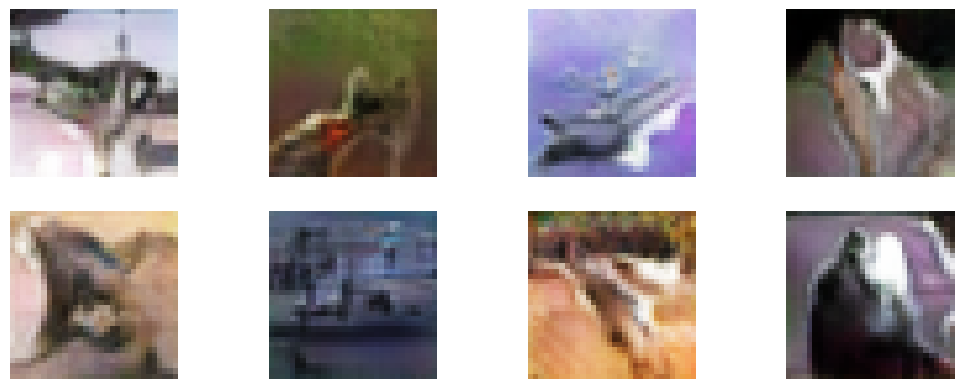

Iteration: 21070 - Generator loss: 0.8528 - Generator Accuracy: 26.56 % - Discrimnator loss: 0.6171 - Discrimnator Accuracy: 62.11 %
Iteration: 21080 - Generator loss: 0.8012 - Generator Accuracy: 39.84 % - Discrimnator loss: 0.5912 - Discrimnator Accuracy: 67.58 %
Iteration: 21090 - Generator loss: 0.9510 - Generator Accuracy: 34.38 % - Discrimnator loss: 0.5550 - Discrimnator Accuracy: 71.09 %
Iteration: 21100 - Generator loss: 1.0212 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.5833 - Discrimnator Accuracy: 69.92 %
Iteration: 21110 - Generator loss: 0.9309 - Generator Accuracy: 27.34 % - Discrimnator loss: 0.6054 - Discrimnator Accuracy: 64.06 %
Iteration: 21120 - Generator loss: 1.2610 - Generator Accuracy: 3.12 % - Discrimnator loss: 0.5888 - Discrimnator Accuracy: 62.11 %
Iteration: 21130 - Generator loss: 1.2437 - Generator Accuracy: 11.72 % - Discrimnator loss: 0.5392 - Discrimnator Accuracy: 73.83 %
Iteration: 21140 - Generator loss: 0.9749 - Generator Accuracy: 20.31 

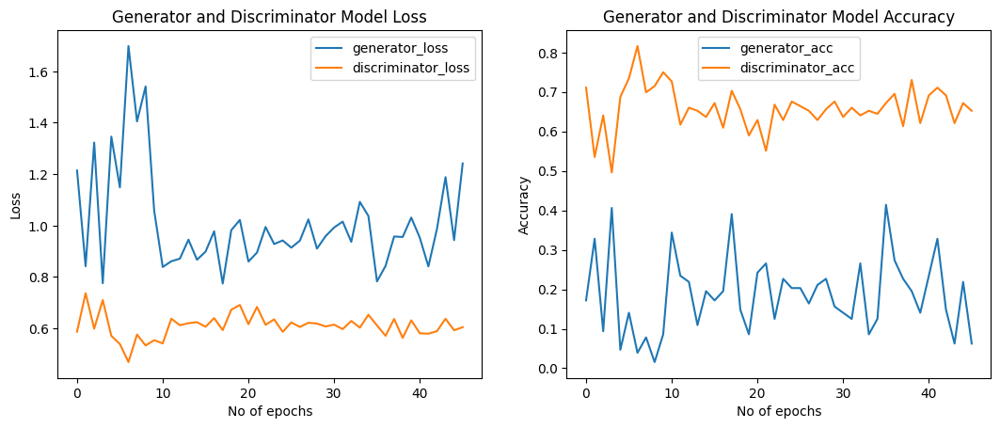

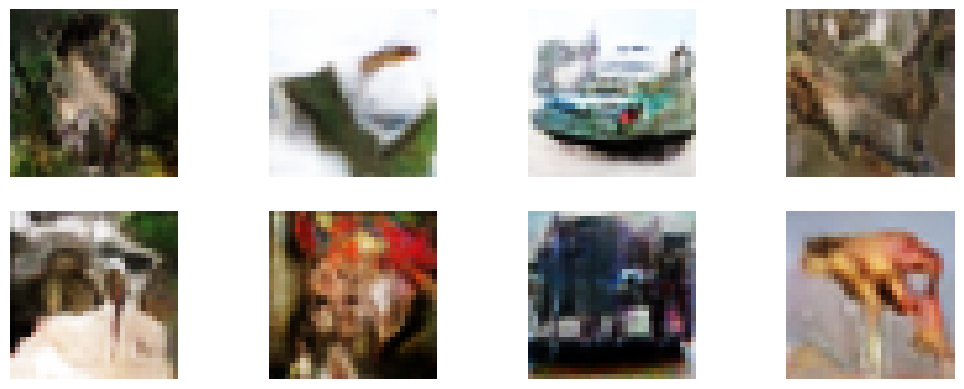

Iteration: 21530 - Generator loss: 0.8927 - Generator Accuracy: 32.81 % - Discrimnator loss: 0.6323 - Discrimnator Accuracy: 65.62 %
Iteration: 21540 - Generator loss: 1.3567 - Generator Accuracy: 5.47 % - Discrimnator loss: 0.5562 - Discrimnator Accuracy: 67.19 %
Iteration: 21550 - Generator loss: 1.0478 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5793 - Discrimnator Accuracy: 70.70 %
Iteration: 21560 - Generator loss: 1.2416 - Generator Accuracy: 5.47 % - Discrimnator loss: 0.6401 - Discrimnator Accuracy: 64.45 %
Iteration: 21570 - Generator loss: 1.0152 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.6385 - Discrimnator Accuracy: 60.94 %
Iteration: 21580 - Generator loss: 1.0952 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5938 - Discrimnator Accuracy: 68.75 %
Iteration: 21590 - Generator loss: 0.9242 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.5898 - Discrimnator Accuracy: 69.14 %
Iteration: 21600 - Generator loss: 1.0013 - Generator Accuracy: 19.53 %

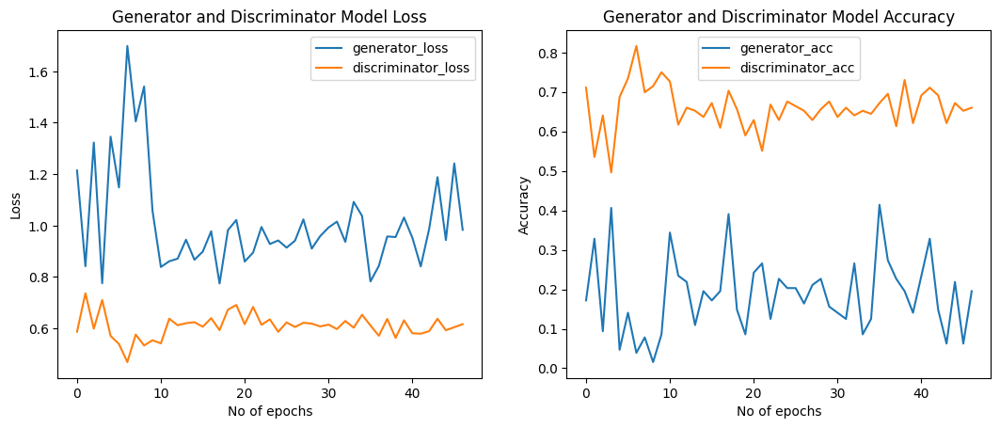

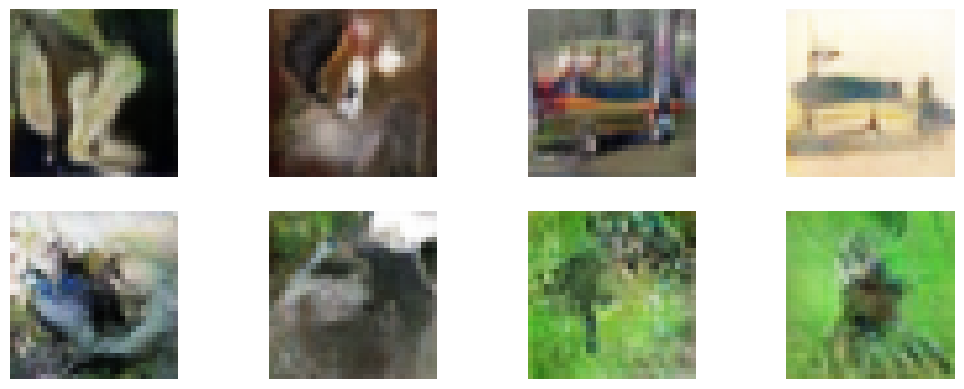

Iteration: 22000 - Generator loss: 1.1530 - Generator Accuracy: 11.72 % - Discrimnator loss: 0.6127 - Discrimnator Accuracy: 64.06 %
Iteration: 22010 - Generator loss: 0.9778 - Generator Accuracy: 19.53 % - Discrimnator loss: 0.5926 - Discrimnator Accuracy: 68.75 %
Iteration: 22020 - Generator loss: 0.7438 - Generator Accuracy: 47.66 % - Discrimnator loss: 0.6585 - Discrimnator Accuracy: 58.98 %
Iteration: 22030 - Generator loss: 1.0518 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.5746 - Discrimnator Accuracy: 69.53 %
Iteration: 22040 - Generator loss: 1.0116 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.6032 - Discrimnator Accuracy: 62.89 %
Iteration: 22050 - Generator loss: 0.8664 - Generator Accuracy: 34.38 % - Discrimnator loss: 0.6027 - Discrimnator Accuracy: 65.62 %
Iteration: 22060 - Generator loss: 0.8672 - Generator Accuracy: 28.91 % - Discrimnator loss: 0.6018 - Discrimnator Accuracy: 63.28 %
Iteration: 22070 - Generator loss: 1.0776 - Generator Accuracy: 14.06

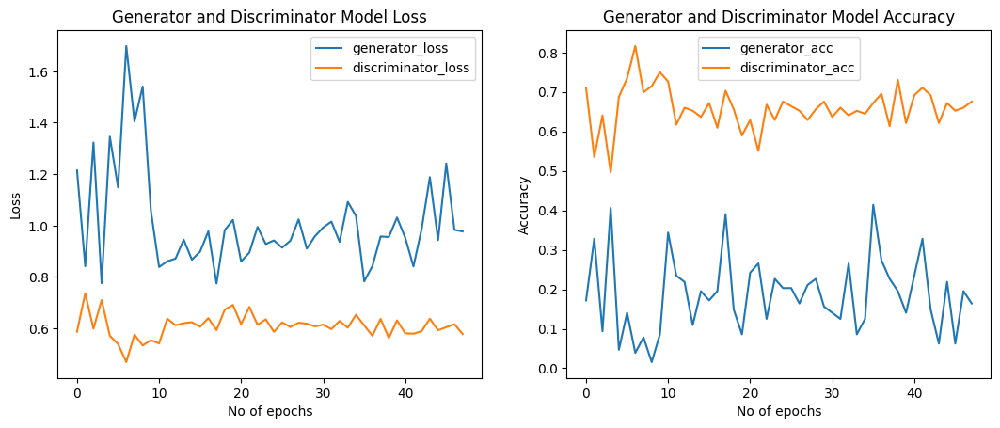

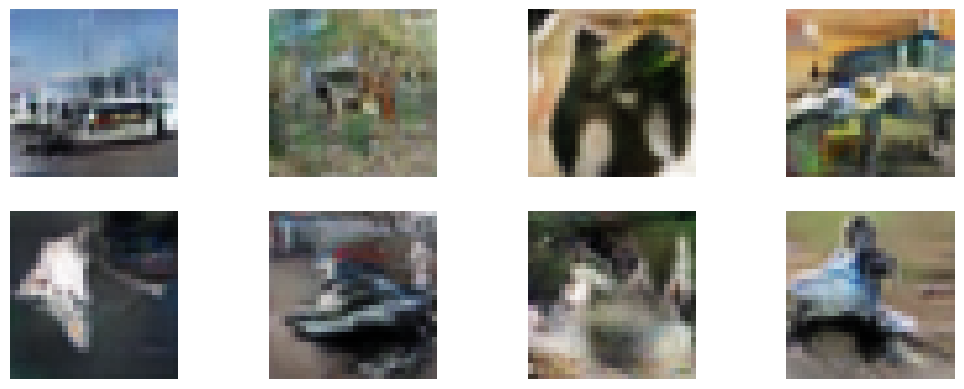

Iteration: 22470 - Generator loss: 0.8840 - Generator Accuracy: 26.56 % - Discrimnator loss: 0.6015 - Discrimnator Accuracy: 66.80 %
Iteration: 22480 - Generator loss: 0.8961 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.5874 - Discrimnator Accuracy: 67.58 %
Iteration: 22490 - Generator loss: 1.1331 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.5948 - Discrimnator Accuracy: 67.19 %
Iteration: 22500 - Generator loss: 1.0395 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5491 - Discrimnator Accuracy: 72.27 %
Iteration: 22510 - Generator loss: 1.0064 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5764 - Discrimnator Accuracy: 67.19 %
Iteration: 22520 - Generator loss: 1.0401 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.5938 - Discrimnator Accuracy: 66.02 %
Iteration: 22530 - Generator loss: 0.9554 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.6086 - Discrimnator Accuracy: 60.16 %
Iteration: 22540 - Generator loss: 0.9267 - Generator Accuracy: 25.78

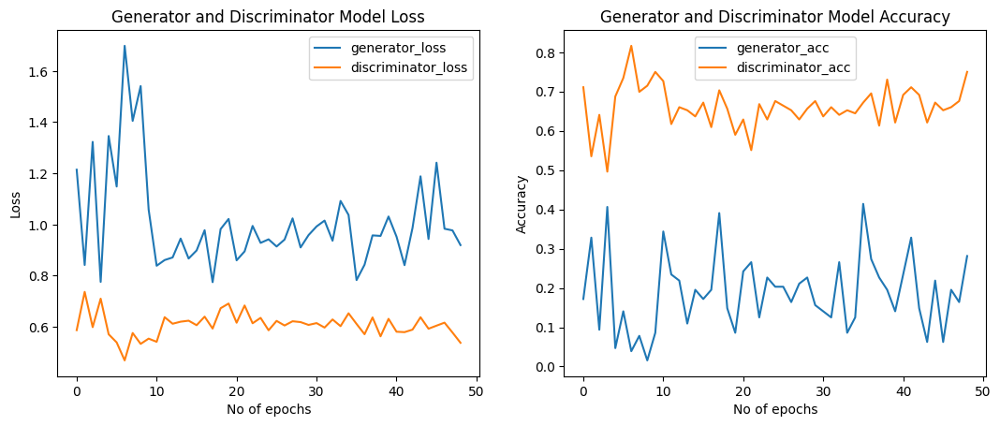

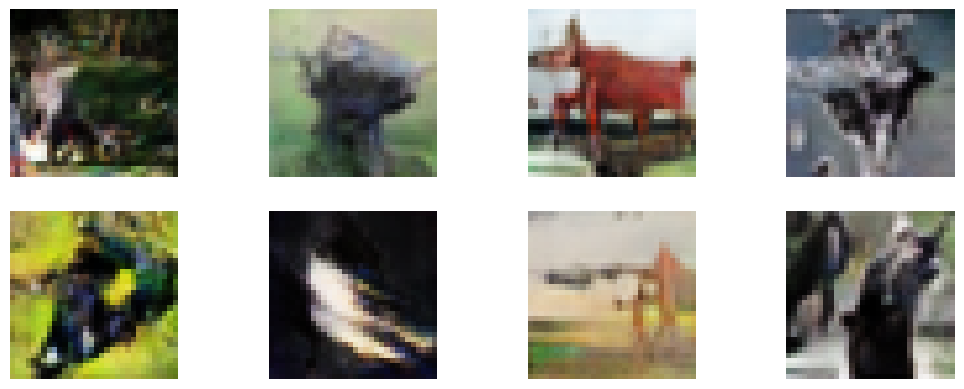

Iteration: 22940 - Generator loss: 1.2120 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.5639 - Discrimnator Accuracy: 67.19 %
Iteration: 22950 - Generator loss: 0.8830 - Generator Accuracy: 28.12 % - Discrimnator loss: 0.6194 - Discrimnator Accuracy: 64.06 %
Iteration: 22960 - Generator loss: 0.9676 - Generator Accuracy: 26.56 % - Discrimnator loss: 0.5973 - Discrimnator Accuracy: 67.58 %
Iteration: 22970 - Generator loss: 0.8824 - Generator Accuracy: 29.69 % - Discrimnator loss: 0.6103 - Discrimnator Accuracy: 64.45 %
Iteration: 22980 - Generator loss: 1.3574 - Generator Accuracy: 3.91 % - Discrimnator loss: 0.6093 - Discrimnator Accuracy: 67.19 %
Iteration: 22990 - Generator loss: 0.9185 - Generator Accuracy: 33.59 % - Discrimnator loss: 0.5729 - Discrimnator Accuracy: 71.09 %
Iteration: 23000 - Generator loss: 0.8469 - Generator Accuracy: 36.72 % - Discrimnator loss: 0.5993 - Discrimnator Accuracy: 66.80 %
Iteration: 23010 - Generator loss: 1.0256 - Generator Accuracy: 19.53 

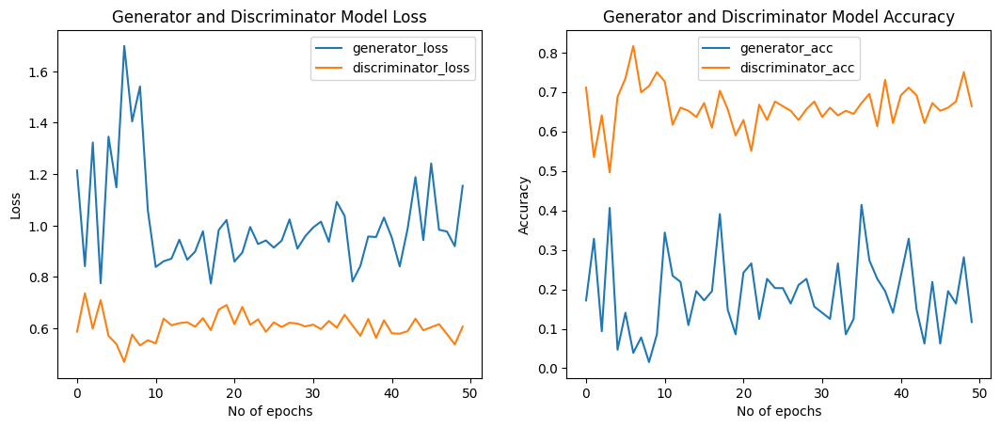

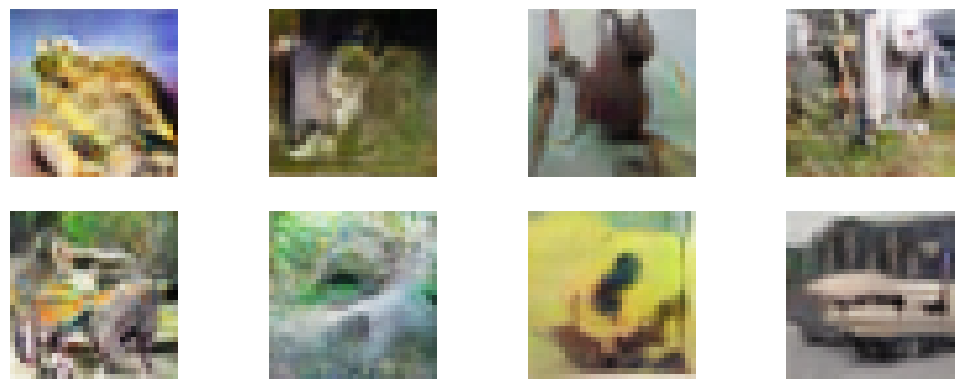

Iteration: 23410 - Generator loss: 0.9245 - Generator Accuracy: 28.91 % - Discrimnator loss: 0.5931 - Discrimnator Accuracy: 64.84 %
Iteration: 23420 - Generator loss: 0.9509 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.5969 - Discrimnator Accuracy: 65.62 %
Iteration: 23430 - Generator loss: 0.8353 - Generator Accuracy: 38.28 % - Discrimnator loss: 0.5610 - Discrimnator Accuracy: 71.48 %
Iteration: 23440 - Generator loss: 0.9592 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5530 - Discrimnator Accuracy: 68.36 %
Iteration: 23450 - Generator loss: 0.8258 - Generator Accuracy: 36.72 % - Discrimnator loss: 0.6107 - Discrimnator Accuracy: 64.06 %
Iteration: 23460 - Generator loss: 1.0198 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5529 - Discrimnator Accuracy: 73.44 %
Iteration: 23470 - Generator loss: 1.0445 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.5702 - Discrimnator Accuracy: 70.31 %
Iteration: 23480 - Generator loss: 1.1182 - Generator Accuracy: 10.94

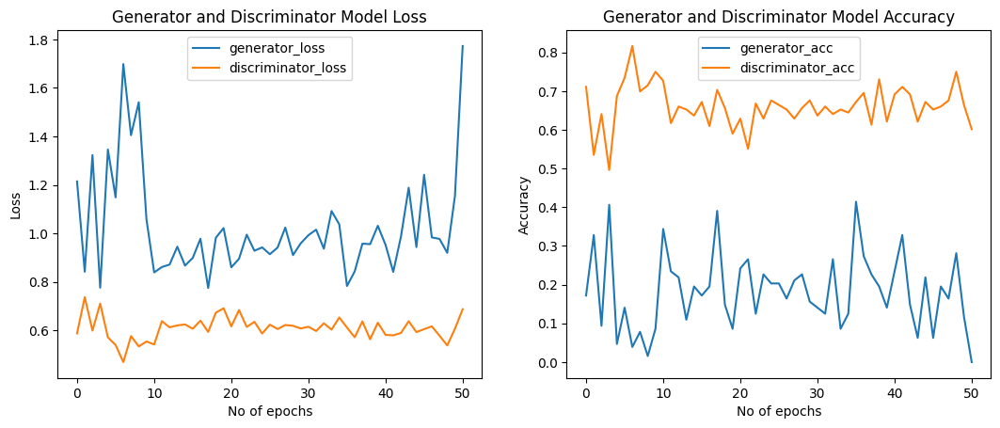

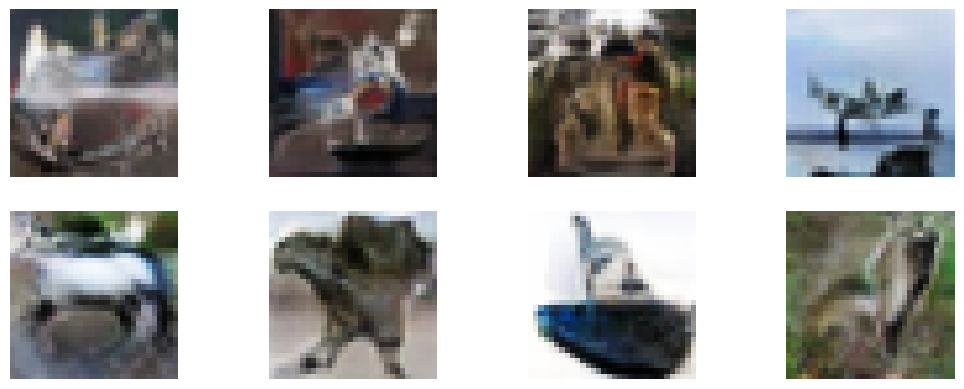

Iteration: 23870 - Generator loss: 0.6579 - Generator Accuracy: 57.81 % - Discrimnator loss: 0.5606 - Discrimnator Accuracy: 67.58 %
Iteration: 23880 - Generator loss: 0.9030 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.5779 - Discrimnator Accuracy: 68.36 %
Iteration: 23890 - Generator loss: 0.8159 - Generator Accuracy: 35.16 % - Discrimnator loss: 0.6062 - Discrimnator Accuracy: 64.06 %
Iteration: 23900 - Generator loss: 1.0370 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.6106 - Discrimnator Accuracy: 64.84 %
Iteration: 23910 - Generator loss: 1.0153 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.6129 - Discrimnator Accuracy: 63.67 %
Iteration: 23920 - Generator loss: 0.9986 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.5709 - Discrimnator Accuracy: 69.92 %
Iteration: 23930 - Generator loss: 1.0098 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6160 - Discrimnator Accuracy: 66.41 %
Iteration: 23940 - Generator loss: 1.0820 - Generator Accuracy: 15.62

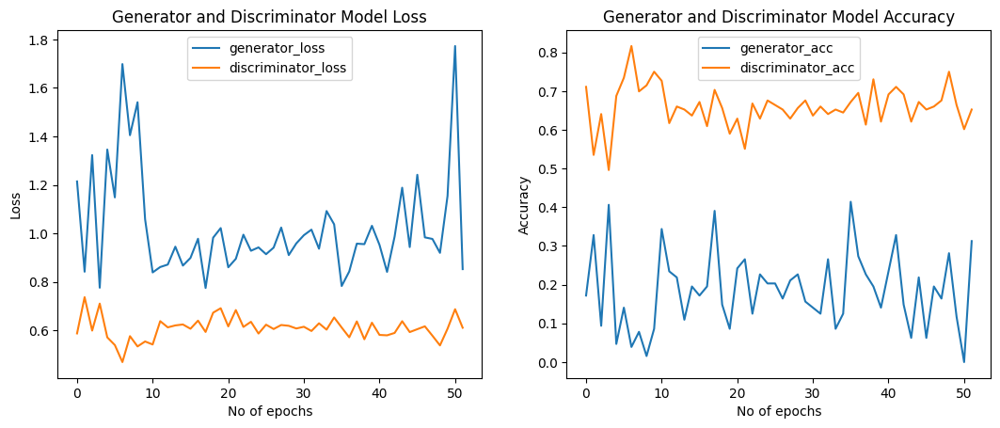

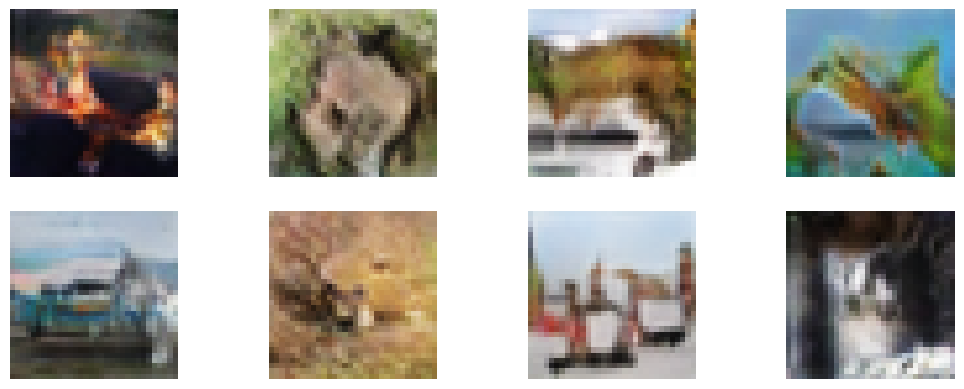

Iteration: 24340 - Generator loss: 0.9810 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.5656 - Discrimnator Accuracy: 68.75 %
Iteration: 24350 - Generator loss: 1.0179 - Generator Accuracy: 19.53 % - Discrimnator loss: 0.6077 - Discrimnator Accuracy: 64.06 %
Iteration: 24360 - Generator loss: 0.9912 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5980 - Discrimnator Accuracy: 64.45 %
Iteration: 24370 - Generator loss: 1.0528 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5948 - Discrimnator Accuracy: 64.06 %
Iteration: 24380 - Generator loss: 0.9628 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5959 - Discrimnator Accuracy: 66.80 %
Iteration: 24390 - Generator loss: 1.1368 - Generator Accuracy: 9.38 % - Discrimnator loss: 0.6011 - Discrimnator Accuracy: 64.84 %
Iteration: 24400 - Generator loss: 1.0514 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.5509 - Discrimnator Accuracy: 73.44 %
Iteration: 24410 - Generator loss: 0.8585 - Generator Accuracy: 32.03 

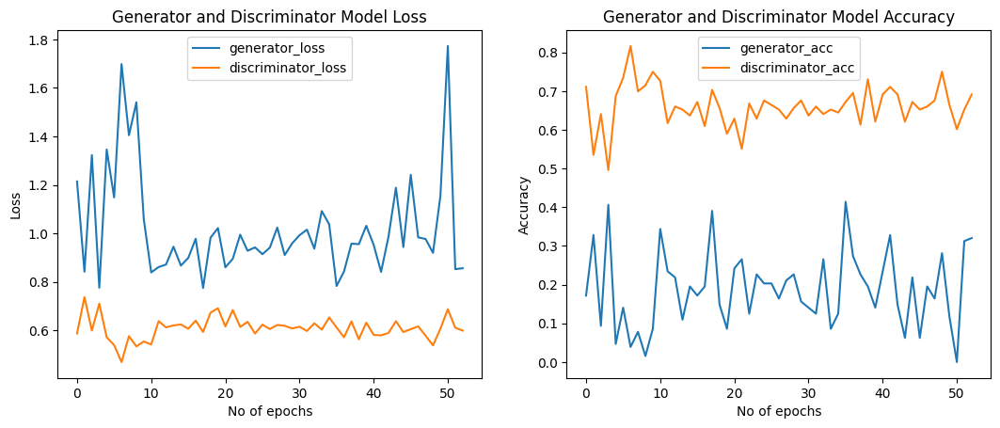

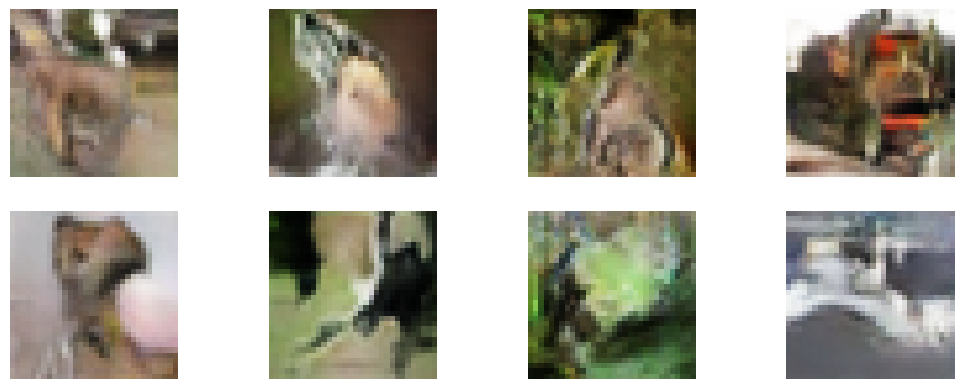

Iteration: 24810 - Generator loss: 1.0045 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5975 - Discrimnator Accuracy: 67.19 %
Iteration: 24820 - Generator loss: 0.8731 - Generator Accuracy: 28.12 % - Discrimnator loss: 0.5983 - Discrimnator Accuracy: 64.45 %
Iteration: 24830 - Generator loss: 0.9182 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.5699 - Discrimnator Accuracy: 71.09 %
Iteration: 24840 - Generator loss: 1.1652 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.5941 - Discrimnator Accuracy: 66.02 %
Iteration: 24850 - Generator loss: 0.9923 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5979 - Discrimnator Accuracy: 69.14 %
Iteration: 24860 - Generator loss: 1.0896 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5779 - Discrimnator Accuracy: 67.58 %
Iteration: 24870 - Generator loss: 1.0047 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.6002 - Discrimnator Accuracy: 67.58 %
Iteration: 24880 - Generator loss: 1.1964 - Generator Accuracy: 7.81 

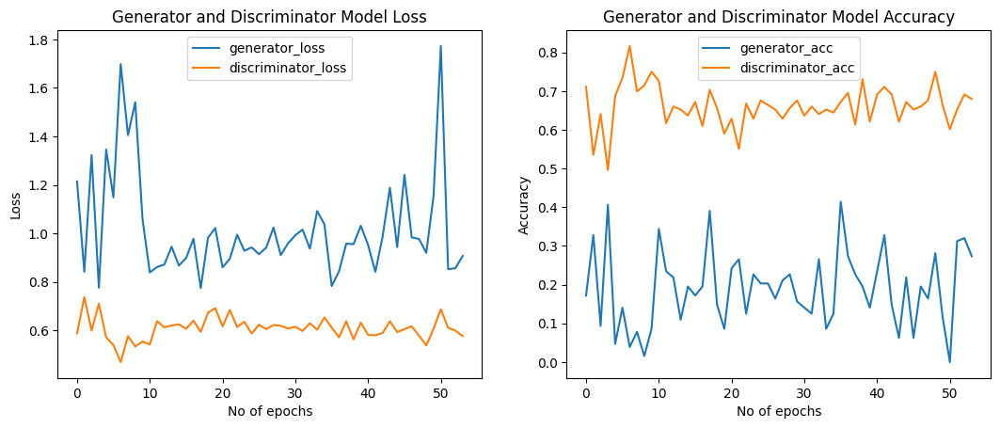

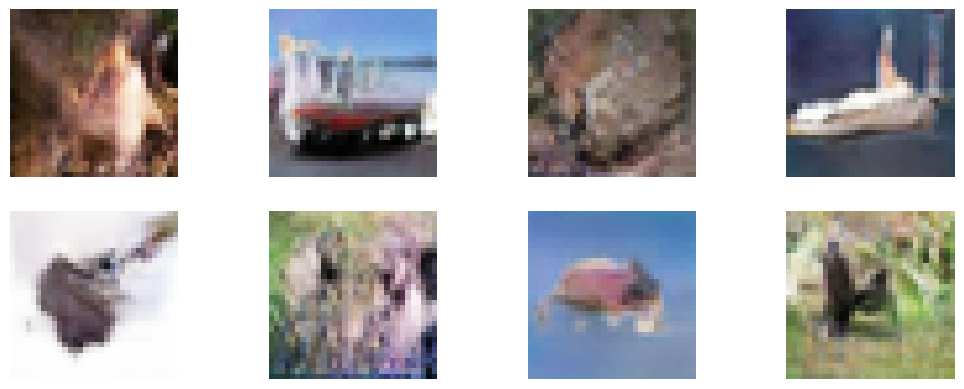

Iteration: 25280 - Generator loss: 0.9820 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.6533 - Discrimnator Accuracy: 62.89 %
Iteration: 25290 - Generator loss: 0.9421 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.5546 - Discrimnator Accuracy: 73.83 %
Iteration: 25300 - Generator loss: 0.9554 - Generator Accuracy: 19.53 % - Discrimnator loss: 0.5580 - Discrimnator Accuracy: 68.36 %
Iteration: 25310 - Generator loss: 0.9409 - Generator Accuracy: 28.91 % - Discrimnator loss: 0.5963 - Discrimnator Accuracy: 64.84 %
Iteration: 25320 - Generator loss: 0.7607 - Generator Accuracy: 48.44 % - Discrimnator loss: 0.6310 - Discrimnator Accuracy: 62.11 %
Iteration: 25330 - Generator loss: 1.0896 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.6335 - Discrimnator Accuracy: 68.36 %
Iteration: 25340 - Generator loss: 1.0108 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.6015 - Discrimnator Accuracy: 66.80 %
Iteration: 25350 - Generator loss: 1.3033 - Generator Accuracy: 5.47 

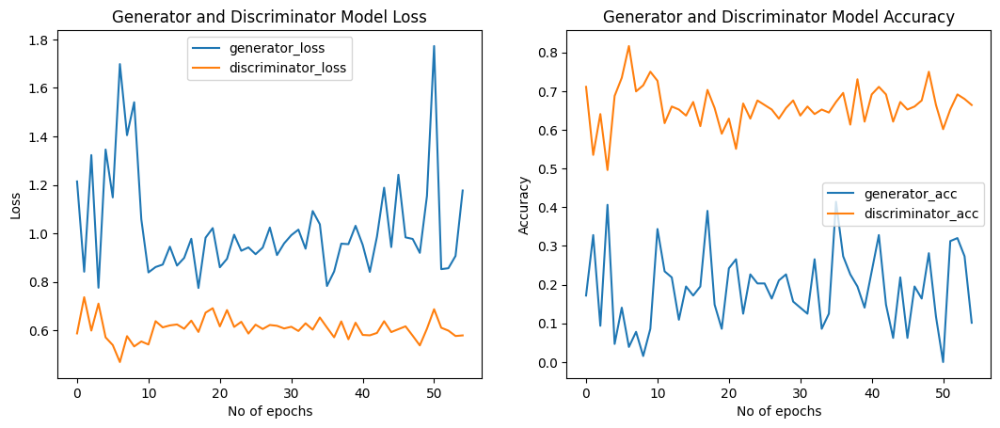

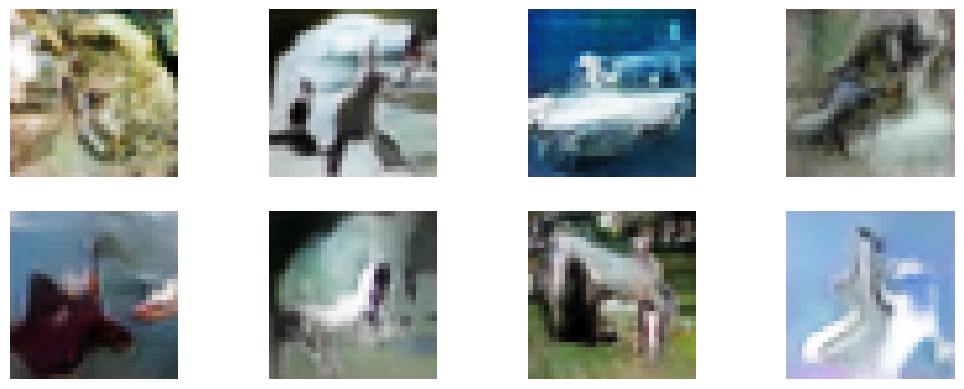

Iteration: 25750 - Generator loss: 1.1088 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.5639 - Discrimnator Accuracy: 69.14 %
Iteration: 25760 - Generator loss: 0.9098 - Generator Accuracy: 27.34 % - Discrimnator loss: 0.5667 - Discrimnator Accuracy: 71.48 %
Iteration: 25770 - Generator loss: 0.9713 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.5833 - Discrimnator Accuracy: 69.14 %
Iteration: 25780 - Generator loss: 0.8777 - Generator Accuracy: 30.47 % - Discrimnator loss: 0.5783 - Discrimnator Accuracy: 67.97 %
Iteration: 25790 - Generator loss: 0.9754 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.5826 - Discrimnator Accuracy: 67.97 %
Iteration: 25800 - Generator loss: 1.0758 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.6183 - Discrimnator Accuracy: 64.84 %
Iteration: 25810 - Generator loss: 0.8671 - Generator Accuracy: 29.69 % - Discrimnator loss: 0.5729 - Discrimnator Accuracy: 67.58 %
Iteration: 25820 - Generator loss: 0.9087 - Generator Accuracy: 33.59

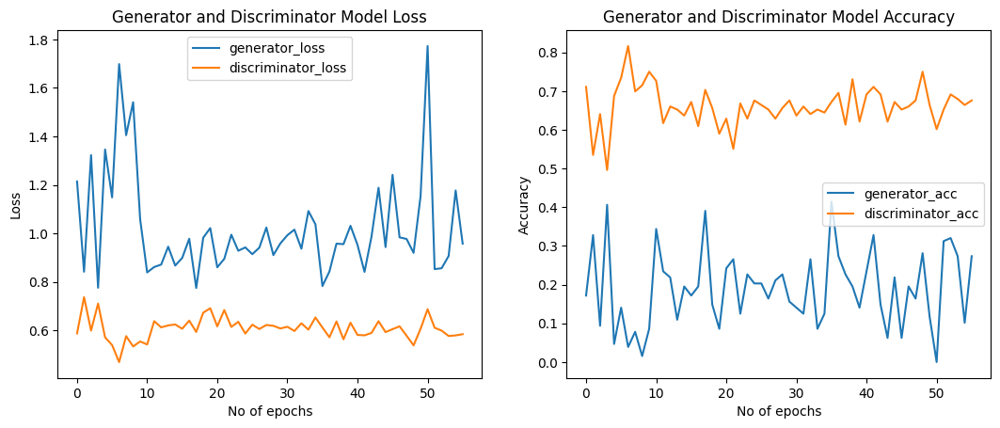

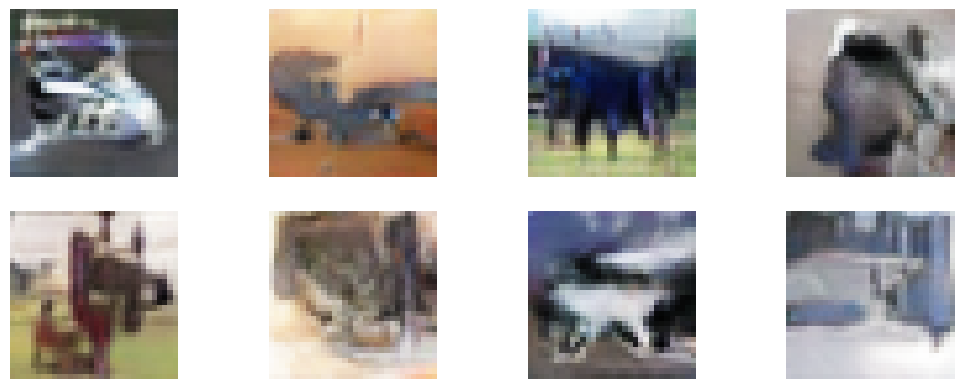

Iteration: 26210 - Generator loss: 0.9324 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.5559 - Discrimnator Accuracy: 69.14 %
Iteration: 26220 - Generator loss: 0.8743 - Generator Accuracy: 28.91 % - Discrimnator loss: 0.5949 - Discrimnator Accuracy: 68.36 %
Iteration: 26230 - Generator loss: 0.9550 - Generator Accuracy: 19.53 % - Discrimnator loss: 0.5668 - Discrimnator Accuracy: 67.19 %
Iteration: 26240 - Generator loss: 0.9374 - Generator Accuracy: 23.44 % - Discrimnator loss: 0.5905 - Discrimnator Accuracy: 68.75 %
Iteration: 26250 - Generator loss: 0.9948 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.5994 - Discrimnator Accuracy: 67.97 %
Iteration: 26260 - Generator loss: 1.1143 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.6026 - Discrimnator Accuracy: 65.62 %
Iteration: 26270 - Generator loss: 1.2069 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.5845 - Discrimnator Accuracy: 68.75 %
Iteration: 26280 - Generator loss: 0.9055 - Generator Accuracy: 25.00

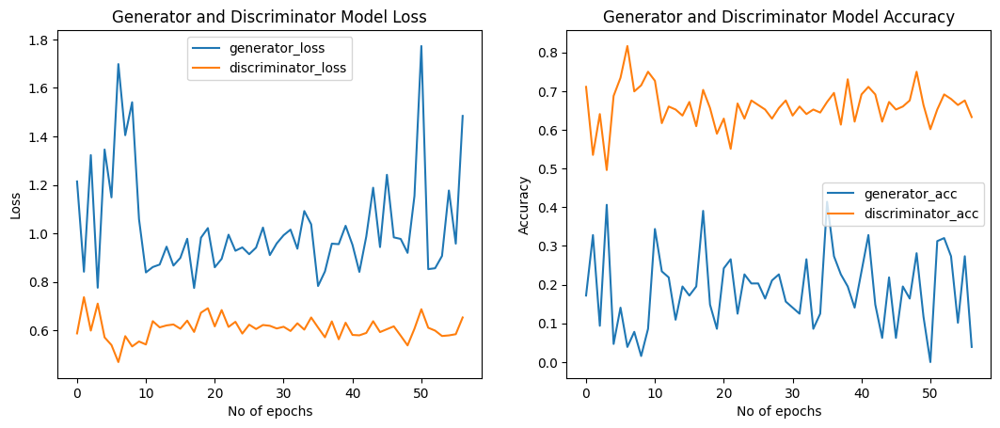

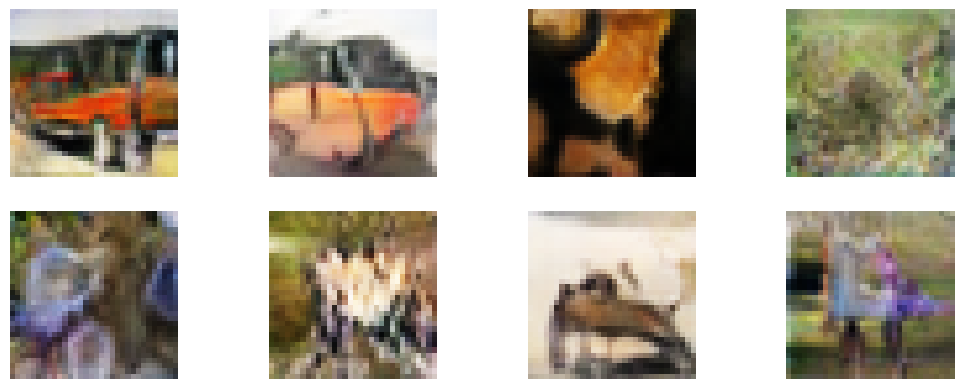

Iteration: 26680 - Generator loss: 0.9513 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.5891 - Discrimnator Accuracy: 70.31 %
Iteration: 26690 - Generator loss: 1.0062 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.5917 - Discrimnator Accuracy: 63.67 %
Iteration: 26700 - Generator loss: 1.1097 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.5689 - Discrimnator Accuracy: 67.58 %
Iteration: 26710 - Generator loss: 1.0055 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5659 - Discrimnator Accuracy: 72.27 %
Iteration: 26720 - Generator loss: 0.9685 - Generator Accuracy: 23.44 % - Discrimnator loss: 0.5638 - Discrimnator Accuracy: 68.36 %
Iteration: 26730 - Generator loss: 0.9947 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.6269 - Discrimnator Accuracy: 64.45 %
Iteration: 26740 - Generator loss: 0.7536 - Generator Accuracy: 42.97 % - Discrimnator loss: 0.5578 - Discrimnator Accuracy: 71.09 %
Iteration: 26750 - Generator loss: 0.8735 - Generator Accuracy: 29.69

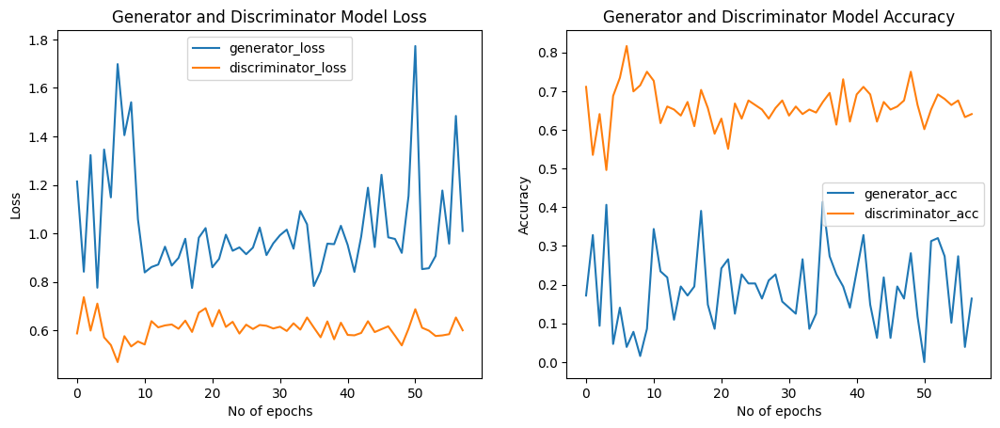

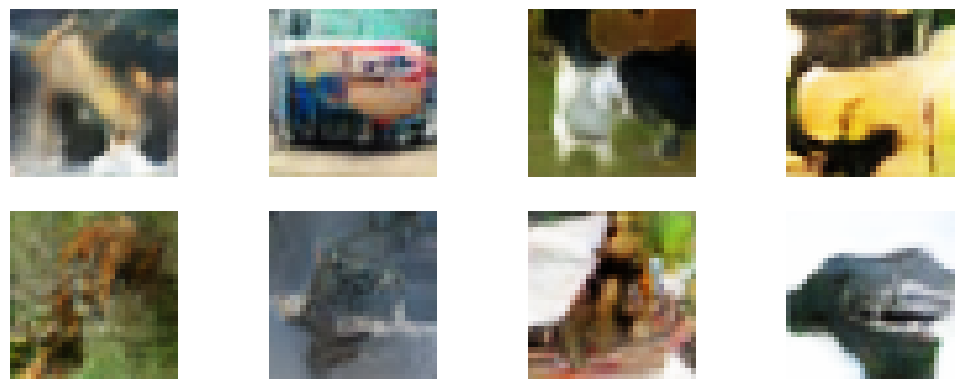

Iteration: 27150 - Generator loss: 1.0890 - Generator Accuracy: 11.72 % - Discrimnator loss: 0.5904 - Discrimnator Accuracy: 66.80 %
Iteration: 27160 - Generator loss: 1.1605 - Generator Accuracy: 11.72 % - Discrimnator loss: 0.6201 - Discrimnator Accuracy: 62.89 %
Iteration: 27170 - Generator loss: 0.9056 - Generator Accuracy: 28.91 % - Discrimnator loss: 0.5701 - Discrimnator Accuracy: 70.70 %
Iteration: 27180 - Generator loss: 1.0374 - Generator Accuracy: 19.53 % - Discrimnator loss: 0.6122 - Discrimnator Accuracy: 63.28 %
Iteration: 27190 - Generator loss: 0.9824 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.5959 - Discrimnator Accuracy: 64.06 %
Iteration: 27200 - Generator loss: 1.1678 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5958 - Discrimnator Accuracy: 69.92 %
Iteration: 27210 - Generator loss: 1.1894 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.5992 - Discrimnator Accuracy: 64.45 %
Iteration: 27220 - Generator loss: 1.0525 - Generator Accuracy: 14.84

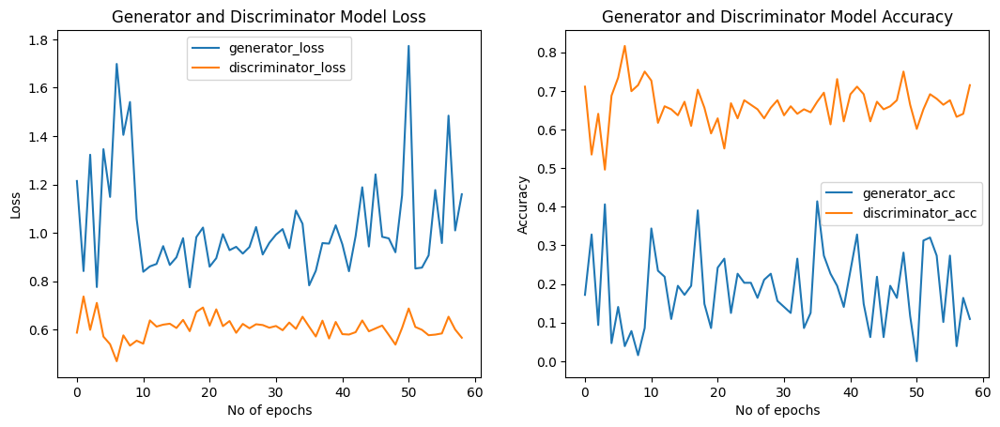

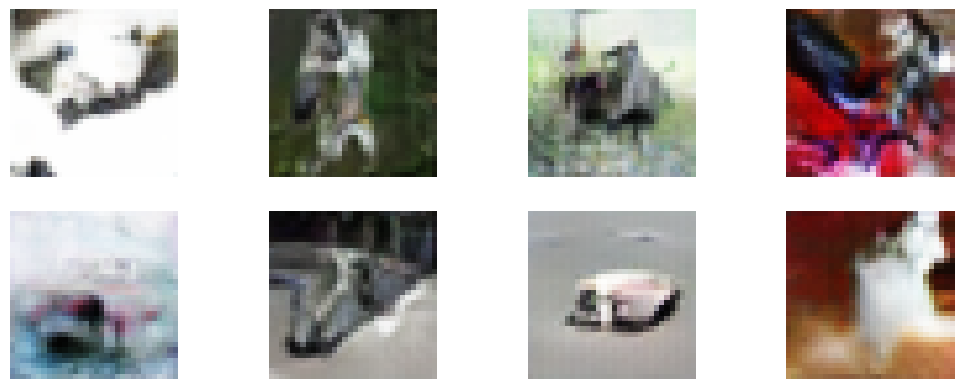

Iteration: 27620 - Generator loss: 0.9527 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5760 - Discrimnator Accuracy: 69.14 %
Iteration: 27630 - Generator loss: 1.0061 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6176 - Discrimnator Accuracy: 64.45 %
Iteration: 27640 - Generator loss: 0.9033 - Generator Accuracy: 36.72 % - Discrimnator loss: 0.5959 - Discrimnator Accuracy: 69.53 %
Iteration: 27650 - Generator loss: 1.4566 - Generator Accuracy: 4.69 % - Discrimnator loss: 0.5779 - Discrimnator Accuracy: 67.97 %
Iteration: 27660 - Generator loss: 1.0432 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5694 - Discrimnator Accuracy: 65.62 %
Iteration: 27670 - Generator loss: 1.1800 - Generator Accuracy: 5.47 % - Discrimnator loss: 0.5443 - Discrimnator Accuracy: 71.09 %
Iteration: 27680 - Generator loss: 1.0743 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5708 - Discrimnator Accuracy: 73.44 %
Iteration: 27690 - Generator loss: 1.2205 - Generator Accuracy: 9.38 % 

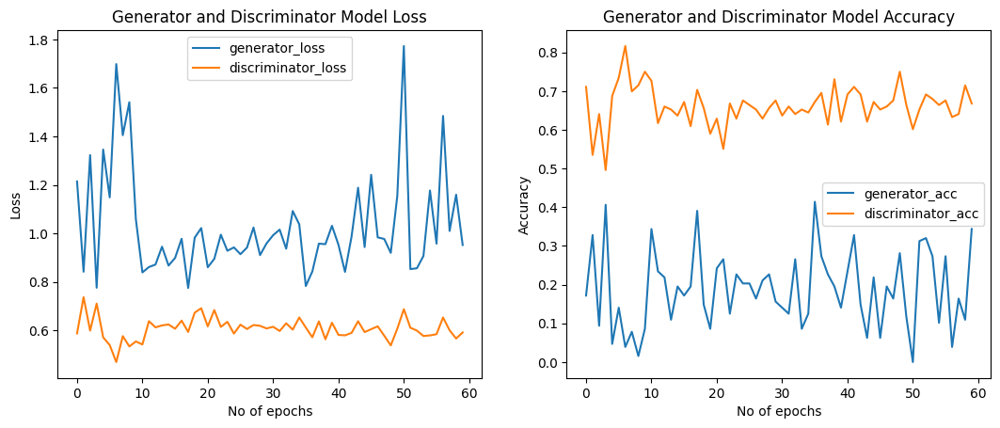

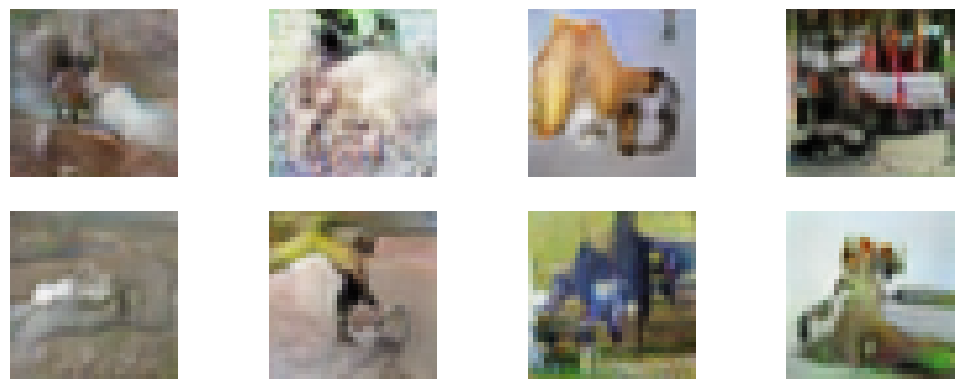

Iteration: 28090 - Generator loss: 0.9522 - Generator Accuracy: 29.69 % - Discrimnator loss: 0.5650 - Discrimnator Accuracy: 73.44 %
Iteration: 28100 - Generator loss: 1.0956 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6055 - Discrimnator Accuracy: 66.41 %
Iteration: 28110 - Generator loss: 0.9781 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.5921 - Discrimnator Accuracy: 67.58 %
Iteration: 28120 - Generator loss: 0.9773 - Generator Accuracy: 27.34 % - Discrimnator loss: 0.5535 - Discrimnator Accuracy: 70.31 %
Iteration: 28130 - Generator loss: 0.9881 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.6363 - Discrimnator Accuracy: 60.55 %
Iteration: 28140 - Generator loss: 1.0023 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5152 - Discrimnator Accuracy: 72.66 %
Iteration: 28150 - Generator loss: 1.3215 - Generator Accuracy: 8.59 % - Discrimnator loss: 0.5954 - Discrimnator Accuracy: 68.75 %
Iteration: 28160 - Generator loss: 1.1425 - Generator Accuracy: 12.50 

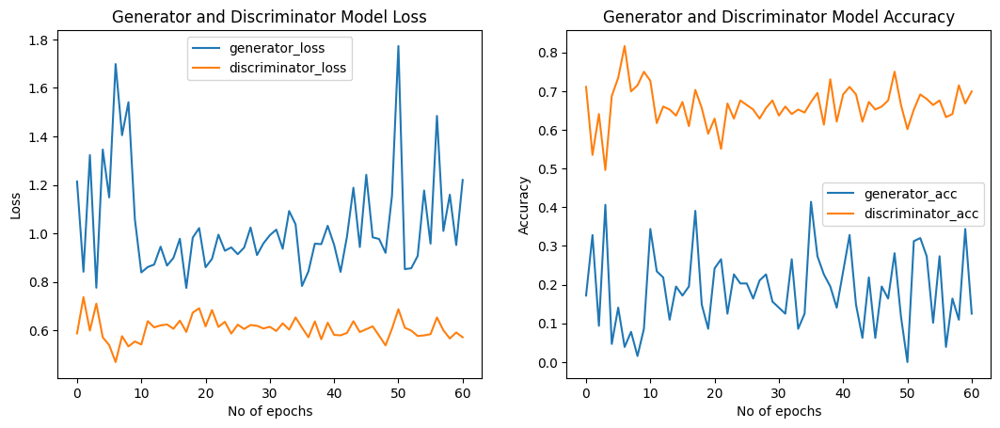

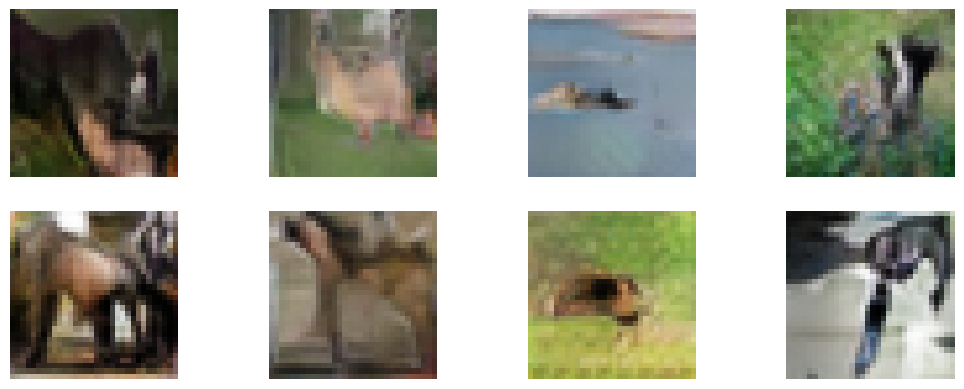

Iteration: 28550 - Generator loss: 0.9889 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.5497 - Discrimnator Accuracy: 69.14 %
Iteration: 28560 - Generator loss: 0.8364 - Generator Accuracy: 39.06 % - Discrimnator loss: 0.6038 - Discrimnator Accuracy: 69.14 %
Iteration: 28570 - Generator loss: 0.7079 - Generator Accuracy: 54.69 % - Discrimnator loss: 0.6370 - Discrimnator Accuracy: 62.50 %
Iteration: 28580 - Generator loss: 0.8433 - Generator Accuracy: 35.94 % - Discrimnator loss: 0.5955 - Discrimnator Accuracy: 64.45 %
Iteration: 28590 - Generator loss: 0.9991 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5913 - Discrimnator Accuracy: 65.62 %
Iteration: 28600 - Generator loss: 0.9633 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5936 - Discrimnator Accuracy: 66.80 %
Iteration: 28610 - Generator loss: 0.9053 - Generator Accuracy: 26.56 % - Discrimnator loss: 0.5456 - Discrimnator Accuracy: 71.88 %
Iteration: 28620 - Generator loss: 1.0116 - Generator Accuracy: 19.53

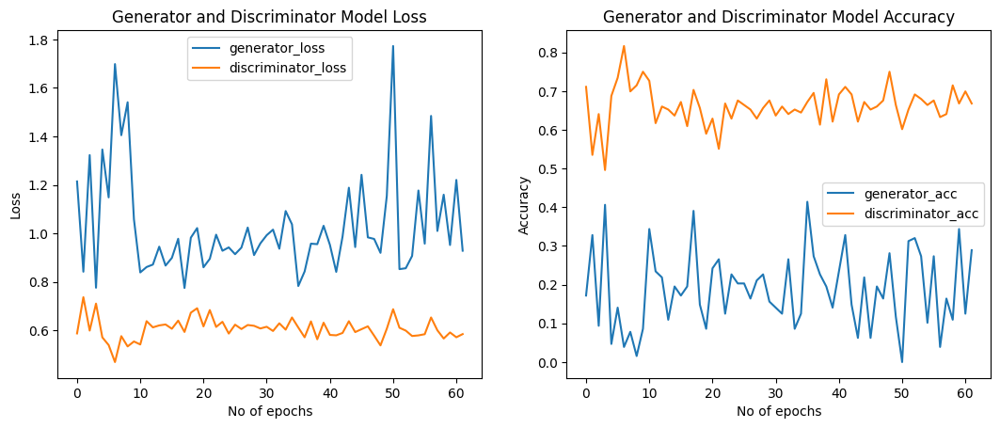

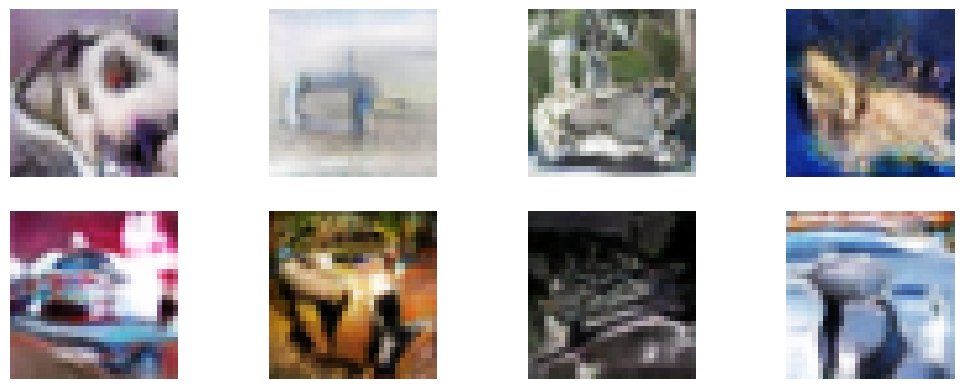

Iteration: 29020 - Generator loss: 1.0129 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5632 - Discrimnator Accuracy: 71.09 %
Iteration: 29030 - Generator loss: 1.0131 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.5403 - Discrimnator Accuracy: 69.92 %
Iteration: 29040 - Generator loss: 0.8531 - Generator Accuracy: 33.59 % - Discrimnator loss: 0.6072 - Discrimnator Accuracy: 62.50 %
Iteration: 29050 - Generator loss: 1.1549 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5398 - Discrimnator Accuracy: 73.83 %
Iteration: 29060 - Generator loss: 1.0097 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5575 - Discrimnator Accuracy: 72.27 %
Iteration: 29070 - Generator loss: 0.9655 - Generator Accuracy: 19.53 % - Discrimnator loss: 0.5855 - Discrimnator Accuracy: 68.36 %
Iteration: 29080 - Generator loss: 1.0548 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5934 - Discrimnator Accuracy: 66.80 %
Iteration: 29090 - Generator loss: 1.3088 - Generator Accuracy: 7.03 

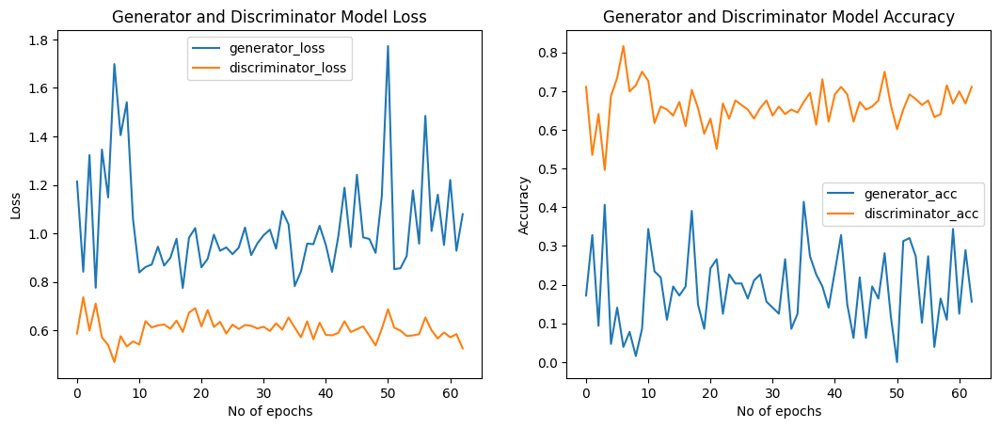

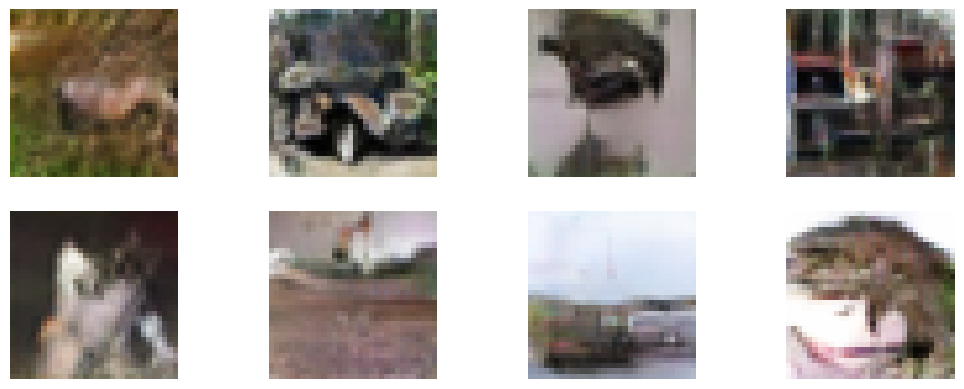

Iteration: 29490 - Generator loss: 1.1224 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5495 - Discrimnator Accuracy: 70.31 %
Iteration: 29500 - Generator loss: 1.1176 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.5789 - Discrimnator Accuracy: 67.97 %
Iteration: 29510 - Generator loss: 1.0474 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.5842 - Discrimnator Accuracy: 69.14 %
Iteration: 29520 - Generator loss: 0.9615 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.6113 - Discrimnator Accuracy: 64.45 %
Iteration: 29530 - Generator loss: 1.0783 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.5785 - Discrimnator Accuracy: 68.75 %
Iteration: 29540 - Generator loss: 0.9695 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.5850 - Discrimnator Accuracy: 64.06 %
Iteration: 29550 - Generator loss: 1.2167 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.5667 - Discrimnator Accuracy: 68.75 %
Iteration: 29560 - Generator loss: 1.3400 - Generator Accuracy: 8.59 

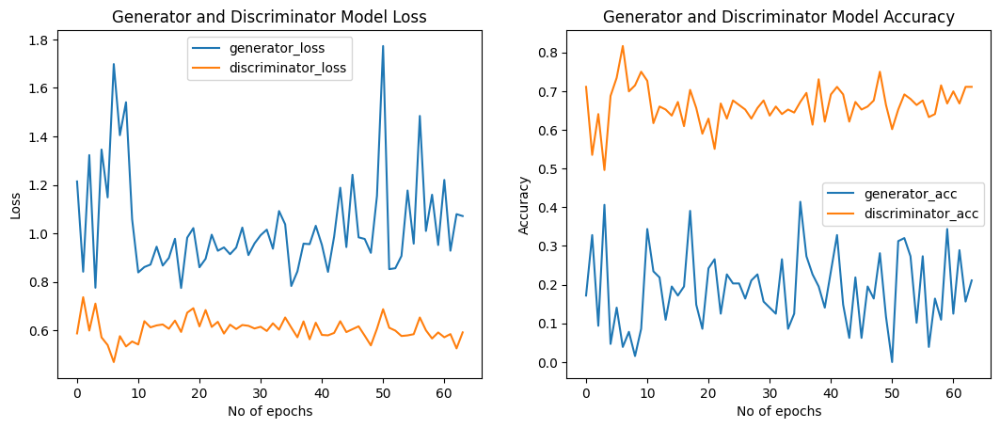

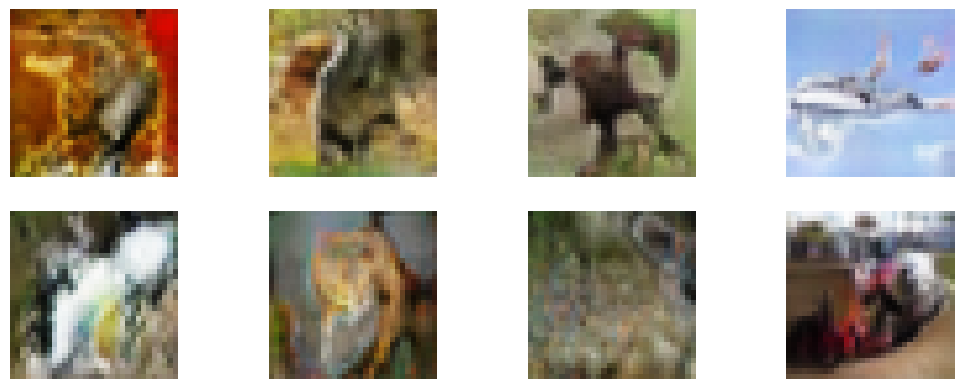

Iteration: 29960 - Generator loss: 1.1054 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.5869 - Discrimnator Accuracy: 71.09 %
Iteration: 29970 - Generator loss: 1.0773 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.5300 - Discrimnator Accuracy: 72.66 %
Iteration: 29980 - Generator loss: 1.0235 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.5753 - Discrimnator Accuracy: 70.31 %
Iteration: 29990 - Generator loss: 0.7386 - Generator Accuracy: 50.00 % - Discrimnator loss: 0.5710 - Discrimnator Accuracy: 70.31 %
Iteration: 30000 - Generator loss: 1.0836 - Generator Accuracy: 19.53 % - Discrimnator loss: 0.5552 - Discrimnator Accuracy: 71.09 %
Iteration: 30010 - Generator loss: 0.9941 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.5663 - Discrimnator Accuracy: 67.19 %
Iteration: 30020 - Generator loss: 0.8499 - Generator Accuracy: 37.50 % - Discrimnator loss: 0.5995 - Discrimnator Accuracy: 69.14 %
Iteration: 30030 - Generator loss: 0.9757 - Generator Accuracy: 23.44

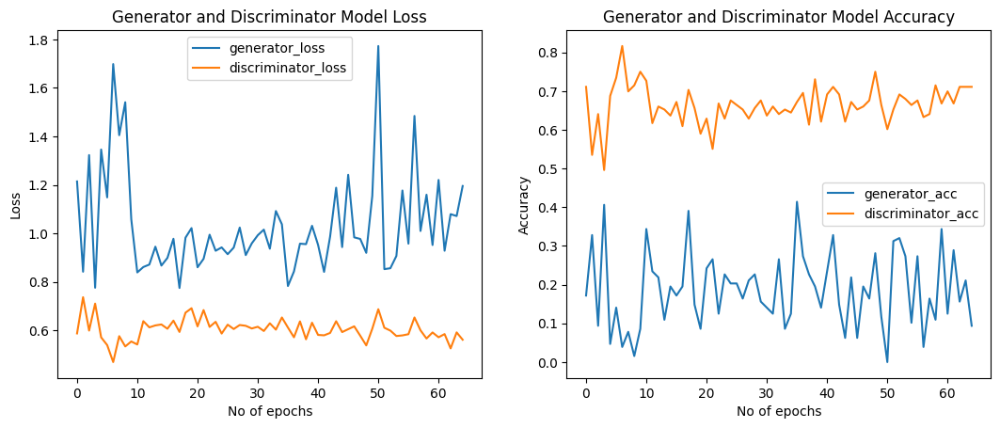

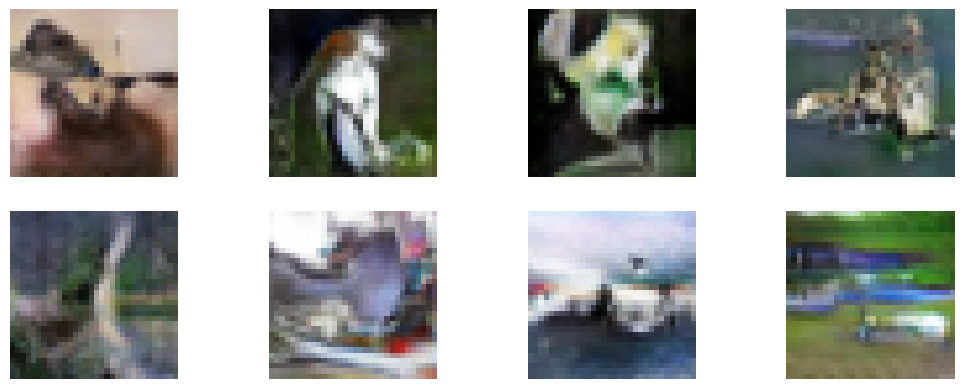

Iteration: 30430 - Generator loss: 0.9887 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.5517 - Discrimnator Accuracy: 72.66 %
Iteration: 30440 - Generator loss: 1.0286 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5554 - Discrimnator Accuracy: 68.36 %
Iteration: 30450 - Generator loss: 0.8793 - Generator Accuracy: 30.47 % - Discrimnator loss: 0.5743 - Discrimnator Accuracy: 70.31 %
Iteration: 30460 - Generator loss: 1.0214 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5439 - Discrimnator Accuracy: 72.27 %
Iteration: 30470 - Generator loss: 0.9054 - Generator Accuracy: 29.69 % - Discrimnator loss: 0.5695 - Discrimnator Accuracy: 70.31 %
Iteration: 30480 - Generator loss: 0.9189 - Generator Accuracy: 28.12 % - Discrimnator loss: 0.5876 - Discrimnator Accuracy: 69.53 %
Iteration: 30490 - Generator loss: 1.0153 - Generator Accuracy: 19.53 % - Discrimnator loss: 0.5626 - Discrimnator Accuracy: 71.48 %
Iteration: 30500 - Generator loss: 1.0145 - Generator Accuracy: 21.88

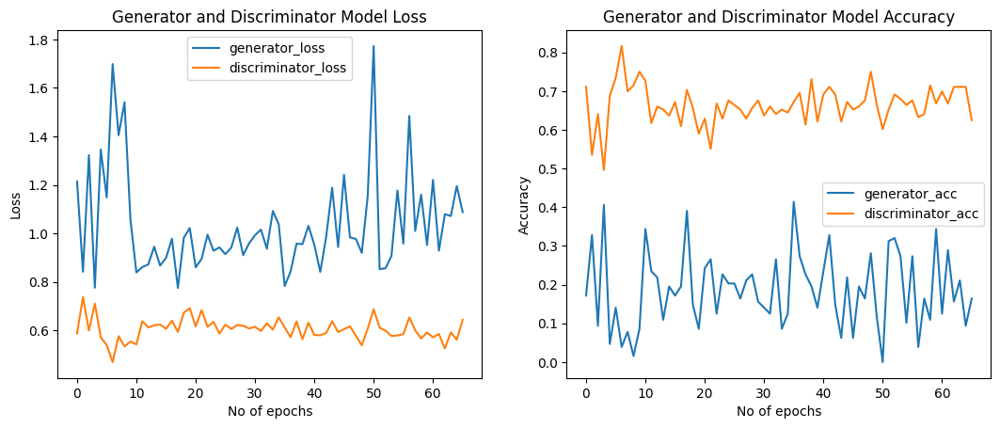

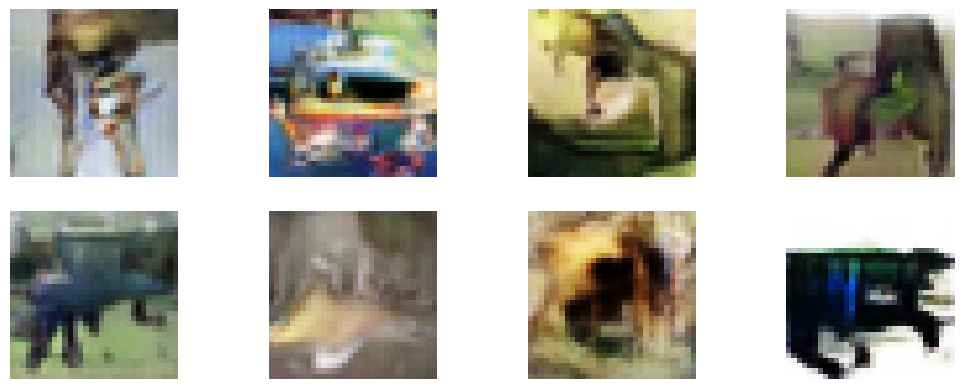

Iteration: 30890 - Generator loss: 1.4746 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.5856 - Discrimnator Accuracy: 67.58 %
Iteration: 30900 - Generator loss: 1.0488 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.6119 - Discrimnator Accuracy: 64.45 %
Iteration: 30910 - Generator loss: 1.1259 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.5436 - Discrimnator Accuracy: 70.70 %
Iteration: 30920 - Generator loss: 0.9587 - Generator Accuracy: 28.12 % - Discrimnator loss: 0.5440 - Discrimnator Accuracy: 73.44 %
Iteration: 30930 - Generator loss: 1.0601 - Generator Accuracy: 19.53 % - Discrimnator loss: 0.5578 - Discrimnator Accuracy: 69.53 %
Iteration: 30940 - Generator loss: 0.9710 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.5890 - Discrimnator Accuracy: 69.53 %
Iteration: 30950 - Generator loss: 1.0567 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6025 - Discrimnator Accuracy: 69.92 %
Iteration: 30960 - Generator loss: 1.1232 - Generator Accuracy: 17.97

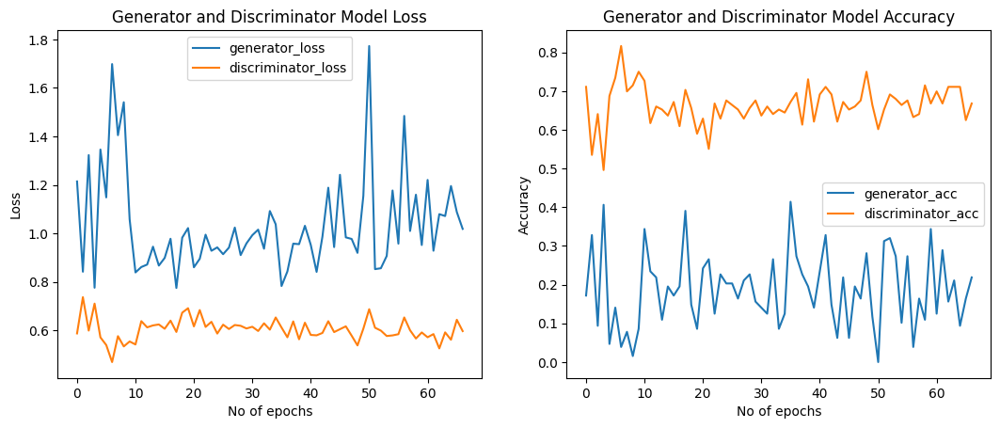

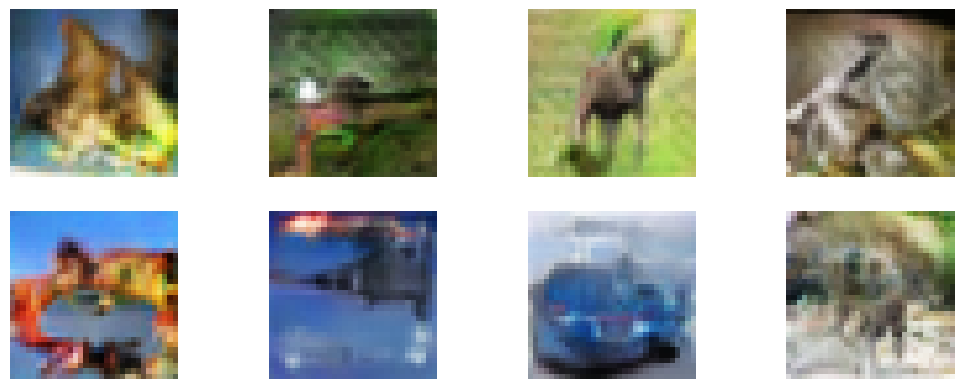

Iteration: 31360 - Generator loss: 1.1768 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.5432 - Discrimnator Accuracy: 71.09 %
Iteration: 31370 - Generator loss: 1.2851 - Generator Accuracy: 7.81 % - Discrimnator loss: 0.5408 - Discrimnator Accuracy: 69.53 %
Iteration: 31380 - Generator loss: 0.9649 - Generator Accuracy: 28.91 % - Discrimnator loss: 0.5572 - Discrimnator Accuracy: 71.09 %
Iteration: 31390 - Generator loss: 0.9934 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.5292 - Discrimnator Accuracy: 68.36 %
Iteration: 31400 - Generator loss: 1.1227 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.5484 - Discrimnator Accuracy: 70.31 %
Iteration: 31410 - Generator loss: 0.9023 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.5746 - Discrimnator Accuracy: 66.02 %
Iteration: 31420 - Generator loss: 1.0345 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5612 - Discrimnator Accuracy: 69.92 %
Iteration: 31430 - Generator loss: 1.1747 - Generator Accuracy: 17.19 

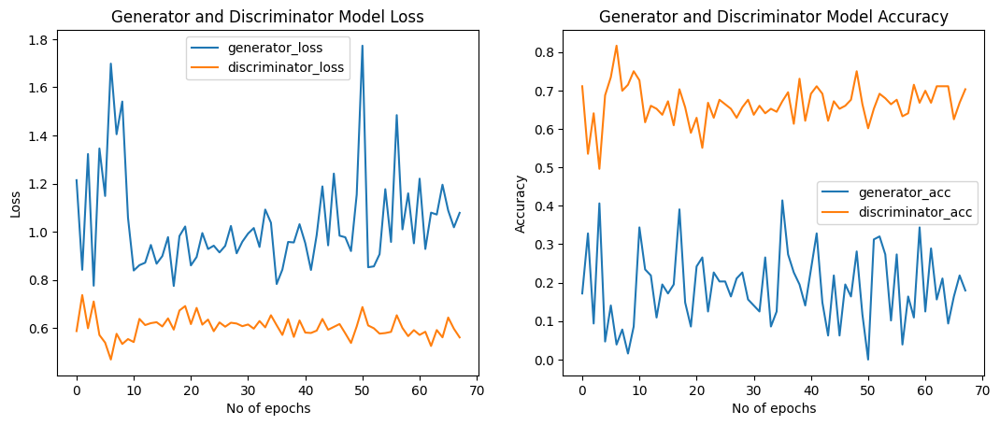

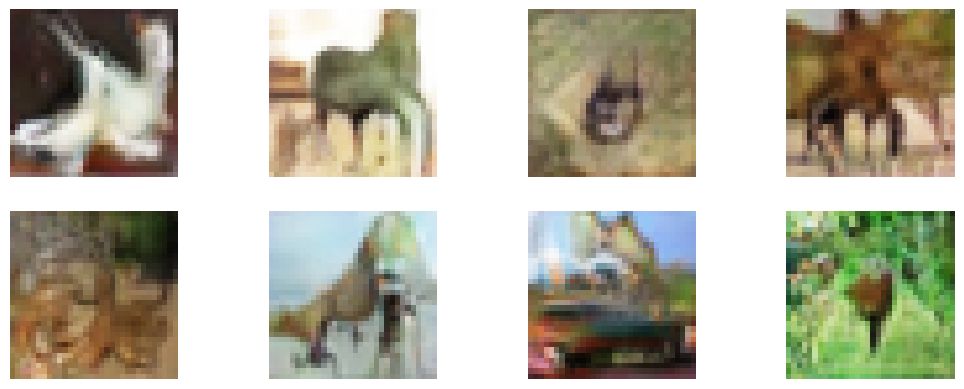

Iteration: 31830 - Generator loss: 1.1056 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5342 - Discrimnator Accuracy: 71.88 %
Iteration: 31840 - Generator loss: 1.0205 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.5328 - Discrimnator Accuracy: 73.83 %
Iteration: 31850 - Generator loss: 1.0827 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.6154 - Discrimnator Accuracy: 65.23 %
Iteration: 31860 - Generator loss: 0.9713 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5881 - Discrimnator Accuracy: 67.19 %
Iteration: 31870 - Generator loss: 0.9339 - Generator Accuracy: 32.03 % - Discrimnator loss: 0.6145 - Discrimnator Accuracy: 64.45 %
Iteration: 31880 - Generator loss: 1.3579 - Generator Accuracy: 6.25 % - Discrimnator loss: 0.5924 - Discrimnator Accuracy: 67.19 %
Iteration: 31890 - Generator loss: 1.0232 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.5633 - Discrimnator Accuracy: 68.36 %
Iteration: 31900 - Generator loss: 1.2656 - Generator Accuracy: 7.03 %

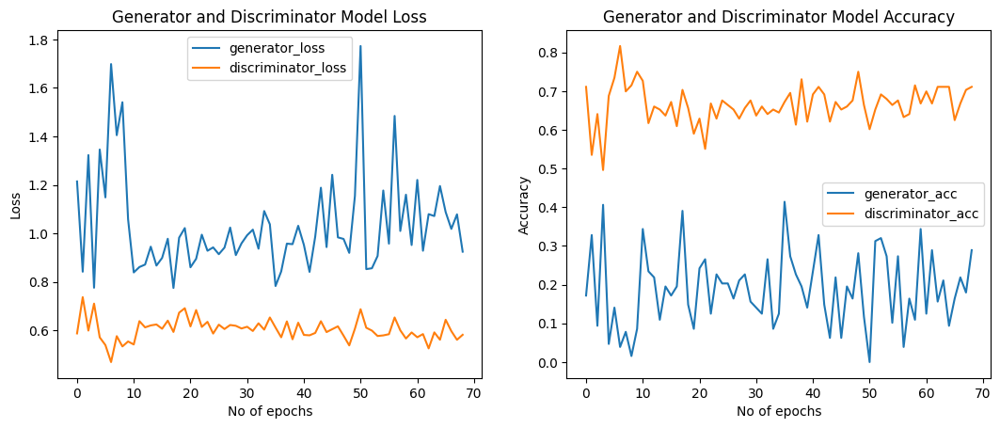

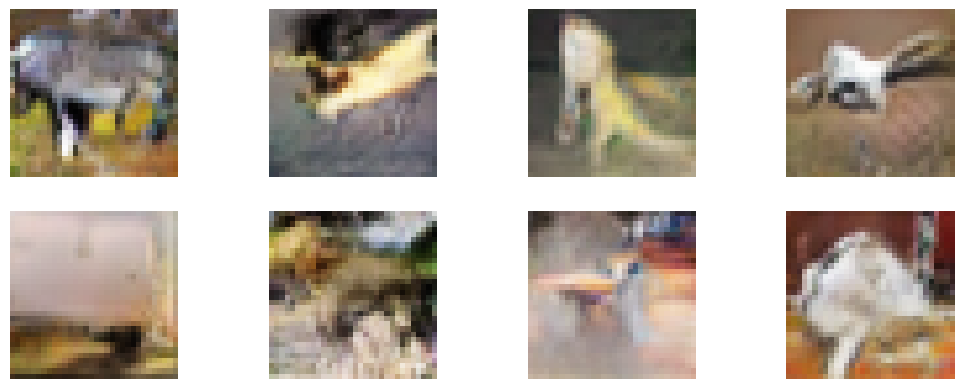

Iteration: 32300 - Generator loss: 0.9376 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5729 - Discrimnator Accuracy: 68.75 %
Iteration: 32310 - Generator loss: 1.0888 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.5906 - Discrimnator Accuracy: 67.97 %
Iteration: 32320 - Generator loss: 1.1214 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5484 - Discrimnator Accuracy: 69.14 %
Iteration: 32330 - Generator loss: 0.9670 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5672 - Discrimnator Accuracy: 69.14 %
Iteration: 32340 - Generator loss: 1.0500 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.5520 - Discrimnator Accuracy: 69.92 %
Iteration: 32350 - Generator loss: 1.0265 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5675 - Discrimnator Accuracy: 67.97 %
Iteration: 32360 - Generator loss: 1.3197 - Generator Accuracy: 5.47 % - Discrimnator loss: 0.5603 - Discrimnator Accuracy: 70.70 %
Iteration: 32370 - Generator loss: 1.0191 - Generator Accuracy: 25.00 

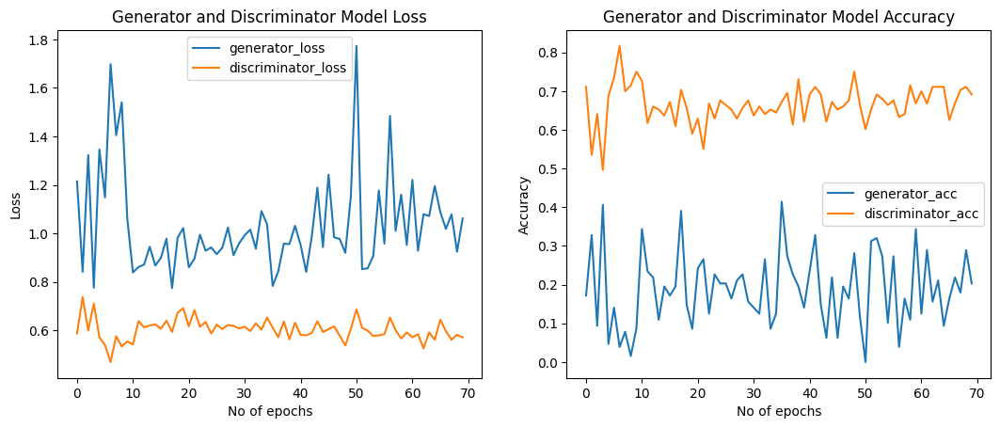

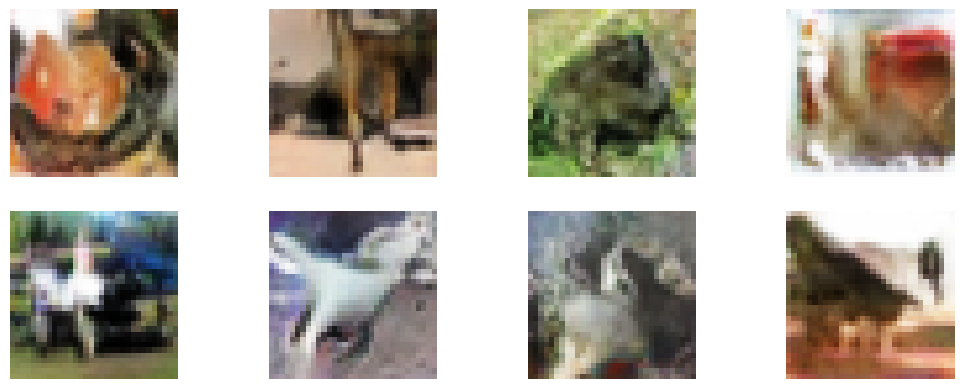

Iteration: 32770 - Generator loss: 1.0360 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5619 - Discrimnator Accuracy: 68.36 %
Iteration: 32780 - Generator loss: 1.0946 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.5241 - Discrimnator Accuracy: 73.44 %
Iteration: 32790 - Generator loss: 1.1376 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5551 - Discrimnator Accuracy: 73.83 %
Iteration: 32800 - Generator loss: 1.1862 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5693 - Discrimnator Accuracy: 67.58 %
Iteration: 32810 - Generator loss: 1.0006 - Generator Accuracy: 26.56 % - Discrimnator loss: 0.5503 - Discrimnator Accuracy: 72.66 %
Iteration: 32820 - Generator loss: 1.0708 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.5511 - Discrimnator Accuracy: 73.83 %
Iteration: 32830 - Generator loss: 1.2071 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.5822 - Discrimnator Accuracy: 69.92 %
Iteration: 32840 - Generator loss: 1.0390 - Generator Accuracy: 21.88

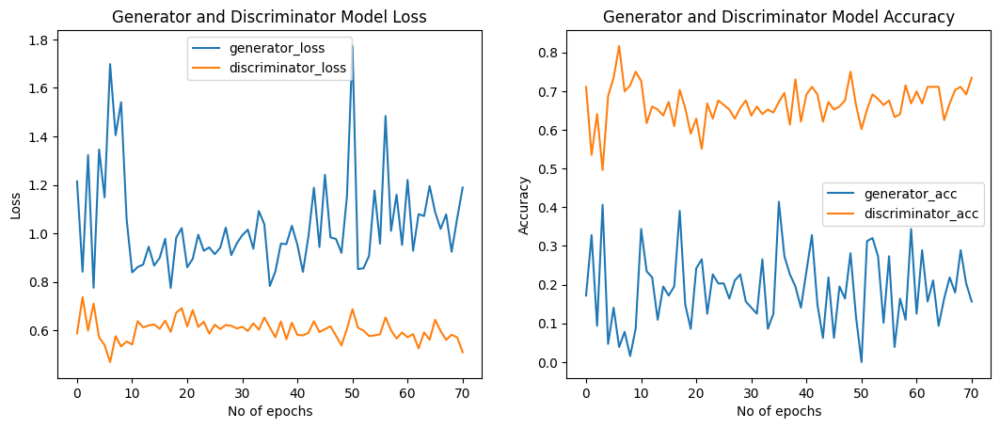

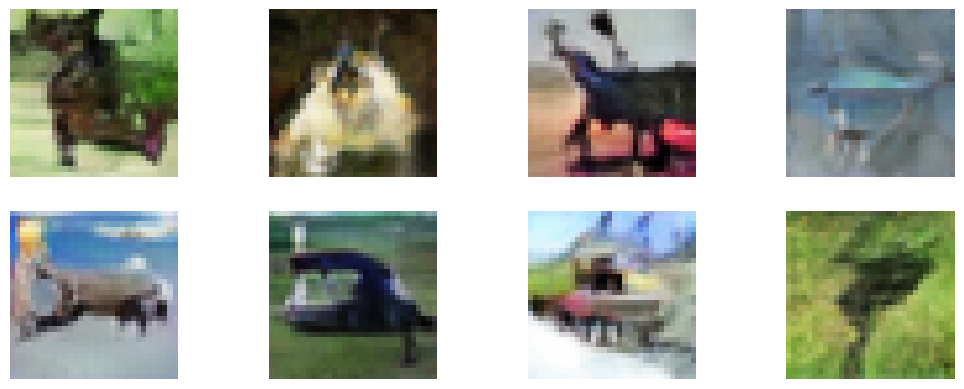

Iteration: 33230 - Generator loss: 0.9721 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.5517 - Discrimnator Accuracy: 70.70 %
Iteration: 33240 - Generator loss: 1.0467 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5547 - Discrimnator Accuracy: 72.66 %
Iteration: 33250 - Generator loss: 0.9765 - Generator Accuracy: 23.44 % - Discrimnator loss: 0.5547 - Discrimnator Accuracy: 67.19 %
Iteration: 33260 - Generator loss: 1.3142 - Generator Accuracy: 8.59 % - Discrimnator loss: 0.5604 - Discrimnator Accuracy: 71.48 %
Iteration: 33270 - Generator loss: 0.9145 - Generator Accuracy: 32.03 % - Discrimnator loss: 0.5675 - Discrimnator Accuracy: 71.09 %
Iteration: 33280 - Generator loss: 0.8627 - Generator Accuracy: 32.81 % - Discrimnator loss: 0.5251 - Discrimnator Accuracy: 75.00 %
Iteration: 33290 - Generator loss: 1.1018 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.5989 - Discrimnator Accuracy: 68.36 %
Iteration: 33300 - Generator loss: 1.1253 - Generator Accuracy: 17.97 

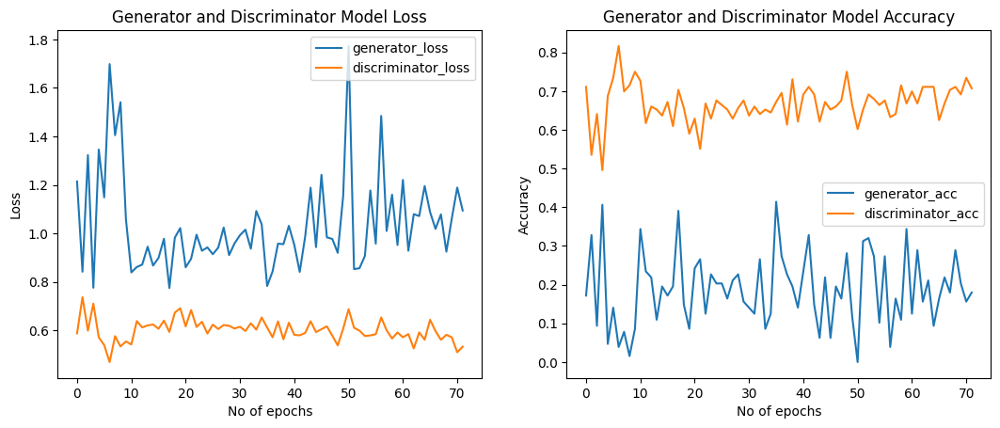

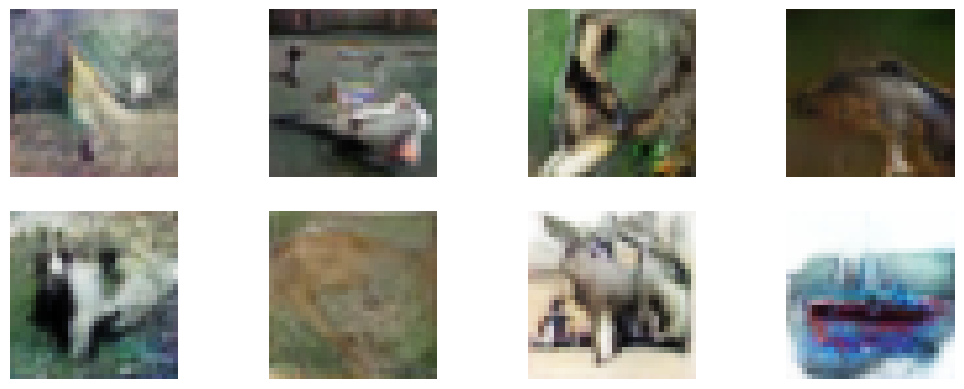

Iteration: 33700 - Generator loss: 0.9461 - Generator Accuracy: 29.69 % - Discrimnator loss: 0.6366 - Discrimnator Accuracy: 64.84 %
Iteration: 33710 - Generator loss: 1.1987 - Generator Accuracy: 6.25 % - Discrimnator loss: 0.5614 - Discrimnator Accuracy: 68.36 %
Iteration: 33720 - Generator loss: 0.9261 - Generator Accuracy: 32.81 % - Discrimnator loss: 0.5496 - Discrimnator Accuracy: 70.70 %
Iteration: 33730 - Generator loss: 0.9595 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.6046 - Discrimnator Accuracy: 64.45 %
Iteration: 33740 - Generator loss: 1.1345 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.5720 - Discrimnator Accuracy: 64.84 %
Iteration: 33750 - Generator loss: 0.9250 - Generator Accuracy: 27.34 % - Discrimnator loss: 0.5760 - Discrimnator Accuracy: 69.14 %
Iteration: 33760 - Generator loss: 0.9871 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.6107 - Discrimnator Accuracy: 66.41 %
Iteration: 33770 - Generator loss: 1.2122 - Generator Accuracy: 12.50 

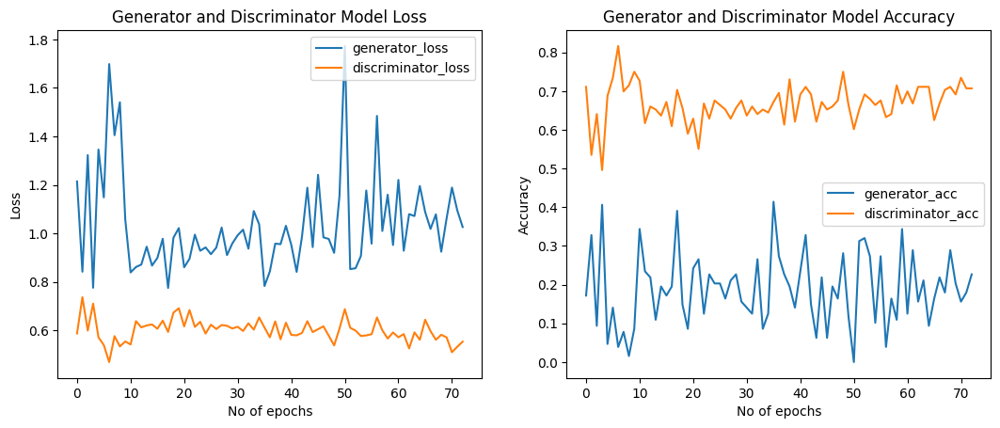

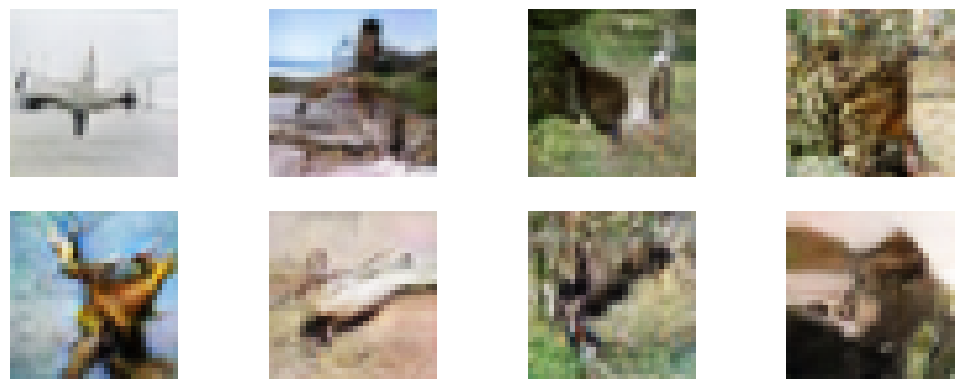

Iteration: 34170 - Generator loss: 1.0554 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5253 - Discrimnator Accuracy: 73.05 %
Iteration: 34180 - Generator loss: 0.9365 - Generator Accuracy: 30.47 % - Discrimnator loss: 0.5744 - Discrimnator Accuracy: 69.14 %
Iteration: 34190 - Generator loss: 1.1248 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5308 - Discrimnator Accuracy: 72.27 %
Iteration: 34200 - Generator loss: 1.1138 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.5583 - Discrimnator Accuracy: 67.58 %
Iteration: 34210 - Generator loss: 1.4204 - Generator Accuracy: 4.69 % - Discrimnator loss: 0.5816 - Discrimnator Accuracy: 69.14 %
Iteration: 34220 - Generator loss: 1.0053 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5564 - Discrimnator Accuracy: 72.66 %
Iteration: 34230 - Generator loss: 1.1988 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5293 - Discrimnator Accuracy: 73.44 %
Iteration: 34240 - Generator loss: 1.0365 - Generator Accuracy: 21.88 

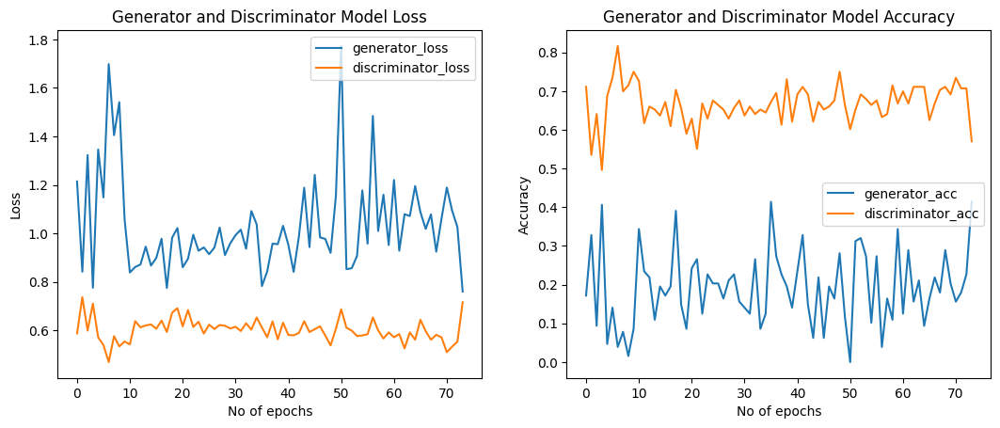

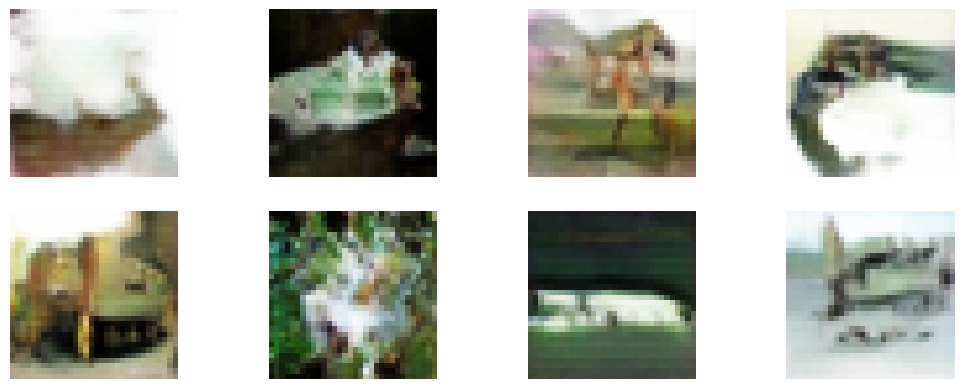

Iteration: 34640 - Generator loss: 0.8608 - Generator Accuracy: 29.69 % - Discrimnator loss: 0.6730 - Discrimnator Accuracy: 60.55 %
Iteration: 34650 - Generator loss: 1.0134 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.6778 - Discrimnator Accuracy: 60.16 %
Iteration: 34660 - Generator loss: 0.8369 - Generator Accuracy: 37.50 % - Discrimnator loss: 0.6536 - Discrimnator Accuracy: 57.42 %
Iteration: 34670 - Generator loss: 0.8896 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.6388 - Discrimnator Accuracy: 60.94 %
Iteration: 34680 - Generator loss: 0.8593 - Generator Accuracy: 32.03 % - Discrimnator loss: 0.6343 - Discrimnator Accuracy: 64.45 %
Iteration: 34690 - Generator loss: 0.8397 - Generator Accuracy: 32.03 % - Discrimnator loss: 0.5976 - Discrimnator Accuracy: 69.53 %
Iteration: 34700 - Generator loss: 0.9233 - Generator Accuracy: 27.34 % - Discrimnator loss: 0.6261 - Discrimnator Accuracy: 64.06 %
Iteration: 34710 - Generator loss: 0.9038 - Generator Accuracy: 25.78

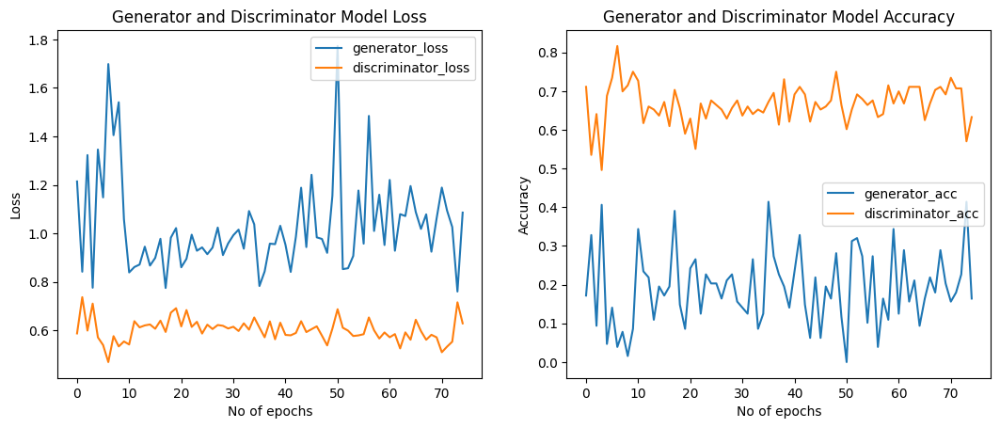

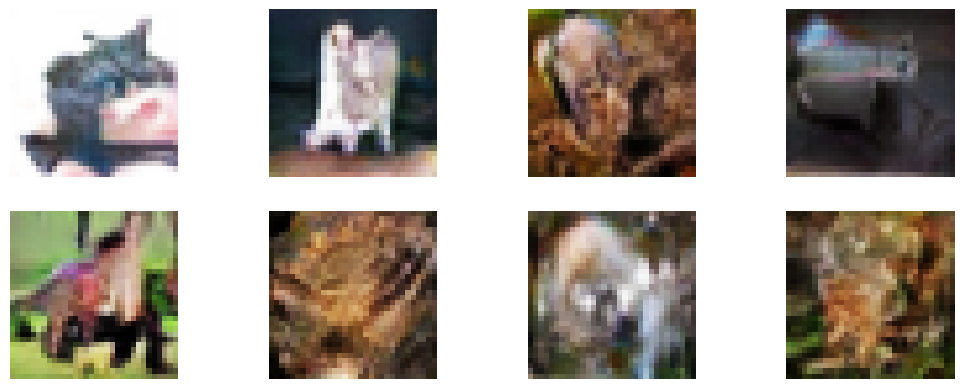

Iteration: 35110 - Generator loss: 1.0836 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5835 - Discrimnator Accuracy: 66.80 %
Iteration: 35120 - Generator loss: 1.0636 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5480 - Discrimnator Accuracy: 72.27 %
Iteration: 35130 - Generator loss: 0.8635 - Generator Accuracy: 35.16 % - Discrimnator loss: 0.5595 - Discrimnator Accuracy: 69.92 %
Iteration: 35140 - Generator loss: 0.8671 - Generator Accuracy: 33.59 % - Discrimnator loss: 0.5853 - Discrimnator Accuracy: 69.53 %
Iteration: 35150 - Generator loss: 1.2107 - Generator Accuracy: 6.25 % - Discrimnator loss: 0.5519 - Discrimnator Accuracy: 69.53 %
Iteration: 35160 - Generator loss: 1.0154 - Generator Accuracy: 11.72 % - Discrimnator loss: 0.5572 - Discrimnator Accuracy: 74.22 %
Iteration: 35170 - Generator loss: 1.0822 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.5921 - Discrimnator Accuracy: 66.02 %
Iteration: 35180 - Generator loss: 1.0917 - Generator Accuracy: 14.84 

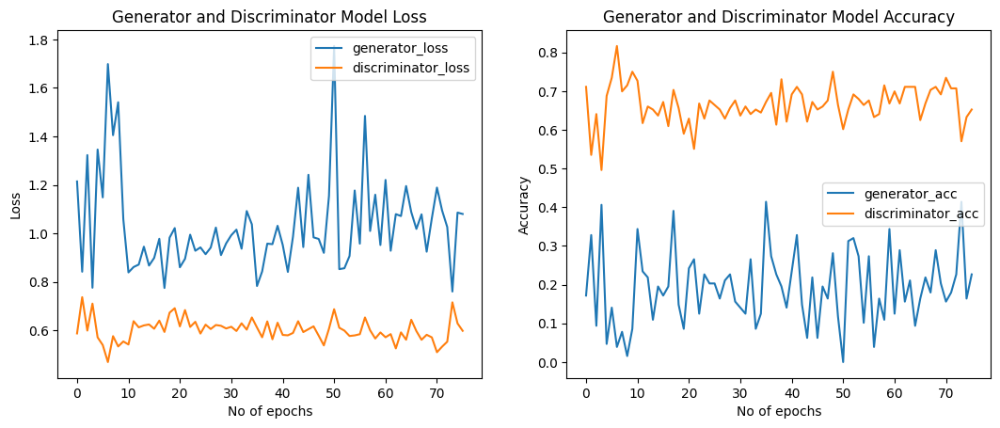

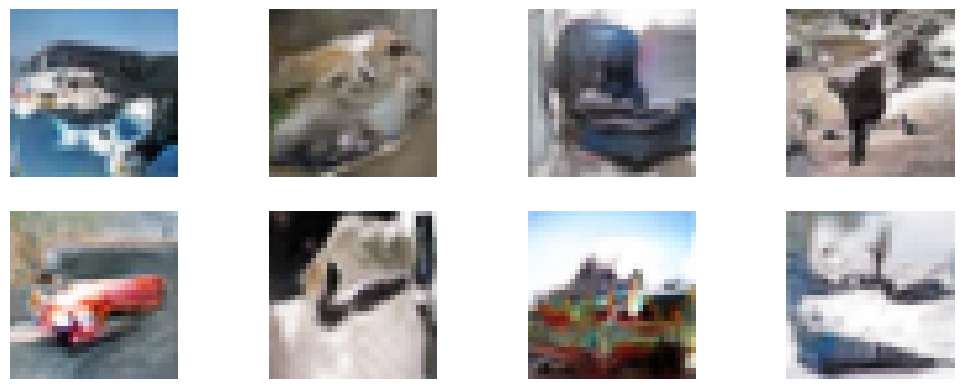

Iteration: 35570 - Generator loss: 0.9071 - Generator Accuracy: 31.25 % - Discrimnator loss: 0.5152 - Discrimnator Accuracy: 71.88 %
Iteration: 35580 - Generator loss: 0.9746 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.5540 - Discrimnator Accuracy: 72.27 %
Iteration: 35590 - Generator loss: 0.9513 - Generator Accuracy: 32.81 % - Discrimnator loss: 0.5496 - Discrimnator Accuracy: 72.27 %
Iteration: 35600 - Generator loss: 0.9521 - Generator Accuracy: 29.69 % - Discrimnator loss: 0.5717 - Discrimnator Accuracy: 67.19 %
Iteration: 35610 - Generator loss: 1.0338 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.5810 - Discrimnator Accuracy: 68.75 %
Iteration: 35620 - Generator loss: 1.0680 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5499 - Discrimnator Accuracy: 70.70 %
Iteration: 35630 - Generator loss: 1.0944 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5205 - Discrimnator Accuracy: 75.00 %
Iteration: 35640 - Generator loss: 1.0194 - Generator Accuracy: 21.09

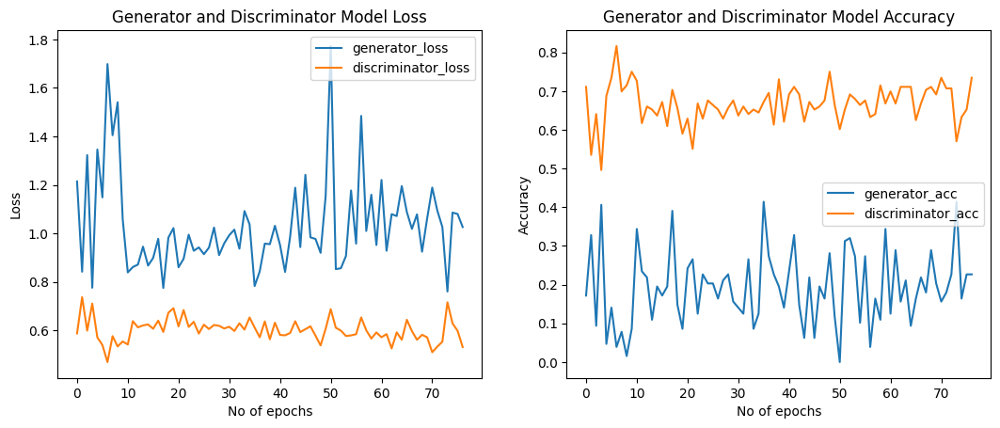

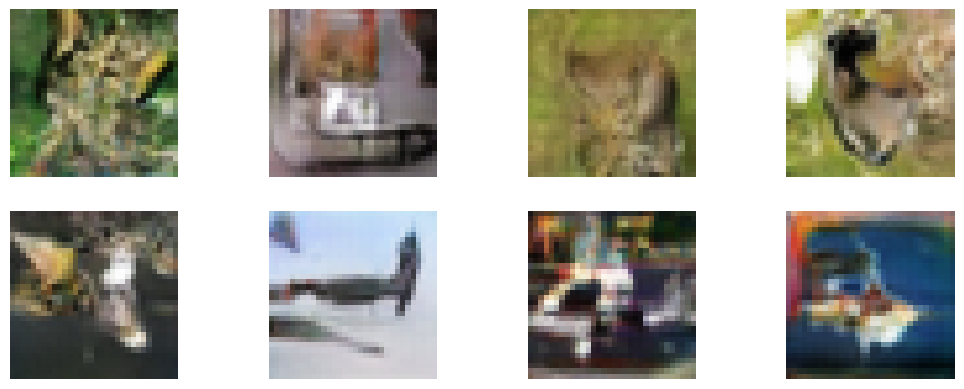

Iteration: 36040 - Generator loss: 1.0717 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.5331 - Discrimnator Accuracy: 71.48 %
Iteration: 36050 - Generator loss: 0.9820 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5707 - Discrimnator Accuracy: 68.75 %
Iteration: 36060 - Generator loss: 1.1199 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.5917 - Discrimnator Accuracy: 65.23 %
Iteration: 36070 - Generator loss: 1.0477 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5862 - Discrimnator Accuracy: 67.19 %
Iteration: 36080 - Generator loss: 0.8598 - Generator Accuracy: 32.03 % - Discrimnator loss: 0.5684 - Discrimnator Accuracy: 70.70 %
Iteration: 36090 - Generator loss: 1.0822 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.4945 - Discrimnator Accuracy: 78.12 %
Iteration: 36100 - Generator loss: 1.2726 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.5863 - Discrimnator Accuracy: 67.97 %
Iteration: 36110 - Generator loss: 0.9978 - Generator Accuracy: 21.88

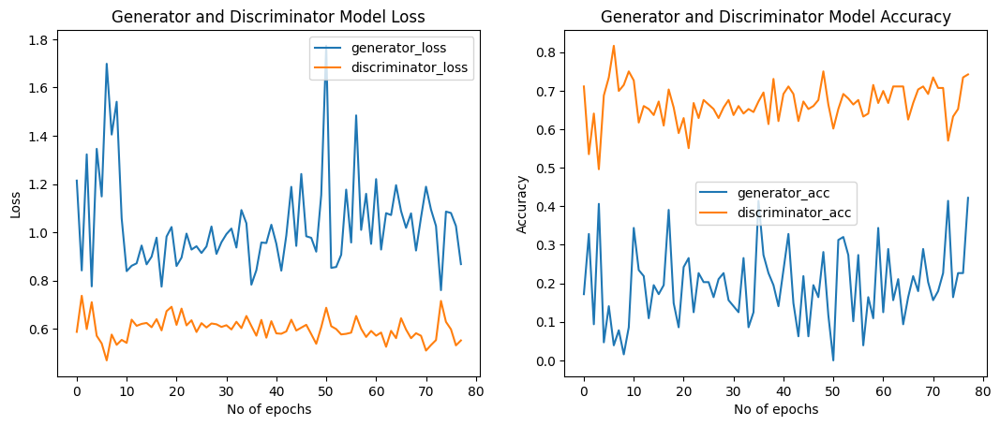

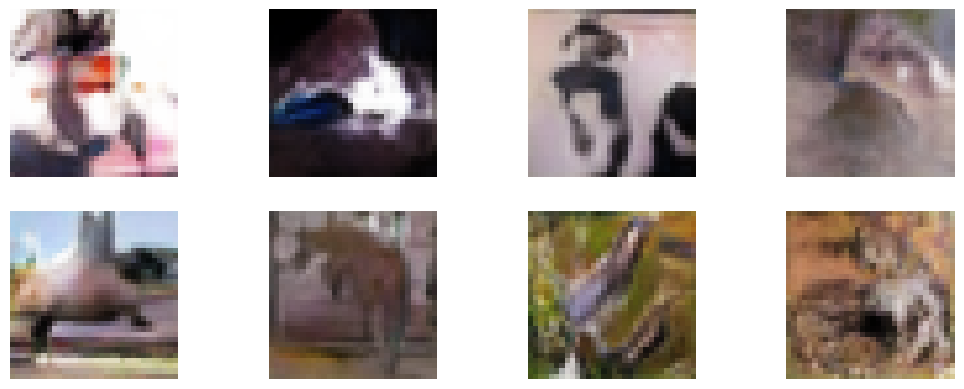

Iteration: 36510 - Generator loss: 1.2738 - Generator Accuracy: 7.81 % - Discrimnator loss: 0.5540 - Discrimnator Accuracy: 71.48 %
Iteration: 36520 - Generator loss: 1.0083 - Generator Accuracy: 28.12 % - Discrimnator loss: 0.5743 - Discrimnator Accuracy: 67.19 %
Iteration: 36530 - Generator loss: 1.1189 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5774 - Discrimnator Accuracy: 68.75 %
Iteration: 36540 - Generator loss: 1.1668 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.5585 - Discrimnator Accuracy: 69.92 %
Iteration: 36550 - Generator loss: 1.0514 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.5742 - Discrimnator Accuracy: 68.36 %
Iteration: 36560 - Generator loss: 1.0431 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.5353 - Discrimnator Accuracy: 73.83 %
Iteration: 36570 - Generator loss: 1.1481 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5078 - Discrimnator Accuracy: 75.00 %
Iteration: 36580 - Generator loss: 1.0799 - Generator Accuracy: 13.28 

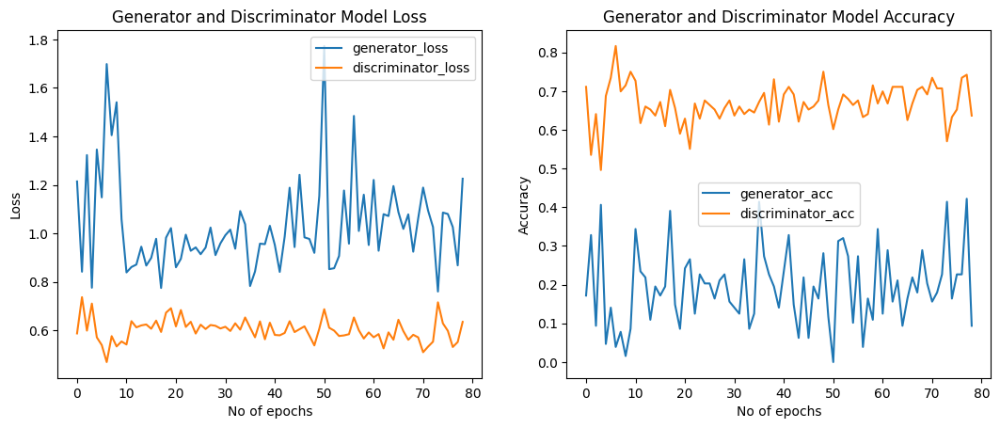

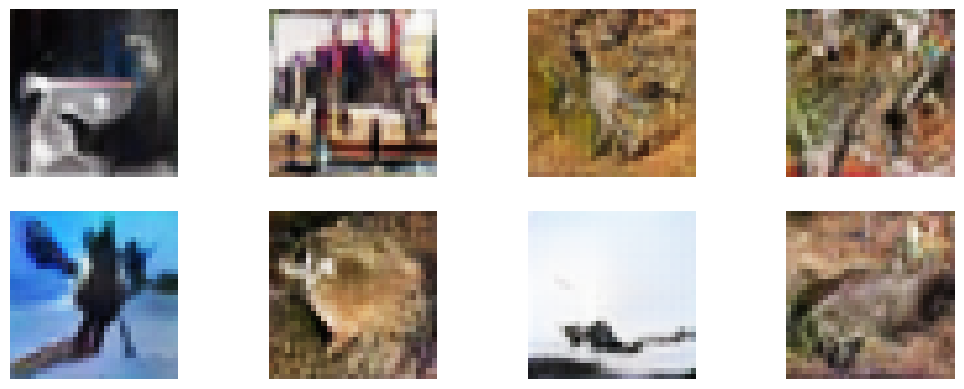

Iteration: 36980 - Generator loss: 0.8952 - Generator Accuracy: 32.03 % - Discrimnator loss: 0.5654 - Discrimnator Accuracy: 68.75 %
Iteration: 36990 - Generator loss: 0.9719 - Generator Accuracy: 27.34 % - Discrimnator loss: 0.5741 - Discrimnator Accuracy: 69.53 %
Iteration: 37000 - Generator loss: 1.0698 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5421 - Discrimnator Accuracy: 71.88 %
Iteration: 37010 - Generator loss: 0.9522 - Generator Accuracy: 30.47 % - Discrimnator loss: 0.5850 - Discrimnator Accuracy: 65.23 %
Iteration: 37020 - Generator loss: 1.1346 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.5479 - Discrimnator Accuracy: 69.92 %
Iteration: 37030 - Generator loss: 0.9915 - Generator Accuracy: 31.25 % - Discrimnator loss: 0.6038 - Discrimnator Accuracy: 67.97 %
Iteration: 37040 - Generator loss: 0.8467 - Generator Accuracy: 44.53 % - Discrimnator loss: 0.5814 - Discrimnator Accuracy: 71.48 %
Iteration: 37050 - Generator loss: 1.0837 - Generator Accuracy: 22.66

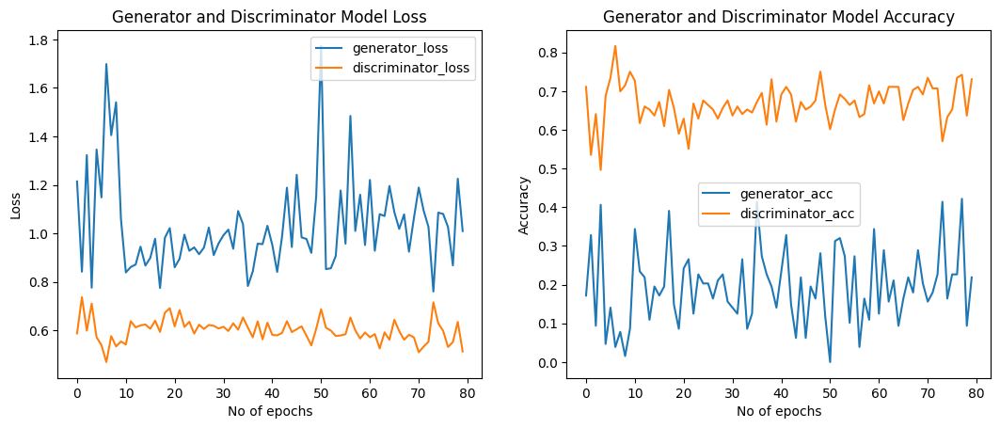

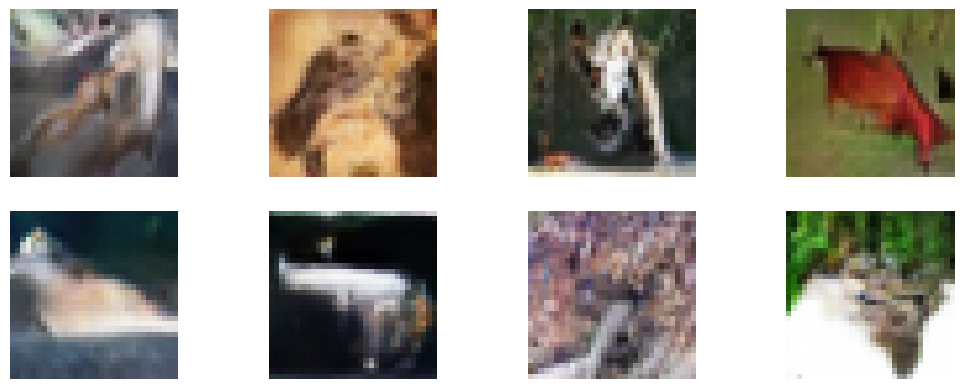

Iteration: 37450 - Generator loss: 0.6779 - Generator Accuracy: 54.69 % - Discrimnator loss: 1.1547 - Discrimnator Accuracy: 51.95 %
Iteration: 37460 - Generator loss: 0.8115 - Generator Accuracy: 39.84 % - Discrimnator loss: 0.6365 - Discrimnator Accuracy: 61.33 %
Iteration: 37470 - Generator loss: 1.0818 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.5826 - Discrimnator Accuracy: 67.97 %
Iteration: 37480 - Generator loss: 0.9695 - Generator Accuracy: 23.44 % - Discrimnator loss: 0.5835 - Discrimnator Accuracy: 68.36 %
Iteration: 37490 - Generator loss: 0.9970 - Generator Accuracy: 27.34 % - Discrimnator loss: 0.5640 - Discrimnator Accuracy: 68.75 %
Iteration: 37500 - Generator loss: 0.8581 - Generator Accuracy: 29.69 % - Discrimnator loss: 0.5833 - Discrimnator Accuracy: 70.70 %
Iteration: 37510 - Generator loss: 1.0960 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.5916 - Discrimnator Accuracy: 66.80 %
Iteration: 37520 - Generator loss: 1.1272 - Generator Accuracy: 14.06

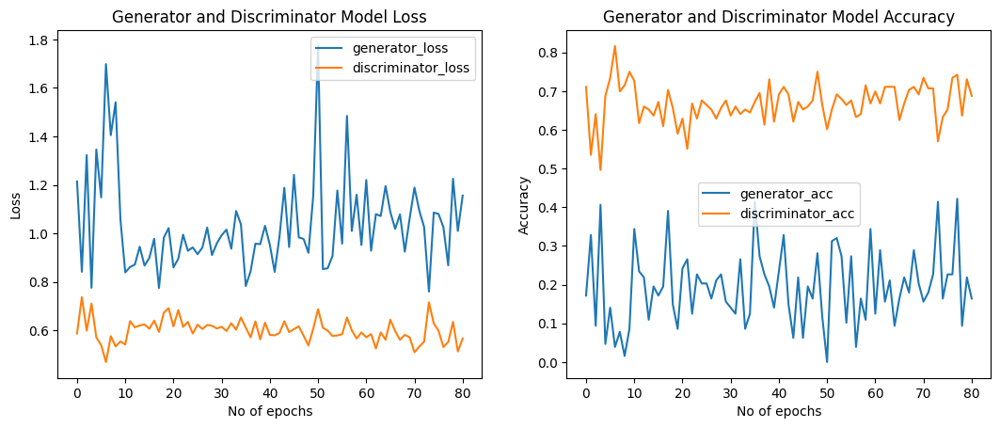

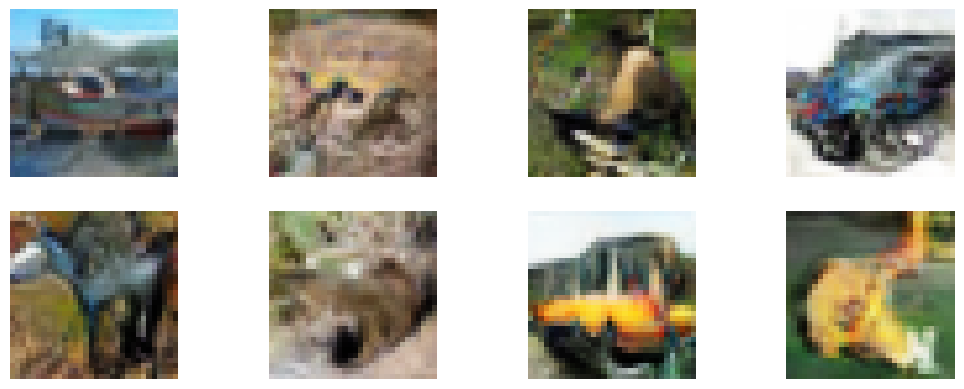

Iteration: 37910 - Generator loss: 0.8606 - Generator Accuracy: 30.47 % - Discrimnator loss: 0.5321 - Discrimnator Accuracy: 74.61 %
Iteration: 37920 - Generator loss: 1.1419 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.5436 - Discrimnator Accuracy: 73.05 %
Iteration: 37930 - Generator loss: 1.0597 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5251 - Discrimnator Accuracy: 74.61 %
Iteration: 37940 - Generator loss: 0.9889 - Generator Accuracy: 23.44 % - Discrimnator loss: 0.5594 - Discrimnator Accuracy: 71.09 %
Iteration: 37950 - Generator loss: 1.1403 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5383 - Discrimnator Accuracy: 72.66 %
Iteration: 37960 - Generator loss: 1.1285 - Generator Accuracy: 19.53 % - Discrimnator loss: 0.5648 - Discrimnator Accuracy: 68.75 %
Iteration: 37970 - Generator loss: 1.3587 - Generator Accuracy: 5.47 % - Discrimnator loss: 0.6356 - Discrimnator Accuracy: 60.94 %
Iteration: 37980 - Generator loss: 1.1198 - Generator Accuracy: 17.19 

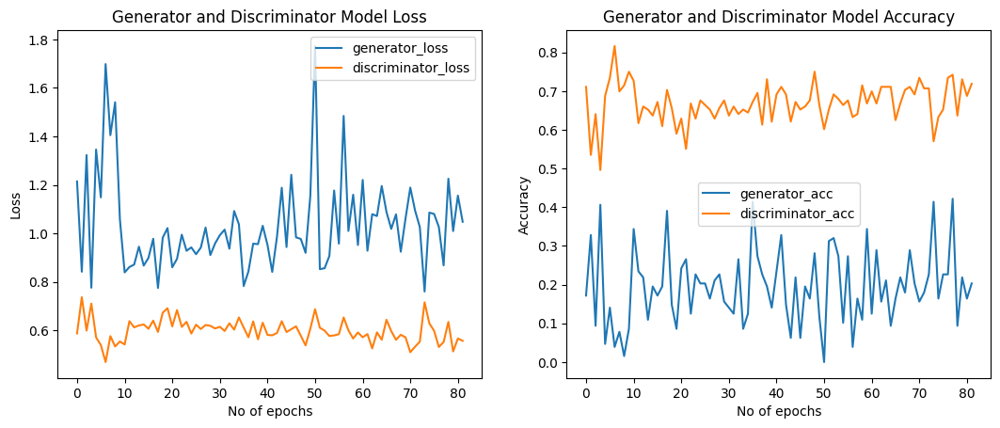

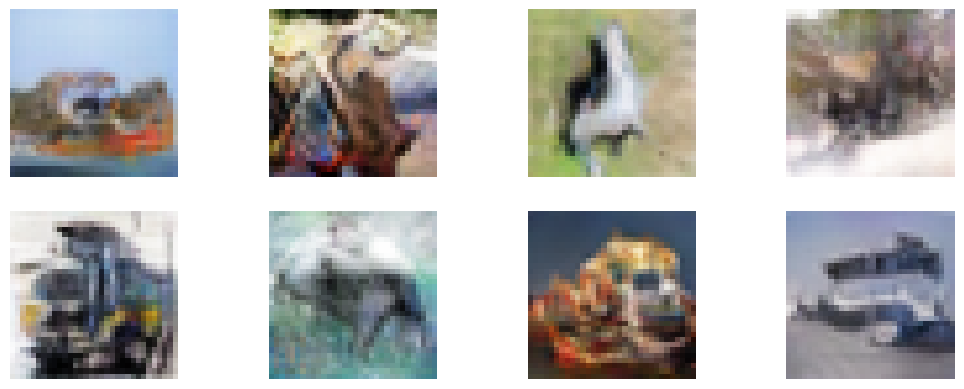

Iteration: 38380 - Generator loss: 0.9232 - Generator Accuracy: 30.47 % - Discrimnator loss: 0.5639 - Discrimnator Accuracy: 72.27 %
Iteration: 38390 - Generator loss: 0.8982 - Generator Accuracy: 34.38 % - Discrimnator loss: 0.5812 - Discrimnator Accuracy: 71.48 %
Iteration: 38400 - Generator loss: 1.0664 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5392 - Discrimnator Accuracy: 73.44 %
Iteration: 38410 - Generator loss: 0.9905 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5735 - Discrimnator Accuracy: 70.31 %
Iteration: 38420 - Generator loss: 1.1122 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5349 - Discrimnator Accuracy: 72.27 %
Iteration: 38430 - Generator loss: 0.9337 - Generator Accuracy: 35.16 % - Discrimnator loss: 0.6812 - Discrimnator Accuracy: 63.67 %
Iteration: 38440 - Generator loss: 1.1571 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.5612 - Discrimnator Accuracy: 69.14 %
Iteration: 38450 - Generator loss: 0.9793 - Generator Accuracy: 25.78

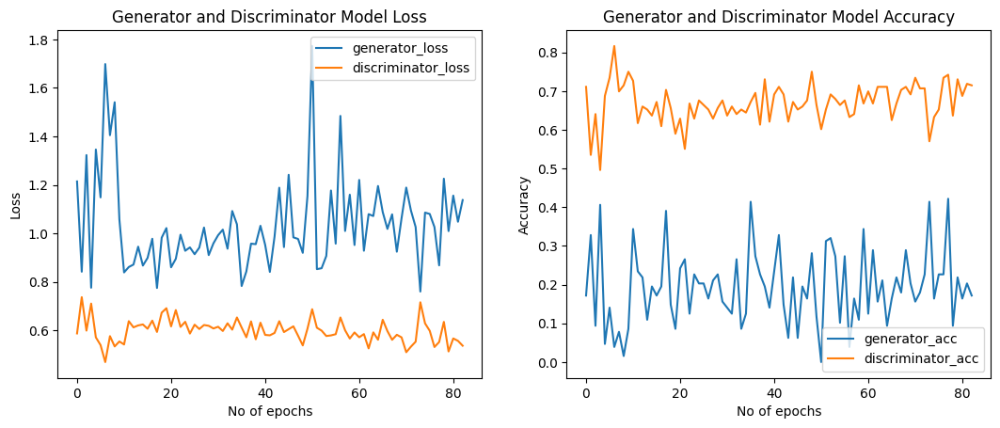

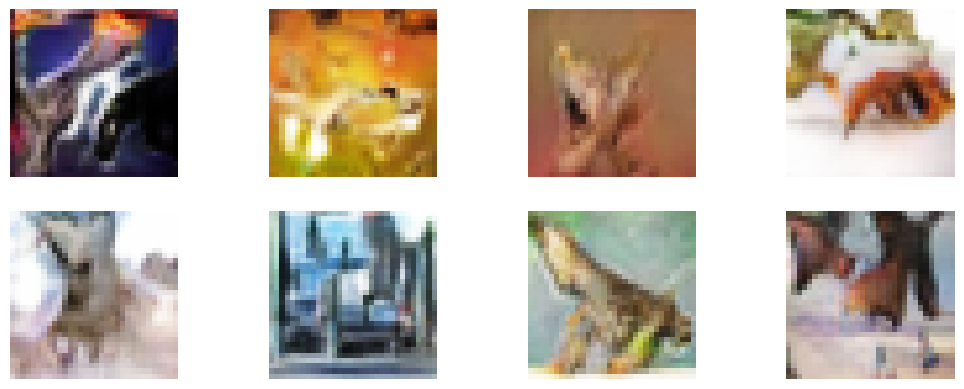

Iteration: 38850 - Generator loss: 0.7574 - Generator Accuracy: 42.19 % - Discrimnator loss: 0.6500 - Discrimnator Accuracy: 64.06 %
Iteration: 38860 - Generator loss: 1.2404 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.5900 - Discrimnator Accuracy: 71.48 %
Iteration: 38870 - Generator loss: 1.1148 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5120 - Discrimnator Accuracy: 77.73 %
Iteration: 38880 - Generator loss: 1.2717 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.5684 - Discrimnator Accuracy: 69.92 %
Iteration: 38890 - Generator loss: 1.0123 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.5338 - Discrimnator Accuracy: 72.66 %
Iteration: 38900 - Generator loss: 1.3788 - Generator Accuracy: 7.81 % - Discrimnator loss: 0.7048 - Discrimnator Accuracy: 57.42 %
Iteration: 38910 - Generator loss: 0.9526 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.5481 - Discrimnator Accuracy: 70.31 %
Iteration: 38920 - Generator loss: 1.2958 - Generator Accuracy: 11.72 

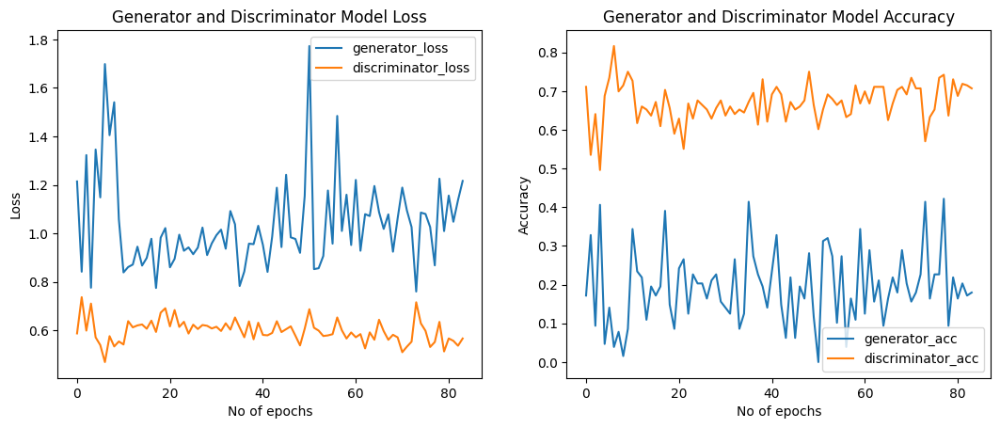

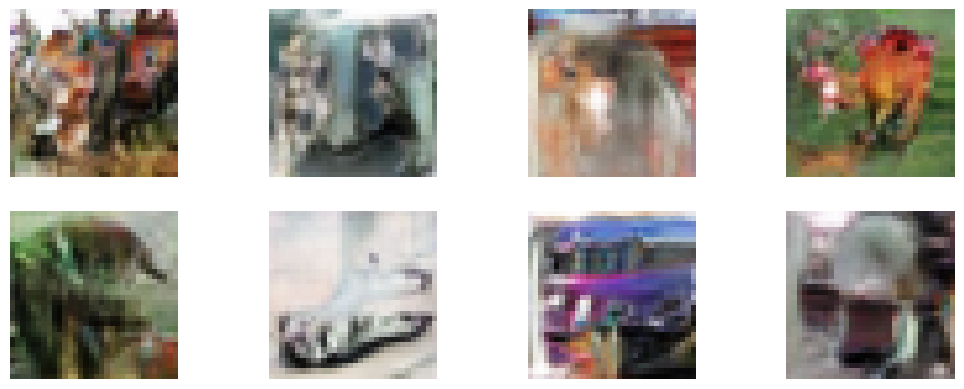

Iteration: 39320 - Generator loss: 1.0751 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.5783 - Discrimnator Accuracy: 68.36 %
Iteration: 39330 - Generator loss: 0.9700 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5529 - Discrimnator Accuracy: 70.31 %
Iteration: 39340 - Generator loss: 1.0276 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.5577 - Discrimnator Accuracy: 69.53 %
Iteration: 39350 - Generator loss: 1.4281 - Generator Accuracy: 7.03 % - Discrimnator loss: 0.5595 - Discrimnator Accuracy: 71.48 %
Iteration: 39360 - Generator loss: 0.8938 - Generator Accuracy: 31.25 % - Discrimnator loss: 0.5765 - Discrimnator Accuracy: 67.97 %
Iteration: 39370 - Generator loss: 1.1187 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.5633 - Discrimnator Accuracy: 64.84 %
Iteration: 39380 - Generator loss: 1.0053 - Generator Accuracy: 29.69 % - Discrimnator loss: 0.5924 - Discrimnator Accuracy: 69.53 %
Iteration: 39390 - Generator loss: 1.1117 - Generator Accuracy: 14.06 

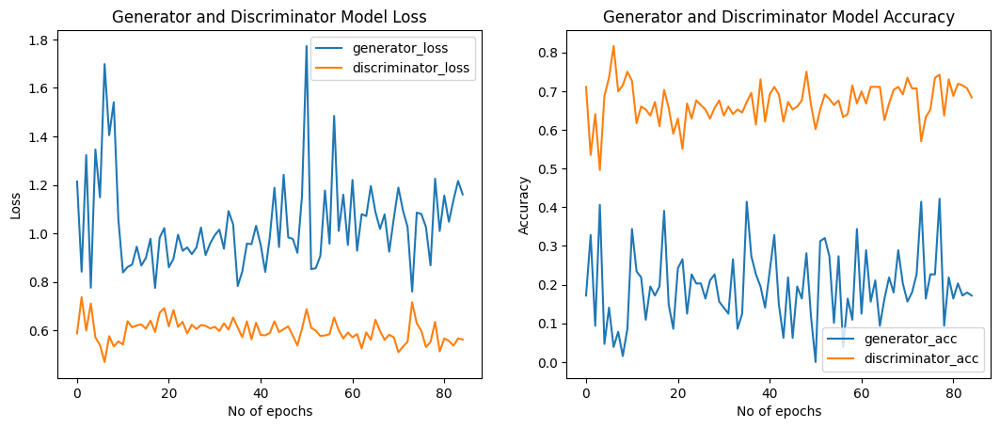

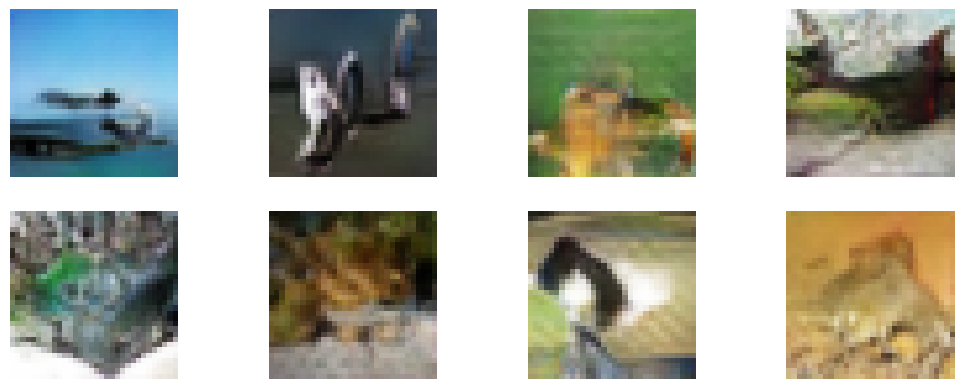

Iteration: 39790 - Generator loss: 1.1833 - Generator Accuracy: 19.53 % - Discrimnator loss: 0.5347 - Discrimnator Accuracy: 73.44 %
Iteration: 39800 - Generator loss: 1.0400 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.5455 - Discrimnator Accuracy: 69.92 %
Iteration: 39810 - Generator loss: 0.9377 - Generator Accuracy: 32.81 % - Discrimnator loss: 0.5276 - Discrimnator Accuracy: 74.61 %
Iteration: 39820 - Generator loss: 1.0316 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.5477 - Discrimnator Accuracy: 69.53 %
Iteration: 39830 - Generator loss: 1.2834 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.5473 - Discrimnator Accuracy: 74.22 %
Iteration: 39840 - Generator loss: 0.9199 - Generator Accuracy: 31.25 % - Discrimnator loss: 0.5442 - Discrimnator Accuracy: 73.83 %
Iteration: 39850 - Generator loss: 0.7855 - Generator Accuracy: 51.56 % - Discrimnator loss: 0.6277 - Discrimnator Accuracy: 65.62 %
Iteration: 39860 - Generator loss: 0.9543 - Generator Accuracy: 41.41

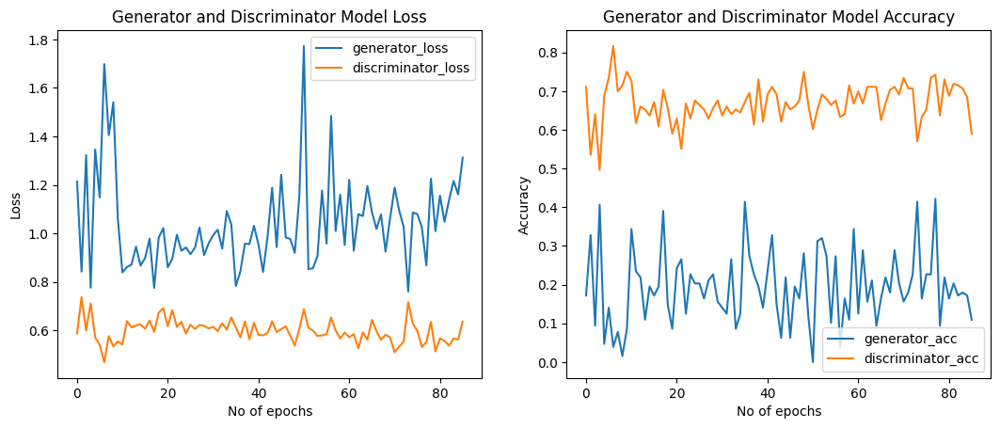

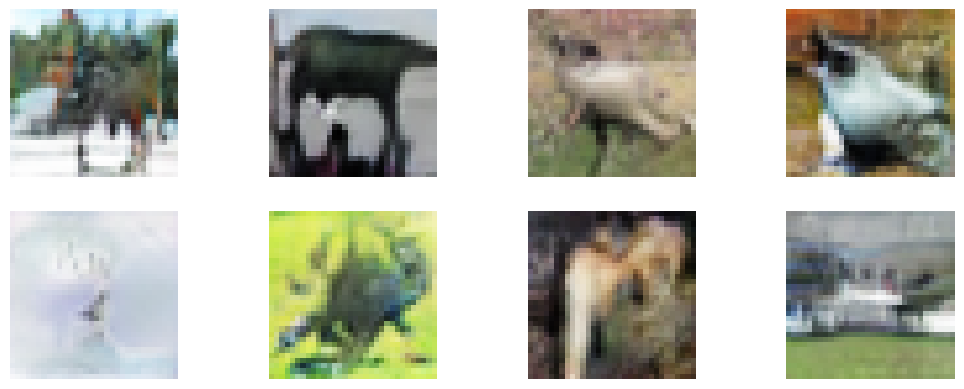

Iteration: 40250 - Generator loss: 0.9390 - Generator Accuracy: 30.47 % - Discrimnator loss: 0.5817 - Discrimnator Accuracy: 67.97 %
Iteration: 40260 - Generator loss: 1.0532 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.5466 - Discrimnator Accuracy: 68.75 %
Iteration: 40270 - Generator loss: 1.0721 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.5550 - Discrimnator Accuracy: 71.48 %
Iteration: 40280 - Generator loss: 1.0389 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.5188 - Discrimnator Accuracy: 75.39 %
Iteration: 40290 - Generator loss: 1.0551 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5413 - Discrimnator Accuracy: 72.66 %
Iteration: 40300 - Generator loss: 1.0795 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.5622 - Discrimnator Accuracy: 70.70 %
Iteration: 40310 - Generator loss: 1.3493 - Generator Accuracy: 1.56 % - Discrimnator loss: 0.6080 - Discrimnator Accuracy: 65.23 %
Iteration: 40320 - Generator loss: 1.2221 - Generator Accuracy: 10.16 

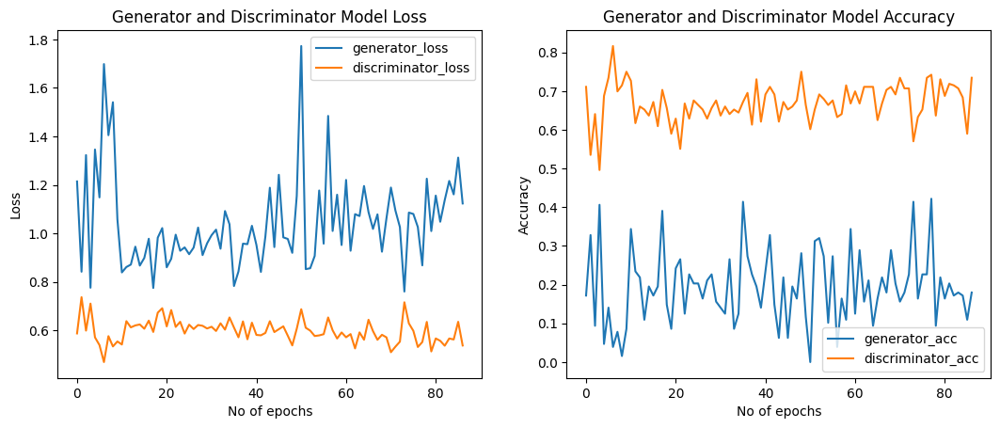

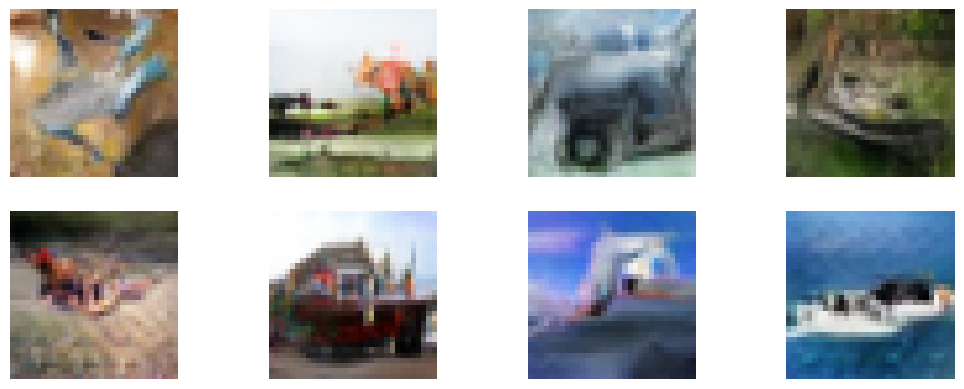

Iteration: 40720 - Generator loss: 1.4332 - Generator Accuracy: 3.91 % - Discrimnator loss: 0.5731 - Discrimnator Accuracy: 68.36 %
Iteration: 40730 - Generator loss: 1.0587 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.5767 - Discrimnator Accuracy: 69.92 %
Iteration: 40740 - Generator loss: 0.8958 - Generator Accuracy: 32.03 % - Discrimnator loss: 0.5149 - Discrimnator Accuracy: 76.56 %
Iteration: 40750 - Generator loss: 1.1873 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.5316 - Discrimnator Accuracy: 72.27 %
Iteration: 40760 - Generator loss: 1.3454 - Generator Accuracy: 5.47 % - Discrimnator loss: 0.5728 - Discrimnator Accuracy: 65.62 %
Iteration: 40770 - Generator loss: 1.1105 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.5222 - Discrimnator Accuracy: 73.83 %
Iteration: 40780 - Generator loss: 1.0848 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5504 - Discrimnator Accuracy: 71.48 %
Iteration: 40790 - Generator loss: 1.3447 - Generator Accuracy: 6.25 % 

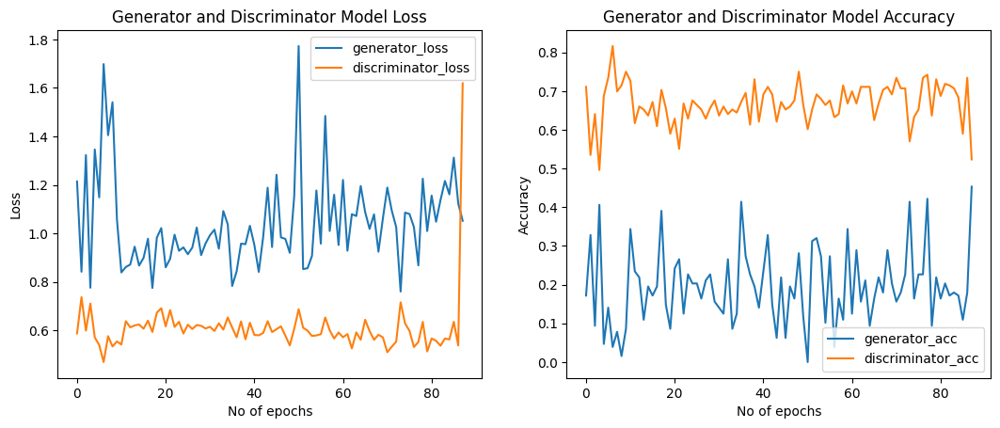

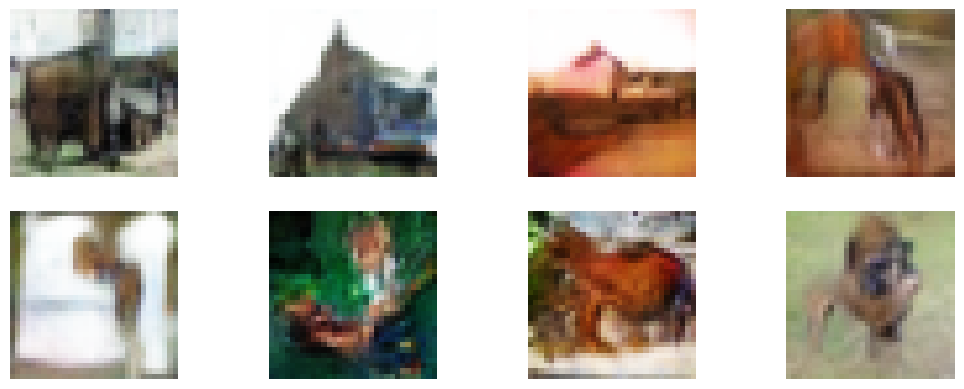

Iteration: 41190 - Generator loss: 1.5918 - Generator Accuracy: 23.44 % - Discrimnator loss: 0.7298 - Discrimnator Accuracy: 62.89 %
Iteration: 41200 - Generator loss: 1.1660 - Generator Accuracy: 26.56 % - Discrimnator loss: 0.7399 - Discrimnator Accuracy: 54.30 %
Iteration: 41210 - Generator loss: 0.9051 - Generator Accuracy: 31.25 % - Discrimnator loss: 0.7250 - Discrimnator Accuracy: 55.08 %
Iteration: 41220 - Generator loss: 0.8843 - Generator Accuracy: 34.38 % - Discrimnator loss: 0.6209 - Discrimnator Accuracy: 66.80 %
Iteration: 41230 - Generator loss: 1.1682 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.6641 - Discrimnator Accuracy: 57.81 %
Iteration: 41240 - Generator loss: 0.8642 - Generator Accuracy: 32.03 % - Discrimnator loss: 0.6730 - Discrimnator Accuracy: 61.33 %
Iteration: 41250 - Generator loss: 0.9224 - Generator Accuracy: 26.56 % - Discrimnator loss: 0.6022 - Discrimnator Accuracy: 67.97 %
Iteration: 41260 - Generator loss: 0.9208 - Generator Accuracy: 28.12

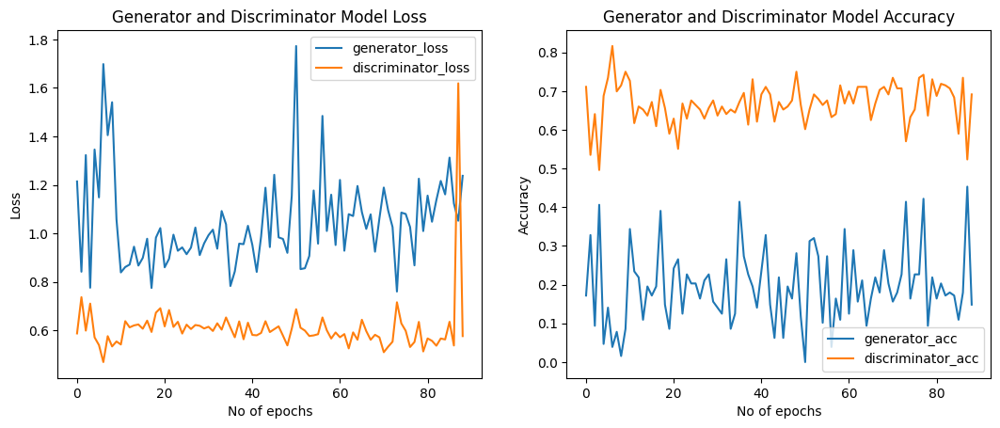

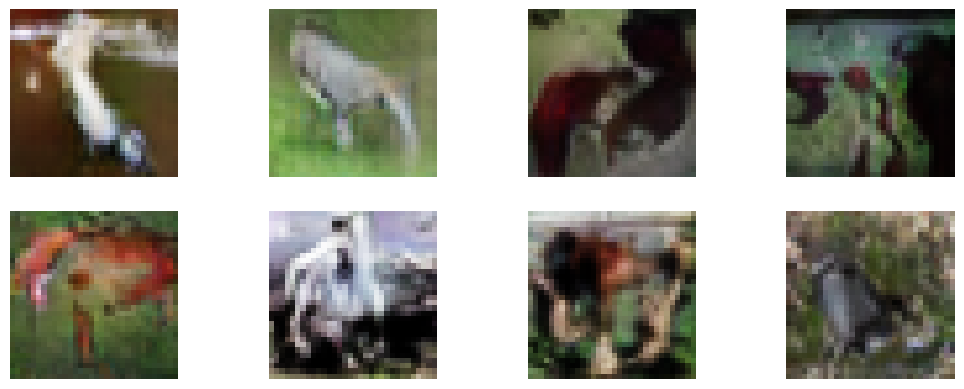

Iteration: 41660 - Generator loss: 1.0454 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.5175 - Discrimnator Accuracy: 70.31 %
Iteration: 41670 - Generator loss: 1.2962 - Generator Accuracy: 6.25 % - Discrimnator loss: 0.6157 - Discrimnator Accuracy: 65.62 %
Iteration: 41680 - Generator loss: 0.9634 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.5726 - Discrimnator Accuracy: 68.75 %
Iteration: 41690 - Generator loss: 1.2471 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.5255 - Discrimnator Accuracy: 71.09 %
Iteration: 41700 - Generator loss: 1.1569 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.5336 - Discrimnator Accuracy: 73.44 %
Iteration: 41710 - Generator loss: 1.3457 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.5233 - Discrimnator Accuracy: 73.05 %
Iteration: 41720 - Generator loss: 1.1953 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5758 - Discrimnator Accuracy: 66.80 %
Iteration: 41730 - Generator loss: 1.0651 - Generator Accuracy: 21.09 

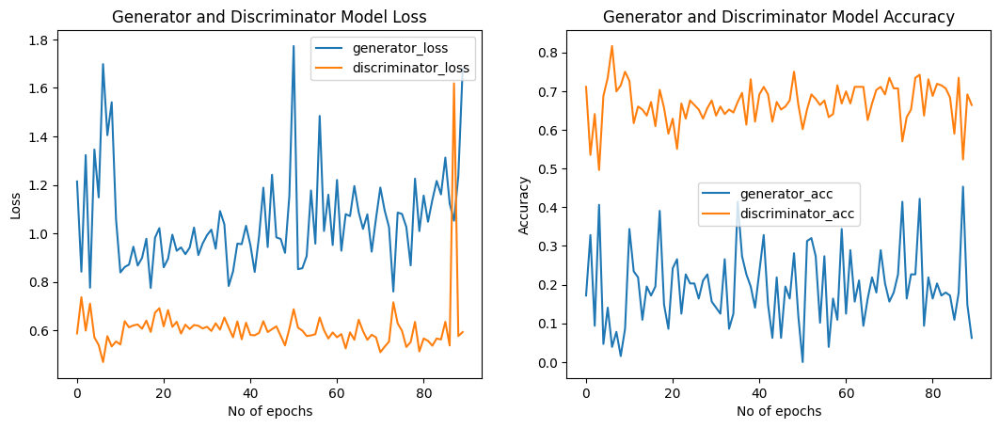

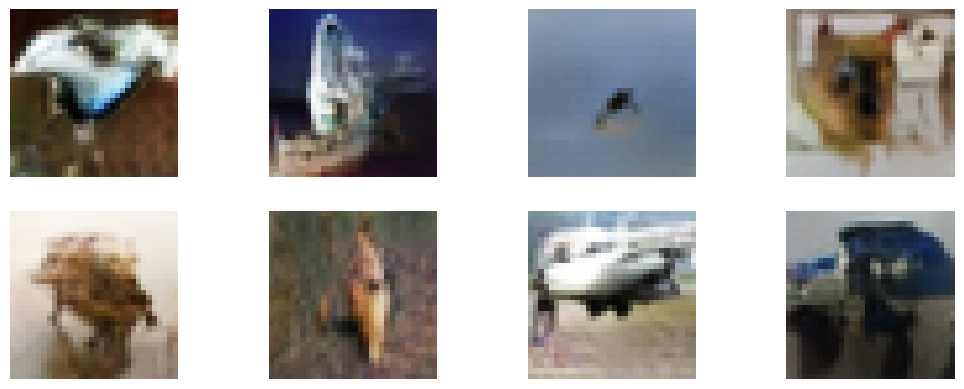

Iteration: 42130 - Generator loss: 1.1387 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5594 - Discrimnator Accuracy: 72.66 %
Iteration: 42140 - Generator loss: 1.2169 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.4897 - Discrimnator Accuracy: 75.78 %
Iteration: 42150 - Generator loss: 0.8811 - Generator Accuracy: 33.59 % - Discrimnator loss: 0.5589 - Discrimnator Accuracy: 72.66 %
Iteration: 42160 - Generator loss: 1.1680 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.5042 - Discrimnator Accuracy: 74.61 %
Iteration: 42170 - Generator loss: 1.4166 - Generator Accuracy: 7.81 % - Discrimnator loss: 0.5471 - Discrimnator Accuracy: 73.83 %
Iteration: 42180 - Generator loss: 0.9593 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.6014 - Discrimnator Accuracy: 64.84 %
Iteration: 42190 - Generator loss: 0.9465 - Generator Accuracy: 33.59 % - Discrimnator loss: 0.5214 - Discrimnator Accuracy: 75.00 %
Iteration: 42200 - Generator loss: 1.0275 - Generator Accuracy: 24.22 

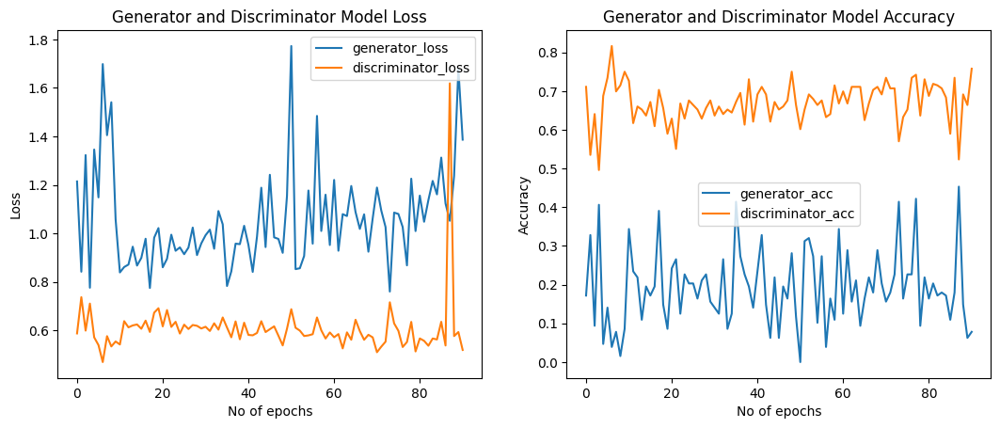

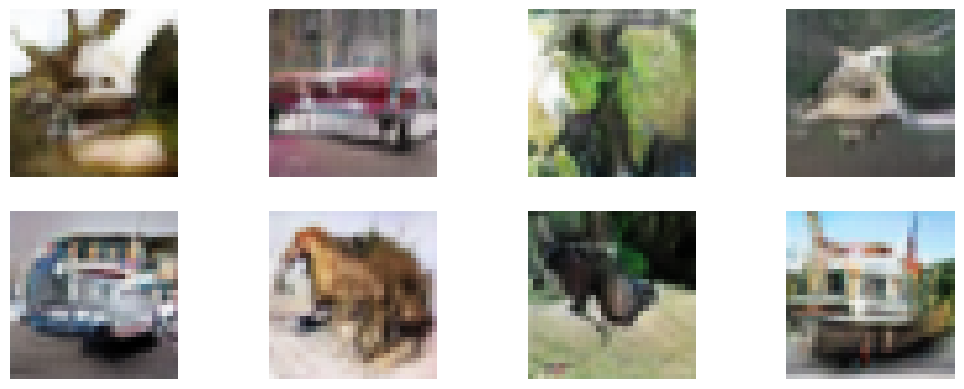

Iteration: 42590 - Generator loss: 1.2772 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.6208 - Discrimnator Accuracy: 66.02 %
Iteration: 42600 - Generator loss: 1.0041 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.5861 - Discrimnator Accuracy: 69.53 %
Iteration: 42610 - Generator loss: 1.1585 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5251 - Discrimnator Accuracy: 73.05 %
Iteration: 42620 - Generator loss: 0.9635 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.5690 - Discrimnator Accuracy: 65.62 %
Iteration: 42630 - Generator loss: 1.1650 - Generator Accuracy: 14.84 % - Discrimnator loss: 0.5257 - Discrimnator Accuracy: 76.56 %
Iteration: 42640 - Generator loss: 0.9993 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5269 - Discrimnator Accuracy: 75.39 %
Iteration: 42650 - Generator loss: 0.9819 - Generator Accuracy: 28.91 % - Discrimnator loss: 0.5913 - Discrimnator Accuracy: 66.80 %
Iteration: 42660 - Generator loss: 1.4690 - Generator Accuracy: 6.25 

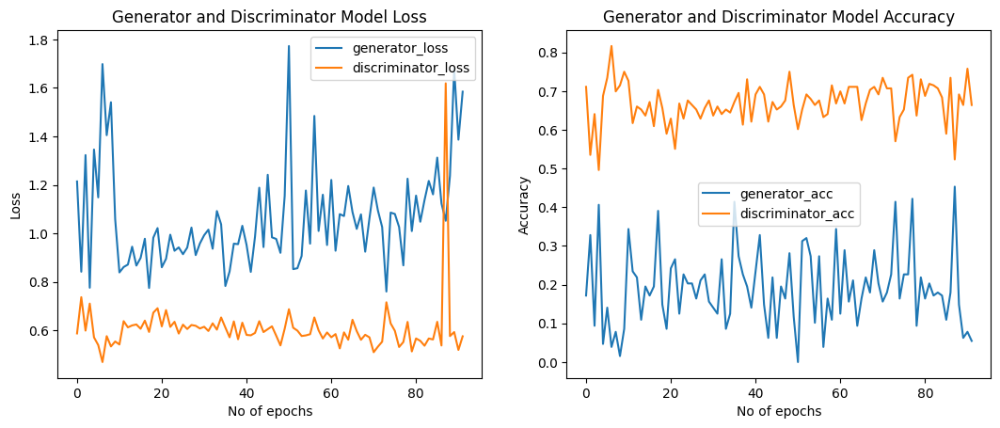

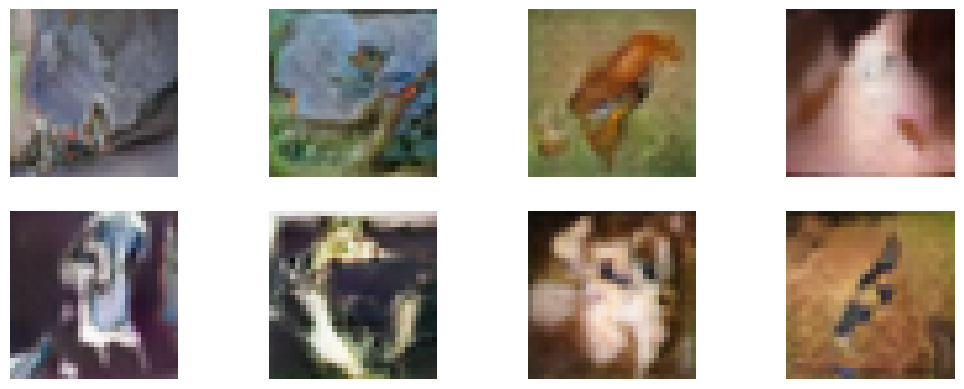

Iteration: 43060 - Generator loss: 0.9787 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.5348 - Discrimnator Accuracy: 74.61 %
Iteration: 43070 - Generator loss: 1.2819 - Generator Accuracy: 8.59 % - Discrimnator loss: 0.5241 - Discrimnator Accuracy: 74.22 %
Iteration: 43080 - Generator loss: 0.8789 - Generator Accuracy: 36.72 % - Discrimnator loss: 0.5679 - Discrimnator Accuracy: 69.92 %
Iteration: 43090 - Generator loss: 1.2504 - Generator Accuracy: 7.03 % - Discrimnator loss: 0.5116 - Discrimnator Accuracy: 73.44 %
Iteration: 43100 - Generator loss: 1.0710 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.5520 - Discrimnator Accuracy: 68.75 %
Iteration: 43110 - Generator loss: 1.3034 - Generator Accuracy: 11.72 % - Discrimnator loss: 0.5559 - Discrimnator Accuracy: 69.14 %
Iteration: 43120 - Generator loss: 1.0566 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.5267 - Discrimnator Accuracy: 72.66 %
Iteration: 43130 - Generator loss: 1.3805 - Generator Accuracy: 7.81 % 

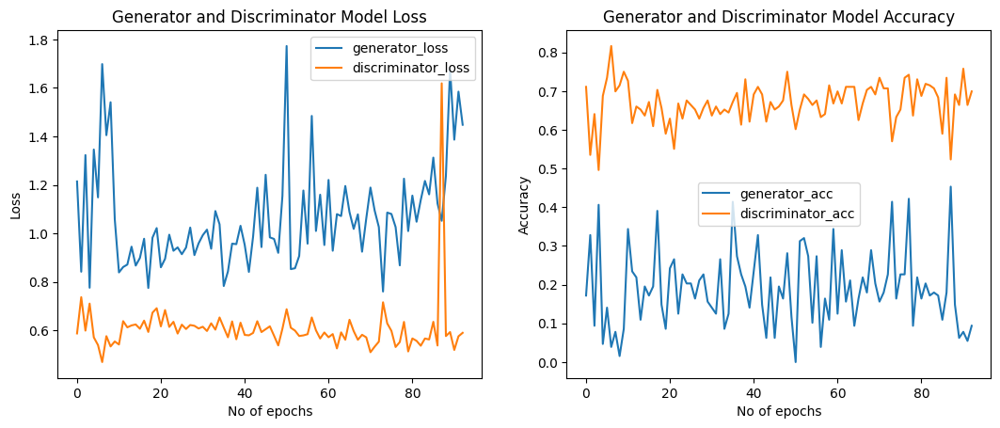

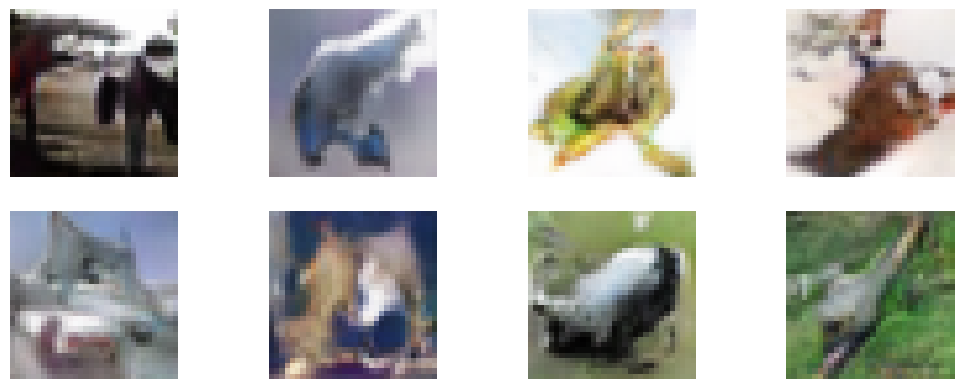

Iteration: 43530 - Generator loss: 1.2332 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5107 - Discrimnator Accuracy: 75.00 %
Iteration: 43540 - Generator loss: 0.9038 - Generator Accuracy: 35.16 % - Discrimnator loss: 0.5400 - Discrimnator Accuracy: 71.48 %
Iteration: 43550 - Generator loss: 1.1501 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5675 - Discrimnator Accuracy: 67.58 %
Iteration: 43560 - Generator loss: 1.0310 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.5959 - Discrimnator Accuracy: 68.75 %
Iteration: 43570 - Generator loss: 1.1887 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.5287 - Discrimnator Accuracy: 73.44 %
Iteration: 43580 - Generator loss: 1.2934 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.5335 - Discrimnator Accuracy: 73.05 %
Iteration: 43590 - Generator loss: 1.1688 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.4569 - Discrimnator Accuracy: 78.12 %
Iteration: 43600 - Generator loss: 0.9697 - Generator Accuracy: 24.22

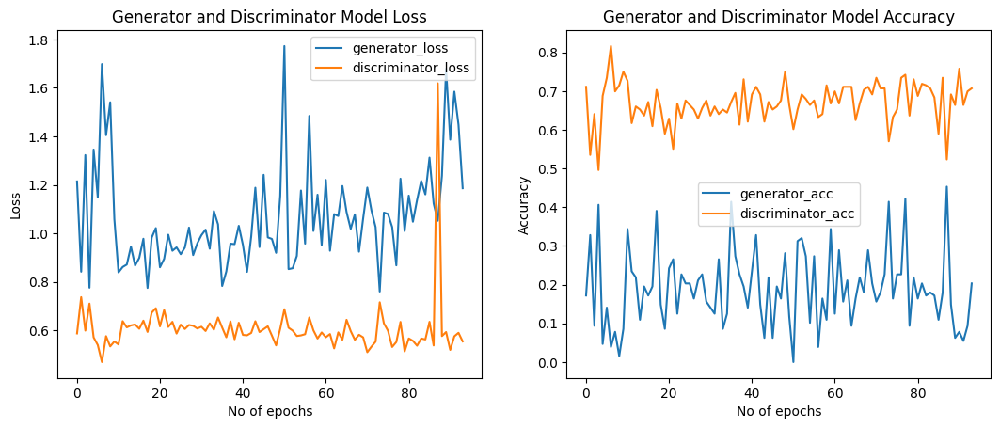

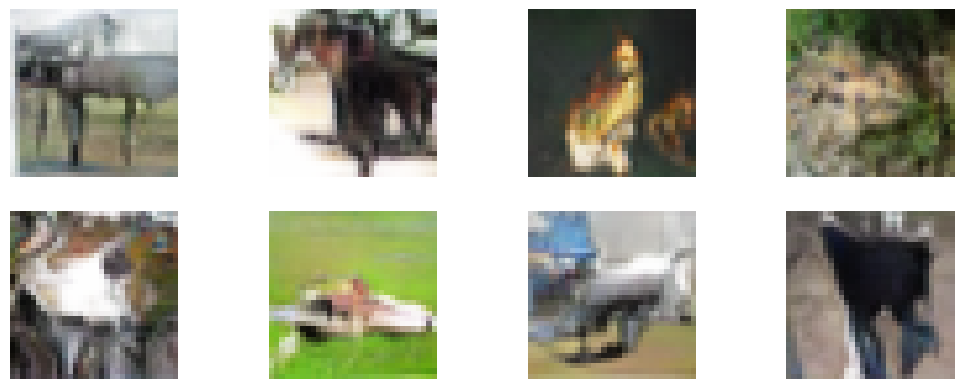

Iteration: 44000 - Generator loss: 1.3490 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.5375 - Discrimnator Accuracy: 73.05 %
Iteration: 44010 - Generator loss: 1.1222 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.5609 - Discrimnator Accuracy: 73.05 %
Iteration: 44020 - Generator loss: 1.3532 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.4945 - Discrimnator Accuracy: 77.73 %
Iteration: 44030 - Generator loss: 1.1099 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.5202 - Discrimnator Accuracy: 73.83 %
Iteration: 44040 - Generator loss: 1.2495 - Generator Accuracy: 9.38 % - Discrimnator loss: 0.5507 - Discrimnator Accuracy: 72.27 %
Iteration: 44050 - Generator loss: 1.0714 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.5620 - Discrimnator Accuracy: 68.36 %
Iteration: 44060 - Generator loss: 1.4324 - Generator Accuracy: 7.81 % - Discrimnator loss: 0.5461 - Discrimnator Accuracy: 69.14 %
Iteration: 44070 - Generator loss: 0.9817 - Generator Accuracy: 25.00 %

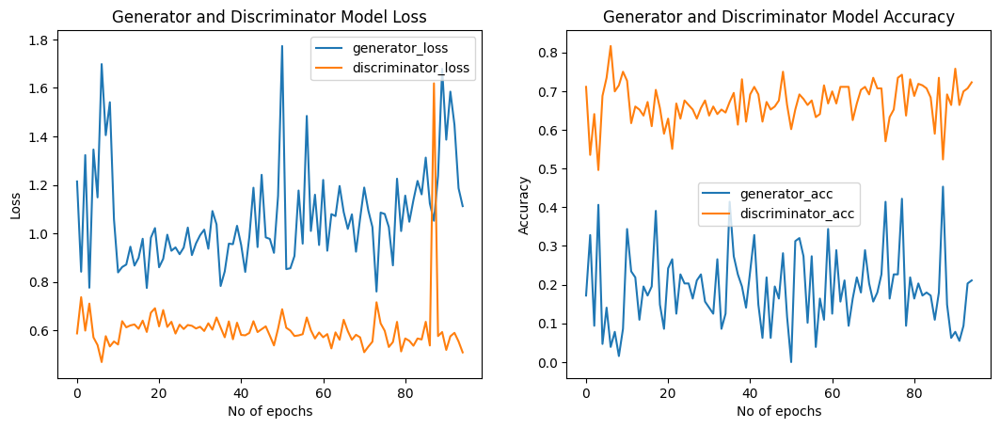

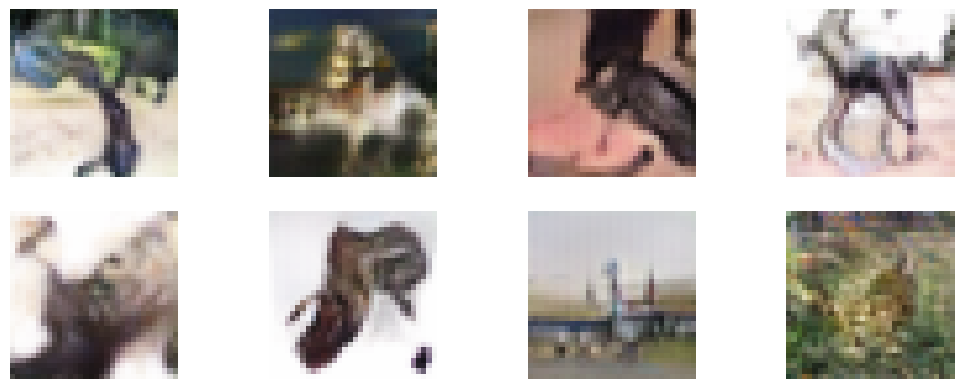

Iteration: 44470 - Generator loss: 1.1356 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5629 - Discrimnator Accuracy: 69.92 %
Iteration: 44480 - Generator loss: 1.3370 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.5221 - Discrimnator Accuracy: 74.61 %
Iteration: 44490 - Generator loss: 1.2247 - Generator Accuracy: 9.38 % - Discrimnator loss: 0.4960 - Discrimnator Accuracy: 75.78 %
Iteration: 44500 - Generator loss: 1.0073 - Generator Accuracy: 26.56 % - Discrimnator loss: 0.6254 - Discrimnator Accuracy: 66.80 %
Iteration: 44510 - Generator loss: 1.1571 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5557 - Discrimnator Accuracy: 69.92 %
Iteration: 44520 - Generator loss: 1.2578 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.4968 - Discrimnator Accuracy: 77.34 %
Iteration: 44530 - Generator loss: 1.3893 - Generator Accuracy: 8.59 % - Discrimnator loss: 0.5350 - Discrimnator Accuracy: 75.39 %
Iteration: 44540 - Generator loss: 1.0698 - Generator Accuracy: 13.28 %

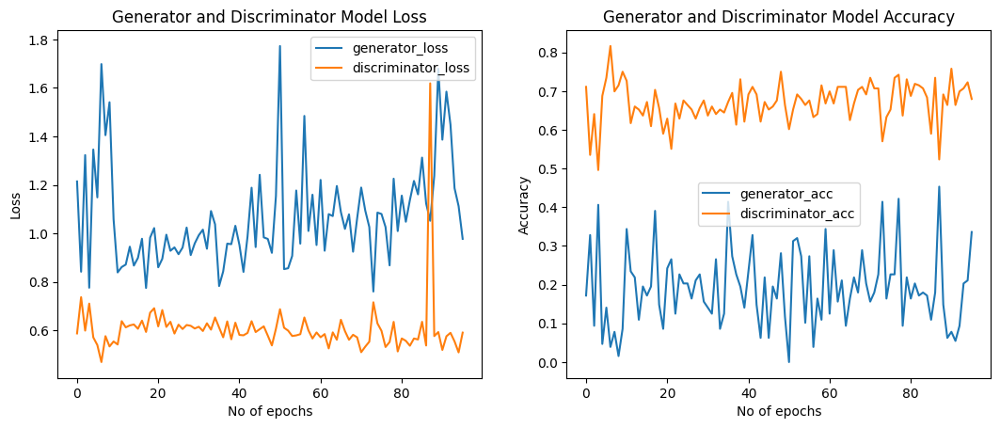

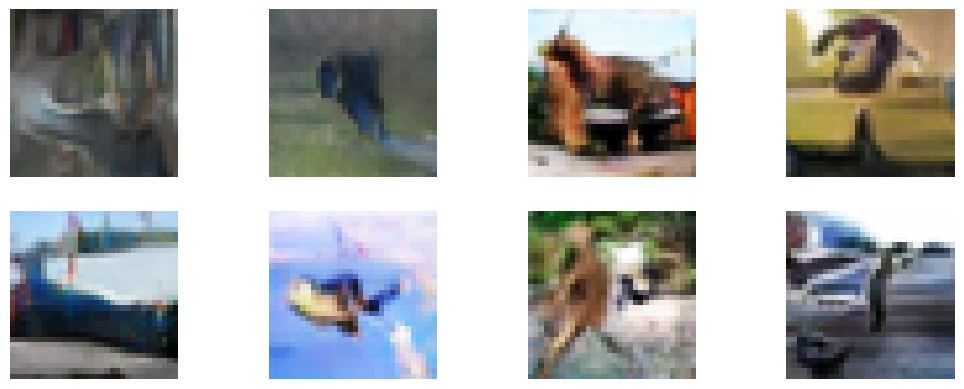

Iteration: 44930 - Generator loss: 0.6079 - Generator Accuracy: 64.84 % - Discrimnator loss: 0.6074 - Discrimnator Accuracy: 66.80 %
Iteration: 44940 - Generator loss: 1.4401 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.9138 - Discrimnator Accuracy: 59.38 %
Iteration: 44950 - Generator loss: 0.7957 - Generator Accuracy: 52.34 % - Discrimnator loss: 0.8238 - Discrimnator Accuracy: 51.17 %
Iteration: 44960 - Generator loss: 0.8453 - Generator Accuracy: 44.53 % - Discrimnator loss: 0.7195 - Discrimnator Accuracy: 55.08 %
Iteration: 44970 - Generator loss: 0.8020 - Generator Accuracy: 42.19 % - Discrimnator loss: 0.6267 - Discrimnator Accuracy: 62.89 %
Iteration: 44980 - Generator loss: 0.9475 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.5964 - Discrimnator Accuracy: 68.36 %
Iteration: 44990 - Generator loss: 0.8914 - Generator Accuracy: 28.91 % - Discrimnator loss: 0.6507 - Discrimnator Accuracy: 59.38 %
Iteration: 45000 - Generator loss: 0.8891 - Generator Accuracy: 30.47

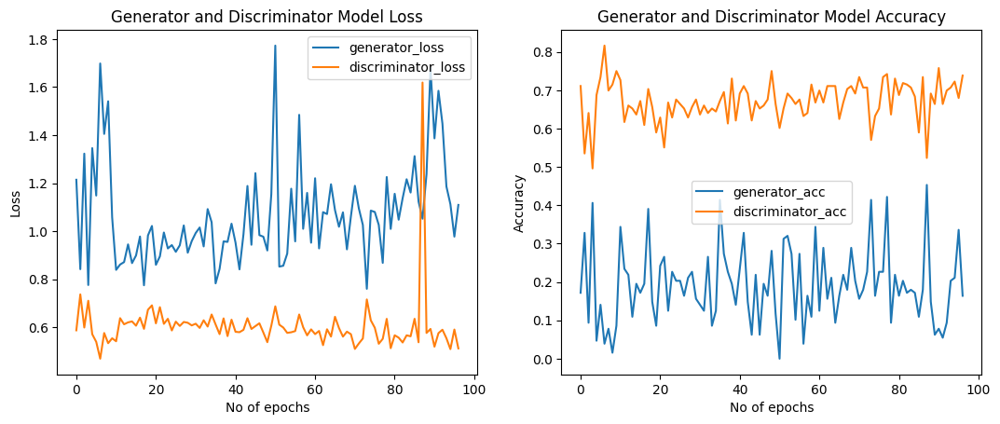

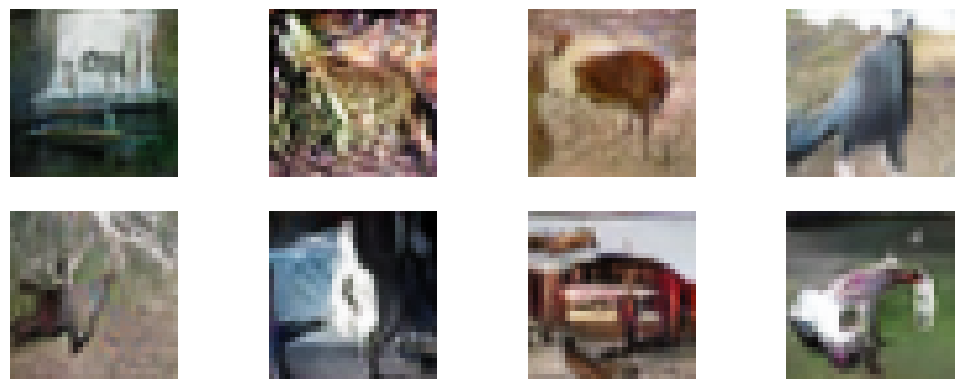

Iteration: 45400 - Generator loss: 1.0358 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.5824 - Discrimnator Accuracy: 67.97 %
Iteration: 45410 - Generator loss: 1.2996 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.6088 - Discrimnator Accuracy: 65.23 %
Iteration: 45420 - Generator loss: 1.0367 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.5374 - Discrimnator Accuracy: 71.09 %
Iteration: 45430 - Generator loss: 1.0707 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.5330 - Discrimnator Accuracy: 75.00 %
Iteration: 45440 - Generator loss: 0.9675 - Generator Accuracy: 31.25 % - Discrimnator loss: 0.5348 - Discrimnator Accuracy: 70.70 %
Iteration: 45450 - Generator loss: 1.2342 - Generator Accuracy: 7.03 % - Discrimnator loss: 0.4984 - Discrimnator Accuracy: 78.91 %
Iteration: 45460 - Generator loss: 1.3423 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.5205 - Discrimnator Accuracy: 73.44 %
Iteration: 45470 - Generator loss: 0.8425 - Generator Accuracy: 35.94 

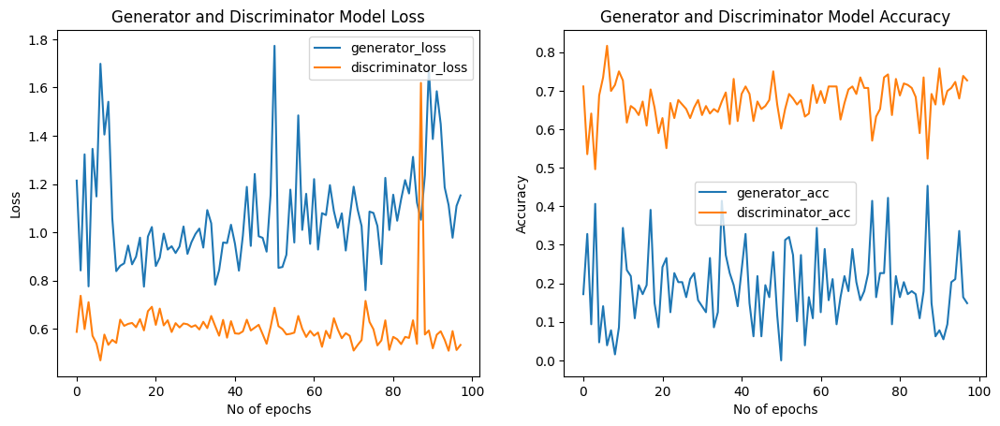

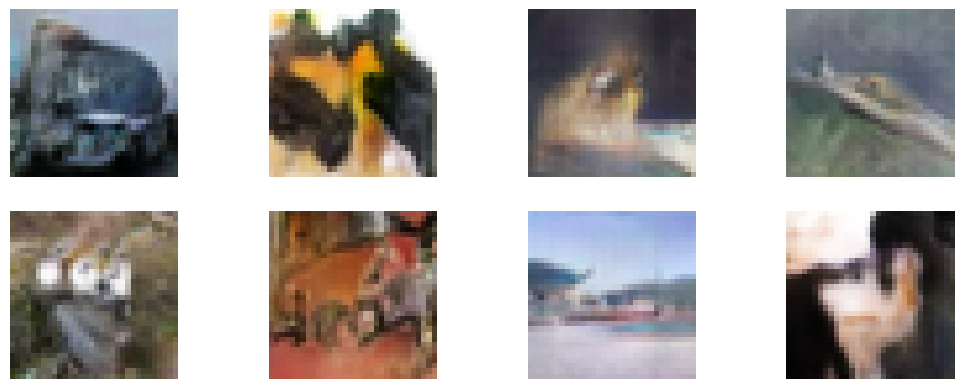

Iteration: 45870 - Generator loss: 1.3544 - Generator Accuracy: 3.91 % - Discrimnator loss: 0.5496 - Discrimnator Accuracy: 68.75 %
Iteration: 45880 - Generator loss: 1.1819 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.5488 - Discrimnator Accuracy: 73.05 %
Iteration: 45890 - Generator loss: 0.8616 - Generator Accuracy: 39.06 % - Discrimnator loss: 0.6650 - Discrimnator Accuracy: 60.94 %
Iteration: 45900 - Generator loss: 1.1539 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.5113 - Discrimnator Accuracy: 76.56 %
Iteration: 45910 - Generator loss: 1.3316 - Generator Accuracy: 7.03 % - Discrimnator loss: 0.4985 - Discrimnator Accuracy: 74.61 %
Iteration: 45920 - Generator loss: 0.9834 - Generator Accuracy: 27.34 % - Discrimnator loss: 0.5364 - Discrimnator Accuracy: 69.92 %
Iteration: 45930 - Generator loss: 1.2008 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5150 - Discrimnator Accuracy: 74.22 %
Iteration: 45940 - Generator loss: 1.2635 - Generator Accuracy: 8.59 % 

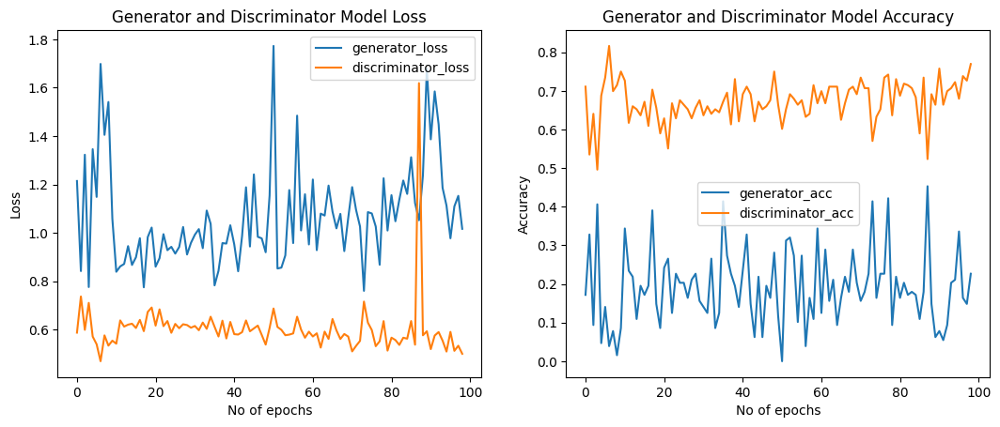

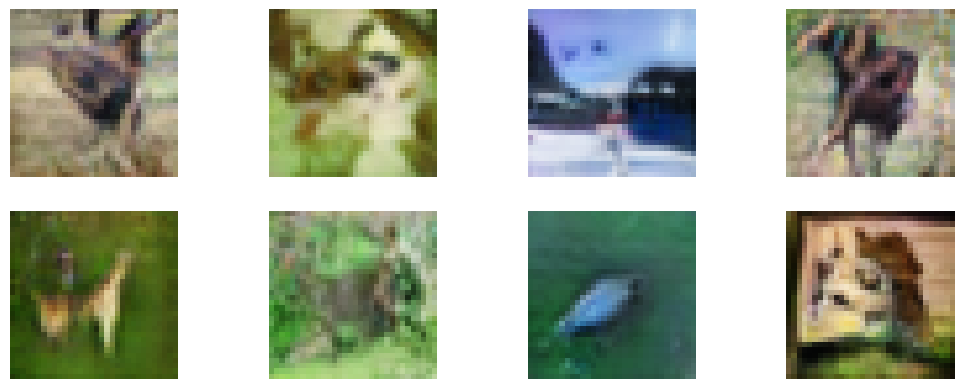

Iteration: 46340 - Generator loss: 0.9543 - Generator Accuracy: 32.03 % - Discrimnator loss: 0.5071 - Discrimnator Accuracy: 75.78 %
Iteration: 46350 - Generator loss: 0.9456 - Generator Accuracy: 37.50 % - Discrimnator loss: 0.5653 - Discrimnator Accuracy: 71.88 %
Iteration: 46360 - Generator loss: 1.0924 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.5187 - Discrimnator Accuracy: 73.83 %
Iteration: 46370 - Generator loss: 1.3762 - Generator Accuracy: 8.59 % - Discrimnator loss: 0.6197 - Discrimnator Accuracy: 65.23 %
Iteration: 46380 - Generator loss: 1.2194 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.5180 - Discrimnator Accuracy: 76.17 %
Iteration: 46390 - Generator loss: 1.1398 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5121 - Discrimnator Accuracy: 70.70 %
Iteration: 46400 - Generator loss: 1.3956 - Generator Accuracy: 6.25 % - Discrimnator loss: 0.5571 - Discrimnator Accuracy: 69.14 %
Iteration: 46410 - Generator loss: 0.9385 - Generator Accuracy: 32.81 %

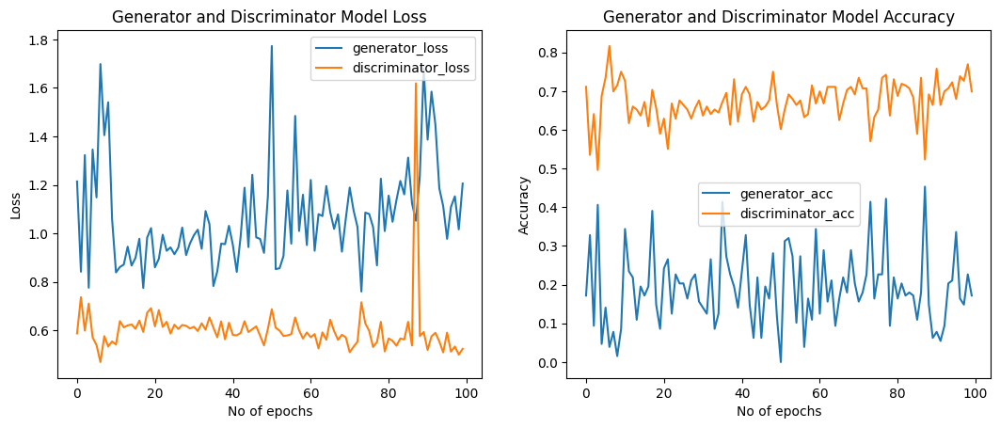

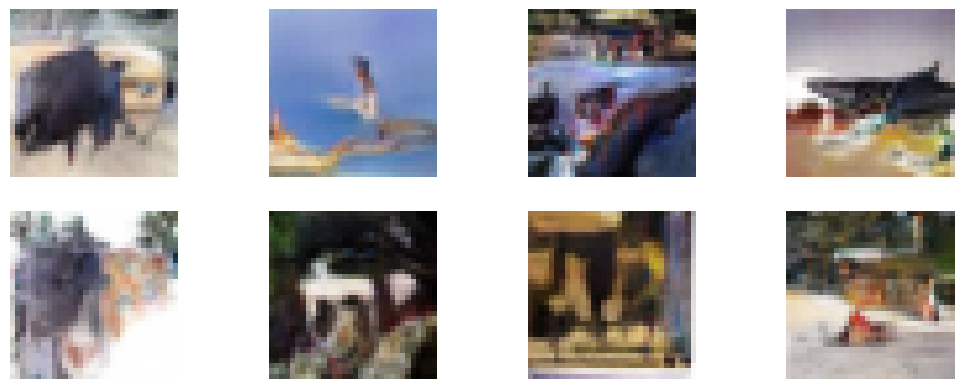

Iteration: 46810 - Generator loss: 1.0982 - Generator Accuracy: 24.22 % - Discrimnator loss: 0.5553 - Discrimnator Accuracy: 68.75 %
Iteration: 46820 - Generator loss: 1.3499 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.4616 - Discrimnator Accuracy: 78.12 %
Iteration: 46830 - Generator loss: 0.8471 - Generator Accuracy: 39.06 % - Discrimnator loss: 0.5243 - Discrimnator Accuracy: 72.66 %
Iteration: 46840 - Generator loss: 1.1707 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.4982 - Discrimnator Accuracy: 75.78 %
Iteration: 46850 - Generator loss: 1.1333 - Generator Accuracy: 19.53 % - Discrimnator loss: 0.5316 - Discrimnator Accuracy: 73.05 %
Iteration: 46860 - Generator loss: 1.2663 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.5474 - Discrimnator Accuracy: 67.58 %
Iteration: 46870 - Generator loss: 1.0101 - Generator Accuracy: 26.56 % - Discrimnator loss: 0.5304 - Discrimnator Accuracy: 77.73 %
Iteration: 46880 - Generator loss: 1.3519 - Generator Accuracy: 7.81 

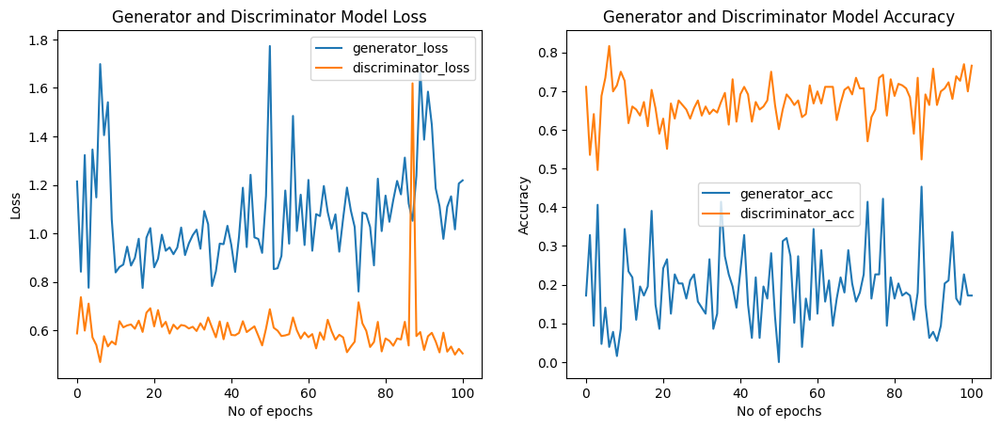

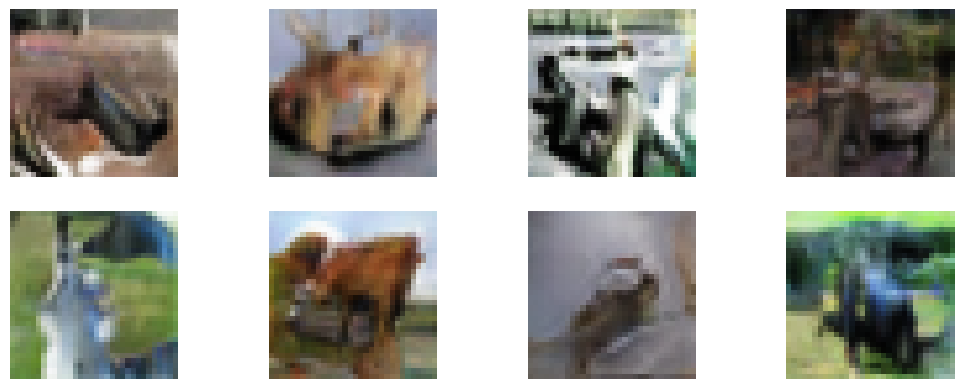

Iteration: 47270 - Generator loss: 1.2282 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.5082 - Discrimnator Accuracy: 73.83 %
Iteration: 47280 - Generator loss: 1.4187 - Generator Accuracy: 8.59 % - Discrimnator loss: 0.5074 - Discrimnator Accuracy: 73.44 %
Iteration: 47290 - Generator loss: 1.6255 - Generator Accuracy: 0.78 % - Discrimnator loss: 0.6226 - Discrimnator Accuracy: 65.23 %
Iteration: 47300 - Generator loss: 1.3510 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.5032 - Discrimnator Accuracy: 71.88 %
Iteration: 47310 - Generator loss: 1.0951 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.4998 - Discrimnator Accuracy: 73.44 %
Iteration: 47320 - Generator loss: 1.3224 - Generator Accuracy: 9.38 % - Discrimnator loss: 0.4869 - Discrimnator Accuracy: 76.56 %
Iteration: 47330 - Generator loss: 1.2754 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5078 - Discrimnator Accuracy: 75.00 %
Iteration: 47340 - Generator loss: 1.0800 - Generator Accuracy: 23.44 % 

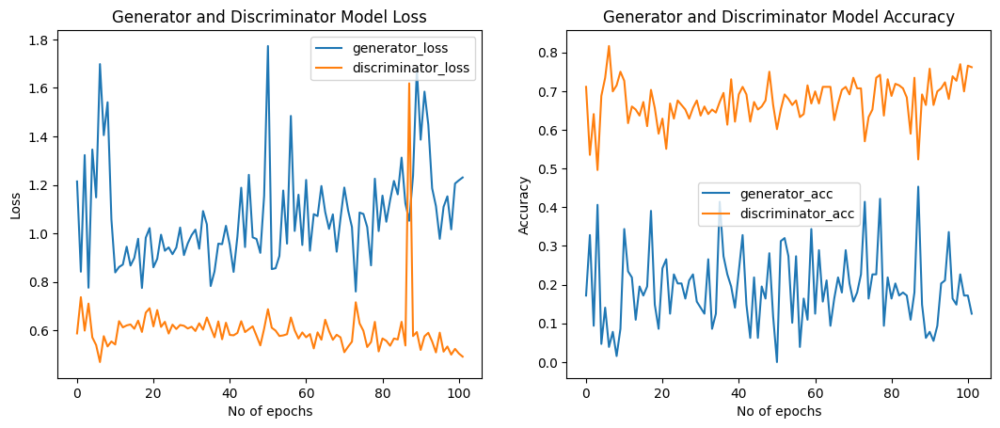

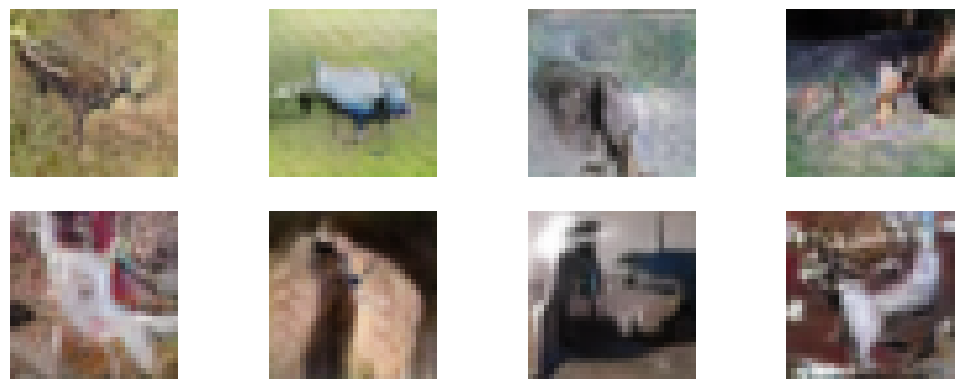

Iteration: 47740 - Generator loss: 1.5325 - Generator Accuracy: 5.47 % - Discrimnator loss: 0.5500 - Discrimnator Accuracy: 68.36 %
Iteration: 47750 - Generator loss: 1.0110 - Generator Accuracy: 28.91 % - Discrimnator loss: 0.5216 - Discrimnator Accuracy: 74.22 %
Iteration: 47760 - Generator loss: 1.2188 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.4968 - Discrimnator Accuracy: 75.00 %
Iteration: 47770 - Generator loss: 1.1349 - Generator Accuracy: 20.31 % - Discrimnator loss: 0.4921 - Discrimnator Accuracy: 74.22 %
Iteration: 47780 - Generator loss: 1.2940 - Generator Accuracy: 9.38 % - Discrimnator loss: 0.5377 - Discrimnator Accuracy: 73.44 %
Iteration: 47790 - Generator loss: 1.2542 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.4970 - Discrimnator Accuracy: 76.95 %
Iteration: 47800 - Generator loss: 0.9575 - Generator Accuracy: 31.25 % - Discrimnator loss: 0.5007 - Discrimnator Accuracy: 78.91 %
Iteration: 47810 - Generator loss: 1.4442 - Generator Accuracy: 8.59 % 

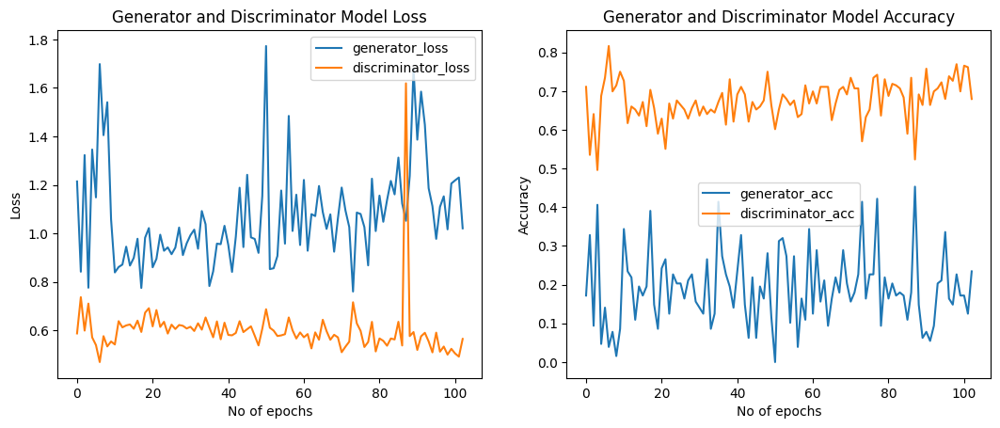

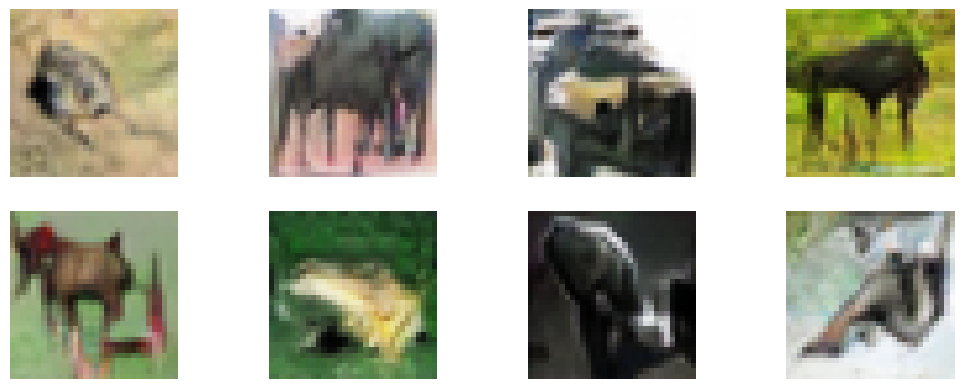

Iteration: 48210 - Generator loss: 1.5627 - Generator Accuracy: 7.81 % - Discrimnator loss: 0.5195 - Discrimnator Accuracy: 71.88 %
Iteration: 48220 - Generator loss: 1.1719 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5095 - Discrimnator Accuracy: 74.61 %
Iteration: 48230 - Generator loss: 1.1081 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5460 - Discrimnator Accuracy: 71.88 %
Iteration: 48240 - Generator loss: 1.1764 - Generator Accuracy: 18.75 % - Discrimnator loss: 0.5513 - Discrimnator Accuracy: 72.66 %
Iteration: 48250 - Generator loss: 1.3081 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.4832 - Discrimnator Accuracy: 74.61 %
Iteration: 48260 - Generator loss: 1.4237 - Generator Accuracy: 3.12 % - Discrimnator loss: 0.6603 - Discrimnator Accuracy: 63.67 %
Iteration: 48270 - Generator loss: 1.2067 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.4679 - Discrimnator Accuracy: 76.95 %
Iteration: 48280 - Generator loss: 1.3743 - Generator Accuracy: 11.72 %

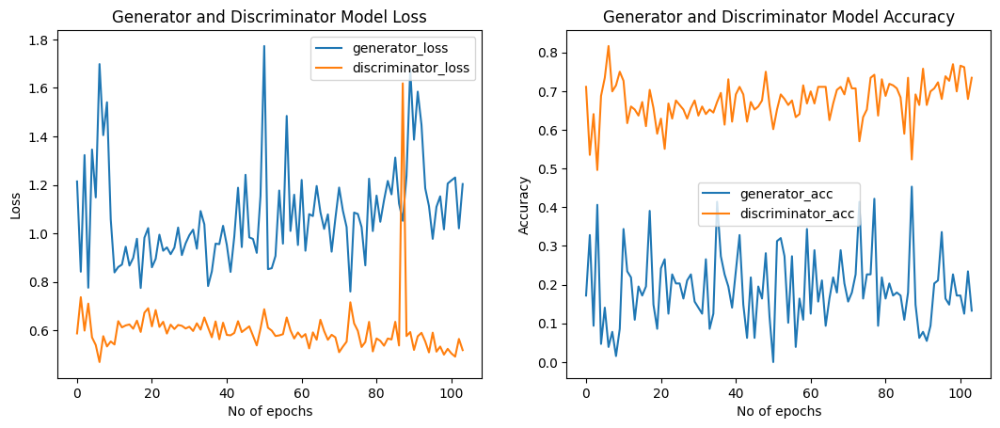

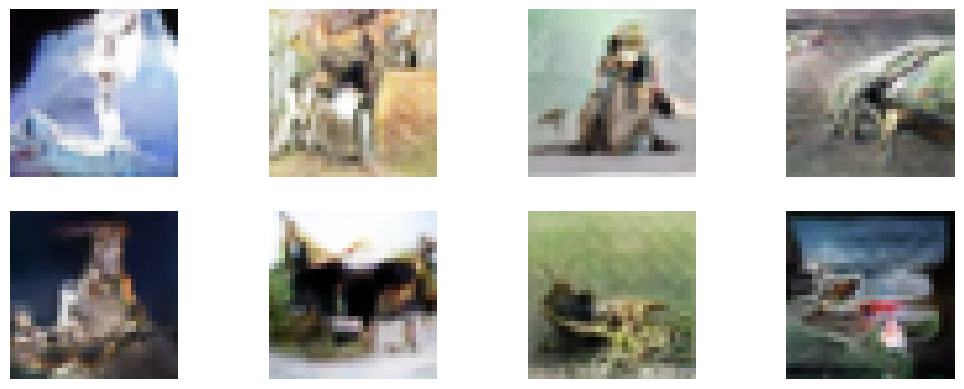

Iteration: 48680 - Generator loss: 1.0441 - Generator Accuracy: 25.00 % - Discrimnator loss: 0.5218 - Discrimnator Accuracy: 73.83 %
Iteration: 48690 - Generator loss: 1.1885 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.5206 - Discrimnator Accuracy: 72.66 %
Iteration: 48700 - Generator loss: 1.1234 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.5461 - Discrimnator Accuracy: 70.31 %
Iteration: 48710 - Generator loss: 0.9252 - Generator Accuracy: 32.03 % - Discrimnator loss: 0.8166 - Discrimnator Accuracy: 57.03 %
Iteration: 48720 - Generator loss: 1.0135 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.6297 - Discrimnator Accuracy: 66.02 %
Iteration: 48730 - Generator loss: 1.2425 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.5652 - Discrimnator Accuracy: 70.31 %
Iteration: 48740 - Generator loss: 1.2503 - Generator Accuracy: 7.81 % - Discrimnator loss: 0.5459 - Discrimnator Accuracy: 74.22 %
Iteration: 48750 - Generator loss: 1.2504 - Generator Accuracy: 14.06 

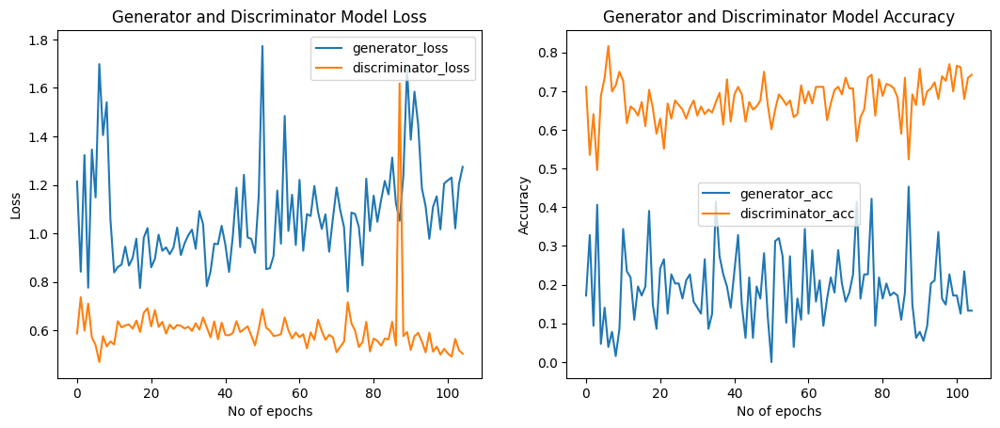

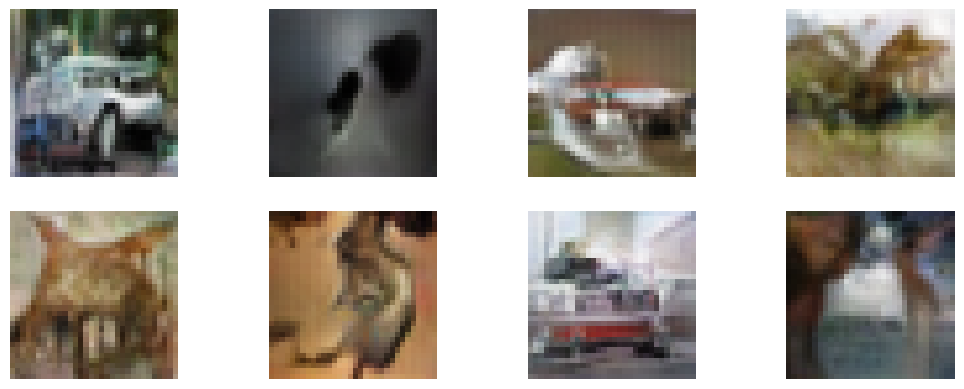

Iteration: 49150 - Generator loss: 0.9801 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.5994 - Discrimnator Accuracy: 66.02 %
Iteration: 49160 - Generator loss: 1.2006 - Generator Accuracy: 13.28 % - Discrimnator loss: 0.4756 - Discrimnator Accuracy: 79.69 %
Iteration: 49170 - Generator loss: 1.3892 - Generator Accuracy: 6.25 % - Discrimnator loss: 0.5078 - Discrimnator Accuracy: 73.44 %
Iteration: 49180 - Generator loss: 1.2615 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.5020 - Discrimnator Accuracy: 71.88 %
Iteration: 49190 - Generator loss: 1.0487 - Generator Accuracy: 25.78 % - Discrimnator loss: 0.4730 - Discrimnator Accuracy: 78.52 %
Iteration: 49200 - Generator loss: 1.3071 - Generator Accuracy: 10.94 % - Discrimnator loss: 0.5025 - Discrimnator Accuracy: 75.39 %
Iteration: 49210 - Generator loss: 1.2488 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.5538 - Discrimnator Accuracy: 69.92 %
Iteration: 49220 - Generator loss: 1.1432 - Generator Accuracy: 16.41 

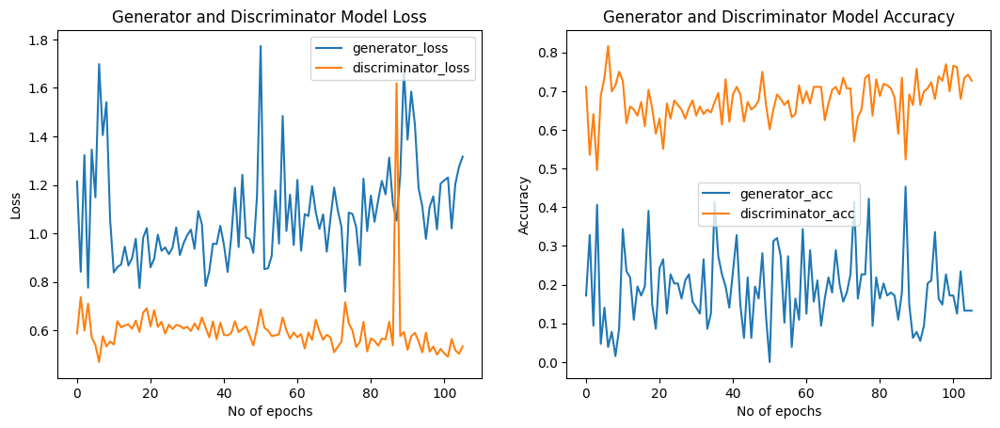

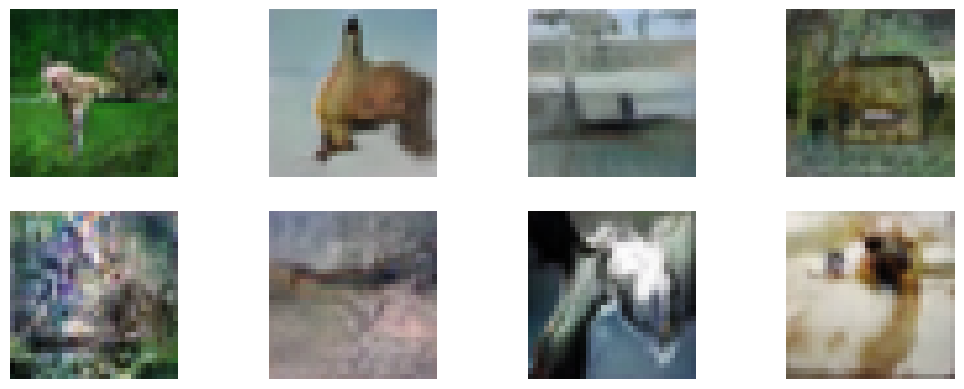

Iteration: 49610 - Generator loss: 1.1166 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5168 - Discrimnator Accuracy: 76.17 %
Iteration: 49620 - Generator loss: 1.0816 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5103 - Discrimnator Accuracy: 76.56 %
Iteration: 49630 - Generator loss: 1.4203 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.5752 - Discrimnator Accuracy: 66.02 %
Iteration: 49640 - Generator loss: 1.1290 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.5375 - Discrimnator Accuracy: 73.83 %
Iteration: 49650 - Generator loss: 1.3306 - Generator Accuracy: 9.38 % - Discrimnator loss: 0.4494 - Discrimnator Accuracy: 76.56 %
Iteration: 49660 - Generator loss: 1.2890 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.5690 - Discrimnator Accuracy: 71.09 %
Iteration: 49670 - Generator loss: 1.2121 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.4970 - Discrimnator Accuracy: 75.00 %
Iteration: 49680 - Generator loss: 1.2080 - Generator Accuracy: 14.06 

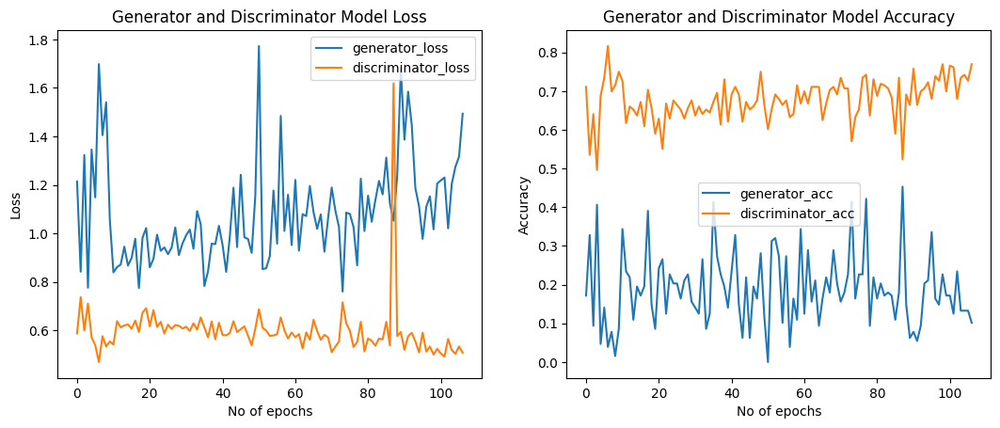

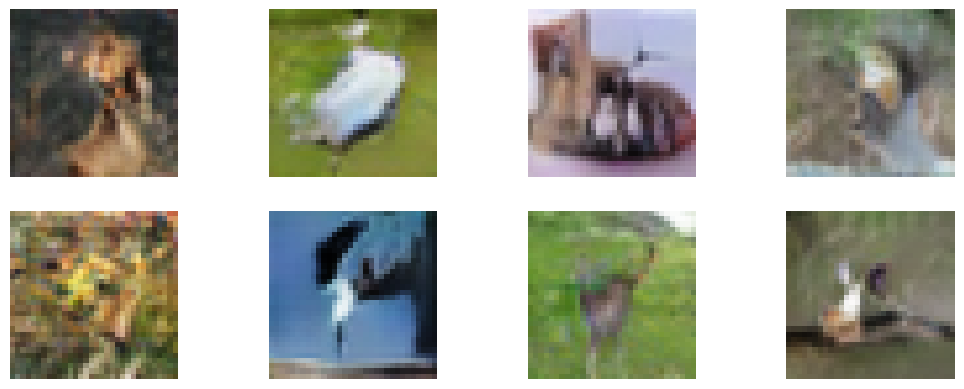

Iteration: 50080 - Generator loss: 1.2860 - Generator Accuracy: 16.41 % - Discrimnator loss: 0.4912 - Discrimnator Accuracy: 79.30 %
Iteration: 50090 - Generator loss: 1.4773 - Generator Accuracy: 7.03 % - Discrimnator loss: 0.5042 - Discrimnator Accuracy: 75.39 %
Iteration: 50100 - Generator loss: 1.4178 - Generator Accuracy: 8.59 % - Discrimnator loss: 0.5453 - Discrimnator Accuracy: 68.75 %
Iteration: 50110 - Generator loss: 1.1158 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5711 - Discrimnator Accuracy: 73.05 %
Iteration: 50120 - Generator loss: 1.2302 - Generator Accuracy: 17.97 % - Discrimnator loss: 0.4646 - Discrimnator Accuracy: 76.17 %
Iteration: 50130 - Generator loss: 1.1035 - Generator Accuracy: 21.88 % - Discrimnator loss: 0.5460 - Discrimnator Accuracy: 71.09 %
Iteration: 50140 - Generator loss: 1.2246 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.4809 - Discrimnator Accuracy: 77.73 %
Iteration: 50150 - Generator loss: 1.4452 - Generator Accuracy: 9.38 % 

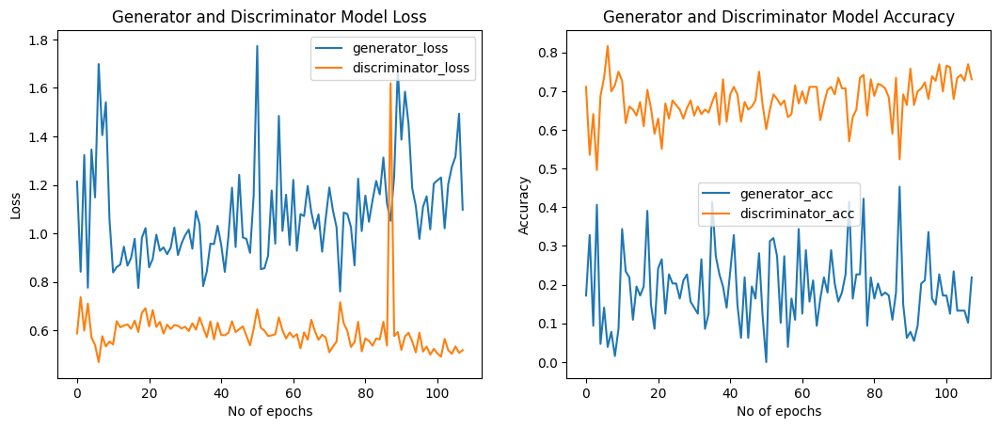

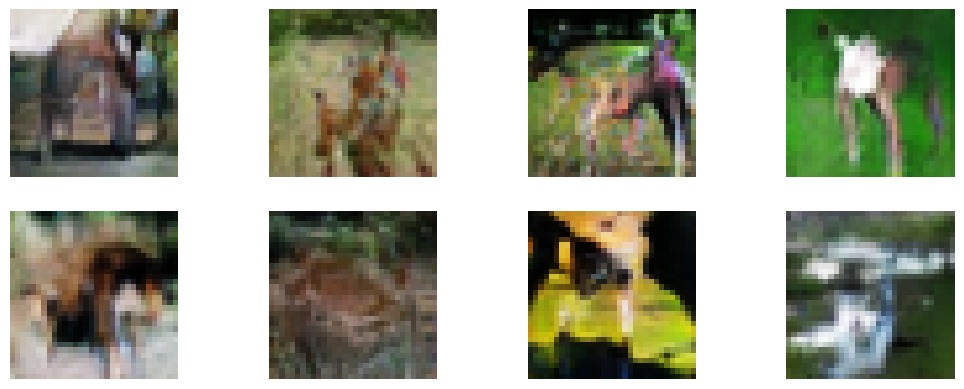

Iteration: 50550 - Generator loss: 1.4815 - Generator Accuracy: 5.47 % - Discrimnator loss: 0.4946 - Discrimnator Accuracy: 74.61 %
Iteration: 50560 - Generator loss: 0.9855 - Generator Accuracy: 26.56 % - Discrimnator loss: 0.5541 - Discrimnator Accuracy: 74.22 %
Iteration: 50570 - Generator loss: 1.0986 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.4979 - Discrimnator Accuracy: 76.56 %
Iteration: 50580 - Generator loss: 1.2537 - Generator Accuracy: 17.19 % - Discrimnator loss: 0.6445 - Discrimnator Accuracy: 64.45 %
Iteration: 50590 - Generator loss: 1.3262 - Generator Accuracy: 14.06 % - Discrimnator loss: 0.4460 - Discrimnator Accuracy: 78.52 %
Iteration: 50600 - Generator loss: 1.3424 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.4855 - Discrimnator Accuracy: 76.95 %
Iteration: 50610 - Generator loss: 1.4537 - Generator Accuracy: 4.69 % - Discrimnator loss: 0.5320 - Discrimnator Accuracy: 72.27 %
Iteration: 50620 - Generator loss: 1.1831 - Generator Accuracy: 17.97 %

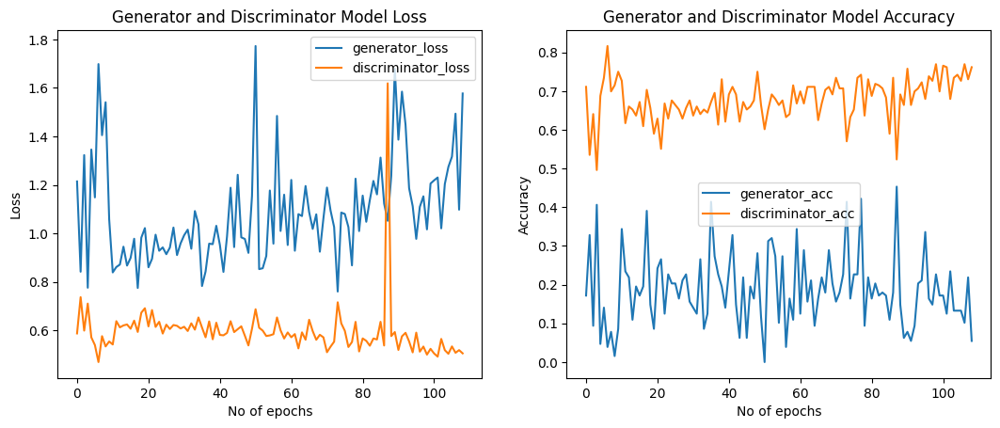

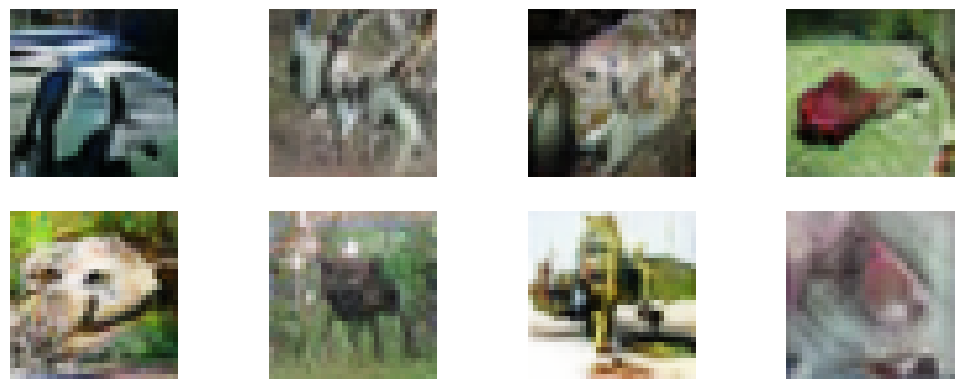

Iteration: 51020 - Generator loss: 1.1590 - Generator Accuracy: 21.09 % - Discrimnator loss: 0.5103 - Discrimnator Accuracy: 73.05 %
Iteration: 51030 - Generator loss: 1.2271 - Generator Accuracy: 15.62 % - Discrimnator loss: 0.5039 - Discrimnator Accuracy: 76.17 %
Iteration: 51040 - Generator loss: 1.0097 - Generator Accuracy: 26.56 % - Discrimnator loss: 0.5067 - Discrimnator Accuracy: 73.05 %
Iteration: 51050 - Generator loss: 1.1052 - Generator Accuracy: 22.66 % - Discrimnator loss: 0.5071 - Discrimnator Accuracy: 78.12 %
Iteration: 51060 - Generator loss: 1.5813 - Generator Accuracy: 6.25 % - Discrimnator loss: 0.4941 - Discrimnator Accuracy: 78.91 %
Iteration: 51070 - Generator loss: 1.3697 - Generator Accuracy: 10.16 % - Discrimnator loss: 0.5300 - Discrimnator Accuracy: 71.88 %
Iteration: 51080 - Generator loss: 1.3172 - Generator Accuracy: 12.50 % - Discrimnator loss: 0.4573 - Discrimnator Accuracy: 76.56 %
Iteration: 51090 - Generator loss: 1.8802 - Generator Accuracy: 1.56 %

In [ ]:
epochs = 200
iteration_counter = 0
history = {'generator_loss': [], 'generator_acc': [], 'discriminator_loss': [], 'discriminator_acc': []}

for epoch in range(epochs):
    for batch, X_batch in enumerate(dataset):

        # phase 1 - training the discriminator
        noise = normal(shape=[batch_size, noise_dim])
        generated_images = generator(noise)
        X_fake_and_real = concat([generated_images, X_batch], axis=0)
        y1 = constant([[0.]] * batch_size + [[1.]] * batch_size)
        discriminator.trainable = True
        discriminator_loss, discriminator_acc = discriminator.train_on_batch(X_fake_and_real, y1)

        # phase 2 - training the generator
        noise = normal(shape=[batch_size, noise_dim])
        y2 = constant([[1.]] * batch_size)
        discriminator.trainable = False
        generator_loss, generator_acc = gan.train_on_batch(noise, y2)

        iteration_counter += 1
        if iteration_counter % 10 == 0:
            print("Iteration: %d - Generator loss: %.4f - Generator Accuracy: %.2f %% - Discrimnator loss: %.4f - Discrimnator Accuracy: %.2f %%"
                %(iteration_counter, generator_loss, generator_acc*100, discriminator_loss, discriminator_acc*100))

    history['generator_loss'].append(generator_loss)
    history['generator_acc'].append(generator_acc)
    history['discriminator_loss'].append(discriminator_loss)
    history['discriminator_acc'].append(discriminator_acc)

    plot_loss_and_accuracy(history)
    show_generated_images(generated_images)

sourses: \\
[1] https://machinelearningmastery.com/how-to-develop-a-generative-adversarial-network-for-a-cifar-10-small-object-photographs-from-scratch/

## B. Provide an example and demonstrate the superiority of Gradient Ascent over Gradient Descent for optimizing the generator's objective function.

It is observed that optimizing the generator objective function, which is given below, does not work so well, this is because when the sample is generated is likely to be classified as fake, the model would like to learn from the gradients, but the gradients turn out to be relatively flat. This makes it difficult for the model to learn.

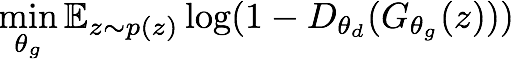

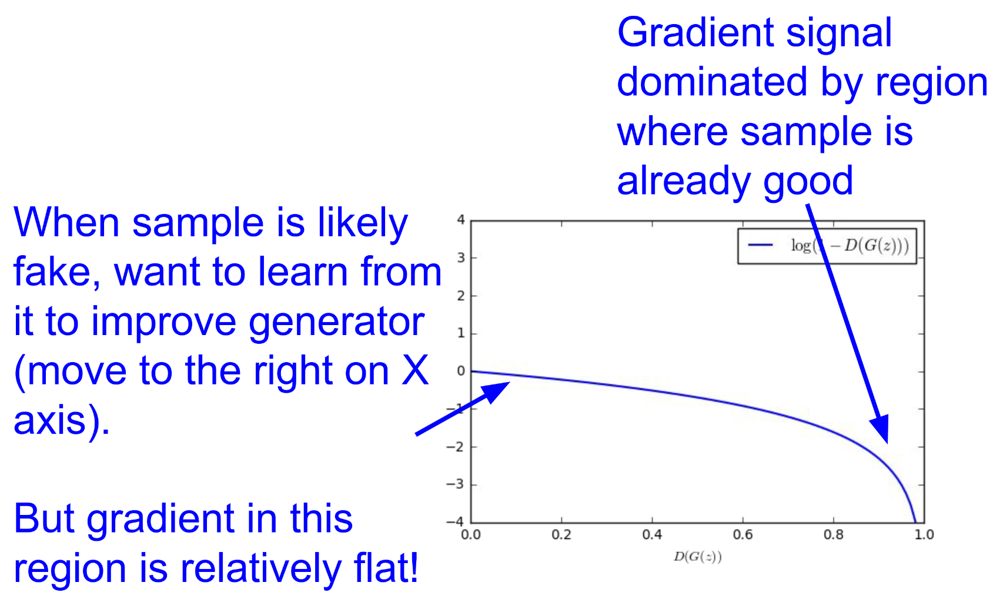

Therefore, the generator objective function is changed as below. Instead of minimizing the likelihood of discriminator being correct, we maximize the likelihood of discriminator being wrong. Therefore, we perform gradient ascent on generator according to this objective function.

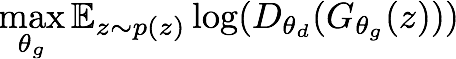

Same objective of fooling discriminator, but now higher gradient
signal for bad samples ⟹ works much better! Standard in practice.

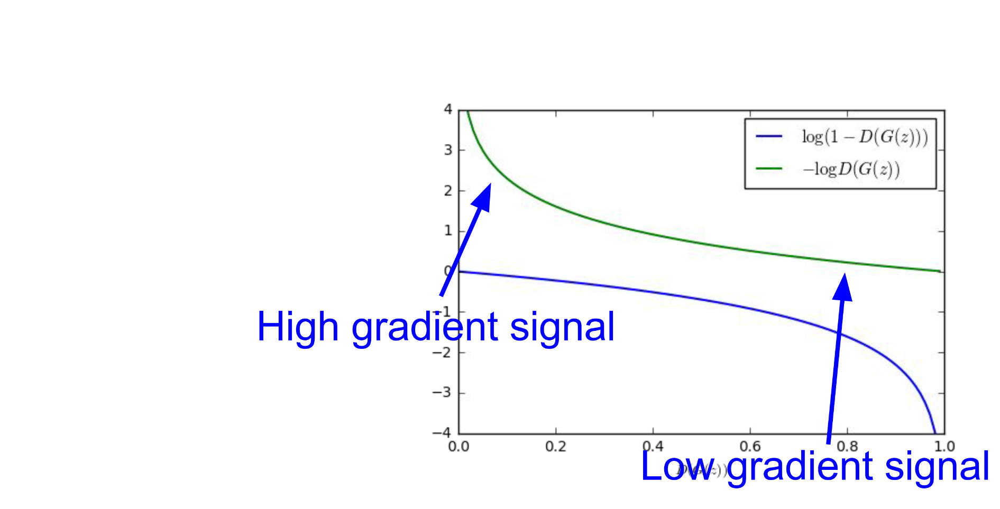

source: slide from Fei-Dei Li, Justin Johnson, Serena Yeung, cs231n Stanford

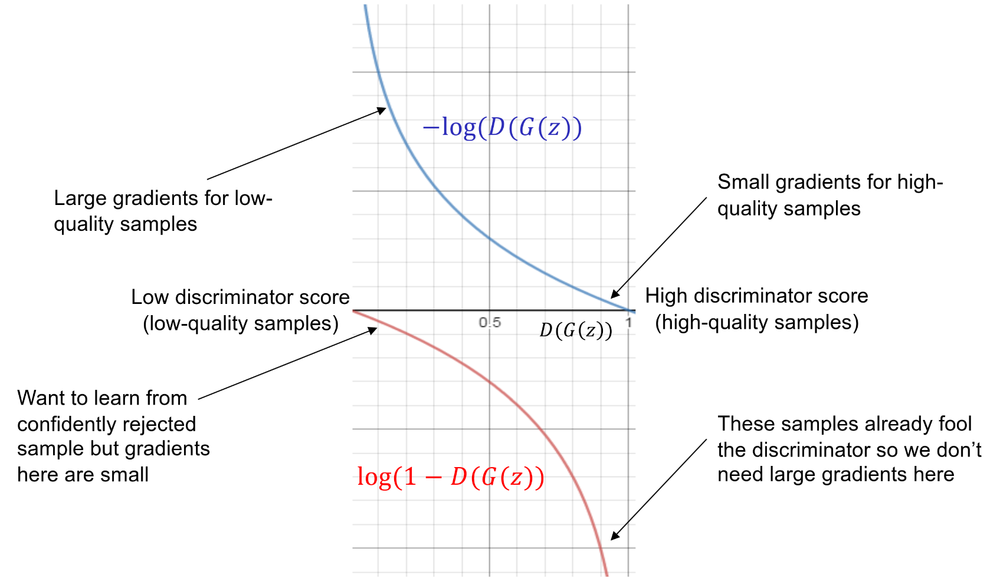 \\
source: slides from Svetlana Lazebnik, spring24, lec11_gan

# Part III

1.   *New dataset is small and similar to original dataset.* Since the data is small, it is not a good idea to fine-tune the ConvNet due to overfitting concerns. Since the data is similar to the original data, we expect higher-level features in the ConvNet to be relevant to this dataset as well. Hence, the best idea might be to train a linear classifier on the CNN codes.
2.   *New dataset is small but very different from the original dataset.* Since the data is small, it is likely best to only train a linear classifier. Since the dataset is very different, it might not be best to train the classifier form the top of the network, which contains more dataset-specific features. Instead, it might work better to train the SVM classifier from activations somewhere earlier in the network.

source: \\
https://cs231n.github.io/transfer-learning/

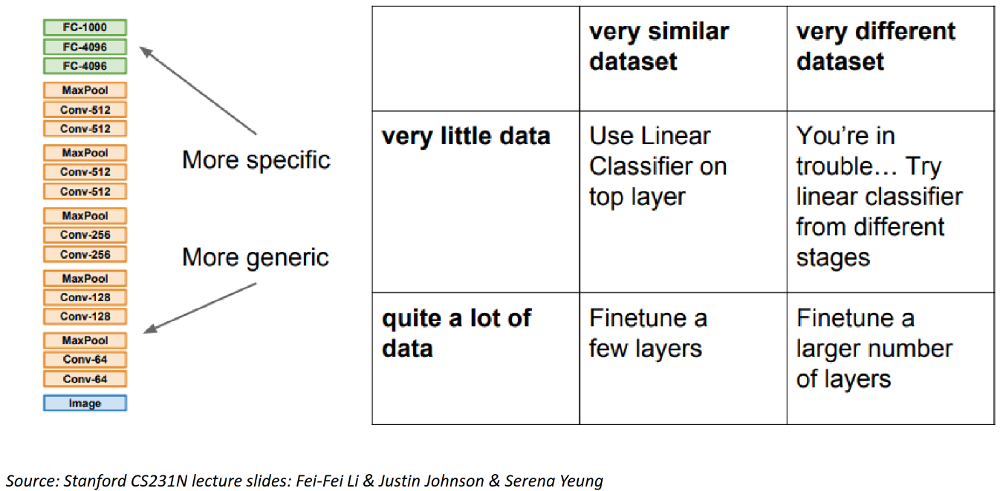

**Case 1: Small and Similar Dataset**
*    remove the end of the fully connected neural network
*   add a new fully-connected layer that has an output dimension equal to the number of classes in the new data set.
*    randomize the weights of the new fully connected layer;
*    freeze all the weights from the pre-trained network
*    train the network to update the weights of the new fully connected layer

**Case 2: Small and Different Dataset**
*    we remove the end of the fully connected neural network and some CNN layers at the end of the network.
*    add a new fully-connected layer that has an output dimension equal to the number of classes in the new data set.
*    randomize the weights of the new fully connected layer;
*    freeze all the weights from the remaining pre-trained CNN network
*    train the network to update the weights of the new fully connected layer

source: \\
https://towardsdatascience.com/how-transfer-learning-works-a90bc4d93b5e

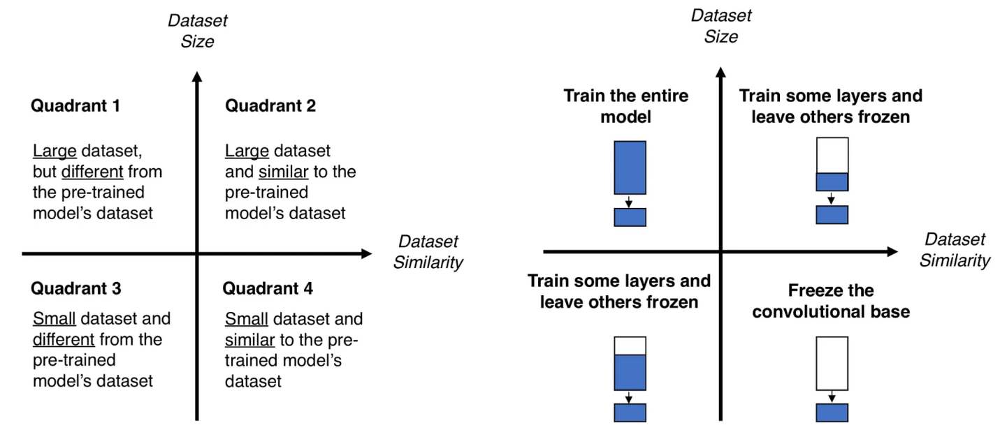

## A. How should you employ Transfer Learning If your dataset is small and very different from the original dataset used to train the pre-trained model?

The dataset that will be used for this part is
**Computed Tomography (CT) of the Brain**
(Brain scans for Cancer, Tumor and Aneurysm Detection and Segmentation) \\
https://www.kaggle.com/datasets/trainingdatapro/computed-tomography-ct-of-the-brain

Import necessary libraries

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.utils import image_dataset_from_directory
from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications import vgg16
from tensorflow.keras.layers import Dense, Flatten, Dropout
import matplotlib.pyplot as plt
import numpy as np

Define some constants \\
Because we have few images, we choose a small size of batch.

In [ ]:
dataset_dir = project_dir + 'Data-computed-tomography-ct-of-the-brain/'
num_of_images = 173
validation_split = 0.2
seed = 123
batch_size = 8

Load train dataset from google drive \\
VGG-16 has the input size of 224 × 224 × 3.

In [ ]:
train_data = image_dataset_from_directory(
    dataset_dir,
    validation_split = validation_split,
    subset = "training",
    seed = seed,
    label_mode = 'categorical',
    image_size = (224, 224),
    batch_size = batch_size
)

Found 259 files belonging to 3 classes.
Using 208 files for training.


Load validation dataset from google drive

In [ ]:
valid_data = image_dataset_from_directory(
    dataset_dir,
    validation_split = validation_split,
    subset = "validation",
    seed = seed,
    label_mode = 'categorical',
    image_size = (224, 224),
    batch_size = batch_size
)

Found 259 files belonging to 3 classes.
Using 51 files for validation.


Show an example of dataset with its class name

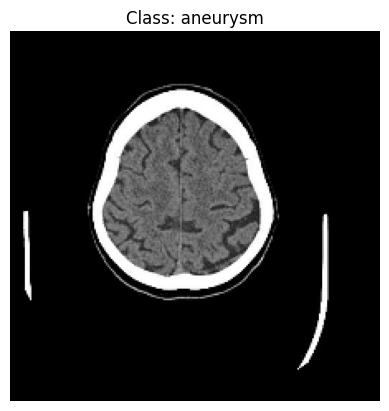

In [ ]:
for batch_images, batch_labels in train_data:
    plt.imshow(batch_images[0] / 255)
    plt.title('Class: ' + train_data.class_names[(np.argmax(batch_labels[0].numpy()))])
    plt.axis('off')
    plt.show()
    break

Load VGG-16 pre-trained model

In [ ]:
pretrain_vgg16 = VGG16(include_top=False, input_shape=(224,224,3), classes=3)

Freeze the convolutional layers

In [ ]:
pretrain_vgg16.trainable = False

Define a function to scale images to the appropriate range

In [ ]:
def preprocess_input(dataset, preprocess_function):
    return dataset.map(lambda image, label: (preprocess_function(image), label))

Call the *preprocess_input* function on the images to scale them to the appropriate range

In [ ]:
train_data_vgg16 = preprocess_input(train_data, vgg16.preprocess_input)
valid_data_vgg16 = preprocess_input(valid_data, vgg16.preprocess_input)

Define a fuction to make a sequentioal model with VGG-16 architecture, then compile it with Adam optimizer, fit it on dataset, and finally return the history of trainig

In [ ]:
def train_VGG16_model(
        train_data,
        validation_data,
        num_classes,
        num_earlier_layers=19,
        epochs=10
):

    model = Sequential()
    for layer in pretrain_vgg16.layers[:num_earlier_layers]:
        model.add(layer)
    model.add(Flatten())
    model.add(Dense(units=num_classes, activation="softmax"))

    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    model.summary()

    history = model.fit(
        train_data,
        validation_data = validation_data,
        epochs = epochs
    )

    return history

### 1. Model with small different dataset, trained on all the VGG-16 features

Train the model with small different dataset on all the VGG-16 features

In [ ]:
history = train_VGG16_model(train_data_vgg16, valid_data_vgg16, num_classes=3)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten (Flatten)           (None, 25088)             0         
                                                                 
 dense (Dense)               (None, 3)                 75267     
                                                                 
Total params: 14789955 (56.42 MB)
Trainable params: 75267 (294.01 KB)
Non-trainable params: 14714688 (56.13 MB)
_________________________________________________________________
Epoch 1/10
26/26 [==============================] - 162s 6s/step - loss: 3.1216 - accuracy: 0.8654 - val_loss: 0.1848 - val_accuracy: 0.9804
Epoch 2/10
26/26 [==============================] - 155s 6s/step - loss: 1.2951 - accuracy: 0.9760 - val_loss: 2.2727 - val_accuracy:

Define a fuction to plot training history loss and accurracy

In [ ]:
def plot_loss_and_accuracy(history, title):
    plt.figure(figsize=[2 * plt.rcParams['figure.figsize'][0], plt.rcParams['figure.figsize'][1]])
    plt.suptitle(title, size='xx-large')

    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='train')
    plt.plot(history.history['val_loss'], label='test')
    plt.title('Model Loss')
    plt.xlabel('No of epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history.history['accuracy'], label='train')
    plt.plot(history.history['val_accuracy'], label='test')
    plt.title('Model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('No of epochs')
    plt.legend()
    plt.show()

Plot the history of model with small different dataset on all the VGG-16 features

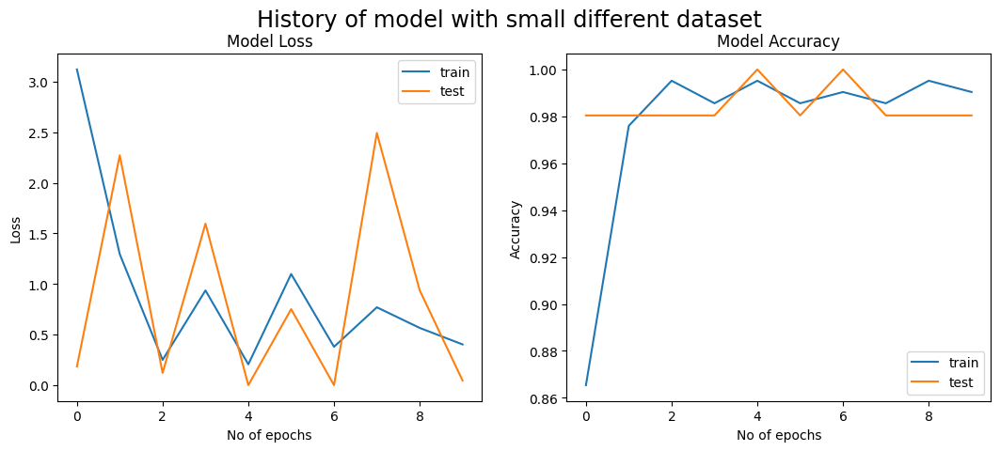

In [ ]:
plot_loss_and_accuracy(history, 'History of model with small different dataset on all the VGG-16 features')

### 2. Model with small different dataset, trained on the first fifteen layers of the VGG-16 features

Train the model with small different dataset on the first fifteen layers of the VGG-16 features

In [ ]:
history = train_VGG16_model(train_data_vgg16, valid_data_vgg16, num_classes=3, num_earlier_layers=15)

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0         
                                                                 
 block3_conv1 (Conv2D)       (None, 56, 56, 256)      

Plot the history of model with small different dataset on the first fifteen layers of the VGG-16 features

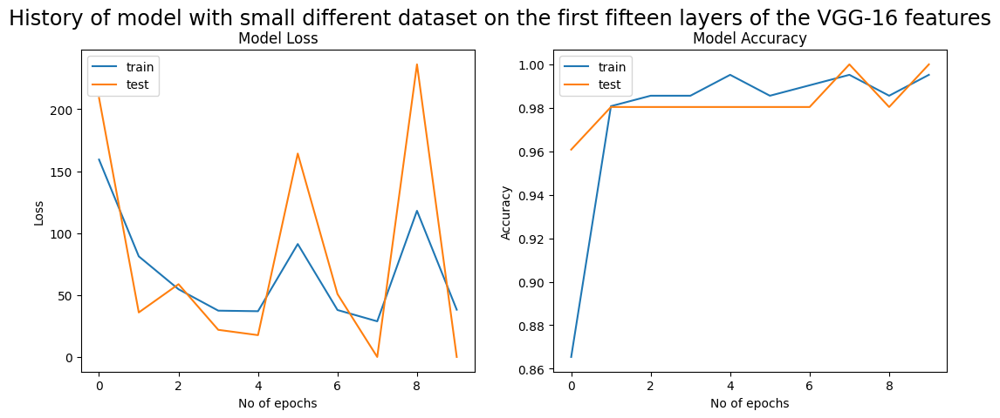

In [ ]:
plot_loss_and_accuracy(history, 'History of model with small different dataset on the first fifteen layers of the VGG-16 features')

### 3. Model with small different dataset, trained on the first eleven layers of the VGG-16 features

Train the model with small different dataset on the first eleven layers of the VGG-16 features

In [ ]:
history = train_VGG16_model(train_data_vgg16, valid_data_vgg16, num_classes=3, num_earlier_layers=11)

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0         
                                                                 
 block3_conv1 (Conv2D)       (None, 56, 56, 256)      

Plot the history of model with small different dataset on the first eleven layers of the VGG-16 features

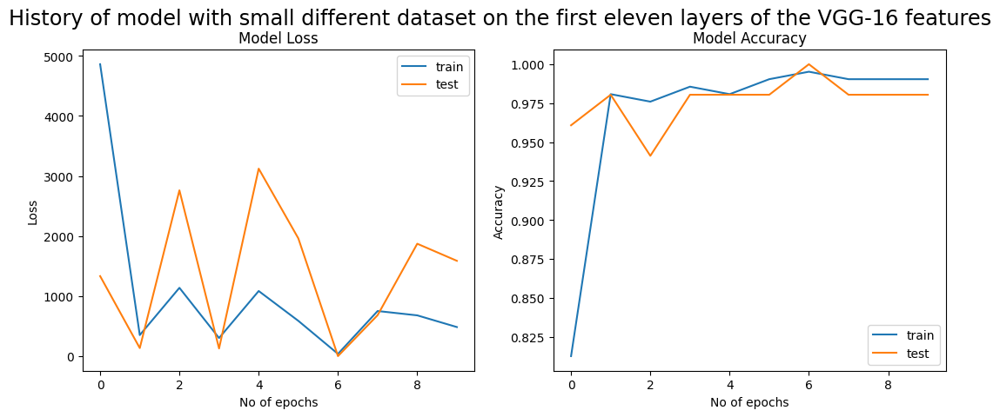

In [ ]:
plot_loss_and_accuracy(history, 'History of model with small different dataset on the first eleven layers of the VGG-16 features')

## B. How should you employ Transfer Learning If your dataset is small and similar to the original dataset used to train the pre-trained model?

Load the CIFAR-10 dataset

In [ ]:
from tensorflow.keras.datasets import cifar10

(_, _), (X, y) = cifar10.load_data()

Reduce size of the dataset to one thousand images

In [ ]:
X = X[:1000]
y = y[:1000]

Resize the images to 224 × 224

In [ ]:
from tensorflow.image import resize

X = resize(X, (224, 224))

The shape of the dataset

In [ ]:
print(X.shape, y.shape)

(1000, 224, 224, 3) (1000, 1)


In [ ]:
X = vgg16.preprocess_input(X)

Train linear classification on VGG-16 features for the model with small similar dataset

In [ ]:
model = Sequential([
    pretrain_vgg16,

    Flatten(),
    Dropout(0.5),
    Dense(units=10, activation="softmax")
])

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model.summary()

history = model.fit(X, y, epochs=10, validation_split=validation_split)

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten_6 (Flatten)         (None, 25088)             0         
                                                                 
 dropout (Dropout)           (None, 25088)             0         
                                                                 
 dense_6 (Dense)             (None, 10)                250890    
                                                                 
Total params: 14965578 (57.09 MB)
Trainable params: 250890 (980.04 KB)
Non-trainable params: 14714688 (56.13 MB)
_________________________________________________________________
Epoch 1/10
25/25 [==============================] - 419s 17s/step - loss: 9.1417 - accuracy: 0.4263 - val_loss: 4.2368 - val_accuracy: 0.61

Plot the history of model with small similar dataset on VGG-16 features

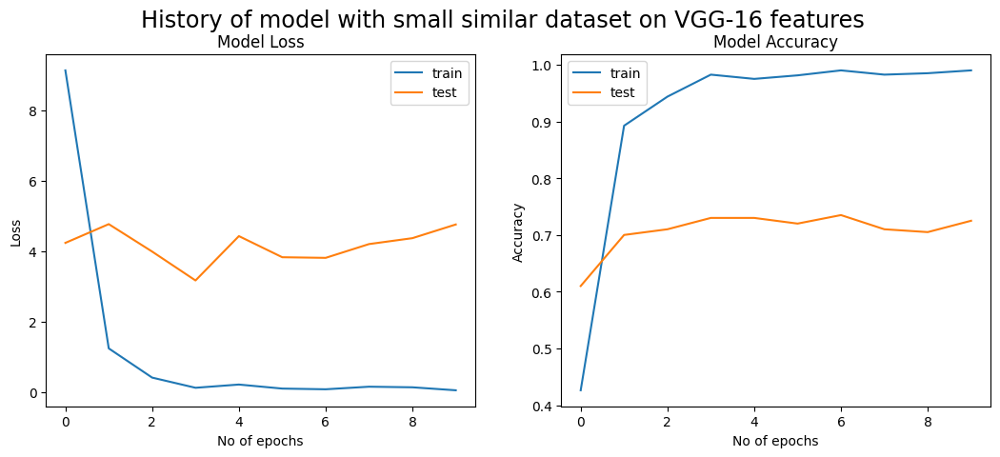

In [ ]:
plot_loss_and_accuracy(history, 'History of model with small similar dataset on VGG-16 features')